# Code to run website tests
### The model parameters are already trained using the Training Visualization 

In [295]:
pre_i=1
post_i=2
bw_i=3
bf_i=4

In [296]:
import csv
import matplotlib.pyplot as plt
import sys
import math

import matplotlib.pyplot as plt
from scipy.fft import rfft, rfftfreq
from scipy.fft import irfft
import numpy as np
import statistics
from statistics import mean, pstdev
import pandas as pd

yellow = '\033[93m'
green = '\033[92m'
red = '\033[91m'
blue = '\033[94m'
pink = '\033[95m'
black = '\033[90m'

def smoothen(time, data, rtt):
    # Smoothening 
    left = 0
    right = 0
    run_sum = 0
    avg_data = []
    new_time = []
    roll_time = time
    roll_data = data
    while right < len(roll_time):
        while(right < len(roll_time) and (roll_time[right]-roll_time[left] < 2*rtt)):
            run_sum+=roll_data[right]
            right+=1
        new_time.append(float(roll_time[right-1]+roll_time[left])/2)
        avg_data.append(float(run_sum)/(right-left))
        run_sum-=roll_data[left]
        left+=1
    return new_time, avg_data


def get_fft(data):
    n = len(data)
    data_step = 0.002
    yf = rfft(data)
    xf = rfftfreq(n,data_step)
    return yf,xf

def get_fft_smoothening(data, time, ax,rtt,p):
    rtt=rtt
    yf, xf = get_fft(data)
    thresh  = (1/rtt)
    thresh_ind = 0
    for i in range(len(xf)) :
        freq = xf[i]
        if(freq > thresh):
            thresh_ind = i
            break
            
    yf_clean = yf
    yf_clean[thresh_ind+1:] = 0
    new_f_clean = irfft(yf_clean)
    start_len = len(time) - len(new_f_clean)

    plot_data = new_f_clean
#     if p=="y":
#         ax.plot(time[start_len:], plot_data, 'k', label='FFT smoothening', linewidth=1.5)

    plot_time = time[start_len:] 
    return plot_time, plot_data

def plot_d(ax, time, data, c, l, alpha=1):
    ax.plot(time, data, color=c, lw=2, label = l,alpha=alpha)


def plot_one_bt(f, p,t=1):
#     print(f)
    file_name = f.split("/")[-1]
    fs = file_name.split("-")

    pre = int(fs[1])
    post = int(fs[2])
    rtt = float(((pre+post)*2))/1000
    ax = 0
    if t==1:
        data, time, retrans = get_window(f,"n",t)
    elif t==2:
        data, time, retrans, OOA, DA = get_window(f,"n",t)
    if p == 'y':
        fig, ax = plt.subplots(1,1, figsize=(15,8))
        for t in retrans :
            plt.axvline(x = t, color = 'm',alpha=0.5)
        if t == 2:
            for t in OOA :
                plt.axvline(x = t, color = 'k', lw=2)
            for t in DA:
                plt.axvline(x = t, color = 'g', lw=0.5, alpha = 0.5)
        plot_d(ax,time,data, "r","Original")
    time, data = get_fft_smoothening(data, time, ax,rtt,"y")

    #         plot_d(ax,time,data,"b","FFT Smoothened" )
#         print(len(time), len(data))
    time, data = smoothen(time, data, rtt)
#         print(len(time), len(data))
    if p == 'y':
        plot_d(ax, time, data, "b", "Smoothened",alpha=0.5)
        ax.legend()
#             plt.savefig("./plots/"+f+".png")
        plt.show()
#     return time, data, grad_time, grad_data, rtt
#     print("Black : OOA, Green : DA, Magenta : RP")
    return time, data, retrans, rtt 


def get_time_features(retrans,time,rtt):
    time_thresh = 20*rtt
    features = []
    for i in range(1, len(retrans)):
        if retrans[i]-retrans[i-1] >= time_thresh:
            features.append([retrans[i-1], retrans[i]])
    # add a feature that finished when the experiment ends
    if len(retrans)>0:
        if time[-1] - retrans[-1] > 20*rtt :
            features.append([retrans[-1],time[-1]])
    return features

def get_features(time, features):
    left = 0
    right = 0
    feature_index = 0
    in_feature = 0
    index_features = []
    while right < len(time) and feature_index < len(features): 
        if in_feature == 0 and time[right]>=features[feature_index][0]:
            in_feature = 1
            left = right
        elif in_feature == 1 and time[right] > features[feature_index][1]:
            in_feature = 0
            index_features.append([left, right-1])
            feature_index+=1
        right+=1
    if in_feature == 1:
        index_features.append([left, right-1])
    return index_features

def get_plot_features(curr_file, p):
    time, data, retrans, rtt = plot_one_bt(curr_file,p=p,t=1)
    time_features = get_time_features(retrans,time,rtt)
    features = get_features(time, time_features)    
    if p == 'y':
        fig, ax = plt.subplots(1,1, figsize=(15,8))
        plot_d(ax, time, data, "b", "Smoothened")
        for ft in features : 
#             print(time[ft[1]]-time[ft[0]])
            ax.plot(time[ft[0]:ft[1]+1], data[ft[0]:ft[1]+1], color = 'r')
        plt.show()
    return time, data, features


SHOW=True
MULTI_GRAPH=False
SMOOTHENING=False
ONLY_STATS=False
s_factor=0.9


PKT_SIZE = 88


'''
TODO: 
o Add functionality where you only plot flows that send more than x bytes of data
o Sort stats and graphs by flow size
o Organize plots by flow size (larger flows have larger graphs)
o Custom smoothening function
'''

fields=["time", "frame_time_rel", "tcp_time_rel", "frame_num", "frame_len", "ip_src", "src_port", "ip_dest", "dest_port", "tcp_len", "seq", "ack"]

class pkt:
    contents=[]
    def __init__(self, fields) -> None:
        self.contents=[]
        for f in fields:
            self.contents.append(f)

    def get(self, field):
        return self.contents[fields.index(field)]
        

def process_flows(cc, dir,p="y"):
    name = dir+cc+"-tcp.csv"
    with open(name) as csv_file:
        print("Reading "+name+"...")
        csv_reader = csv.reader(csv_file, delimiter=',')
        line_count = 0
        total_bytes=0
        '''
        Flow tracking:
        o Identify all packets that are either sourced from or headed to 100.64.0.2
        o Group different flows by client's port
        '''
        flows={}
        data_sent=0
        # ACK and RTX measurement
        ooa = set()
        rp = set()
        ooaCount=0
        rpCount=0
        daCount=0
        backAck=0
        for row in csv_reader:
            reTx=0
            
            ooAck=0
            dupAck=0
            retPacket=0
            
            packet=pkt(row)
            ackPkt=False
            validPkt=False
            if line_count==0:
                # reject the header
                line_count+=1
                continue
            if data_sent == 0 : 
                if "100.64.0." in packet.get("ip_src"):
                    num = int(packet.get("ip_src")[-1])
                    if num%2==0:
                        data_sent=1
                        host_port=packet.get("ip_src")
                if "100.64.0." in packet.get("ip_dest"):
                    num = int(packet.get("ip_dest")[-1])
                    if num%2==0:
                        data_sent=1
                        host_port=packet.get("ip_dest")
                if data_sent == 0:
                    continue
            if packet.get("ip_src")==host_port and packet.get("frame_time_rel")!='' and packet.get("ack")!='': 
                # we care about this ACK packet
                validPkt=True
                ackPkt=True
                port=packet.get("src_port")
                #PORTCHECK
#                 if int(port) != 50468:
#                     continue
                if port not in flows:
                    flows[port]={"OOA":[],"DA":[],"max_seq":0,"loss_bif":0,"max_ack":int(packet.get("ack")),"serverip":packet.get("ip_dest"), "serverport":packet.get("dest_port"), "act_times":[],"times":[], "windows":[], "cwnd":[], "bif":0, "last_ack":0, "last_seq":0, "pif":0, "drop":[], "next":0, "retrans":[]}
                else:
                    # check for Out of Order Ack (OOA)
                    if int(packet.get("ack")) <= int(flows[port]["max_ack"]):
                        if int(packet.get("ack")) == backAck :
                            dupAck = True
                            flows[port]["DA"].append(float(packet.get("frame_time_rel")))
                        else :
                            ooAck = True
                            flows[port]["OOA"].append(float(packet.get("frame_time_rel")))
                        backAck = int(packet.get("ack"))
                    # update max_ack
                    flows[port]["max_ack"] = max(flows[port]["max_ack"], int(packet.get("ack")))
                    if int(packet.get("seq")) < flows[port]["max_ack"]:
                        reTx += int(packet.get("tcp_len"))
#                     flows[port]["times"].append(float(packet.get("frame_time_rel")) )
                    
            elif packet.get("ip_dest")==host_port and packet.get("frame_time_rel")!='' and packet.get("seq")!='':
                #we care about this Data packet
                validPkt=True
                port=packet.get("dest_port")
                #PORTCHECK
#                 if int(port) != 50468:
#                     continue
                seq=int(packet.get("seq"))
                tcp_len=int(packet.get("tcp_len"))
                if port not in flows:
                    flows[port]={"OOA":[],"DA":[],"max_seq":int(packet.get("seq")),"loss_bif":0,"max_ack":0,"serverip":packet.get("ip_src"), "serverport":packet.get("src_port"),"act_times":[], "times":[], "windows":[], "cwnd":[], "bif":0, "last_ack":0, "last_seq":0, "pif":0, "drop":[], "next":0, "retrans":[]}
                
                else:
                    flows[port]["max_seq"] = max(flows[port]["max_seq"], int(packet.get("seq")))
                
                
                if int(packet.get("seq")) < flows[port]["max_seq"] :
                    retPacket = True
                    flows[port]["retrans"].append(flows[port]["times"][-1])
                    
            if validPkt==True:
                bif = 0
                normal_est_bif = int(flows[port]["max_seq"]) - int(flows[port]["max_ack"]) + PKT_SIZE#+ reTx
                loss_est_bif = flows[port]["loss_bif"]
                if ackPkt and dupAck and len(flows[port]["windows"]) > 10:
                    if dupAck:
                        # if we have received a duplicate ack then we need to reduce the bytes in flight by packet size
                        # we also increase max ack to correct for the consolidated ack being sent later
                        loss_est_bif = int(flows[port]["windows"][-1]) - PKT_SIZE
                        flows[port]["max_ack"] += PKT_SIZE
                        
                        bif = min( normal_est_bif, loss_est_bif)
                        if p == "y" :
                            print(green+"Duplicate Ack",int(packet.get("ack")),"Max Ack",flows[port]["max_ack"],"BIF",bif)
                        
#                     elif ooAck:
#                         # first out of order ack that we have recieved not a duplicated ack
#                         # the reason would be restransimitted packet so dont need to correct for this
                        
                elif ackPkt :
                    loss_est_bif = normal_est_bif 
                    bif = normal_est_bif    
                    if ooAck :
                        ooaCount+=1
                        if p == "y":
                            print(red+"Out of Order Ack",int(packet.get("ack")),"Max Ack",flows[port]["max_ack"],"BIF",normal_est_bif)
                        ooa.add(int(packet.get("ack")))
                    else:
                        if p == "y":
                            print(black+"Inorder Ack",int(packet.get("ack")),"Max Seq",flows[port]["max_seq"],"BIF",normal_est_bif)
                else :
                    bif = normal_est_bif
                    if retPacket==True:
                        rpCount+=1
                        rp.add(int(packet.get("seq")))
                        if p == "y":
                            print(pink+"Retransmitted Packet",int(packet.get("seq")), "Next", flows[port]["max_seq"]+PKT_SIZE, "BIF",bif)
                    else :
                        if p == "y":
                            print(blue+"Inorder Packet", int(packet.get("seq")), "Next", flows[port]["max_seq"]+PKT_SIZE, "BIF",bif)
                flows[port]["loss_bif"] = loss_est_bif
                flows[port]["windows"].append( int(bif) )
                flows[port]["times"].append( float(packet.get("frame_time_rel")) )
                
#                 if ackPkt and dupAck and len(flows[port]["windows"]) > 10: # we have received atleast the first window
# #                     if len(flows[port]["windows"]) < 2000: # print reTx in first 200 packets
# #                         print( packet.get("ack"), flows[port]["max_ack"])
#                     loss_est_bif = int(flows[port]["windows"][-1]) - PKT_SIZE
#                     flows[port]["max_ack"] += PKT_SIZE
#                     bif = min( normal_est_bif, loss_est_bif )
#                 elif ackPkt:
#                     loss_est_bif = normal_est_bif 
#                     bif = normal_est_bif
#                 else:
#                     bif = normal_est_bif
#                 flows[port]["loss_bif"] = loss_est_bif
#                 flows[port]["windows"].append( int(bif) )
            
            
            line_count+=1
            total_bytes+=int(packet.get("frame_len"))
            #print(line_count, total_bytes)
            
#         print("total bytes processed:", total_bytes/1000, "KBytes for", cc, "(unlimited)")
        if p == "y":
            print("Out of Order Acks",len(ooa),"Retransmitted Packets",len(rp))
            print("Count Out of Order Acks",ooaCount,"Retransmitted Packets",rpCount)
            print("OOA",ooa,"RP",rp)
    return flows

def custom_smooth_function():
    pass

def get_flow_stats(flows):
    num=len(flows.keys())
    print("FLOW STATISTICS: \nNumber of flows: ", num)
    print("------------------------------------------------------------------------------")
    print('%6s'%"port", '%15s'%"SrcIP", '%8s'%"SrcPort",  '%8s'%"duration",  '%8s'%"start",  '%8s'%"end", '%8s'%"Sent (B)", '%8s'%"Recv (B)",)
    for k in flows.keys():
        print('%6s'%k, '%15s'%flows[k]["serverip"], '%8s'%flows[k]["serverport"], '%8s'%str('%.2f'%(flows[k]["times"][-1]-flows[k]["times"][0])), '%8s'%str('%.2f'%flows[k]["times"][0]), '%8s'%str('%.2f'%flows[k]["times"][-1]), '%8s'%flows[k]["last_seq"], '%8s'%flows[k]["last_ack"])
        #print("    * Flow "+str(k)+": ", flows[k]["last_ack"], " ", flows[k]["last_seq"], " bytes transfered.")
    return num

def run(files):
    flows = {}
    for f in files:
        algo_cc=f
        #Get the data for all the flows
        print("==============================================================================")
        print("opening trace ../measurements/"+algo_cc+".csv...")
        flows = process_flows(algo_cc, "./Nebby/measurements-new-btl/50-200-2-60/")
        #decide on final graph layout
        num = get_flow_stats(flows)

        if ONLY_STATS:
            sys.exit()

        if num==1:
            MULTI_GRAPH=False
        #grid size
        if MULTI_GRAPH:
            size=(0,0)
            grids={1:(2,2), 2:(2,2), 4:(2,2), 6:(2,3), 9:(3,3), 12:(3,4), 15:(3,5), 16:(4,4), 20:(5,4), 24:(6,4), 30:(6,5), 36:(6,6), 40:(8,5), 42:(8,7), 49:(7,7)}
            g=num
            while g<=49 and g not in grids:
                g+=1
            if g in grids.keys():
                size=grids[g]
            else:
                size=grids[49]  
            fig, axs = plt.subplots(size[0], size[1])
            for i in range(size[0]):
                for j in range(size[1]):
                    #axs[i][j].legend(loc="lower right")
                    if i==size[0]-1:
                        axs[i][j].set_xlabel("Time (s)")
                    if j==0:
                        axs[i][j].set_ylabel("Bytes in flight")
        else:
            plt.xlabel("Time (s)")
            plt.ylabel("Bytes in flight")
        counter=0
        for port in flows.keys():
            if MULTI_GRAPH:  
                axs[counter%size[0]][(counter//size[0])%size[1]].scatter(flows[port]["times"], flows[port]["windows"], color="#858585")
                axs[counter%size[0]][(counter//size[0])%size[1]].plot(flows[port]["times"], flows[port]["windows"], label=str(port), linestyle="solid")
            else:
                plt.plot(flows[port]["times"], flows[port]["windows"], label=str(port), linestyle="solid")
                plt.scatter(flows[port]["times"], flows[port]["windows"], color="#858585")
            counter+=1
        if MULTI_GRAPH:
            counter=0
            for port in flows.keys():
                axs[counter%size[0]][(counter//size[0])%size[1]].legend()
                counter+=1
        else:
            plt.legend()
        if MULTI_GRAPH:
            fig.set_size_inches(16, 12)
        if SHOW:
            plt.show()
        else:
            plt.savefig("../logs/results/"+algo_cc+".png", dpi=600, bbox_inches='tight', pad_inches=0)
    return flows


def split_path(f):
    path = f.split("/")
    file_name = path[-1][:-8]
    folder_path = "/".join(path[:-1])
    folder_path = folder_path + "/"
    algo_cc = file_name
    return algo_cc, folder_path

def get_window(f,p,t=1):
    algo_cc, folder_path = split_path(f)
    flows = process_flows(algo_cc, folder_path,p=p)
#     flows = process_flows(algo_cc, "../measurements/m/",p=p)
#     flows = process_flows(algo_cc, "./Nebby/measurements/",p=p)    
#     flows = process_flows(algo_cc, "./Nebby/measurements-new-btl/50-200-2-60/",p=p)
#     flows = process_flows(algo_cc, "./Nebby/measurements-100-150/",p=p)
    params = algo_cc.split("-")
    data = []
    time = []
    drops = []
    retrans = []
    OOA = []
    DA = []
    use_port = 0
    maxx = 0
    print("All Ports : ", flows.keys())
    for port in flows.keys():
        if len(flows[port]['windows']) > maxx:
            maxx = len(flows[port]['windows'])
            use_port = port
    print("Port",use_port)
    data = flows[use_port]['windows']
    time = flows[use_port]['times']
    retrans = flows[use_port]['retrans']
    OOA = flows[use_port]['OOA']
    DA = flows[use_port]['DA']
    if p == "y":
        plt.plot(time, data)
#     time_index = len(time)-1
#     for index in range(len(flows[use_port]['times'])-1):
#         if flows[use_port]['times'][index+1] - flows[use_port]['times'][index] > :
#             time_index = index
#     time_last = flows[use_port]['times'][time_index]
#     data = data[:time_index+1]
#     time = time[:time_index+1]
    if t==2:
        return data, time, retrans, OOA, DA
    if t==1:
        return data, time, retrans


def getProbes(time, data, rtt, bdp, bw=200):
    if bw==200:
        thresh = 8*rtt
        st_thresh = 0.025
        error = 0.08
        alpha = 1.10
    if bw==1000:
        thresh = 4*rtt
        st_thresh = 0.025
        error = 0.02
        alpha = 1
    probe_index = []
    left = 0
    right = 0
    bdp_thresh = bdp/2
    prev_right = 0
    end = 0
    while right < len(data):
        while right < len(data) and (time[right]-time[left]) < thresh:
            right+=1
        if right == len(data):
            end = 1
            right-=1
        mid = math.floor(left + (right - left)/2)
        mid_val = 0
        left_mid = mid
        right_mid = mid
#         print(left,right)
#         while left_mid > 0 and abs(time[mid]-time[left_mid])<rtt:
#             if data[left_mid] > data[left] and data[left_mid] > data[right]:
#                 mid_val+=1
#             left_mid-=1
#         while right_mid < len(data)-1 and abs(time[right_mid]-time[mid])<rtt:
#             if data[right_mid] > data[left] and data[right_mid] > data[right]:
#                 mid_val+=1
#             right_mid+=1
#         total = right_mid - left_mid
#         peak = 0
#         if round(float(mid_val)/total,2) > 0.99 :
#             print(round(float(mid_val)/total,2))
#             peak=1
        go = 0
        if data[mid] > data[left] and data[mid] > data[right]:
#         if peak == 1:
            #this  is  peak
#             go = 1
            t_l = left
            t_r = right
            while(t_l > 0 and time[left]-time[t_l] < thresh/2):
                t_l-=1
            while(t_r < len(data)-1 and time[t_r]-time[right] < thresh/2):
                t_r+=1
            left_sd = round(np.std(data[t_l:left])/(bdp_thresh*2),3)
            right_sd = round(np.std(data[right:t_r])/(bdp_thresh*2),3)
            if float(abs(data[left]-data[right]))/data[left] < error:
                # this has the left and right points not too different from each other
                side_avg = float((data[left]+data[right]))/2
                local_max = max(data[left:right+1])
#                 go = 1
#                 print("Yes")
                if float(local_max)/side_avg > alpha and local_max > bdp_thresh: 
                    # this means that the peak is quite steep
#                     print("This")
#                     go = 1
                    if (left_sd < st_thresh) and (right_sd < st_thresh):
                        # this means that the lest and right are quite stable respectvely
                        go = 1
#                         print("Out", left_sd, right_sd, st_thresh)
        if go == 1: 
            try :
                probe_index.append([left,right,float(local_max)/side_avg, time[right]-time[left], left_sd, right_sd, t_l,t_r])
            except :
                probe_index.append([left,right])
            #Once you have found something you directly move past it
            left = right-1
        if end:
            right+=1
        left+=1
    return probe_index


def checkBBR(files,p="n"):
    classi = []
    for f in files:
        file_name = f.split("/")[-1]
        para = file_name.split("-")
        rtt = int(para[2])*2
        bw = int(para[3])
        bf = int(para[4])
        bdp = float(bw*rtt*bf)/8
        if bw == 1000 :
            l=5
            r=15
        if bw == 200:
            l=10
            r=20
        try:
            time, data, retrans,rtt = plot_one_bt(f,p="n",t=1)
            probe_index = getProbes(time, data, rtt, bdp, bw)
            if p=="y":
                print_red(time, data, probe_index)
            prev = 0
            time_dis = []
            for p in probe_index:
                curr_ind = data.index(max(data[p[0]:p[1]+1]))
                if curr_ind > p[1] or curr_ind < p[0]:
                    print("Something Wrong")
                if prev != 0:
                    time_dis.append(abs(time[curr_ind]-prev))
                prev = time[curr_ind]
#             print(time_dis)
            count = 0
            isBBR = 0
            for t in time_dis : 
                if  t > l*rtt and t < r*rtt :
                    count+=1
                    if count >= 2: # there are three peaks consecutively
                        isBBR=1
                        break
                else:
                    count = 0
            if isBBR:
                classi.append("YES BBR")
            else:
                if len(probe_index) <= 1 :
                    classi.append("NO BBR")
                else:
                    classi.append("MAYBE BBR")
        except Exception as ex:  
            template = "An exception of type {0} occurred. Arguments:\n{1!r}"
            message = template.format(type(ex).__name__, ex.args)
            new_message = "NC " + message
            classi.append(new_message)
    return classi

def print_red(time,data,probe_index):
    fig, ax = plt.subplots(1,1, figsize=(15,8))
    offset=0
    ax.plot(time[offset:],data[offset:])
    # for t in retrans :
    #     if t > time[offset]:
    #         plt.axvline(x = t, color = 'm',alpha=0.5)
    # ax.plot(new_time[offset:], new_data[offset:])
    for p in probe_index:
        ax.plot(time[p[0]:p[1]+1], data[p[0]:p[1]+1], color='r', lw=2)
    plt.show()

def getDivision(classi, test_files):
    yes = []
    no = []
    maybe = []
    nan = []
    for i in range(len(classi)):
        if classi[i] == "YES BBR":
            yes.append(test_files[i])
        elif classi[i] == "NO BBR":
            no.append(test_files[i])
        elif classi[i] == "MAYBE BBR":
            maybe.append(test_files[i])
        else:
            nan.append(test_files[i])
    return yes, no,maybe, nan

In [326]:
import bisect
def lower_bound(arr, target):
    index = bisect.bisect_left(arr, target)
    return index

def sample_data_time(time, data, ss, m):
    curr_time, curr_data = adjust(time, data)
    tp = curr_time[len(curr_time)-1] - curr_time[0]
    step = tp/m
    samp_time = [curr_time[0] + i*step for i in range(m)]
    x = np.random.uniform(0,math.pi,ss)
    tr_x = np.cos(x)
    tr_x += 1
    tr_x *= (m-1)/2
    ind = [int(round(e, 0)) for e in tr_x]
    sort_ind = sorted(ind)
    tr_time = [samp_time[i] for i in sort_ind]
    new_time = []
    new_data = []
    for t in tr_time :
        i = lower_bound(curr_time, t)
        temp_t = 0
        temp_d = 0
        if round(t,6) == round(curr_time[i],6):
            temp_t = curr_time[i]
            temp_d = curr_data[i]
        else : 
            if i == 0 :
                temp_t = curr_time[i]
                temp_d = curr_data[i]
            elif i == len(curr_time)-1 :
                temp_t = curr_time[i]
                temp_d = curr_data[i]
            else :
                temp_t = (curr_time[i-1] + curr_time[i])/2
                temp_d = (curr_data[i-1] + curr_data[i])/2
        new_time.append(temp_t)
        new_data.append(temp_d)
    new_data.insert(0,curr_data[0])
    new_data.append(curr_data[-1])
    new_time.insert(0,curr_time[0])
    new_time.append(curr_time[-1])
#     return curr_time, curr_data
    return new_time, new_data

def adjust(time, data):
    try :
        start = data.index(min(data[:int(len(data)/2)]))
        end = data.index(max(data[int(len(data)/2):]))
    except :
        start = 0 
        end = len(data) - 1
    print("Difference in max and min ", end-start)
    if end - start <= 0: 
        return time, data
    new_time = time[start:end+1]
    new_data = data[start:end+1]
    return new_time, new_data

# Taking 100 as the threshold is fine 
# Now we have to see how the graphs look if we use it. 
# var = ["reno", "cubic", "bbr"]
def getRed_R(files,ss=125,p="y", ft_thresh=100):
    results = []
    for curr_file in files : 
        print(curr_file)
        file, folder_path = split_path(curr_file)
        f_split = file.split("-")
        v = f_split[0]
        rtt = float((int(f_split[pre_i]) + int(f_split[post_i]))*2)/1000
        bdp = float(rtt*1000*int(f_split[bw_i])*int(f_split[bf_i]))/8
        time, data, features = get_plot_features(curr_file, p=p)
        count = 1
        for ft in features : 
            if count > ft_thresh:
                break
            curr_time = time[ft[0]:ft[1]+1]
            curr_data = data[ft[0]:ft[1]+1]
            tr_time, tr_data = sample_data_time(curr_time, curr_data, ss, 1000)
            tr_time_pd = pd.DataFrame(tr_time)
            tr_data_pd = pd.DataFrame(tr_data)
            tr_time = list(tr_time_pd.rolling(25, center=True).mean().dropna()[0])
            tr_data = list(tr_data_pd.rolling(25, center=True).mean().dropna()[0])
            print("Feature Length ", len(tr_data))
            if p == "y" :
                plt.plot(curr_time, curr_data, c='b', alpha = 0.5, lw = 5)
                plt.plot(tr_time, tr_data, c='r', alpha = 1)
                plt.scatter(tr_time, tr_data, c='k')
#                 plt.scatter(tr_time, tr_data, c='r', s=10)
                plt.title(v)
                plt.show()
            results.append(
                {v+"_"+"data"+"_"+str(count):tr_data,
                     v+"_"+"time"+"_"+str(count):tr_time,
                        v+"_"+"rtt"+"_"+str(count):rtt, 
                             v+"_"+"bdp"+"_"+str(count):bdp})
            count+=1
    return results

def getRed(files,ss=125,p="y", ft_thresh=100):
    results = []
    for file in files :   
        f_split = file.split("-")
        v = f_split[0] + "-" + f_split[1]
        rtt = float((int(f_split[2]) + int(f_split[3]))*2)/1000
        bdp = float(rtt*1000*int(f_split[4])*int(f_split[5]))/8
        print(file)
        print("RTT",rtt,"BDP",bdp)
        time, data, features = get_plot_features(file, p=p)
        count = 1
        for ft in features : 
            if count > ft_thresh:
                break
            curr_time = time[ft[0]:ft[1]+1]
            curr_data = data[ft[0]:ft[1]+1]
            tr_time, tr_data = sample_data_time(curr_time, curr_data, ss, 1000)
            tr_time_pd = pd.DataFrame(tr_time)
            tr_data_pd = pd.DataFrame(tr_data)
            tr_time = list(tr_time_pd.rolling(25, center=True).mean().dropna()[0])
            tr_data = list(tr_data_pd.rolling(25, center=True).mean().dropna()[0])
            print("Feature Length ", len(tr_data))
            if p == "y" :
                plt.plot(curr_time, curr_data, c='b', alpha = 0.5, lw = 5)
                plt.plot(tr_time, tr_data, c='r', alpha = 1)
                plt.scatter(tr_time, tr_data, c='k')
#                 plt.scatter(tr_time, tr_data, c='r', s=10)
                plt.title(v)
                plt.show()
            results.append(
                {v+"_"+"data"+"_"+str(count):tr_data,
                     v+"_"+"time"+"_"+str(count):tr_time,
                        v+"_"+"rtt"+"_"+str(count):rtt, 
                             v+"_"+"bdp"+"_"+str(count):bdp})
            count+=1
    return results
# results = getRed(var)

def get_degree_all(time,data, p="n", max_deg=3):
    p_net = []
    mse_l = []
    fit_net = []
    for d in range(1,max_deg+1):
        p_temp = np.polyfit(time,data,d)
        p_net.append(p_temp)
        fit_net.append(np.polyval(p_temp,time))
        mse_l.append(mse(data,fit_net[-1]))
    if p =='y':
#         print("1 ", p1, "MSE ", mse(data, fit_l))
        plt.plot(time, data,c='k',label='Truth')
#         plt.plot(time, fit_l)
        for d in range(0, max_deg):
            plot_label = "degree"+str(d+1)
            plt.plot(time, fit_net[d],label="degree" + str(d+1))
        plt.legend()
        plt.show()
    return max_deg,p_net, mse_l

MAX_DEG=3
from sklearn.metrics import mean_squared_error as mse
def get_degree(time,data, p="n", max_deg=MAX_DEG):
    p_net = []
    mse_l = []
    fit_net = []
    for d in range(1,max_deg+1):
        p_temp = np.polyfit(time,data, d)
        p_net.append(p_temp[0:-1])
        fit_net.append(np.polyval(p_temp,time))
        mse_l.append(mse(data,fit_net[-1]))
    if p =='y':
#         print("1 ", p1, "MSE ", mse(data, fit_l))
        plt.plot(time, data,c='k',label='Truth')
#         plt.plot(time, fit_l)
        for d in range(max_deg-1, max_deg):
            plot_label = "degree"+str(d)
            plt.plot(time, fit_net[d],label="degree" + str(d+1))
        plt.legend()
        plt.show()
    return max_deg,p_net[max_deg-1], mse_l

def normalize(time, data, rtt, bdp):
    new_time = time - min(time)
    new_data = data - min(data)
    new_time = (new_time/max(new_time))*10
    new_data = (new_data/max(new_data))*10    
    return new_time, new_data
    
from statistics import mean 
def get_feature_degree_R(files,ss=225,p='n',ft_thresh=3,max_deg=MAX_DEG):
    results = getRed_R(files,ss,p=p,ft_thresh=ft_thresh)
    count_features = 0
    mp = {}
    for item in results :
        for ele in list(item.keys()):
            name_list = ele.split("_")
            website = name_list[0]
            if "data"==name_list[1] :
                curr_data = np.array(item[ele])
            if "time"==name_list[1] :
                curr_time = np.array(item[ele])
            if "rtt"==name_list[1] :
                curr_rtt = item[ele]
            if "bdp"==name_list[1] :
                curr_bdp = item[ele]
#         print(website)
#         print(curr_data, curr_time)
        curr_time, curr_data = normalize(curr_time, curr_data, curr_rtt, curr_bdp)
        count_features += 1
        max_deg,p_net,mse_l = get_degree_all(curr_time, curr_data,p=p,max_deg=max_deg)
        mp[website] = {
        'data':curr_data,
        'time':curr_time,
        "max_deg":max_deg,
        "p_net":p_net,
        "mse_l":mse_l
    }
    return mp

from statistics import mean 
def get_feature_degree(files,ss=225,p='n',ft_thresh=3,max_deg=MAX_DEG):
    results = getRed(files,ss,p=p,ft_thresh=ft_thresh)
    errors = []
    mp = {}
    cc_mp = {}
    count_features = 0
    for item in results :
        for ele in list(item.keys()):
            name_list = ele.split("_")
            cc = name_list[0]
            name = name_list[0] + name_list[-1]
            if "data" in ele :
                curr_data = np.array(item[ele])
            if "time" in ele :
                curr_time = np.array(item[ele])
            if "rtt" in ele :
                curr_rtt = item[ele]
            if "bdp" in ele :
                curr_bdp = item[ele]
        curr_time, curr_data = normalize(curr_time, curr_data, curr_rtt, curr_bdp)
        count_features += 1
        print("Name :",name)
        degree, coeff, error_item = get_degree(curr_time, curr_data,p=p,max_deg=max_deg)
        # Adding time feature here
#         coeff_list = list(coeff)
#         coeff_list.append(abs(curr_time[-1]-curr_time[0]))
#         coeff = np.array(coeff_list)
#         print(coeff)
        #Adding new for scalalble and yeah
        cc_curr = cc.split("-")[0]
        # Adding another check for scalable and yeah
#         if cc_curr in ['scalable','yeah']:
#             # Look at the fifth coefficient
#             if round(coeff[0],6) < 0.000015:
#                 print(coeff[0])
#                 continue
#         coeff.append(abs(curr_time[-1]-curr_time[0]))
        mp[name] = {'d':degree, 'coeff':coeff, 'error':error_item, 'data':curr_data, 'time':curr_time}
        if cc not in cc_mp :
            cc_mp[cc] = []
        cc_mp[cc].append(mp[name])
    return cc_mp

from scipy.stats import multivariate_normal as mvn
def getPDensity(curr, cc_gaussian_params):
    prob = {}
    for cc in cc_gaussian_params:
        mn = cc_gaussian_params[cc]['mean']
        covar = cc_gaussian_params[cc]['covar']
#         print("CC being checked against",cc)
#         print(np.linalg.det(covar))
        curr_p = mvn.pdf(curr,mean=mn, cov=covar, allow_singular=True)
        prob[cc]=curr_p
    return prob

In [406]:
def getBestDegree(nmp):
    results = {}
    too_much_error = {}
    for name in nmp.keys():
        print(name)
#         curr_time, curr_data, retrans, rtt = plot_one_bt(name+"-0-50-200-2-aws-88-60",'y',1)
        data = nmp[name]['data']
        time = nmp[name]['time']
        max_deg = nmp[name]['max_deg']
        p_net = []
        for coeff in nmp[name]['p_net']:
            temp_pnet = [c for c in coeff]
            p_net.append(temp_pnet)
        mse_l = nmp[name]['mse_l']
        plt.plot(time, data,c='k',label='Truth')
#         plt.plot(time, fit_l)
        for d in range(0, max_deg):
            plot_label = "degree"+str(d+1)
            fit_net = np.polyval(p_net[d],time)
            plt.plot(time, fit_net,label="degree" + str(d+1))
        plt.legend()
        plt.show()

        names = []
        loss = []
        lambd = 0.02
        for i in range(len(mse_l)):
            loss.append((i+1)*sum(p_net[i])*lambd)
        print("loss", loss)
        print("mse", mse_l)
        for d in range(0, max_deg):
            names.append("degree "+str(d+1))
        plt.bar(names,mse_l,color='blue',width=0.4,label="mse")
        plt.bar(names,loss,bottom=mse_l,color='maroon',width=0.4,label="reg_loss")

        plt.legend()
        plt.show()
        errors = []
        # The code for deciding the categories
        for i in range(0,max_deg):
            errors.append(loss[i]+mse_l[i])
        deg = errors.index(min(errors))+1
        
        # Error threshold
        error_threshold = 1
        if errors[deg-1] > error_threshold:
            current_cc = name.split("-")[0]
            too_much_error[current_cc]={
                'deg':deg,
                'coeff':p_net[deg-1],
                'error':errors[deg-1]
            }
            continue
        
    #     if deg < 3:
    #         deg = mse_l.index(min(mse_l[0:2]))+1
    #     print(deg)
        current_cc = name.split("-")[0]
        results[current_cc]={
            'deg':deg,
            'coeff':p_net[deg-1],
            'error':errors[deg-1]
        }
    return results, too_much_error

In [404]:
from scipy.stats import multivariate_normal as mvn
def getPDensityR(curr, cc_gaussian_params):
    curr_coeff = curr[:-1]
    prob = {}
    for cc in cc_gaussian_params:
        mn = cc_gaussian_params[cc]['mean']
        covar = cc_gaussian_params[cc]['covar']
        if len(curr_coeff) == len(mn):
            print(cc)
            print(curr_coeff)
            print(mn)
            print(covar)
            curr_p = mvn.pdf(curr_coeff,mean=mn, cov=covar, allow_singular=True)
            print(curr_p)
            prob[cc]=curr_p
#         print("CC being checked against",cc)
#         print(np.linalg.det(covar))
    return prob

def getWebDensity(mp, cc_gaussian_params):
    acc_w = {}
    for web in mp:
        p_dense = getPDensityR(mp[web]['coeff'], cc_gaussian_params)
        if web not in acc_w:
            acc_w[web]={}
        ccs = np.array(list(p_dense.keys()))
        vals = np.array(list(p_dense.values()))
        
        p_ind = list(np.argsort(vals))
        p_ind.reverse()
        acc_w[web]['ccs'] = [ccs[i] for i in p_ind]
        acc_w[web]['density'] = np.array([vals[i] for i in p_ind])
        maxx = max(acc_w[web]['density'])
        minn = min(acc_w[web]['density'])
        acc_w[web]['relative'] = (acc_w[web]['density']-minn)/(maxx-minn) 
    return acc_w

def predictCC(acc_w):
    pred = {}
    for web in acc_w:
        if acc_w[web]['density'][0] < 0.01:
            pred[web]='new'
        elif acc_w[web]['relative'][1] > 0.01:
            pred[web]='confused'
        else :
            pred[web]=acc_w[web]['ccs'][0]
    return pred, acc_w

def getPredictions(cc_mp,cc_gp,no):
    acc_w = getWebDensity(cc_mp, cc_gp)
    pred, acc_w = predictCC(acc_w)
    predictions = {}
    no_feature = []
    for f in no:
        tp_mp = get_feature_degree_R([f],ss=225,p="y",ft_thresh=1,max_deg=3)
        if len(cc_mp.keys()) == 0:
            continue
        new_f = f.split("/")[-1]
        w = new_f.split("-")[0]
        if w not in acc_w.keys():
            print("No Feature")
            no_feature.append(w)
            predictions[w]="No feature"
        else:
            print(cc_mp[new_f.split("-")[0]]['coeff'])
    #         time, data, retrans, rtt= plot_one_bt(f,"y",1)
            predictions[w] = {}
            print("Top 5 CCS :", acc_w[w]['ccs'][0:5])
            predictions[w]['ccs'] = acc_w[w]['ccs'][0:5]
            
            print("Density Values:",acc_w[w]['density'][0:5])
            predictions[w]['density'] = acc_w[w]['density'][0:5]
            
            print("Relative Density Values:",acc_w[w]['relative'][0:5])
            predictions[w]['relative'] = acc_w[w]['relative'] = acc_w[w]['relative'][0:5]
            
            print("Prediction:",pred[w])
            predictions[w]['final'] = pred[w]
    return predictions

In [405]:
import pickle
with open('cc_gp_cubicQ.txt', 'rb') as f:
    cc_gp = pickle.load(f)

# Running the same on all files

In [7]:
folder = '../../aws/website_measurements/26_1k_cut/mumbai/'

In [8]:
def file_filter(file):
    if "udp.csv" in file:
        return 0
    if "0-50-100-2" in file:
        return 0
    return 1
    

In [9]:
mumbai_files = []
import os 
for f in os.listdir(folder):
    if file_filter(f) == 1:
        mumbai_files.append(folder+f)
mumbai_files = sorted(mumbai_files)

In [10]:
classi = checkBBR(mumbai_files,p="n")

Reading ../../aws/website_measurements/26_1k_cut/mumbai/11st.co.kr-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../aws/website_measurements/26_1k_cut/mumbai/1337x.to-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48476', '49652'])
Port 49652


/home/lakshayr/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:262: RuntimeWarning: Degrees of freedom <= 0 for slice
  ret = _var(a, axis=axis, dtype=dtype, out=out, ddof=ddof,
/home/lakshayr/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:222: RuntimeWarning: invalid value encountered in true_divide
  arrmean = um.true_divide(arrmean, div, out=arrmean, casting='unsafe',
/home/lakshayr/anaconda3/lib/python3.9/site-packages/numpy/core/_methods.py:254: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


Reading ../../aws/website_measurements/26_1k_cut/mumbai/163.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48474', '36938', '50900'])
Port 36938
Reading ../../aws/website_measurements/26_1k_cut/mumbai/1688.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54574'])
Port 54574
Reading ../../aws/website_measurements/26_1k_cut/mumbai/360.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54962', '43010'])
Port 43010
Reading ../../aws/website_measurements/26_1k_cut/mumbai/3c.tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39542', '41316'])
Port 39542
Reading ../../aws/website_measurements/26_1k_cut/mumbai/3dmgame.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54634', '53056'])
Port 54634
Reading ../../aws/website_measurements/26_1k_cut/mumbai/4399.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59200', '41592'])
Port 41592
Reading ../../aws/website_measurements/26_1k_cut/mumbai/4pda.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../aws/website_meas

All Ports :  dict_keys(['56520', '43282', '52622'])
Port 52622
Reading ../../aws/website_measurements/26_1k_cut/mumbai/bancodevenezuela.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33188', '60154'])
Port 60154
Reading ../../aws/website_measurements/26_1k_cut/mumbai/bandcamp.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46328'])
Port 46328
Reading ../../aws/website_measurements/26_1k_cut/mumbai/banggood.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54754'])
Port 54754
Reading ../../aws/website_measurements/26_1k_cut/mumbai/bankofamerica.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59928'])
Port 59928
Reading ../../aws/website_measurements/26_1k_cut/mumbai/battle.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55740'])
Port 55740
Reading ../../aws/website_measurements/26_1k_cut/mumbai/bbc.co.uk-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59616'])
Port 59616
Reading ../../aws/website_measurements/26_1k_cut/mumbai/bbc.com-0-50-200-2-tcp.csv...
All Ports :  dict_

All Ports :  dict_keys(['42322'])
Port 42322
Reading ../../aws/website_measurements/26_1k_cut/mumbai/corriere.it-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../aws/website_measurements/26_1k_cut/mumbai/coursehero.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44818'])
Port 44818
Reading ../../aws/website_measurements/26_1k_cut/mumbai/coursera.org-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53102'])
Port 53102
Reading ../../aws/website_measurements/26_1k_cut/mumbai/cqnews.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54858'])
Port 54858
Reading ../../aws/website_measurements/26_1k_cut/mumbai/crabsecret.tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35296', '60486'])
Port 60486
Reading ../../aws/website_measurements/26_1k_cut/mumbai/craigslist.org-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['41414'])
Port 41414
Reading ../../aws/website_measurements/26_1k_cut/mumbai/cricbuzz.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34634'])
Port 34

Reading ../../aws/website_measurements/26_1k_cut/mumbai/elmundo.es-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49904'])
Port 49904
Reading ../../aws/website_measurements/26_1k_cut/mumbai/elpais.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35108'])
Port 35108
Reading ../../aws/website_measurements/26_1k_cut/mumbai/elsevier.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['38774'])
Port 38774
Reading ../../aws/website_measurements/26_1k_cut/mumbai/emol.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35534', '58066'])
Port 58066
Reading ../../aws/website_measurements/26_1k_cut/mumbai/engadget.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49232'])
Port 49232
Reading ../../aws/website_measurements/26_1k_cut/mumbai/ensonhaber.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36554'])
Port 36554
Reading ../../aws/website_measurements/26_1k_cut/mumbai/entrepreneur.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../aws/website_measurements/26_1k_cut/mum

All Ports :  dict_keys(['45820'])
Port 45820
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.by-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['47368', '33506'])
Port 33506
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.ca-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52096'])
Port 52096
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.ch-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['58736'])
Port 58736
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.cl-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['59918'])
Port 59918
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54720'])
Port 54720
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.co.ao-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51658'])
Port 51658
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.co.id-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51170'])
Port 51170
Reading .

All Ports :  dict_keys(['57684'])
Port 57684
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.tn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49434'])
Port 49434
Reading ../../aws/website_measurements/26_1k_cut/mumbai/googlevideo.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39942'])
Port 39942
Reading ../../aws/website_measurements/26_1k_cut/mumbai/gosuslugi.ru-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39894'])
Port 39894
Reading ../../aws/website_measurements/26_1k_cut/mumbai/gotporn.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55452', '54074'])
Port 55452
Reading ../../aws/website_measurements/26_1k_cut/mumbai/grid.id-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['40780'])
Port 40780
Reading ../../aws/website_measurements/26_1k_cut/mumbai/groupon.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45976'])
Port 45976
Reading ../../aws/website_measurements/26_1k_cut/mumbai/gsmarena.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39224'])
Port 39224
R

Reading ../../aws/website_measurements/26_1k_cut/mumbai/justdial.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../aws/website_measurements/26_1k_cut/mumbai/k618.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['42598'])
Port 42598
Reading ../../aws/website_measurements/26_1k_cut/mumbai/kakaku.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['40020'])
Port 40020
Reading ../../aws/website_measurements/26_1k_cut/mumbai/kakao.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../aws/website_measurements/26_1k_cut/mumbai/kapanlagi.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49326'])
Port 49326
Reading ../../aws/website_measurements/26_1k_cut/mumbai/kaskus.co.id-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46220'])
Port 46220
Reading ../../aws/website_measurements/26_1k_cut/mumbai/kayak.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../aws/website_measurements/26_1k_cut/mumbai/khanacademy.org-0-50-200-2-tcp.csv...

Reading ../../aws/website_measurements/26_1k_cut/mumbai/mgid.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54050'])
Port 54050
Reading ../../aws/website_measurements/26_1k_cut/mumbai/mheducation.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['40782', '44232'])
Port 44232
Reading ../../aws/website_measurements/26_1k_cut/mumbai/mi.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33808'])
Port 33808
Reading ../../aws/website_measurements/26_1k_cut/mumbai/miao.tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45358', '50750'])
Port 45358
Reading ../../aws/website_measurements/26_1k_cut/mumbai/microsoft.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['38548'])
Port 38548
Reading ../../aws/website_measurements/26_1k_cut/mumbai/milliyet.com.tr-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50206'])
Port 50206
Reading ../../aws/website_measurements/26_1k_cut/mumbai/mit.edu-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['60040'])
Port 60040
Reading ../../aws/website_measuremen

Reading ../../aws/website_measurements/26_1k_cut/mumbai/oload.cloud-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36190', '48378'])
Port 48378
Reading ../../aws/website_measurements/26_1k_cut/mumbai/olx.com.br-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['60316', '32830'])
Port 32830
Reading ../../aws/website_measurements/26_1k_cut/mumbai/olx.pl-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35006'])
Port 35006
Reading ../../aws/website_measurements/26_1k_cut/mumbai/olx.ua-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33006'])
Port 33006
Reading ../../aws/website_measurements/26_1k_cut/mumbai/onet.pl-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48838'])
Port 48838
Reading ../../aws/website_measurements/26_1k_cut/mumbai/onlinesbi.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39250'])
Port 39250
Reading ../../aws/website_measurements/26_1k_cut/mumbai/onlinevideoconverter.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35270', '58208'])
Port 58208
Reading ../../aws/website_me

All Ports :  dict_keys(['46792'])
Port 46792
Reading ../../aws/website_measurements/26_1k_cut/mumbai/roblox.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50882', '50358'])
Port 50358
Reading ../../aws/website_measurements/26_1k_cut/mumbai/rottentomatoes.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55434'])
Port 55434
Reading ../../aws/website_measurements/26_1k_cut/mumbai/rotumal.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36460'])
Port 36460
Reading ../../aws/website_measurements/26_1k_cut/mumbai/royalbank.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../aws/website_measurements/26_1k_cut/mumbai/rt.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['34690', '55616'])
Port 34690
Reading ../../aws/website_measurements/26_1k_cut/mumbai/ruliweb.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['40502'])
Port 40502
Reading ../../aws/website_measurements/26_1k_cut/mumbai/ruten.com.tw-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ..

All Ports :  dict_keys(['46786', '52734'])
Port 46786
Reading ../../aws/website_measurements/26_1k_cut/mumbai/subscene.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45896'])
Port 45896
Reading ../../aws/website_measurements/26_1k_cut/mumbai/superuser.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../aws/website_measurements/26_1k_cut/mumbai/surveymonkey.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48848'])
Port 48848
Reading ../../aws/website_measurements/26_1k_cut/mumbai/t.co-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['41308'])
Port 41308
Reading ../../aws/website_measurements/26_1k_cut/mumbai/taboola.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33098'])
Port 33098
Reading ../../aws/website_measurements/26_1k_cut/mumbai/taleo.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44064', '36198'])
Port 36198
Reading ../../aws/website_measurements/26_1k_cut/mumbai/taobao.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52246', '40214'])
Port 40

All Ports :  dict_keys(['34636'])
Port 34636
Reading ../../aws/website_measurements/26_1k_cut/mumbai/vimeo.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57840'])
Port 57840
Reading ../../aws/website_measurements/26_1k_cut/mumbai/viva.co.id-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36708'])
Port 36708
Reading ../../aws/website_measurements/26_1k_cut/mumbai/vk.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53134', '44656'])
Port 44656
Reading ../../aws/website_measurements/26_1k_cut/mumbai/vnexpress.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43840', '44706'])
Port 44706
Reading ../../aws/website_measurements/26_1k_cut/mumbai/voot.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53186', '36442'])
Port 36442
Reading ../../aws/website_measurements/26_1k_cut/mumbai/vox.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../aws/website_measurements/26_1k_cut/mumbai/vporn.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys([])
Port 0
Reading ../../aws/we

All Ports :  dict_keys(['34772', '34774'])
Port 34774
Reading ../../aws/website_measurements/26_1k_cut/mumbai/yournewtab.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53282', '53598'])
Port 53598
Reading ../../aws/website_measurements/26_1k_cut/mumbai/yourporn.sexy-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46672', '46686'])
Port 46686
Reading ../../aws/website_measurements/26_1k_cut/mumbai/youth.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33362'])
Port 33362
Reading ../../aws/website_measurements/26_1k_cut/mumbai/youtube.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43242'])
Port 43242
Reading ../../aws/website_measurements/26_1k_cut/mumbai/yts.am-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51626', '50960'])
Port 50960
Reading ../../aws/website_measurements/26_1k_cut/mumbai/yy.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55146', '49844'])
Port 49844
Reading ../../aws/website_measurements/26_1k_cut/mumbai/zendesk.com-0-50-200-2-tcp.csv...
All Ports :  dict_

In [11]:
yes,no,maybe,nan = getDivision(classi,mumbai_files)
print(len(yes),len(no),len(maybe),len(nan))

85 537 33 117


In [329]:
web_mp = get_feature_degree_R(no,ss=225,p="n",ft_thresh=1,max_deg=3)

../../aws/website_measurements/26_1k_cut/mumbai/1337x.to-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/1337x.to-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48476', '49652'])
Port 49652
../../aws/website_measurements/26_1k_cut/mumbai/163.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/163.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48474', '36938', '50900'])
Port 36938
../../aws/website_measurements/26_1k_cut/mumbai/1688.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/1688.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54574'])
Port 54574
Difference in max and min  1535
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/360.cn-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/360.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54962', '43010'])
Port 43010
../../aws/website_measurements/26_1k_cut/mumbai/3c.tmall.com-0-50-200-2-tcp.csv
Readin

All Ports :  dict_keys(['45272'])
Port 45272
Difference in max and min  1817
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/asus.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/asus.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44980'])
Port 44980
../../aws/website_measurements/26_1k_cut/mumbai/atlassian.net-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/atlassian.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39010', '36050'])
Port 36050
../../aws/website_measurements/26_1k_cut/mumbai/att.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/att.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['60672'])
Port 60672
../../aws/website_measurements/26_1k_cut/mumbai/avgle.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/avgle.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57826'])
Port 57826
../../aws/website_measurements/26_1k_cut/mumbai/avit

All Ports :  dict_keys(['48332'])
Port 48332
Difference in max and min  665
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/chase.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/chase.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33818'])
Port 33818
../../aws/website_measurements/26_1k_cut/mumbai/china.com.cn-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/china.com.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['60598', '33834'])
Port 60598
../../aws/website_measurements/26_1k_cut/mumbai/chinadaily.com.cn-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/chinadaily.com.cn-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['38078', '53744', '49774', '56594'])
Port 56594
../../aws/website_measurements/26_1k_cut/mumbai/ci123.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/ci123.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46890', '40592'])
Port 405

All Ports :  dict_keys(['55730'])
Port 55730
Difference in max and min  49
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/dmm.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/dmm.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52442'])
Port 52442
../../aws/website_measurements/26_1k_cut/mumbai/douban.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/douban.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['54862'])
Port 54862
../../aws/website_measurements/26_1k_cut/mumbai/doubleclick.net-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/doubleclick.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52748'])
Port 52748
Difference in max and min  459
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/doublepimp.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/doublepimp.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49374'])
Port 

All Ports :  dict_keys(['54702', '38336'])
Port 38336
../../aws/website_measurements/26_1k_cut/mumbai/flickr.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/flickr.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33640', '33972'])
Port 33972
../../aws/website_measurements/26_1k_cut/mumbai/flipkart.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/flipkart.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44474'])
Port 44474
Difference in max and min  612
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/food.tmall.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/food.tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['38626'])
Port 38626
Difference in max and min  717
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/forbes.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/forbes.com-0-50-200-2-tcp.csv...
All Ports :  dict_ke

All Ports :  dict_keys(['46846'])
Port 46846
../../aws/website_measurements/26_1k_cut/mumbai/google.co.jp-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.co.jp-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['49958'])
Port 49958
../../aws/website_measurements/26_1k_cut/mumbai/google.co.kr-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.co.kr-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['50938'])
Port 50938
../../aws/website_measurements/26_1k_cut/mumbai/google.co.nz-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.co.nz-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45028'])
Port 45028
../../aws/website_measurements/26_1k_cut/mumbai/google.co.th-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.co.th-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['35434'])
Port 35434
../../aws/website_measurements/26_1k_cut/mumbai/google.co.uk-0-50-200-2-tcp.csv
Reading ../

All Ports :  dict_keys(['57622', '48616'])
Port 48616
Difference in max and min  369
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/google.lk-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.lk-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36824'])
Port 36824
../../aws/website_measurements/26_1k_cut/mumbai/google.nl-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.nl-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['40046'])
Port 40046
../../aws/website_measurements/26_1k_cut/mumbai/google.no-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.no-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['57718'])
Port 57718
../../aws/website_measurements/26_1k_cut/mumbai/google.pl-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/google.pl-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33884'])
Port 33884
../../aws/website_measurements/26_1k_cut/mumbai/google.

All Ports :  dict_keys(['41416'])
Port 41416
Difference in max and min  380
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/independent.co.uk-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/independent.co.uk-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53366', '53382'])
Port 53382
Difference in max and min  259
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/indiamart.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/indiamart.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['32796'])
Port 32796
Difference in max and min  314
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/indoxx1.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/indoxx1.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51384'])
Port 51384
../../aws/website_measurements/26_1k_cut/mumbai/infourok.ru-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/

../../aws/website_measurements/26_1k_cut/mumbai/liputan6.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/liputan6.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['51090'])
Port 51090
Difference in max and min  271
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/list.tmall.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/list.tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45610', '54626'])
Port 45610
Difference in max and min  723
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/live.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/live.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43120'])
Port 43120
Difference in max and min  252
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/livedoor.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/livedoor.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(

All Ports :  dict_keys(['48060'])
Port 48060
Difference in max and min  1817
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/myanmarload.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/myanmarload.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52942', '56710'])
Port 56710
../../aws/website_measurements/26_1k_cut/mumbai/myhome.tmall.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/myhome.tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48356'])
Port 48356
Difference in max and min  727
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/myshopify.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/myshopify.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36376'])
Port 36376
../../aws/website_measurements/26_1k_cut/mumbai/myway.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/myway.com-0-50-200-2-tcp.csv...
All Ports :  d

All Ports :  dict_keys(['35730'])
Port 35730
../../aws/website_measurements/26_1k_cut/mumbai/padlet.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/padlet.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52222'])
Port 52222
../../aws/website_measurements/26_1k_cut/mumbai/pages.tmall.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/pages.tmall.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['33472'])
Port 33472
Difference in max and min  712
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/pantip.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/pantip.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36078', '41166'])
Port 36078
../../aws/website_measurements/26_1k_cut/mumbai/patch.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/patch.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39388'])
Port 39388
Difference in max and min  222
Feature 

All Ports :  dict_keys(['42526'])
Port 42526
Difference in max and min  1445
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/reverso.net-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/reverso.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['52434'])
Port 52434
../../aws/website_measurements/26_1k_cut/mumbai/riotgames.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/riotgames.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['46792'])
Port 46792
../../aws/website_measurements/26_1k_cut/mumbai/rottentomatoes.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/rottentomatoes.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['55434'])
Port 55434
../../aws/website_measurements/26_1k_cut/mumbai/rotumal.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/rotumal.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36460'])
Port 36460
Difference in max and min  76

Difference in max and min  194
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/stackoverflow.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/stackoverflow.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43622'])
Port 43622
Difference in max and min  940
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/state.gov-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/state.gov-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['37542'])
Port 37542
Difference in max and min  315
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/steamcommunity.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/steamcommunity.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['53860'])
Port 53860
../../aws/website_measurements/26_1k_cut/mumbai/steampowered.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/steampowered.com-0-50-200-2-tcp.csv...
All 

All Ports :  dict_keys(['46310'])
Port 46310
Difference in max and min  712
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/unsplash.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/unsplash.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['44434'])
Port 44434
Difference in max and min  211
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/uod2quk646.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/uod2quk646.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['37140', '35400'])
Port 35400
../../aws/website_measurements/26_1k_cut/mumbai/upornia.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/upornia.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['56022'])
Port 56022
Difference in max and min  651
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/ups.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/ups.com-0-50

All Ports :  dict_keys(['51038'])
Port 51038
Difference in max and min  745
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/wordpress.org-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/wordpress.org-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['48830'])
Port 48830
../../aws/website_measurements/26_1k_cut/mumbai/wordreference.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/wordreference.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['36150'])
Port 36150
Difference in max and min  930
Feature Length  203
../../aws/website_measurements/26_1k_cut/mumbai/wowhead.com-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/wowhead.com-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['39110'])
Port 39110
../../aws/website_measurements/26_1k_cut/mumbai/wp.pl-0-50-200-2-tcp.csv
Reading ../../aws/website_measurements/26_1k_cut/mumbai/wp.pl-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['43724'])
Port

/tmp/ipykernel_163108/4268688180.py:208: RankWarning: Polyfit may be poorly conditioned
  max_deg,p_net,mse_l = get_degree_all(curr_time, curr_data,p=p,max_deg=max_deg)
/tmp/ipykernel_163108/4268688180.py:208: RankWarning: Polyfit may be poorly conditioned
  max_deg,p_net,mse_l = get_degree_all(curr_time, curr_data,p=p,max_deg=max_deg)
/tmp/ipykernel_163108/4268688180.py:208: RankWarning: Polyfit may be poorly conditioned
  max_deg,p_net,mse_l = get_degree_all(curr_time, curr_data,p=p,max_deg=max_deg)
/tmp/ipykernel_163108/4268688180.py:208: RankWarning: Polyfit may be poorly conditioned
  max_deg,p_net,mse_l = get_degree_all(curr_time, curr_data,p=p,max_deg=max_deg)


In [330]:
web_mp

{'1688.com': {'data': array([ 0.        ,  0.05754473,  0.12646912,  0.19539351,  0.2643179 ,
          0.3360297 ,  0.40970523,  0.48501747,  0.56032971,  0.63425002,
          0.71021541,  0.7834689 ,  0.84700575,  0.89917541,  0.9364465 ,
          0.97071264,  1.00002194,  1.02115772,  1.04073529,  1.06036861,
          1.07636404,  1.0941484 ,  1.10541844,  1.1309077 ,  1.15557853,
          1.19023658,  1.21467763,  1.23182302,  1.26018805,  1.28855308,
          1.31413071,  1.3377446 ,  1.35942929,  1.38032695,  1.40122461,
          1.41079869,  1.41503657,  1.4250527 ,  1.44311719,  1.4724351 ,
          1.50522164,  1.55762715,  1.61986894,  1.71883461,  1.82014587,
          1.92258037,  2.02980626,  2.135554  ,  2.22332661,  2.30250021,
          2.36501484,  2.41883609,  2.46857334,  2.50493868,  2.54291474,
          2.63433224,  2.73033792,  2.82556074,  2.91918523,  3.00412539,
          3.08731478,  3.23114432,  3.37852381,  3.56205499,  3.74851511,
          3.949820

1688.com


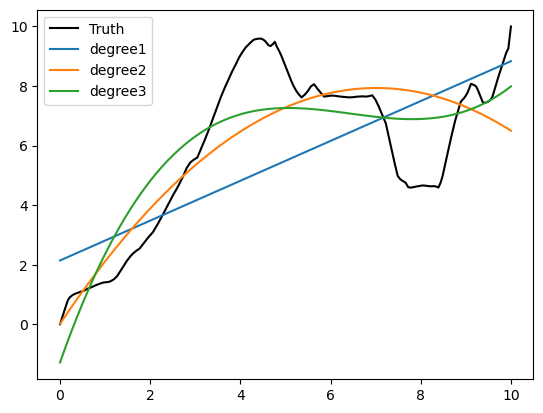

loss [0.05624652268570252, 0.08455929054194725, 0.14158610403085414]
mse [4.158485799376397, 2.3746783140875407, 1.8186306022905403]


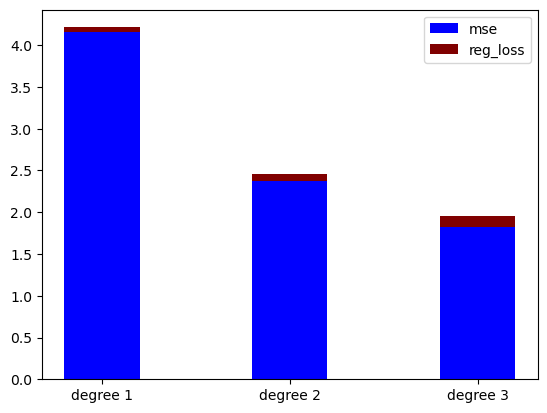

3c.tmall.com


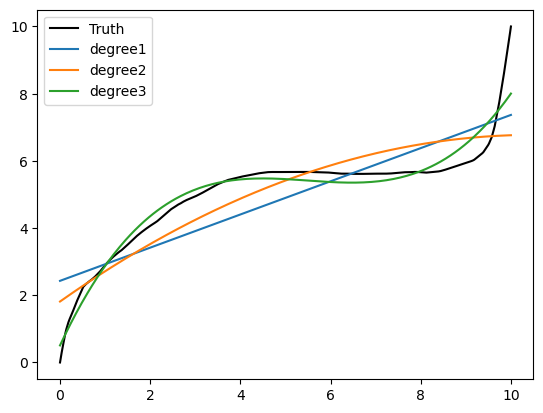

loss [0.05846906581297807, 0.10858332633086512, 0.17240233194343332]
mse [0.7991265554785989, 0.6643687998645578, 0.18455987285660042]


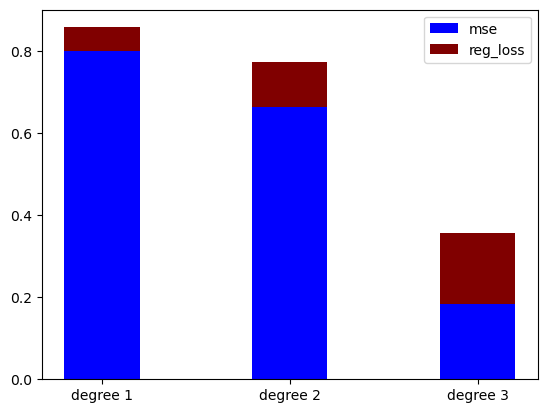

3dmgame.com


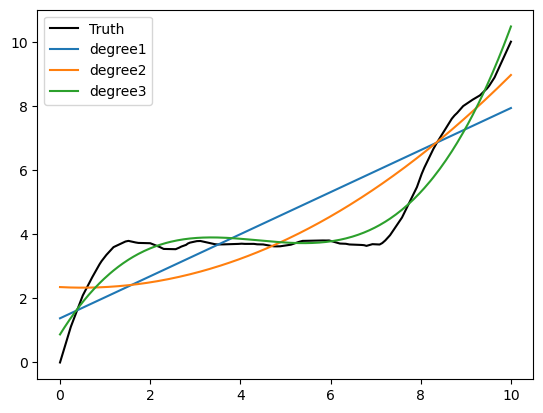

loss [0.04065666679823365, 0.09402589277448982, 0.15832103717617865]
mse [1.38996669721016, 0.9950537574369116, 0.18165735366723354]


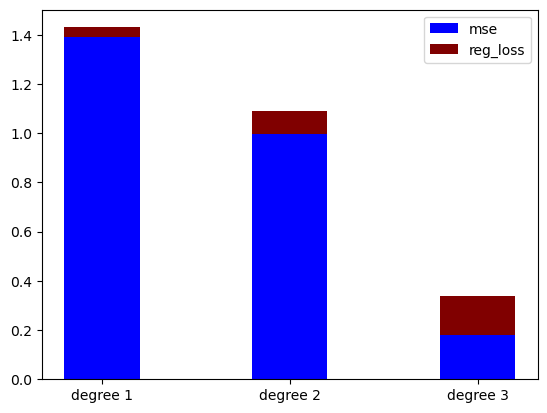

activetect.net


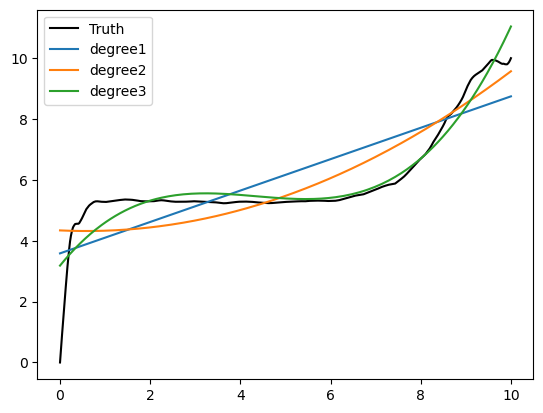

loss [0.08203440645361498, 0.17321806899269754, 0.27592632019749486]
mse [1.1618667226171342, 0.9254046190903902, 0.4024489746978906]


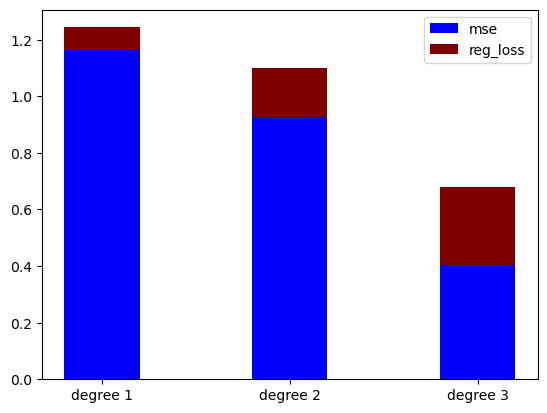

aimer.tmall.com


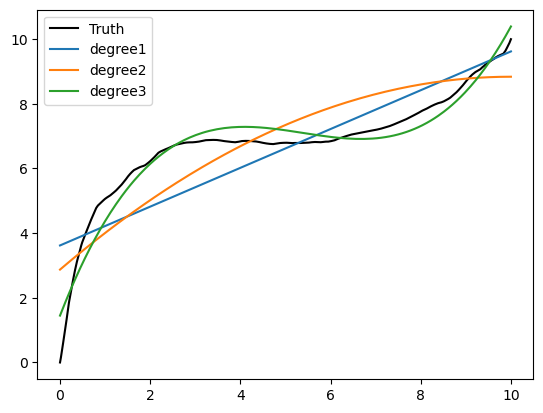

loss [0.08440320976006582, 0.16024648301727318, 0.26231729108020235]
mse [1.2937151544895689, 1.0347340544670387, 0.21245712328854077]


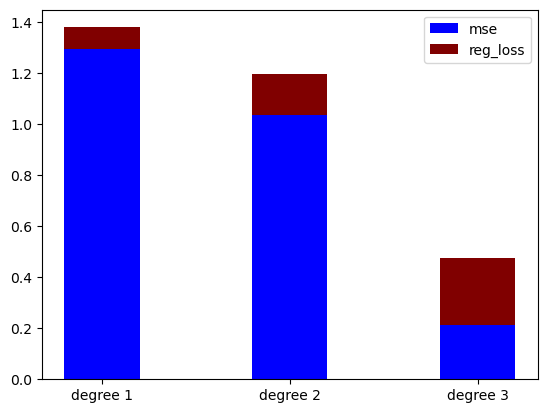

aliyun.com


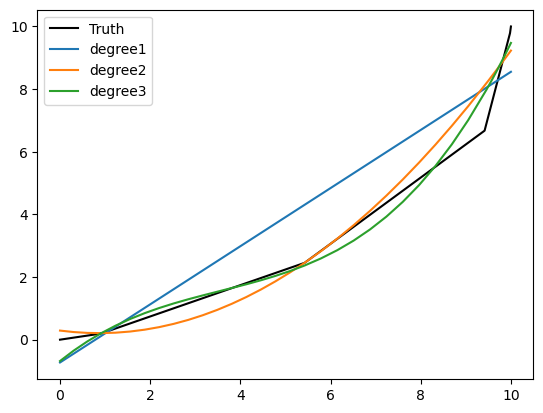

loss [0.004002084286763319, 0.008432010395166506, 0.016565195874591807]
mse [0.37003863382631685, 0.09312296806220463, 0.05067009074969541]


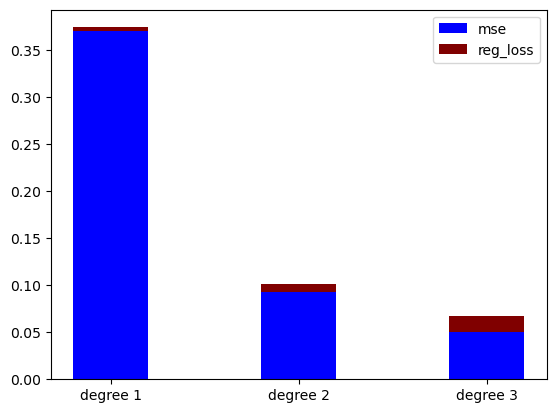

amazon.in


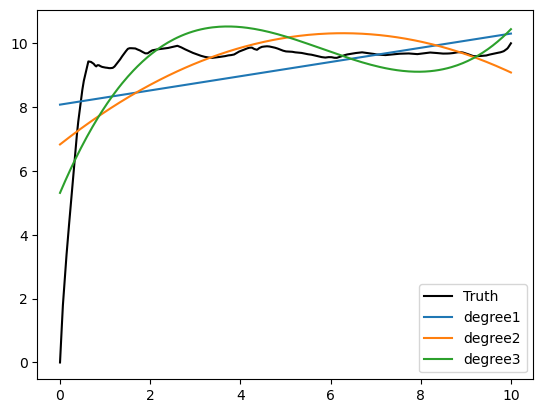

loss [0.16602050915378297, 0.3141487326376446, 0.48114836318823195]
mse [2.2425419707006315, 1.6976932708347494, 1.1022167939664596]


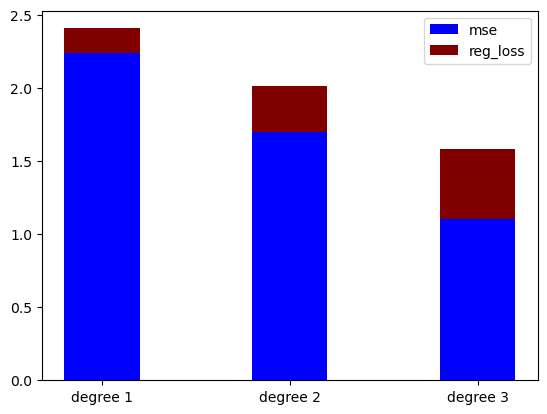

amazonaws.com


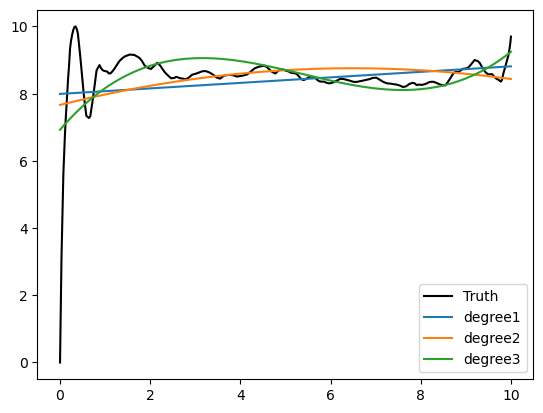

loss [0.1615024001498005, 0.31903728352071986, 0.48982162641800286]
mse [1.3284627645924694, 1.2790059201785335, 1.0739767417027866]


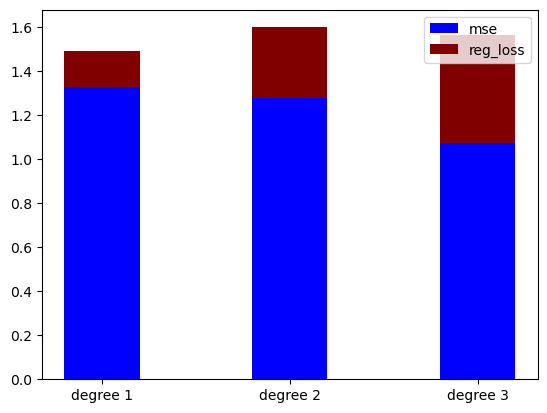

ameblo.jp


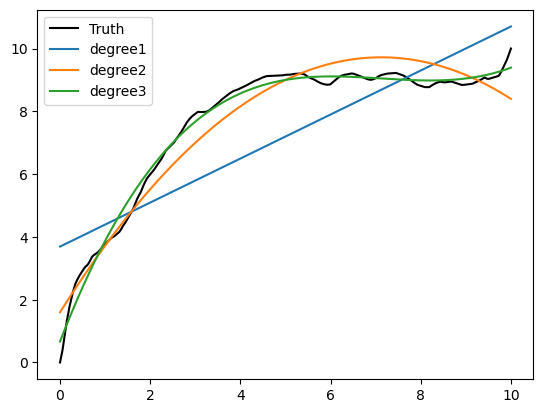

loss [0.08784833643091694, 0.14878934081105816, 0.23228767668861147]
mse [2.1037841716423884, 0.3620472186909716, 0.06913281151351473]


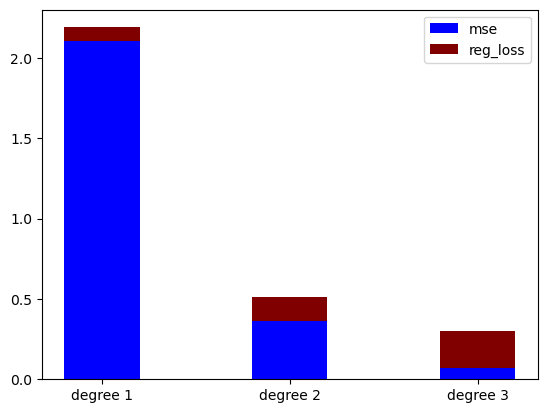

americanexpress.com


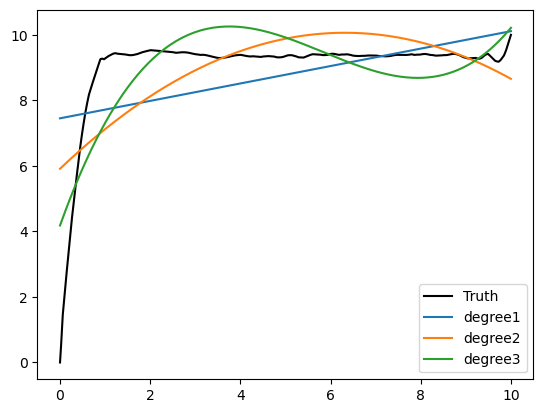

loss [0.15435016968107615, 0.28486449325400837, 0.4387098048160671]
mse [2.5985064194383733, 1.8254072414546092, 1.058476558744792]


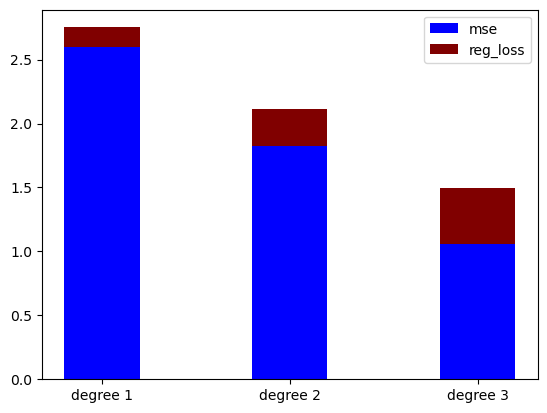

android.com


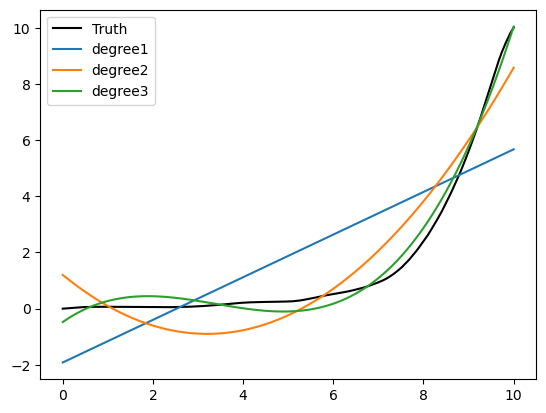

loss [-0.02313409625780092, 0.0037967667306204067, 0.016387984981067687]
mse [3.766953189443321, 0.7828333159368435, 0.0906426348701372]


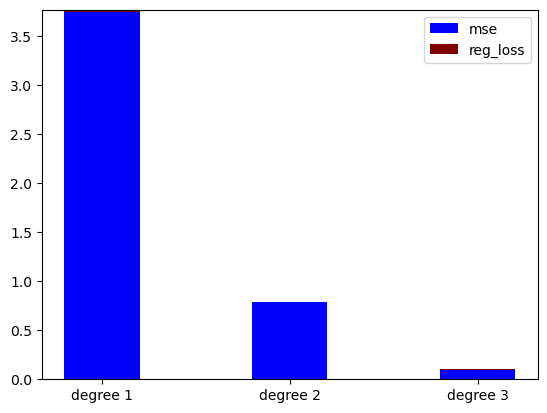

aol.com


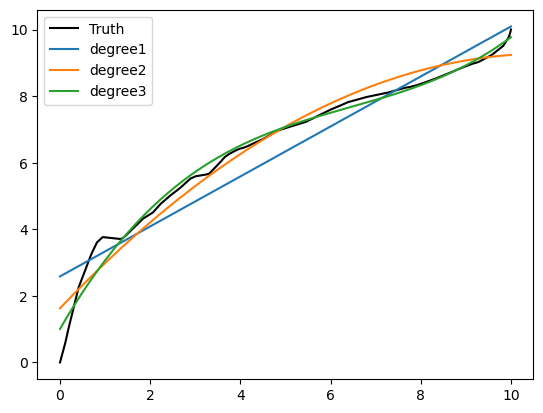

loss [0.06671148141200448, 0.11938385538795736, 0.18399602446083307]
mse [0.5312997177453402, 0.21079427842500176, 0.09048636565572497]


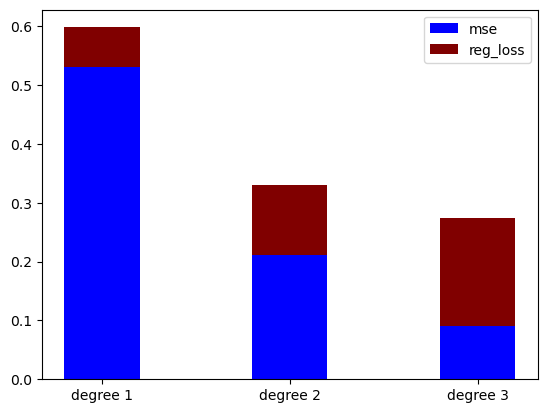

apple.com


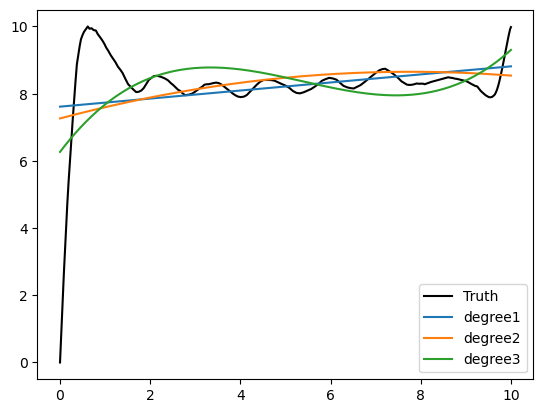

loss [0.15467526706923085, 0.303887275545727, 0.4607162262000851]
mse [1.7658256174320057, 1.7285742611139894, 1.4602872458435525]


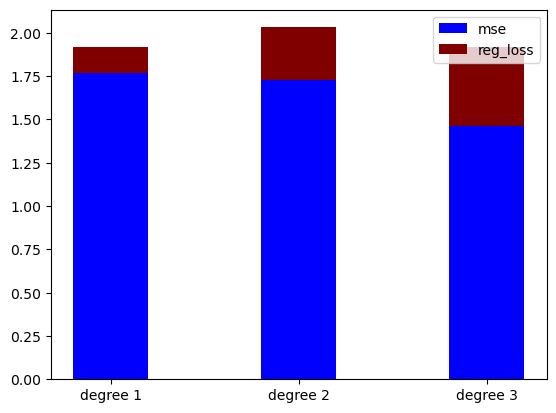

asana.com


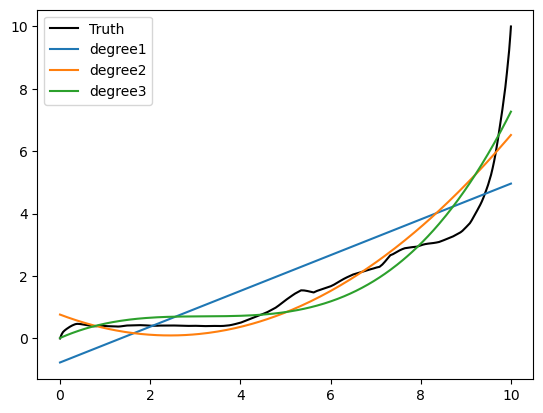

loss [-0.003936728883369294, 0.01316992799488721, 0.028526933870052975]
mse [1.5275905794941074, 0.6054088761212306, 0.4195513974412632]


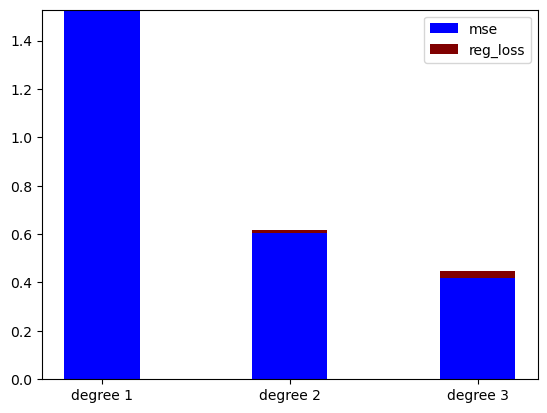

avito.ru


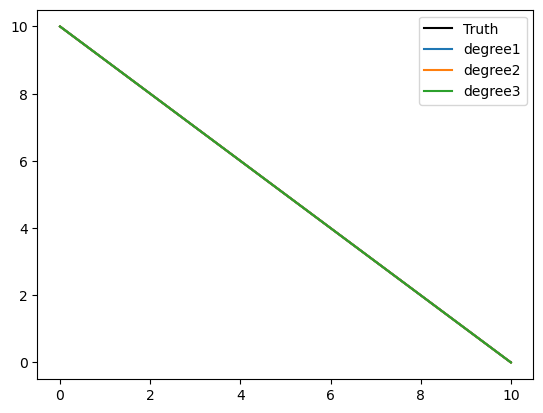

loss [0.1800000000000016, 0.36000000000000254, 0.5400000000000013]
mse [1.1592902893020376e-24, 1.1591754301032637e-24, 1.1612691213080883e-24]


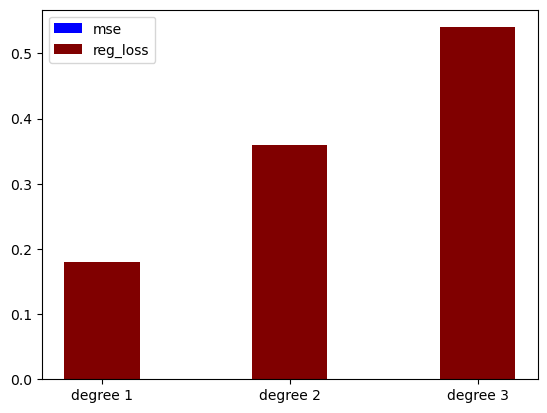

baike.com


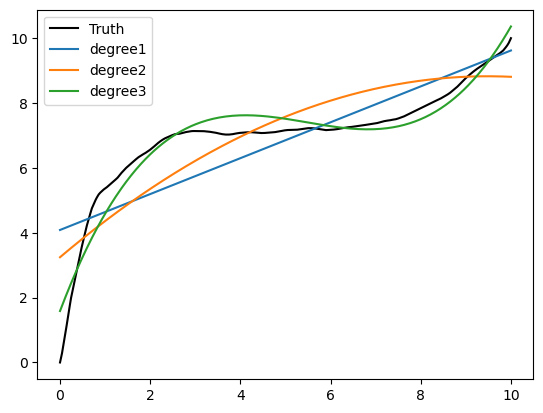

loss [0.09278665498643685, 0.17442802562917506, 0.27516152717129205]
mse [1.3455481861835985, 1.0788944031411662, 0.2331853486088142]


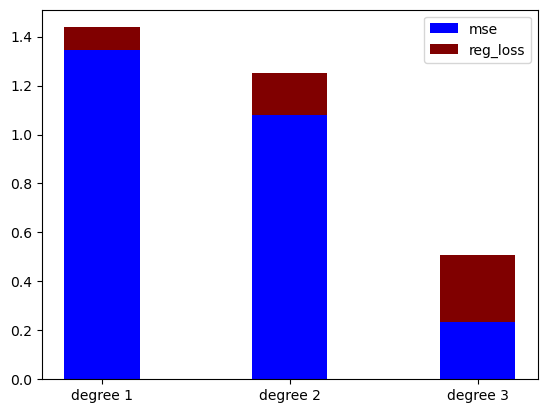

bancodevenezuela.com


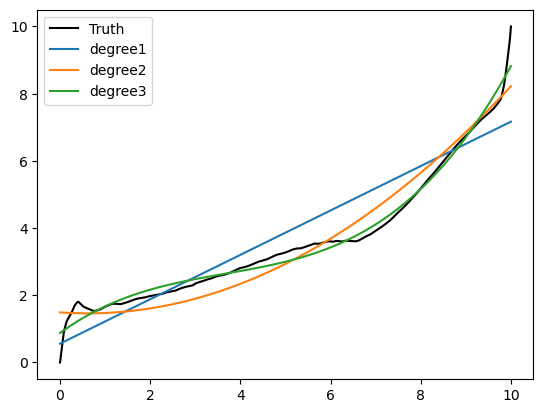

loss [0.024421670577603166, 0.058930550275974394, 0.1001785743458359]
mse [0.6908656402513316, 0.24341005271194255, 0.08081552628553186]


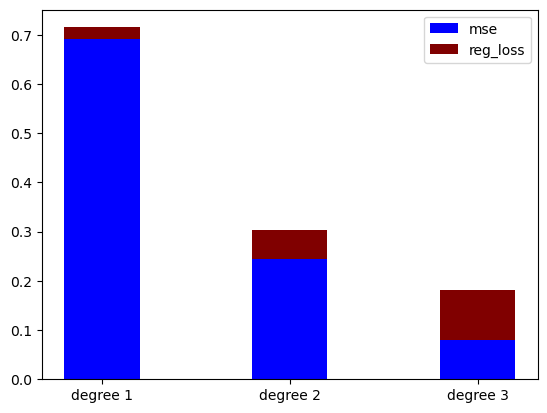

bandcamp.com


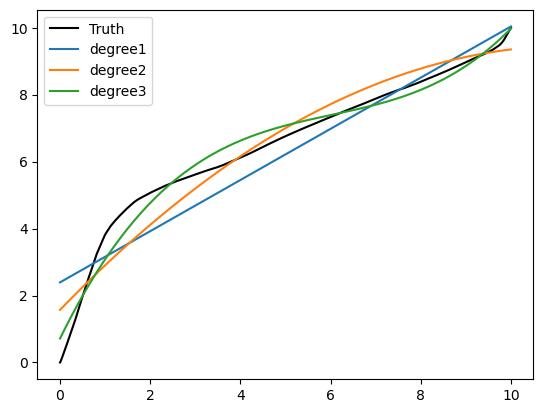

loss [0.06314898318979288, 0.11613384602064285, 0.18489190126168317]
mse [0.6317836917513864, 0.3552507344320353, 0.12102499478941665]


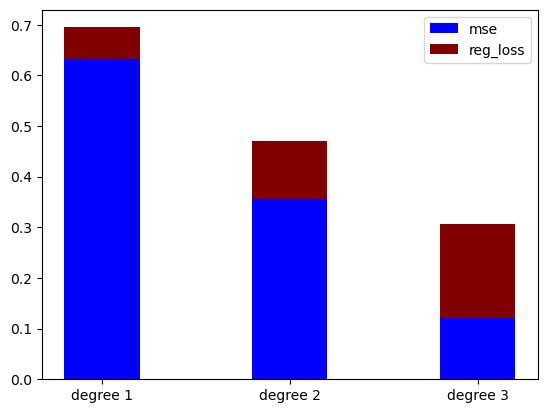

bankofamerica.com


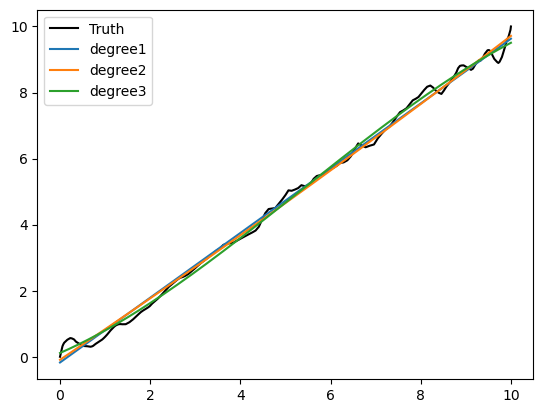

loss [0.016142772439227474, 0.03329170350515701, 0.04772600030201295]
mse [0.0457709505975445, 0.04301789909577295, 0.029024642515557284]


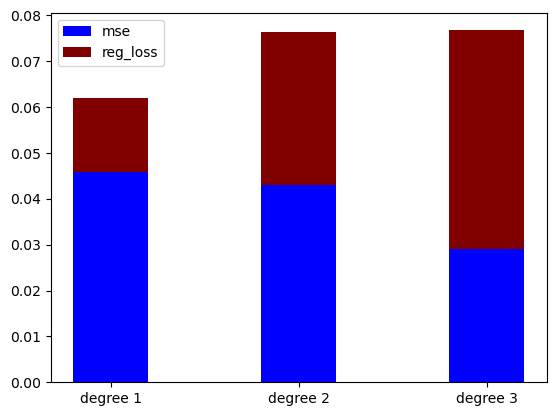

battle.net


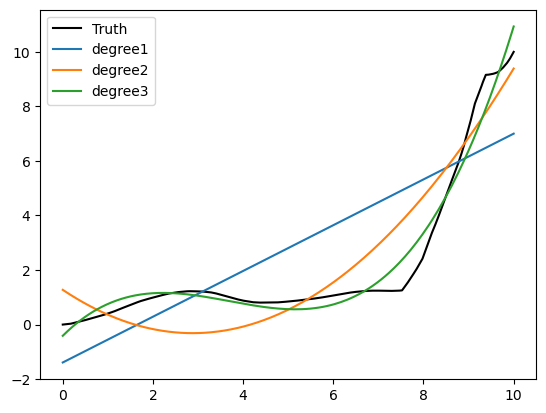

loss [-0.01102183747631828, 0.014484203286401334, 0.04535557454804879]
mse [4.107851727809998, 1.3223916041716222, 0.2438384781245161]


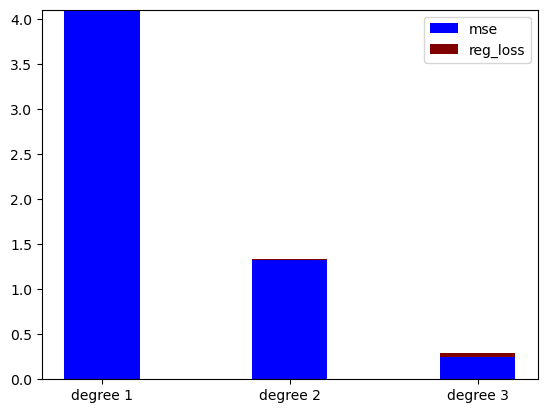

bbc.co.uk


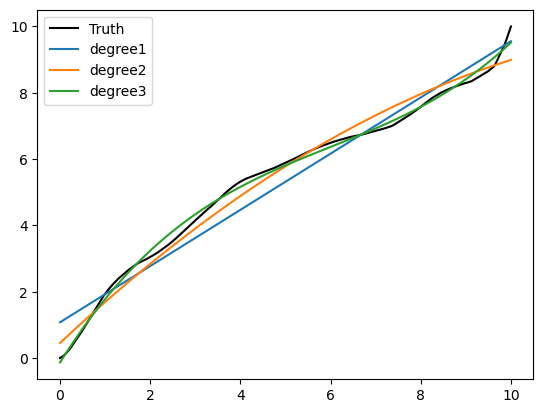

loss [0.03851066365045405, 0.06756298318730025, 0.10665436128845565]
mse [0.25889941590567817, 0.12737040598474483, 0.02257517767726599]


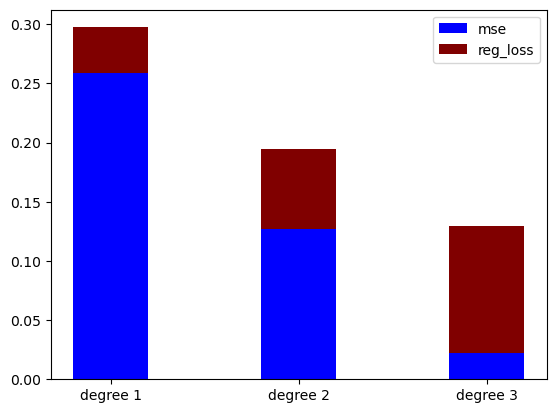

bbc.com


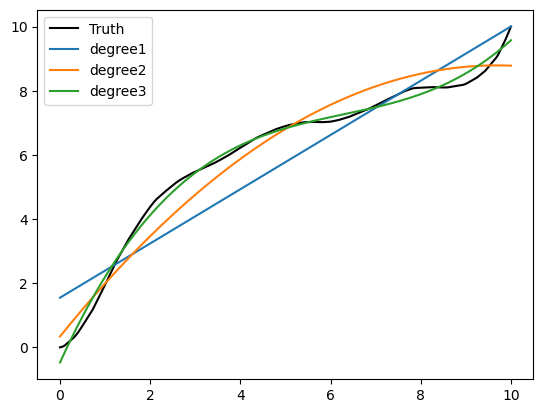

loss [0.047863427421646225, 0.07968918547255775, 0.13195255468552414]
mse [0.9213725474804464, 0.2993143817415161, 0.04077520355429003]


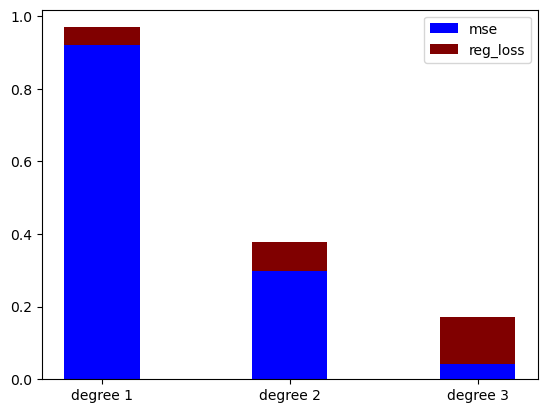

bleacherreport.com


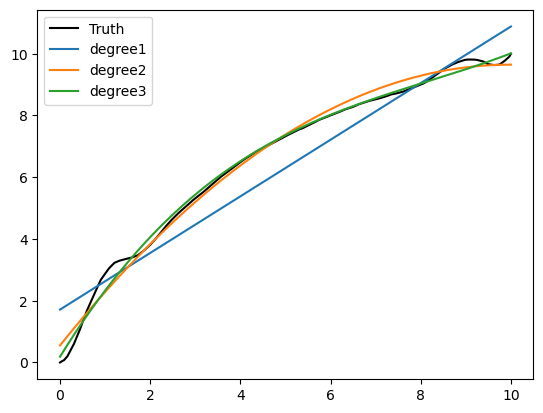

loss [0.05260554952902716, 0.09133705059430261, 0.1397650326414943]
mse [0.6313088889536267, 0.08971848014273065, 0.04923515013088427]


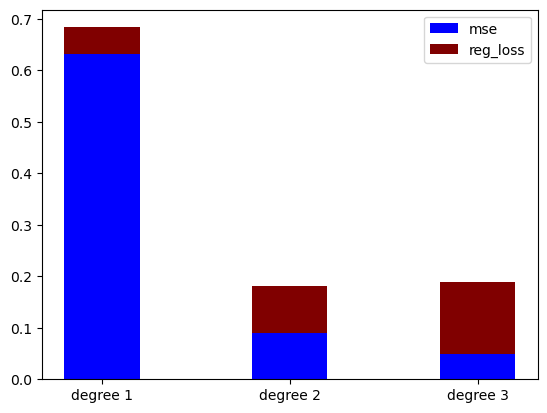

blogger.com


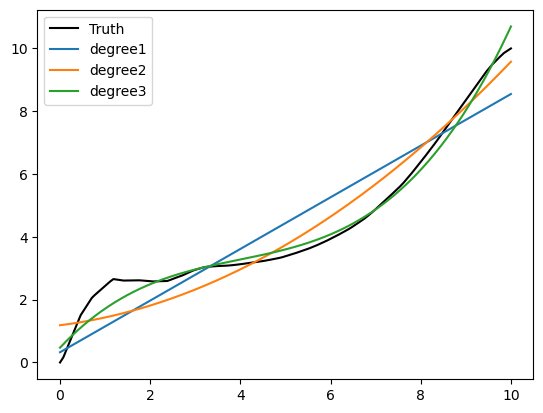

loss [0.022971176037324882, 0.057343748679837256, 0.10284672089544662]
mse [0.7367131940991062, 0.3997715577102649, 0.09111370571267574]


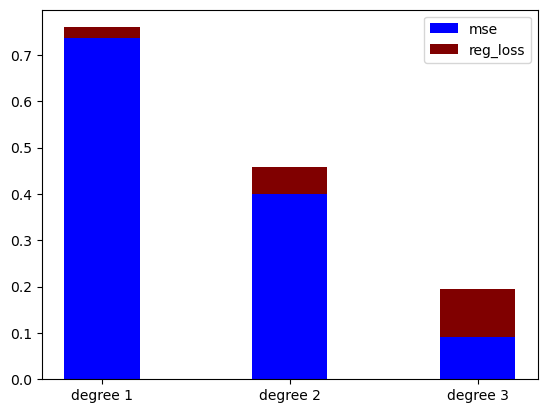

blogspot.com


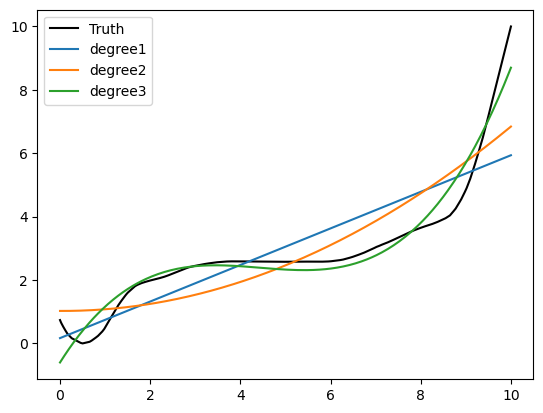

loss [0.014887879817691818, 0.04308879531040732, 0.06964390857978796]
mse [1.117257118416826, 0.8978696042133667, 0.21765863397718307]


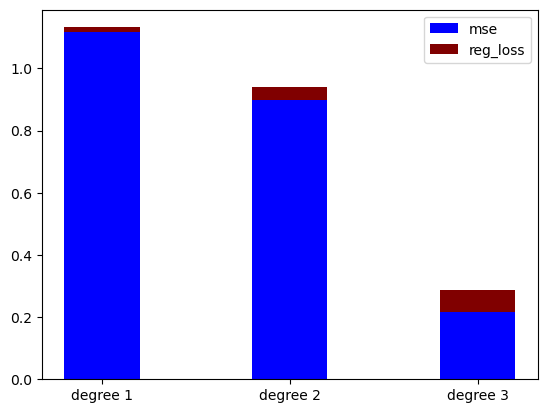

box.com


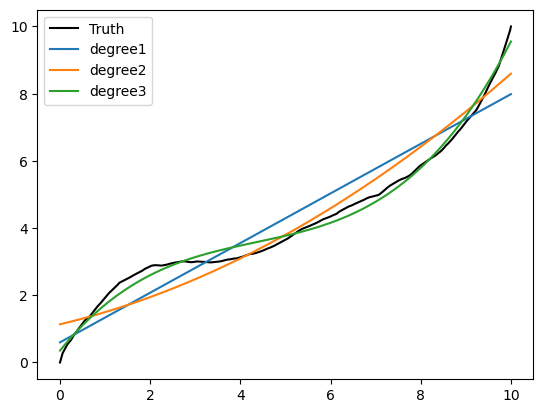

loss [0.026758577684761375, 0.059942102129045036, 0.10318996293113092]
mse [0.43993246127472074, 0.30821294421240353, 0.04030541931583127]


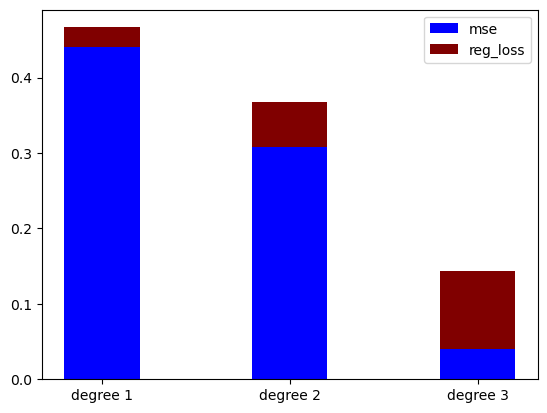

bukalapak.com


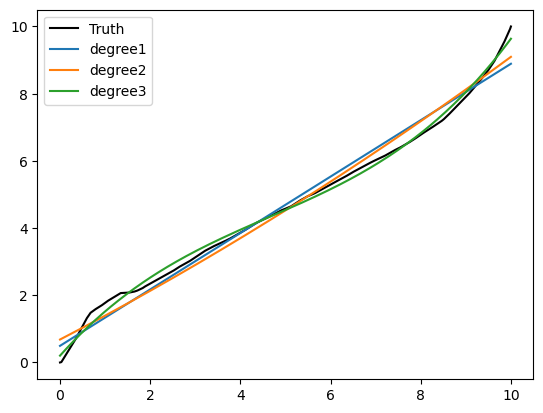

loss [0.026696917705313874, 0.055742460556418405, 0.09117470294189765]
mse [0.1233584030943661, 0.10801232708255337, 0.024447603624788823]


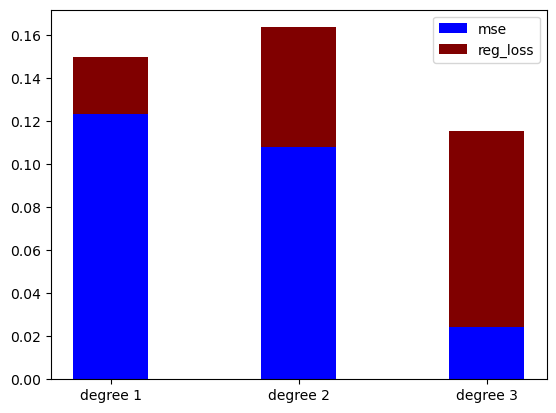

ca.gov


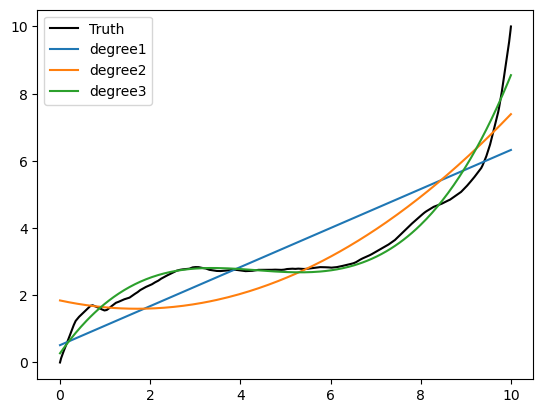

loss [0.021935352587212388, 0.06567844776662175, 0.10519960144027164]
mse [1.183353843813232, 0.6913735628898994, 0.14614824622314262]


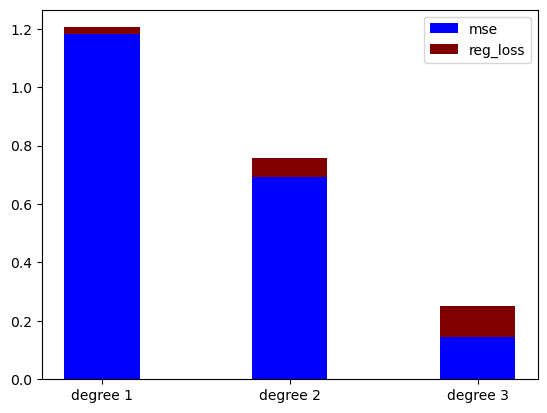

cdstm.cn


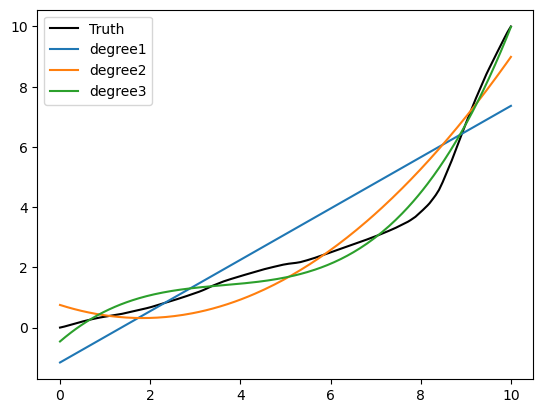

loss [-0.006135448052713444, 0.01623894624888892, 0.032361278248608155]
mse [1.6875777444936526, 0.49967278142560023, 0.1154779719635505]


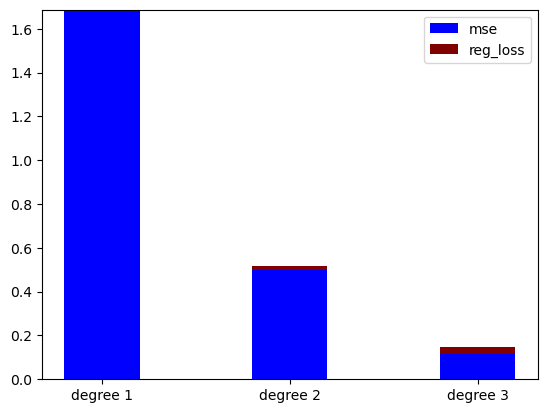

ci123.com


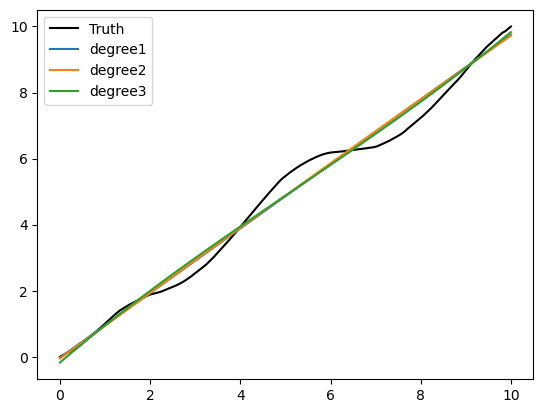

loss [0.019077732598280144, 0.037731834908673594, 0.05706045961728318]
mse [0.09573829388979176, 0.09548453438858738, 0.09194517139921078]


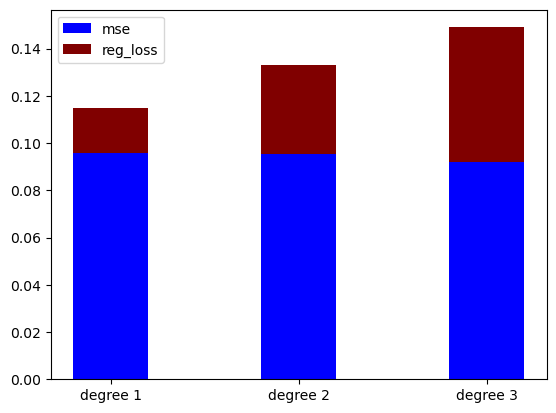

cnblogs.com


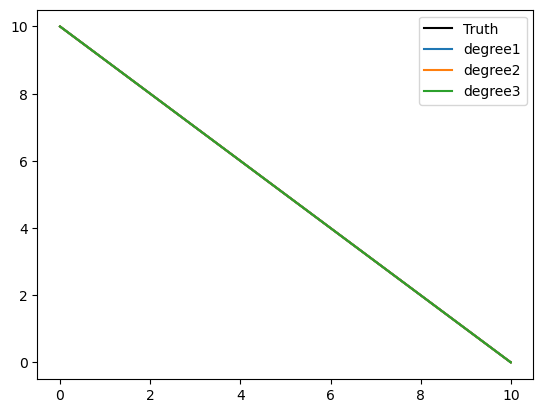

loss [0.1799999999999983, 0.35999999999999077, 0.5399999999999174]
mse [3.219237206816203e-24, 3.2175152278690386e-24, 3.113839276151258e-24]


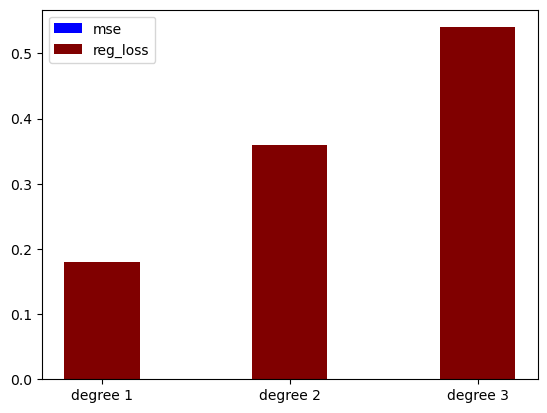

cnet.com


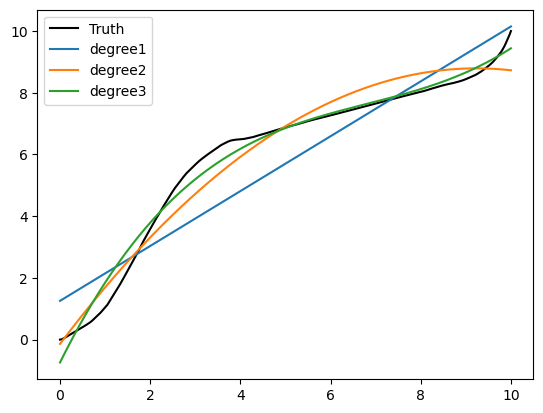

loss [0.04289754860831607, 0.06763602326953916, 0.11080017484793837]
mse [1.0993763915595989, 0.29386567262764185, 0.1350897112483945]


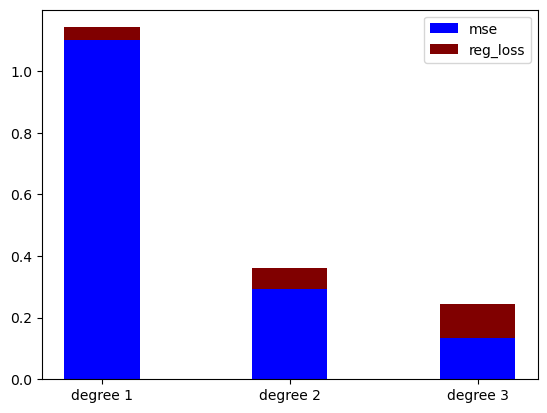

cnn.com


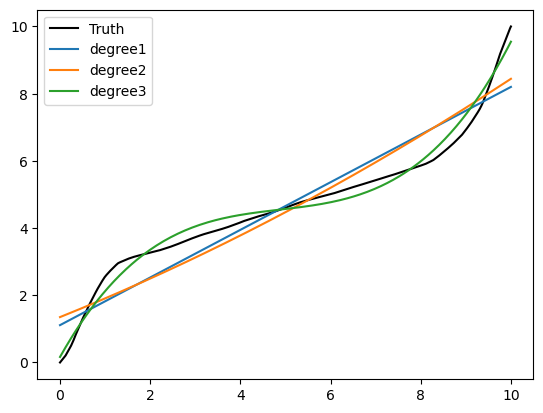

loss [0.03640603763018205, 0.07628689493137832, 0.12742842180394642]
mse [0.5151092991333436, 0.4938472022709736, 0.06851360638948813]


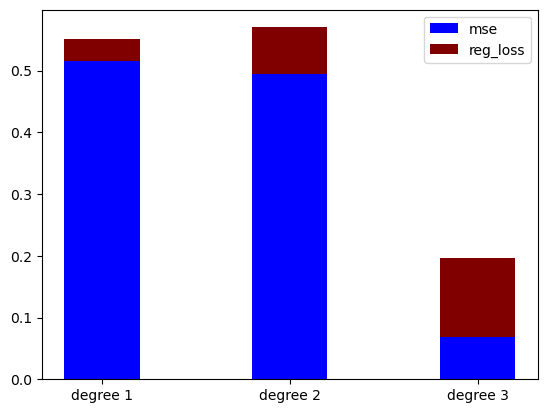

crabsecret.tmall.com


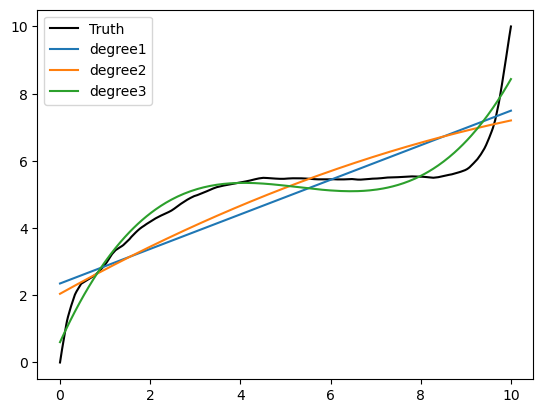

loss [0.05730571964653425, 0.11074287370052899, 0.17985715157082033]
mse [0.9025436154357911, 0.8652730758461242, 0.21117961880121291]


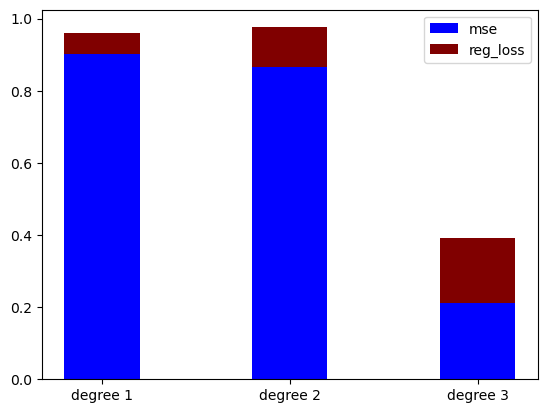

cricbuzz.com


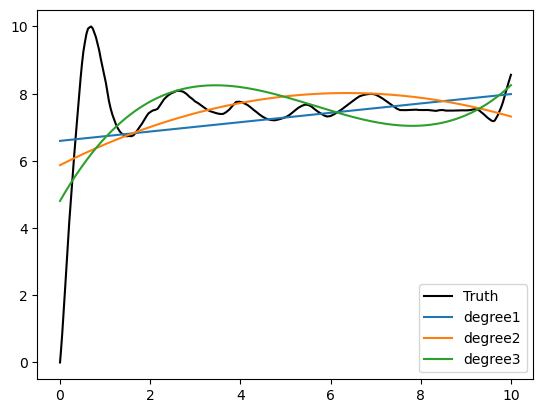

loss [0.134689758914414, 0.2597521829300639, 0.4013419047949997]
mse [2.443422461913382, 2.23591844196005, 1.8565025671144255]


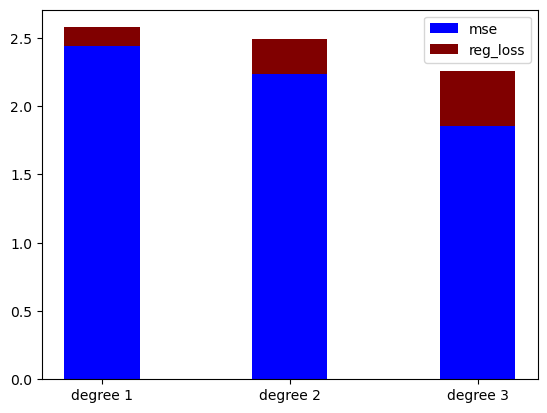

crptentry.com


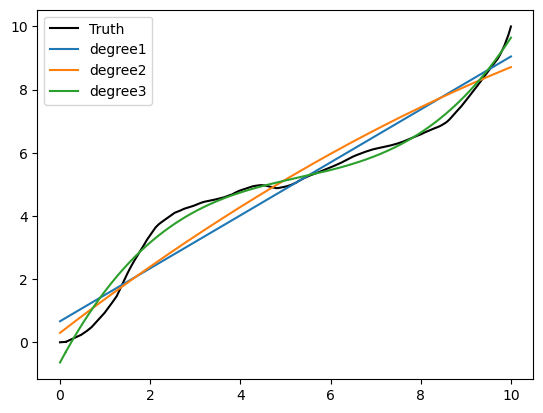

loss [0.030086693460272127, 0.05492184438258582, 0.09730500037687016]
mse [0.4759381083972158, 0.4234959533835861, 0.06429126538047775]


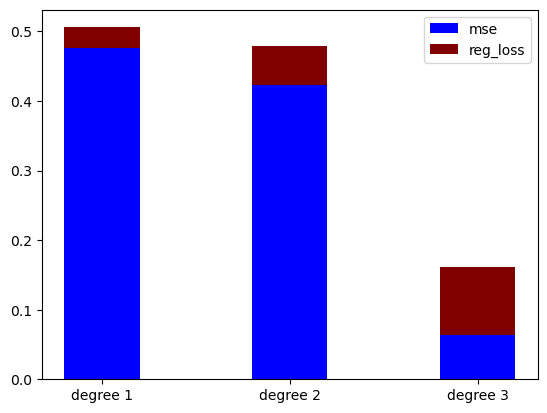

cryptobrowser.site


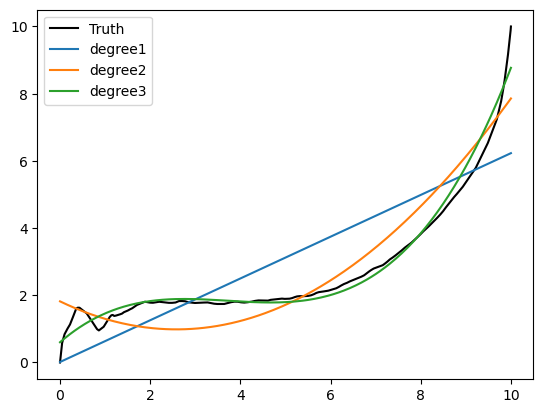

loss [0.012710216438792964, 0.051944317795539964, 0.08757407742955906]
mse [1.6878047702186616, 0.51460933970739, 0.10950064399719174]


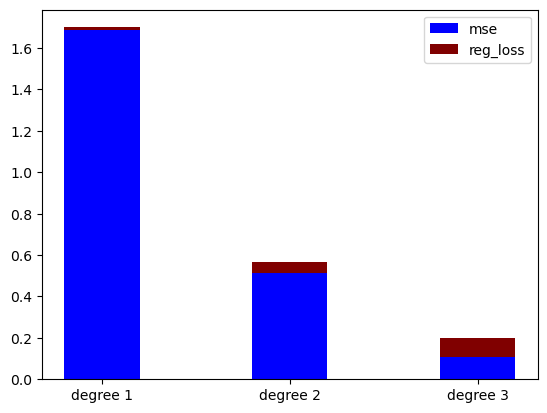

csdn.net


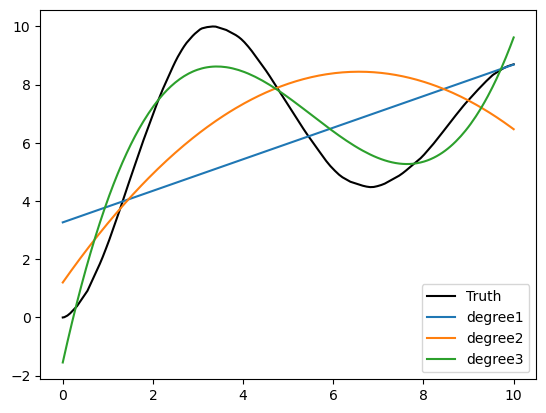

loss [0.07620567761374011, 0.12958266718362485, 0.24345735842592725]
mse [6.795526018997065, 4.689179510674274, 0.8666586944866376]


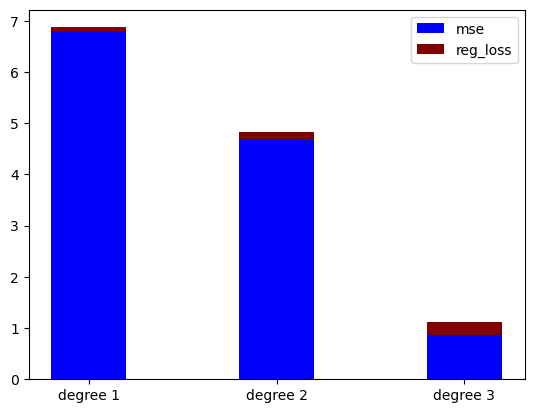

dailycaller.com


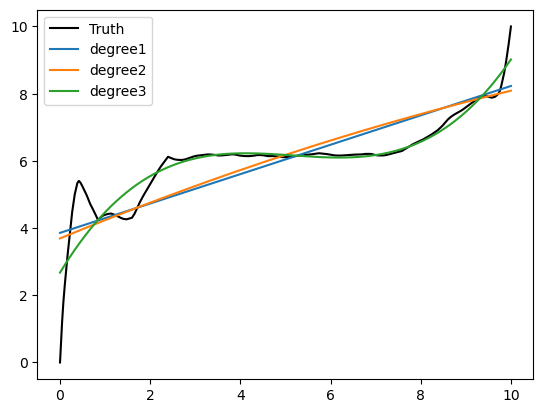

loss [0.08588550199345708, 0.16943392922994988, 0.26833067669006216]
mse [0.7395973070811447, 0.729482305210334, 0.3529209538530067]


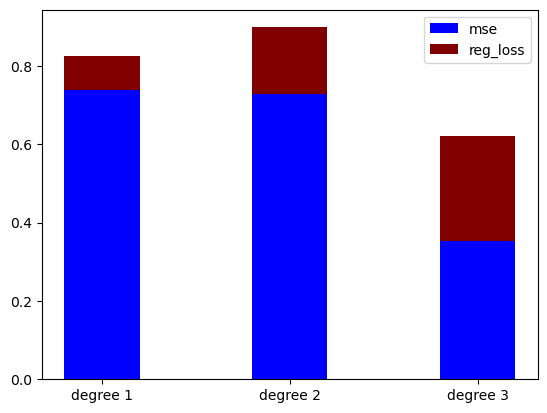

dailymail.co.uk


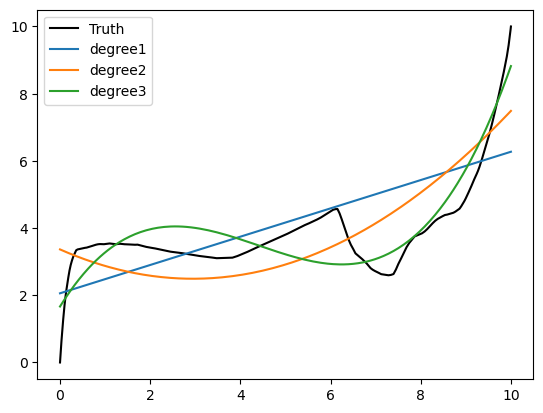

loss [0.04960333947918318, 0.11493243543893045, 0.19652412044641232]
mse [2.1506272113156975, 1.4236222640057021, 0.48552966541671744]


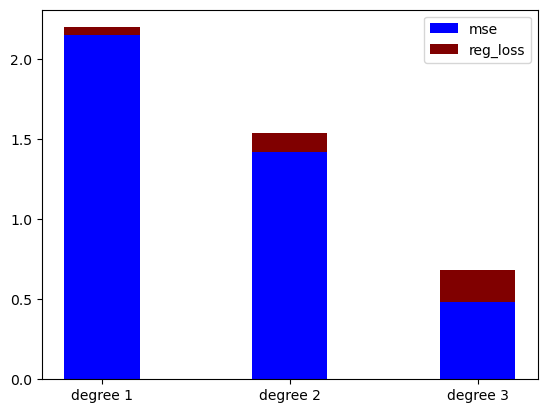

dailymotion.com


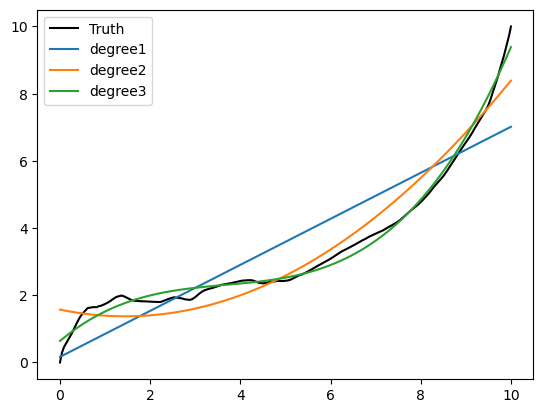

loss [0.01703346979008124, 0.055689644251911766, 0.09109375995271528]
mse [0.9609816358676486, 0.3094852164761591, 0.043693444214104385]


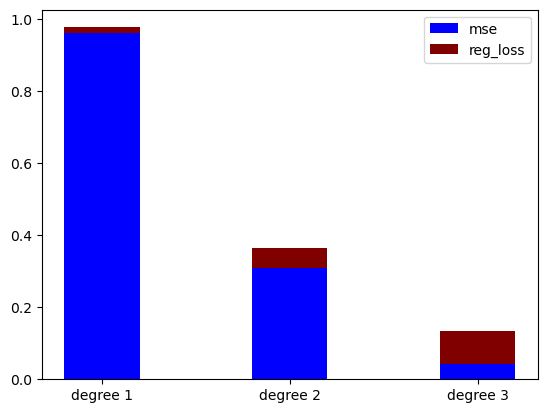

detail.tmall.com


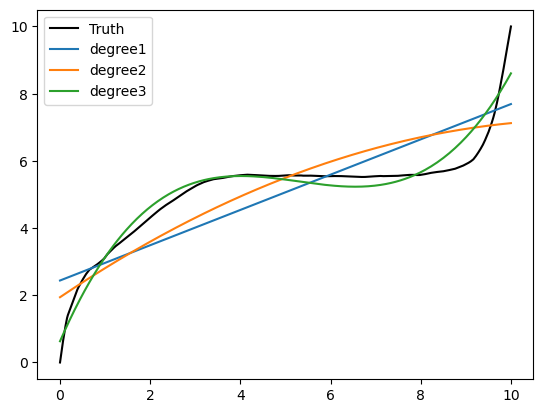

loss [0.05929338300849751, 0.11230650585838234, 0.18790785093398912]
mse [0.9843258923402232, 0.8738385046731248, 0.15813840008106533]


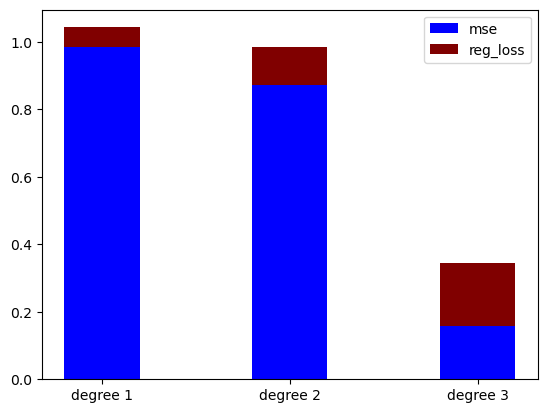

digikala.com


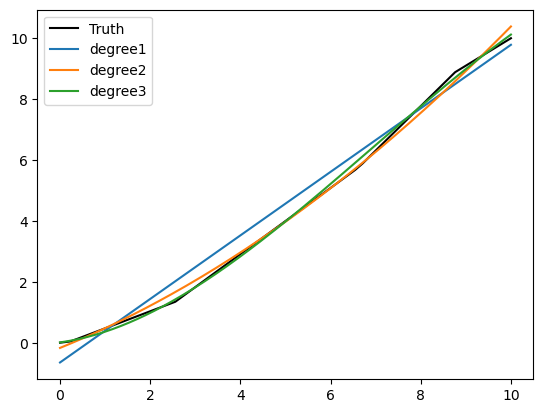

loss [0.007883150077468603, 0.019059183034526975, 0.021712097653505742]
mse [0.19468741615626745, 0.0347963410957375, 0.009486305195134785]


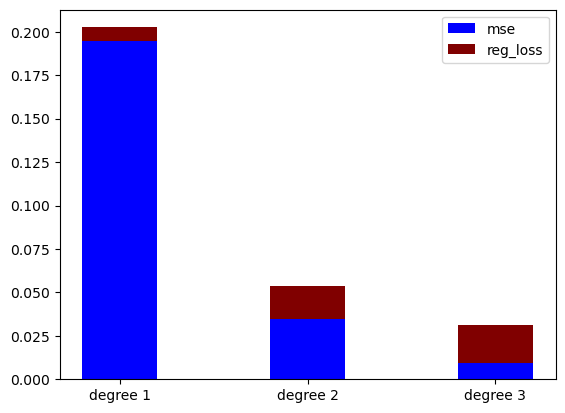

diply.com


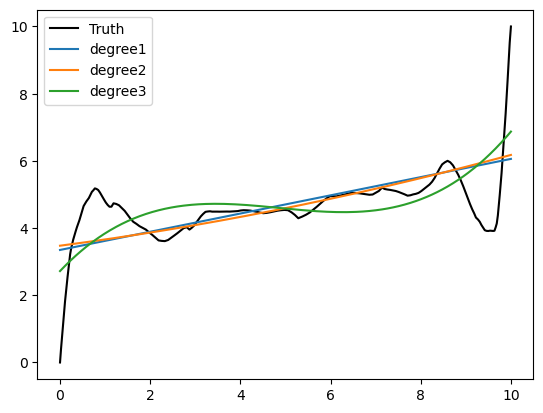

loss [0.07239638794119665, 0.14645308516777128, 0.23060566365365887]
mse [1.4439058348525977, 1.4372138549329148, 1.2127276063010413]


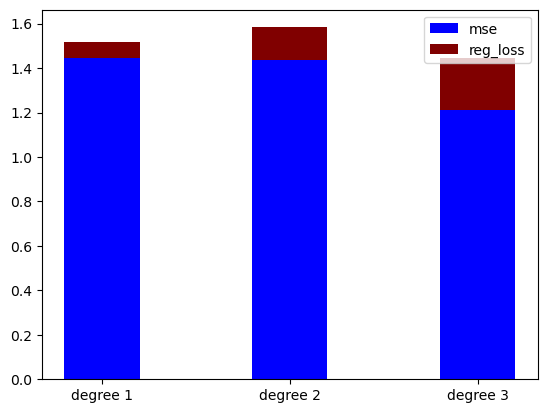

dkn.tv


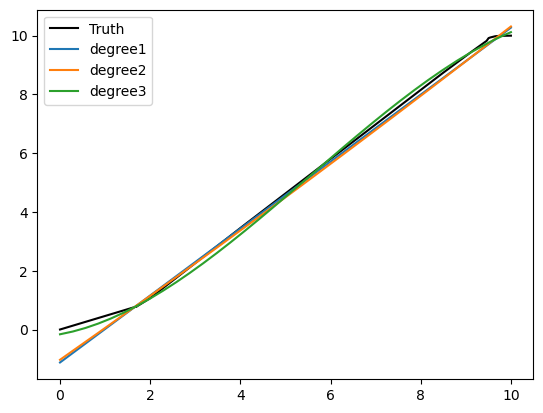

loss [0.0003518486765694373, 0.0020987704051538447, 0.017558568003153578]
mse [0.019749090922871887, 0.019173686414910344, 0.0042059304128312085]


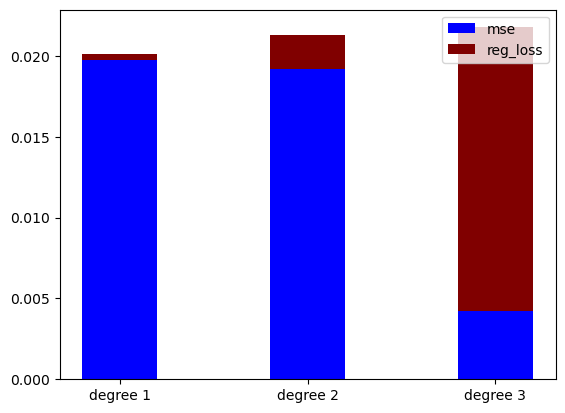

dmm.co.jp


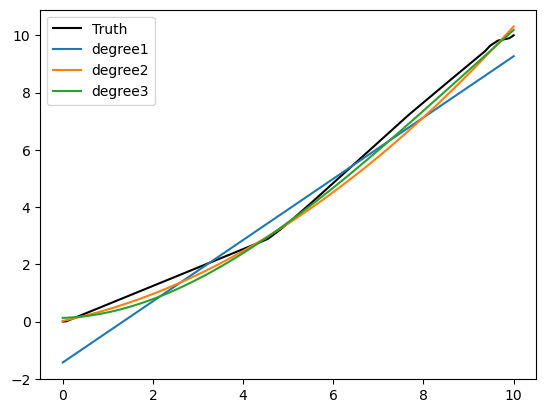

loss [-0.007202927596945799, 0.016944125553927776, 0.019222813623513982]
mse [0.48999237026090087, 0.03249130748324329, 0.025257977575929336]


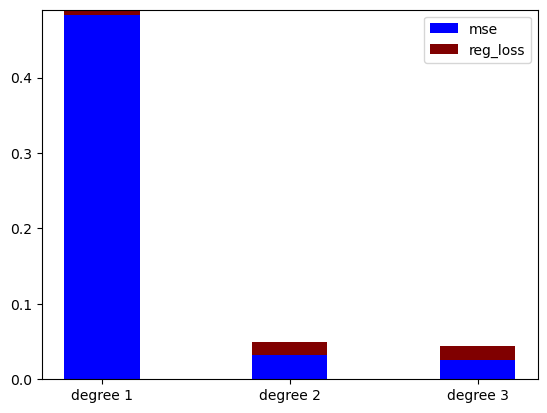

doubleclick.net


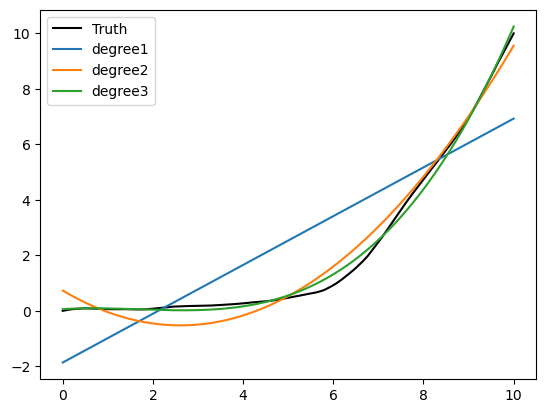

loss [-0.019663325779355992, -0.0019106878629375902, 0.005155608712129666]
mse [2.672310117996027, 0.18099248855909164, 0.03058355223695715]


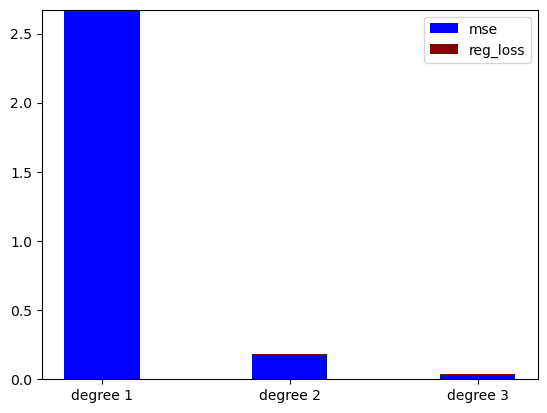

drive2.ru


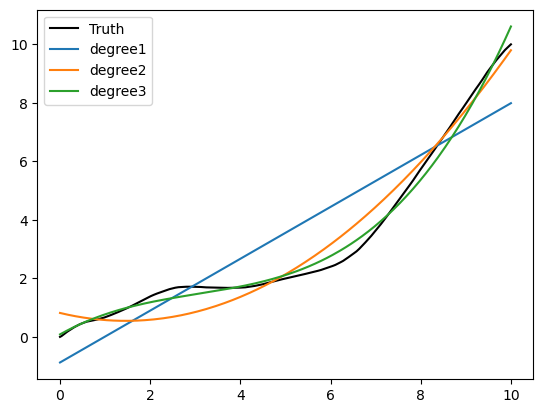

loss [0.00022826584464675115, 0.02299592162565527, 0.046241339740771464]
mse [1.505897036692041, 0.27697573654348046, 0.05982459083796542]


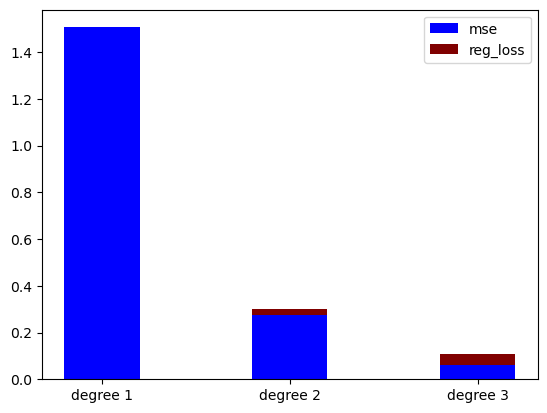

drom.ru


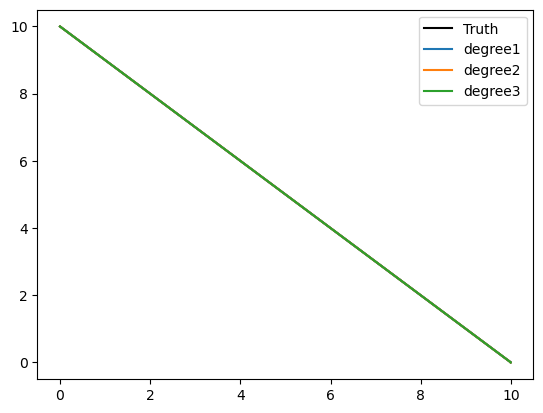

loss [0.17999999999999106, 0.32477232813475565, 0.5190414041948074]
mse [5.0415426817390744e-23, 1.3665575312244836e-24, 1.3665590230684437e-24]


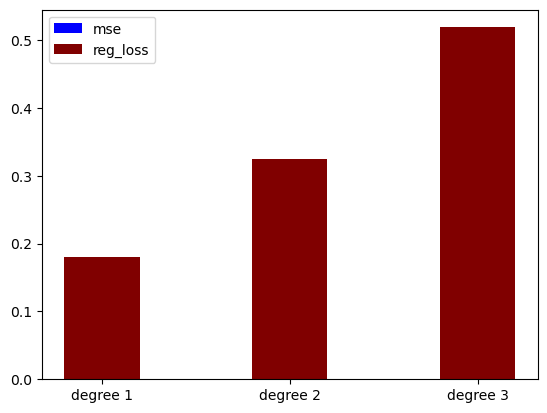

duba.com


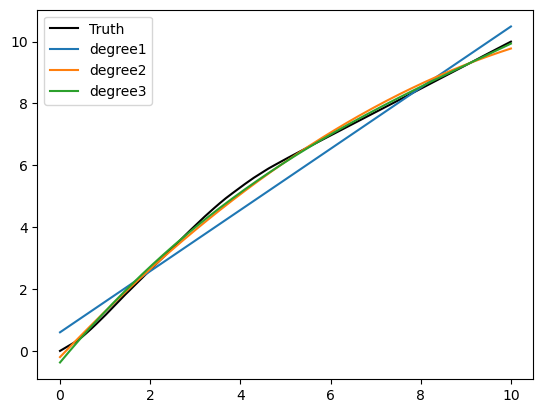

loss [0.03180549709125972, 0.05103475198637302, 0.07642608162327066]
mse [0.18450859546814055, 0.016074338220012634, 0.010261203742803402]


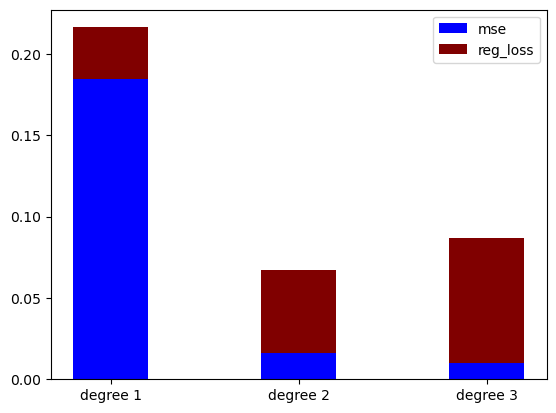

elmundo.es


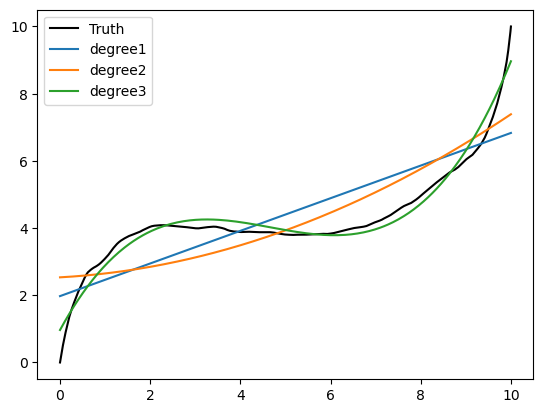

loss [0.049216240625144535, 0.10596404567274753, 0.17328192771010098]
mse [0.9860302225206606, 0.8706482172375221, 0.09695852203238478]


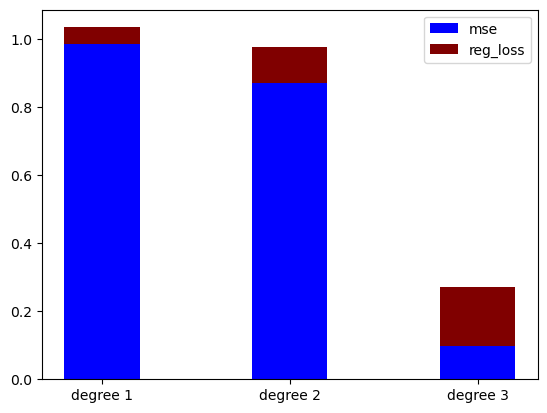

elpais.com


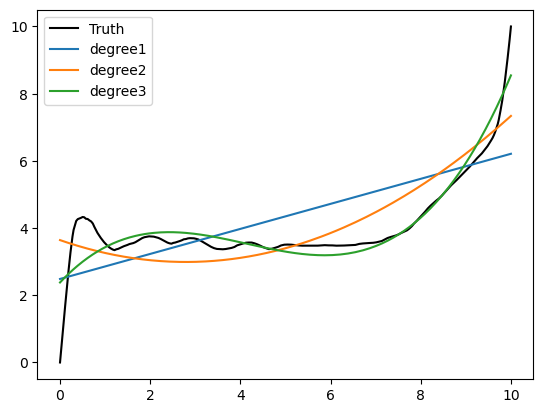

loss [0.05716694282208366, 0.13037071845822717, 0.20583277913900774]
mse [1.3553396477746622, 0.857285186864455, 0.3288345837658684]


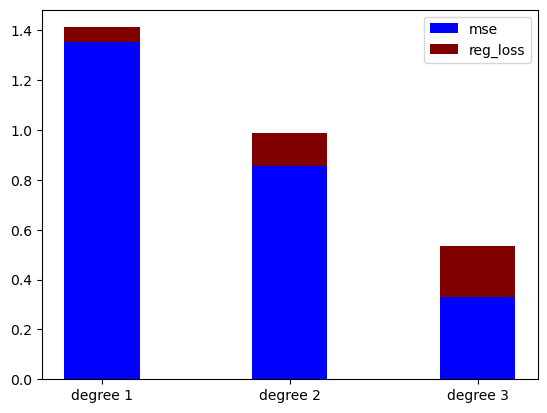

elsevier.com


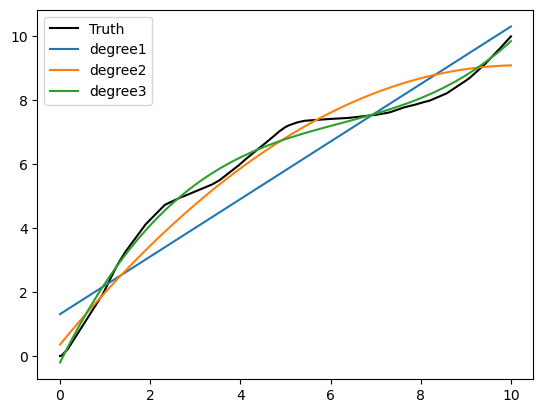

loss [0.04417535768245816, 0.07950402652567058, 0.13662687650292799]
mse [0.8436698924674074, 0.27226269913841766, 0.032017838228589904]


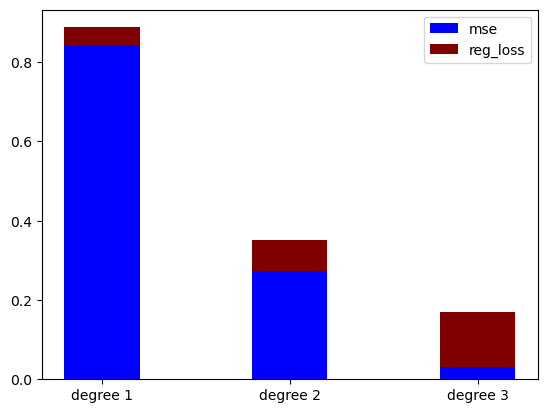

emol.com


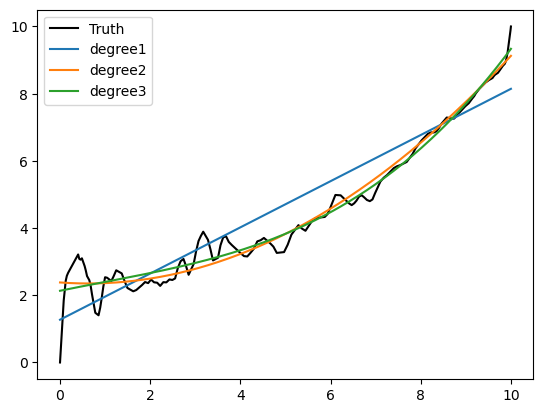

loss [0.03919631541952656, 0.09448507417332003, 0.1439037026944348]
mse [0.612615622913084, 0.17740092908171054, 0.15938791064352745]


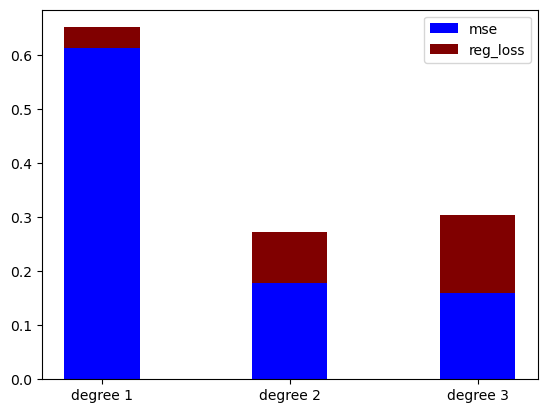

engadget.com


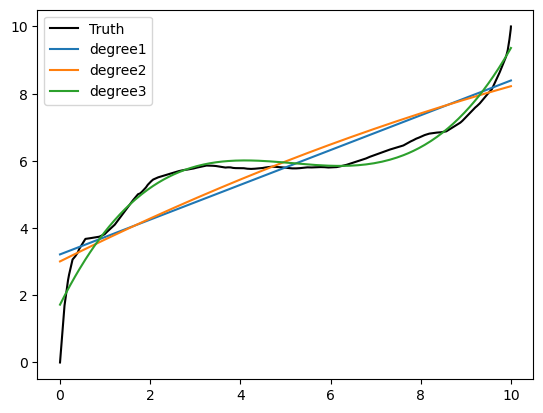

loss [0.07468818734043386, 0.14645228413688294, 0.23376147941500125]
mse [0.7024102443175672, 0.6869197523463724, 0.10386628532785724]


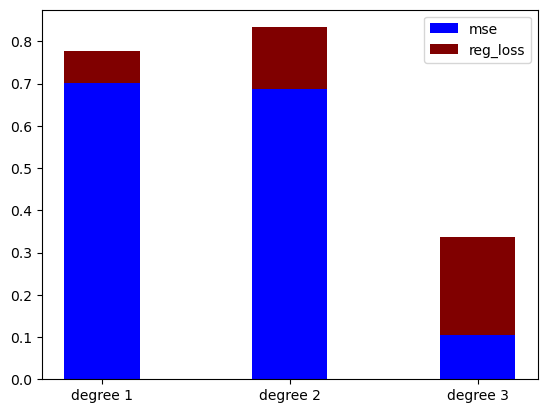

etsy.com


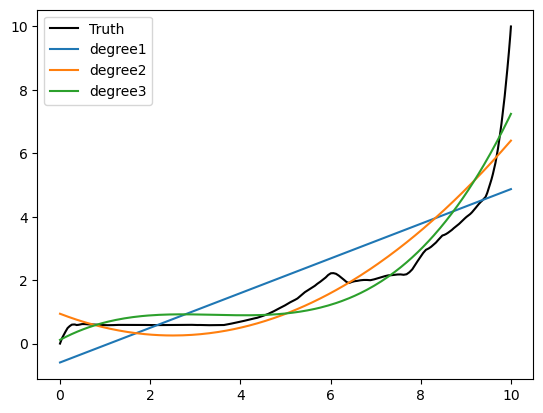

loss [-0.0009865300732205483, 0.02009808641589073, 0.04007356321104238]
mse [1.4683810226678145, 0.5871663558850885, 0.3690096402280958]


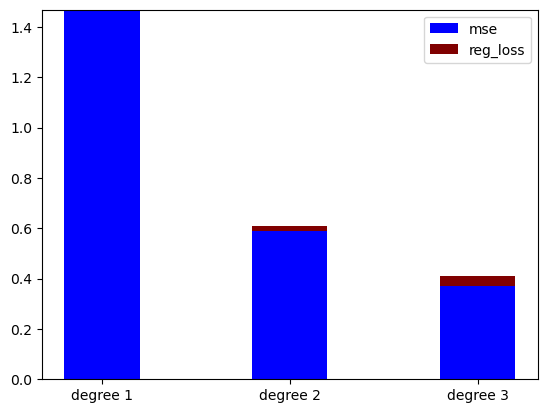

ettoday.net


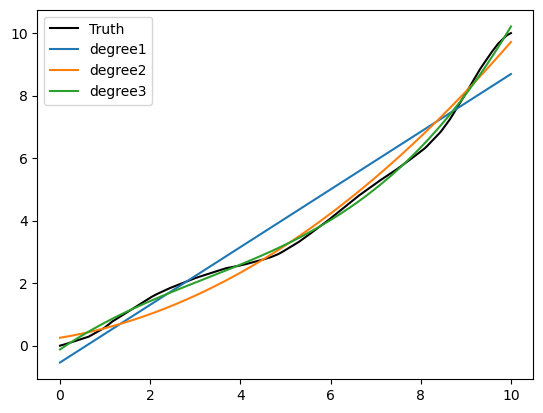

loss [0.007698756856105038, 0.022422339902397958, 0.04444813931622819]
mse [0.47866537292284955, 0.09703476024596373, 0.013940550617159021]


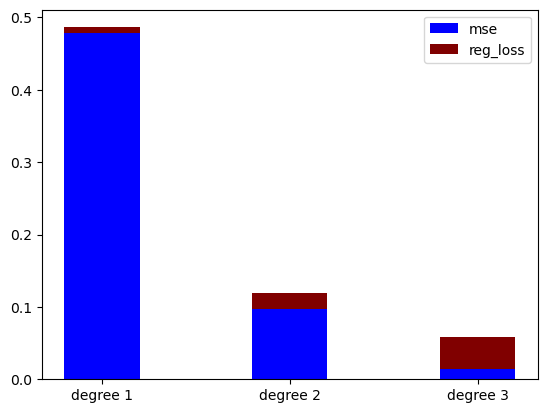

europa.eu


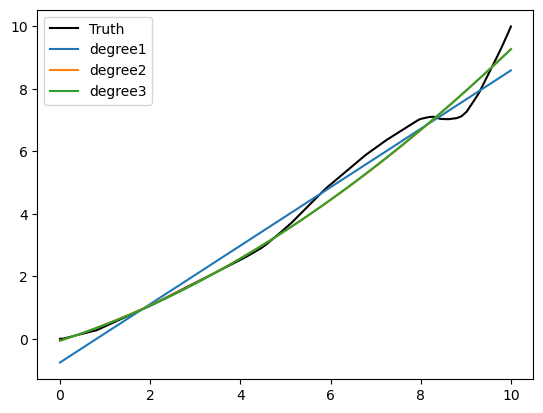

loss [0.0035587800443914784, 0.018362141501875026, 0.027123830717690662]
mse [0.27384687459877194, 0.07711714936512548, 0.07706575268959312]


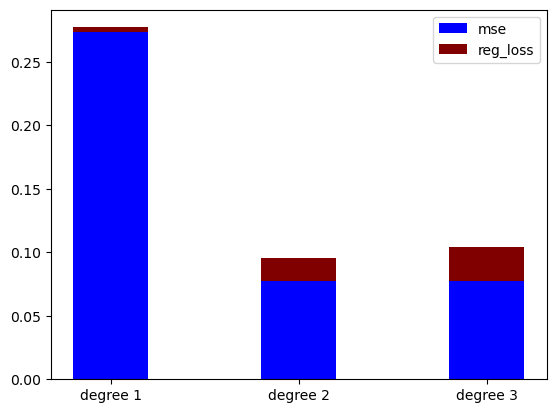

fb.ru


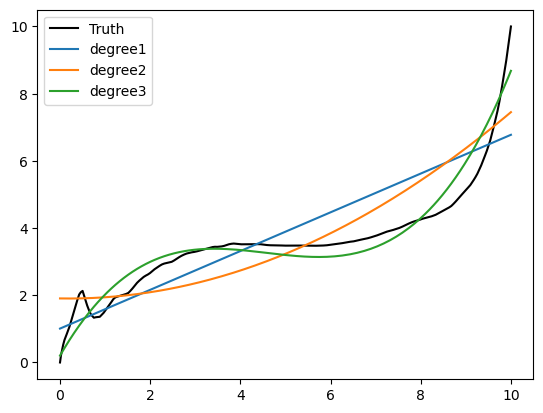

loss [0.031714195633571335, 0.07762918635953223, 0.12139019100195926]
mse [1.186063986317901, 0.9535566340666635, 0.24464119847487875]


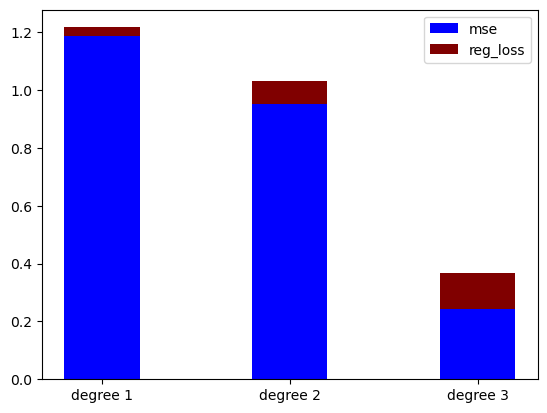

flipkart.com


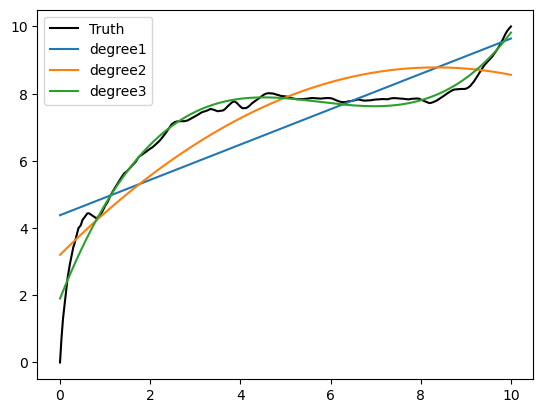

loss [0.09818374805461443, 0.17841231770650368, 0.28204451450465823]
mse [1.1561057417346825, 0.6708065355611532, 0.10424805288323598]


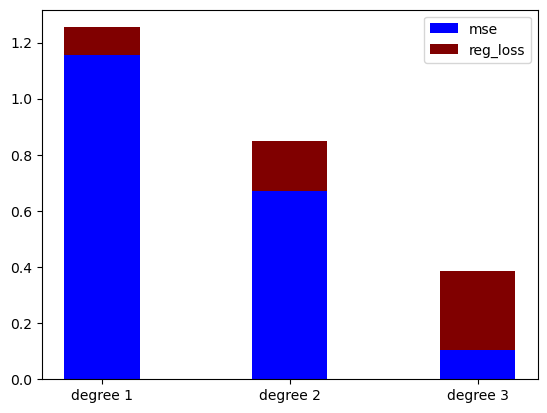

food.tmall.com


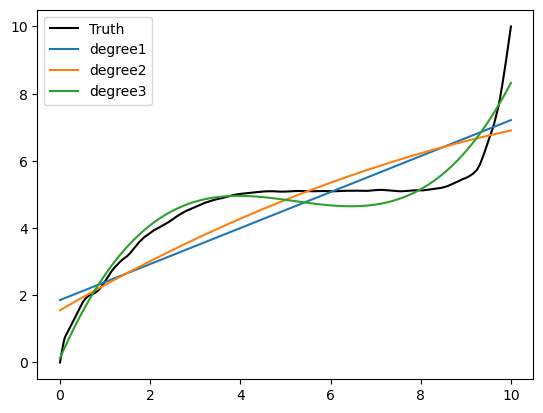

loss [0.04788236247752409, 0.09239876830002276, 0.1568168850964342]
mse [0.9908836330205234, 0.9504680161786037, 0.22716930524980788]


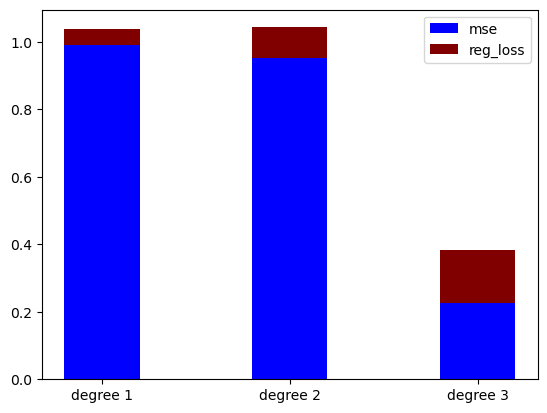

forbes.com


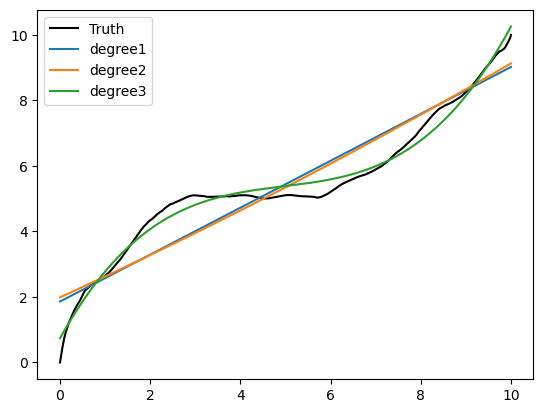

loss [0.05152211398234097, 0.10505740152714411, 0.16663617945033177]
mse [0.5259729214867332, 0.5209005186941492, 0.06811996825308655]


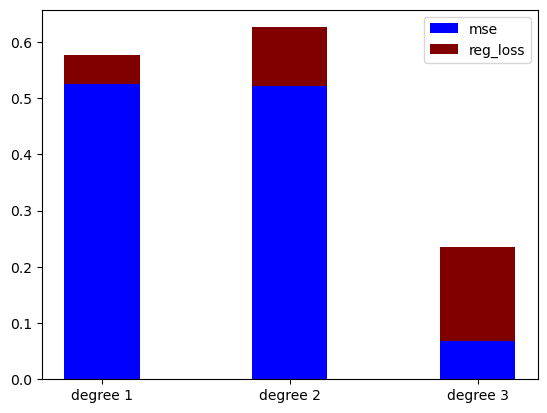

free.fr


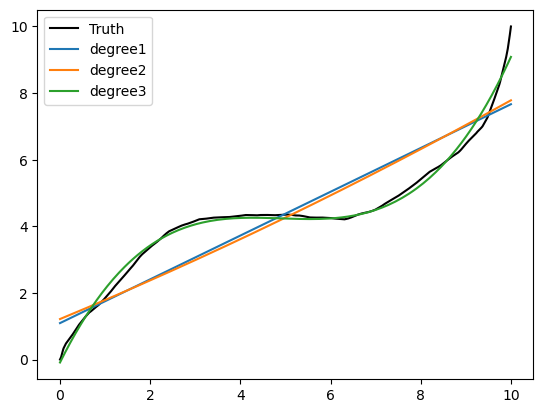

loss [0.03500897221855663, 0.0714634023465915, 0.1271796336067353]
mse [0.7320310056460313, 0.7255078304102675, 0.050794927242030795]


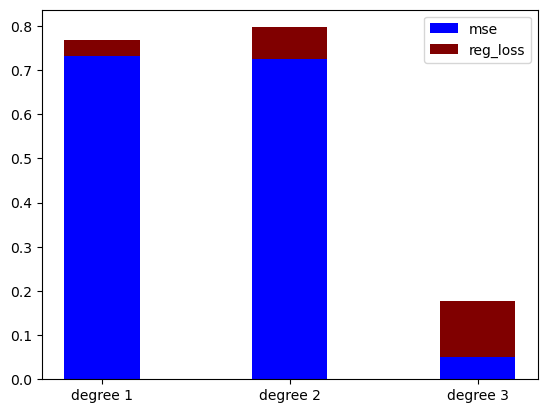

gamepedia.com


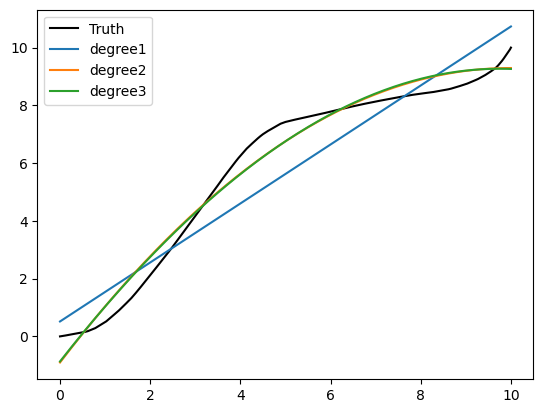

loss [0.030766141633313412, 0.04154252001308135, 0.06194875786219564]
mse [1.0369883413419414, 0.2382271060579606, 0.2378265823077528]


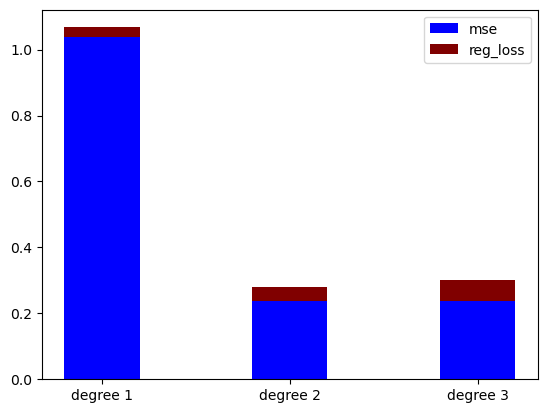

gamersky.com


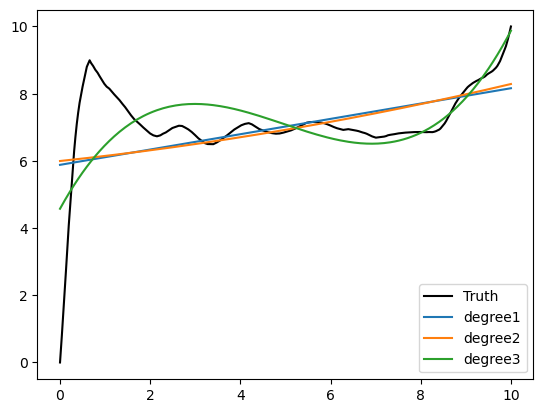

loss [0.12219509864854931, 0.2458720513009477, 0.3880849936080856]
mse [2.0424755548164466, 2.0373383318608718, 1.3423291034015399]


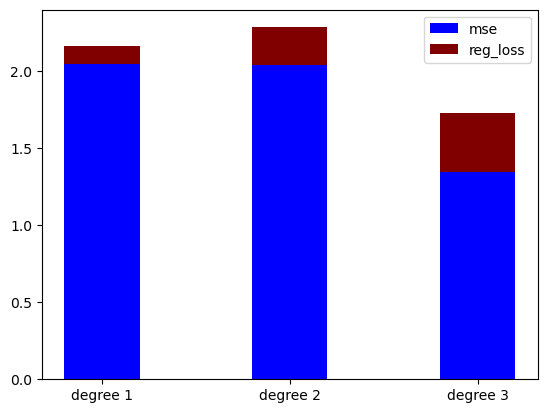

gamespot.com


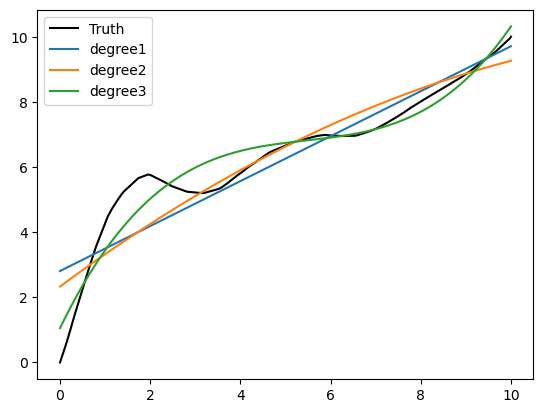

loss [0.06993672858678254, 0.13296370577383854, 0.2065782769346626]
mse [0.7422267285544109, 0.6667453177509036, 0.253788861847501]


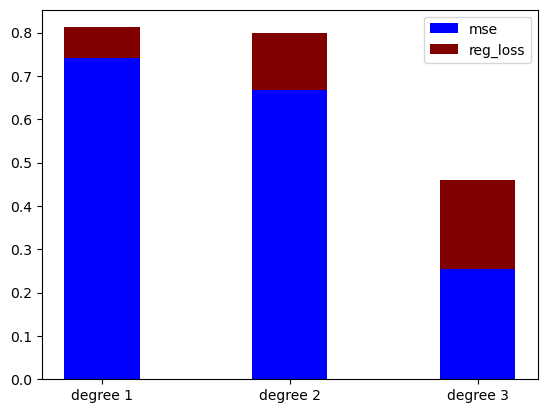

givemesport.com


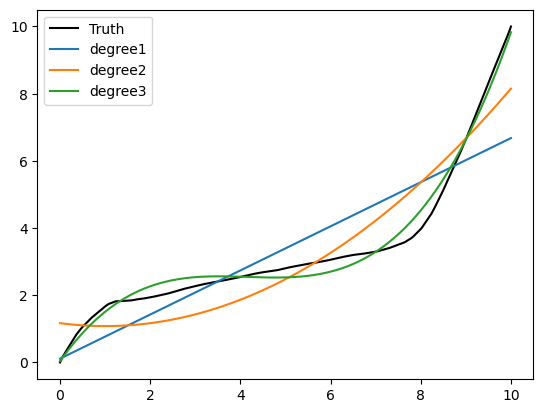

loss [0.015400901753672059, 0.04331092484559658, 0.09049666289580083]
mse [1.2817858426904312, 0.7254049553149902, 0.0675384381912713]


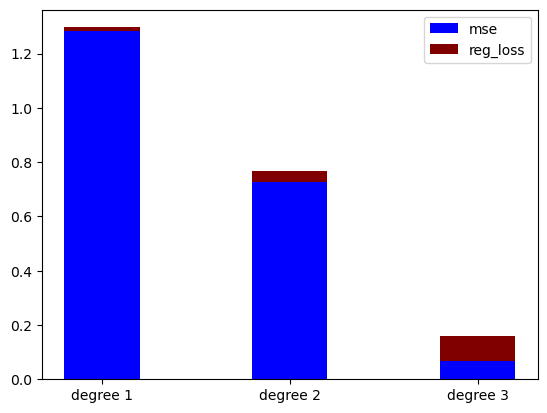

globo.com


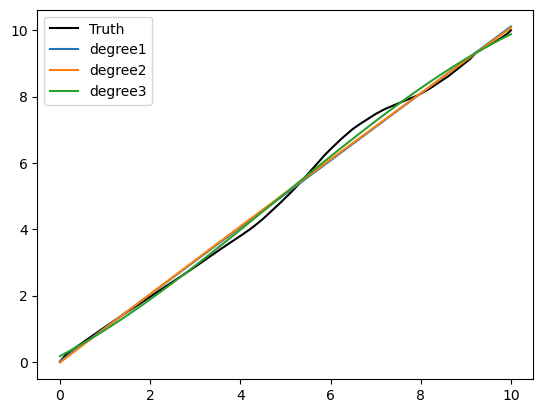

loss [0.020610961564308368, 0.04075226904167595, 0.05797726003040728]
mse [0.031188302903344674, 0.030594707797573156, 0.016667318733731368]


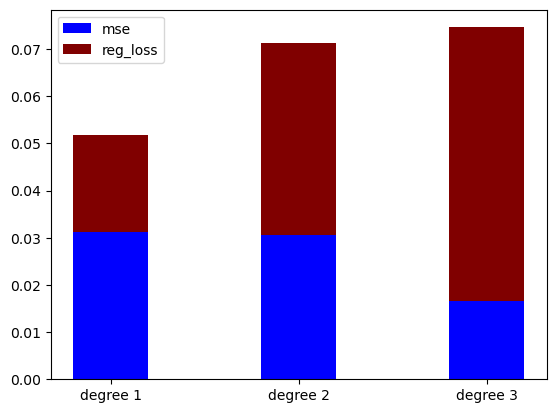

gmarket.co.kr


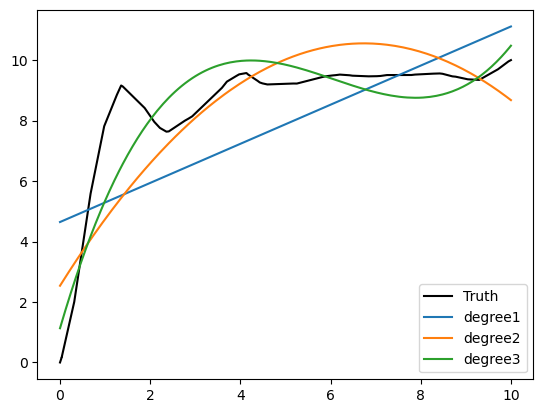

loss [0.10582859681376401, 0.18961455489489482, 0.32108711324480355]
mse [4.618724189661817, 2.141295624222472, 0.968138879622185]


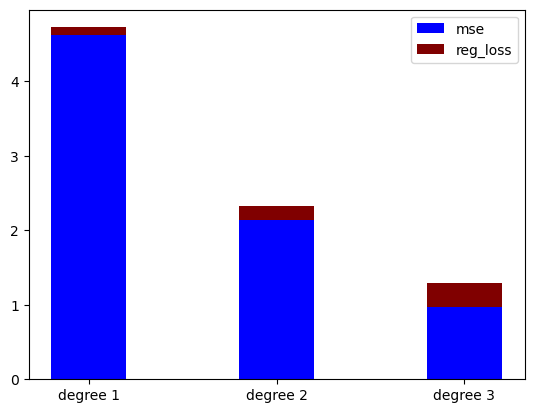

gmx.net


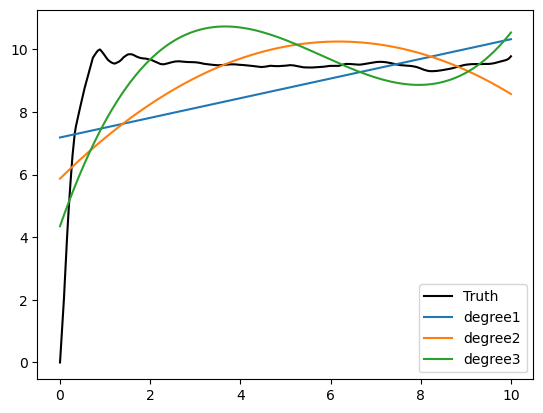

loss [0.15002459488544007, 0.2870193525587203, 0.4618694694001487]
mse [3.55575263899543, 2.6627078434187386, 1.6614202767203605]


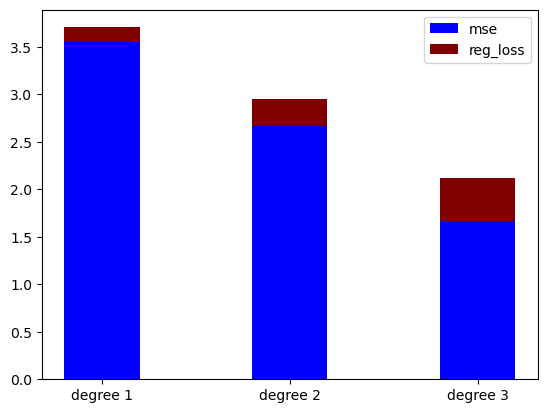

go.com


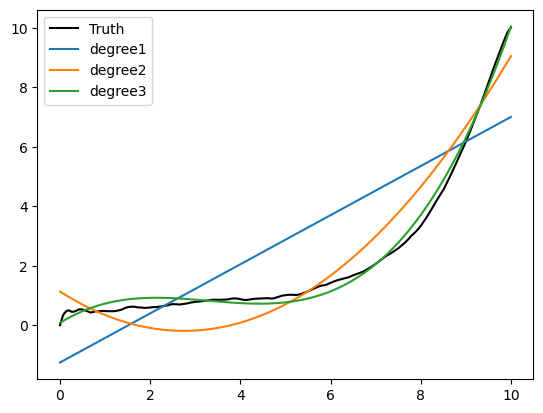

loss [-0.008515944782757872, 0.013802500492981037, 0.043685353751856316]
mse [2.9725978873835173, 0.5414945861752974, 0.03941671037174678]


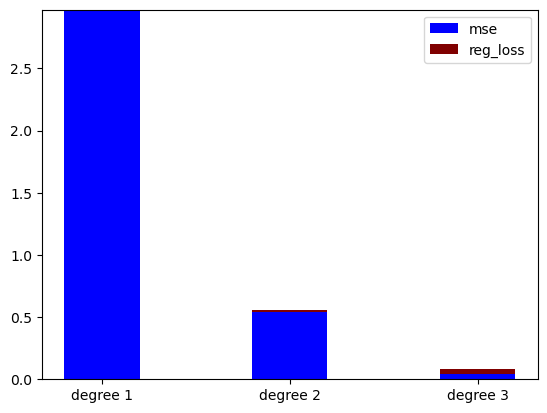

gome.com.cn


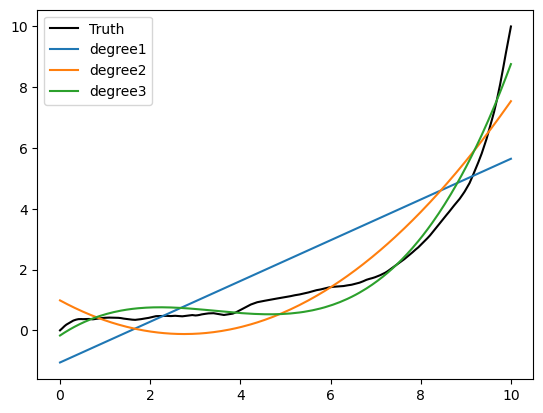

loss [-0.007741600610572397, 0.013109441323590505, 0.03154630477630277]
mse [2.154837371475026, 0.6711100167964161, 0.17435127974281076]


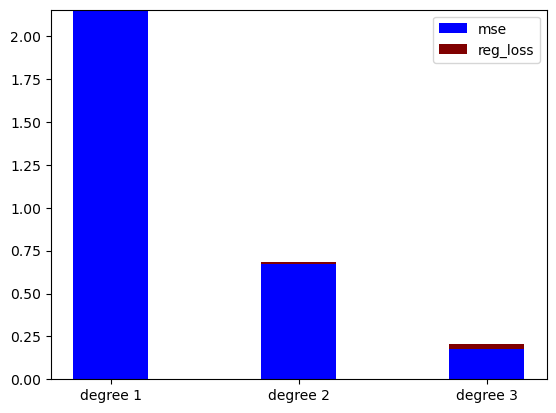

google.by


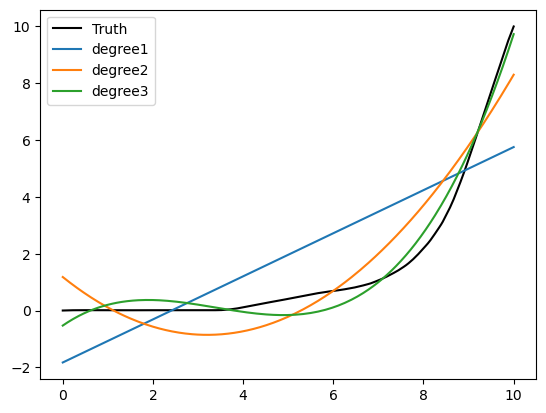

loss [-0.02141569076306512, 0.004277993292544275, 0.012148508613262282]
mse [3.441905257615171, 0.8353391476651613, 0.13430321267258866]


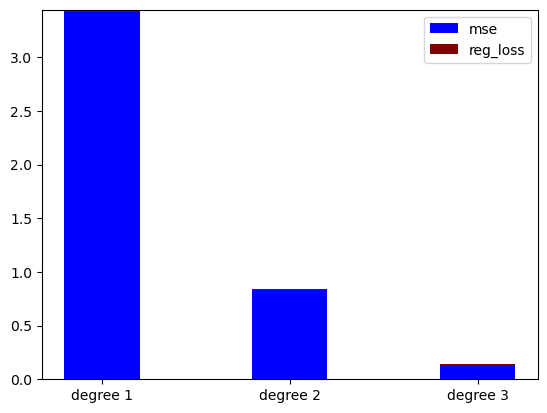

google.com


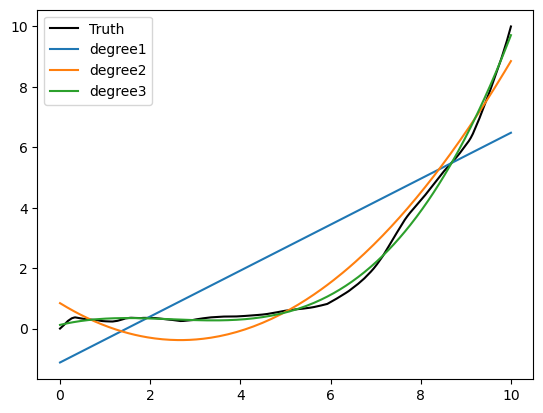

loss [-0.00724075680980459, 0.003857986234568203, 0.019690033789307587]
mse [2.3647477797714354, 0.2786914593678083, 0.026139274817865325]


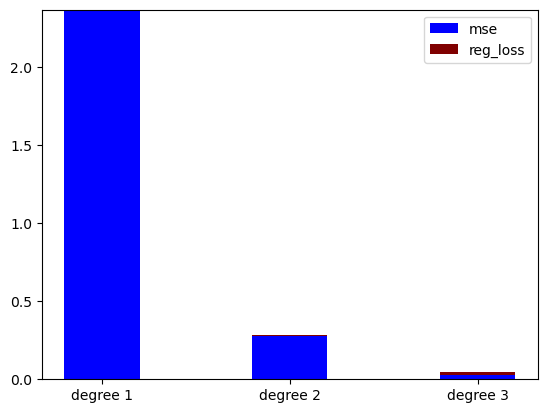

google.com.ar


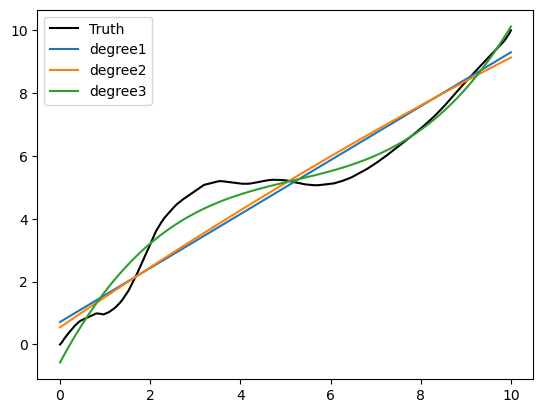

loss [0.031492328515372224, 0.06053392600383751, 0.10116648008272412]
mse [0.530860177424423, 0.5201925138444603, 0.15857857720470947]


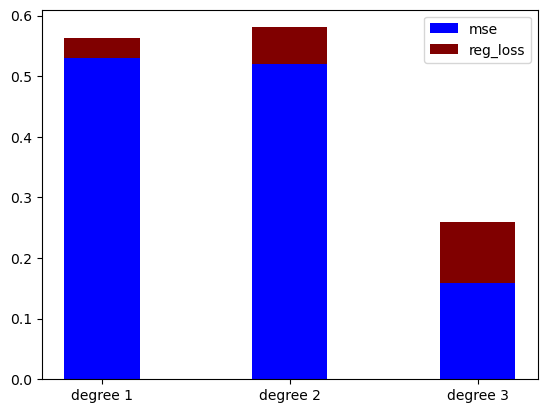

google.kz


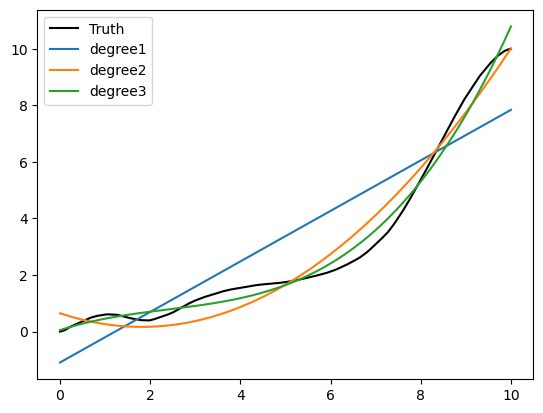

loss [-0.003971224670774631, 0.010515206241893536, 0.02743678800726057]
mse [1.825276897023068, 0.279809079540852, 0.09888041957820944]


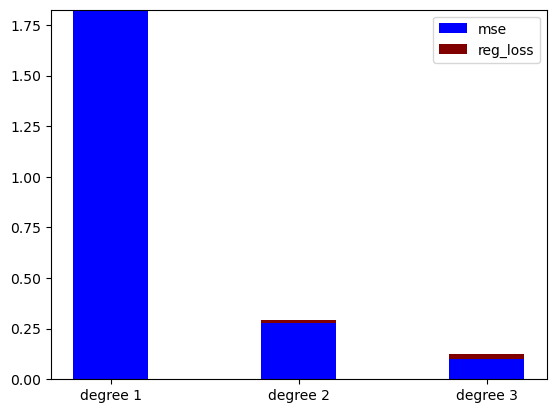

googlevideo.com


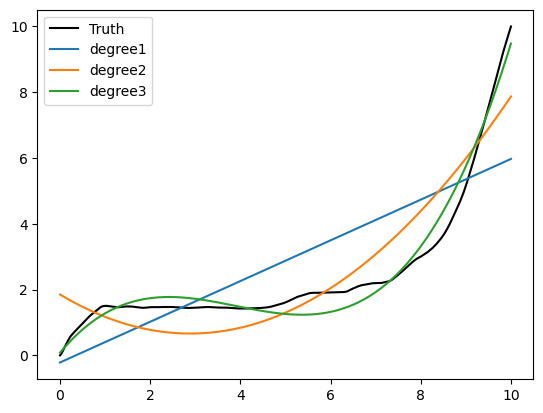

loss [0.008059653313187242, 0.04684893348314181, 0.07665596925561186]
mse [2.2683842533521656, 0.934940798201313, 0.12600931736444082]


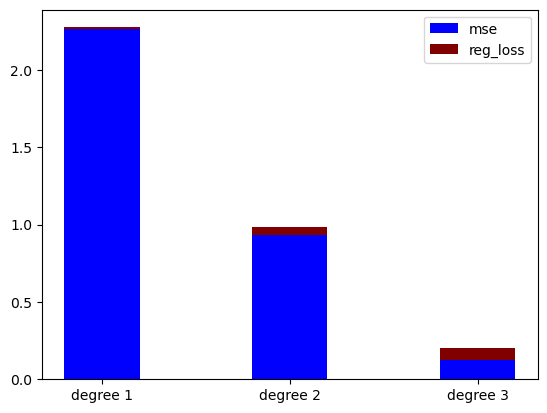

groupon.com


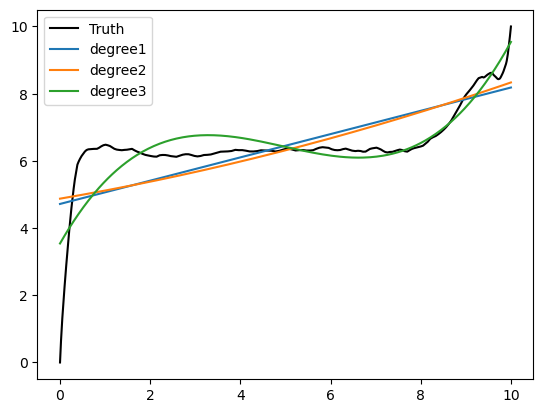

loss [0.10129193809356699, 0.20467059116284467, 0.323618039672712]
mse [1.1822468321751562, 1.1724374310249488, 0.5641036304739254]


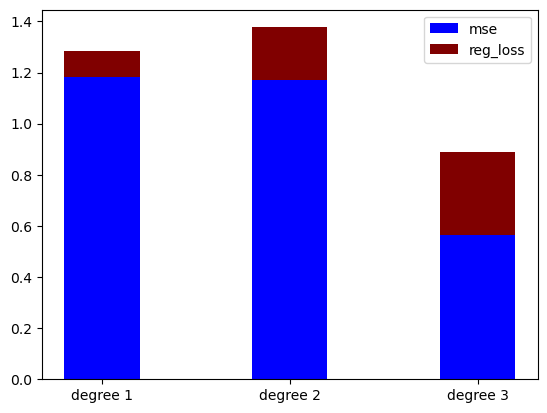

gsmarena.com


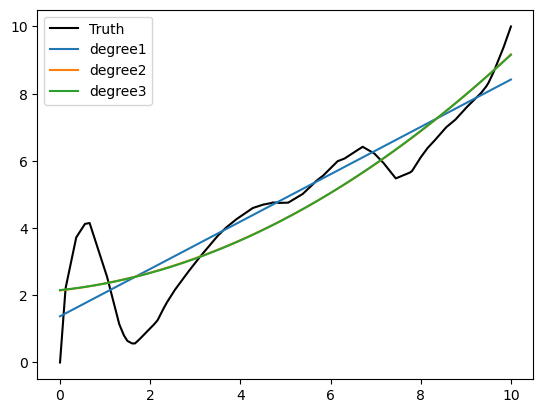

loss [0.04157804060873525, 0.09412595822951678, 0.1410879724315402]
mse [1.0201262006442537, 0.8005130602969048, 0.800483012030753]


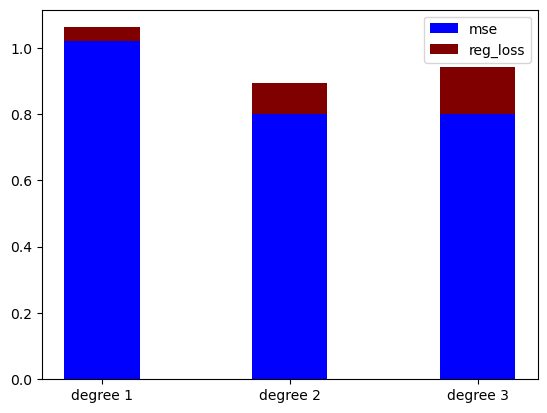

hao123.com


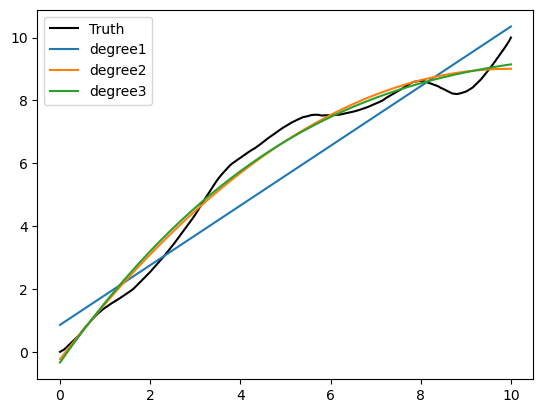

loss [0.03614697921353991, 0.06097573784967045, 0.09399321741925358]
mse [0.7908638578744649, 0.14206108049024066, 0.13645699048887014]


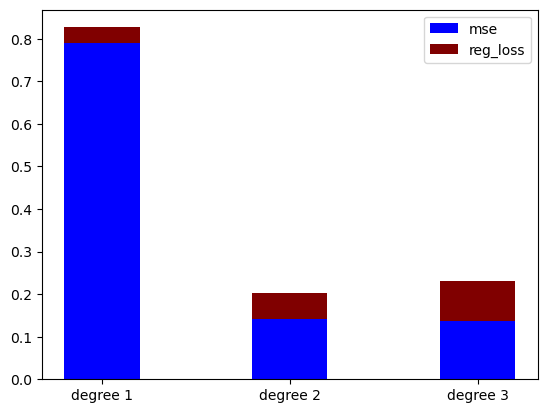

hotnewhiphop.com


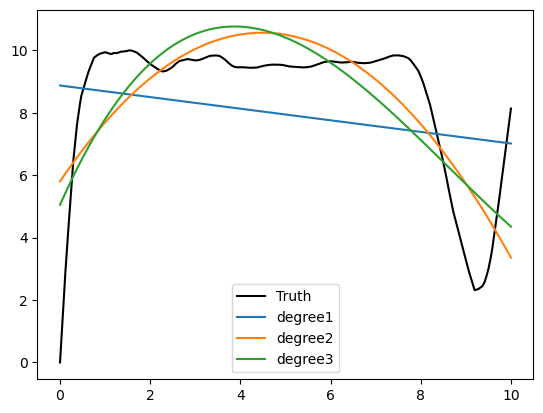

loss [0.17380840265686032, 0.30770130104152316, 0.46797388081516317]
mse [6.749030280109401, 3.1514453561771547, 2.9537603987959624]


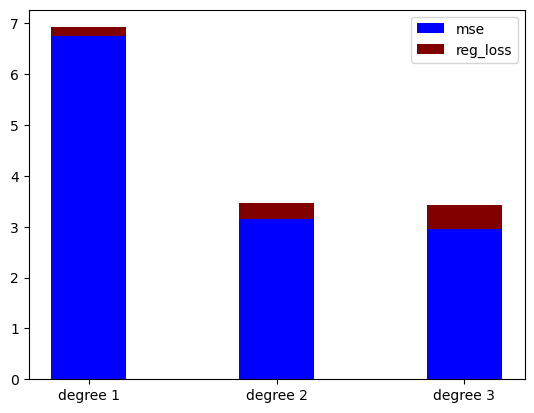

huawei.com


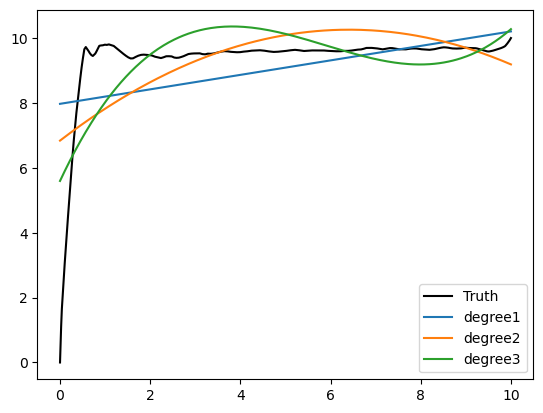

loss [0.16391162621326694, 0.31288150064707176, 0.4812259793523952]
mse [2.3181497361475647, 1.8390221844878591, 1.354176580640442]


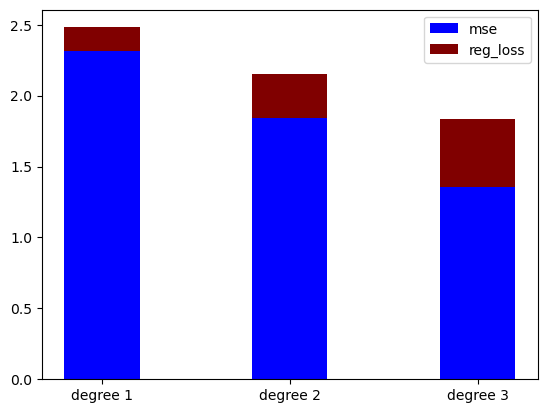

huffingtonpost.com


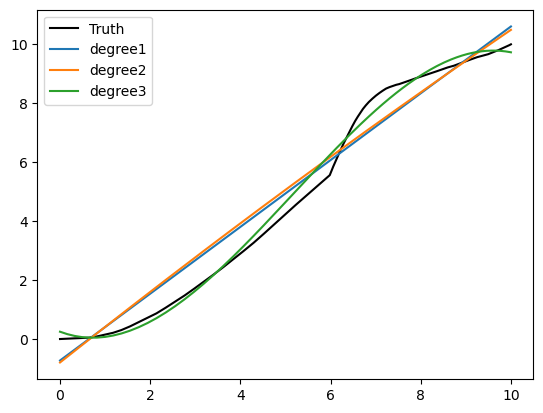

loss [0.008096614417571113, 0.016423072812651617, 0.0043251425356830965]
mse [0.1935725469419544, 0.19030985609204926, 0.03185545000403674]


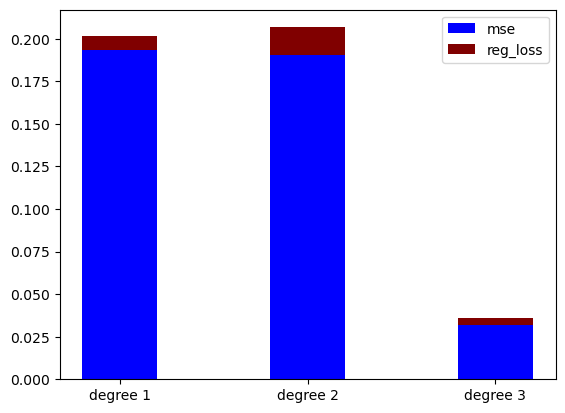

huya.com


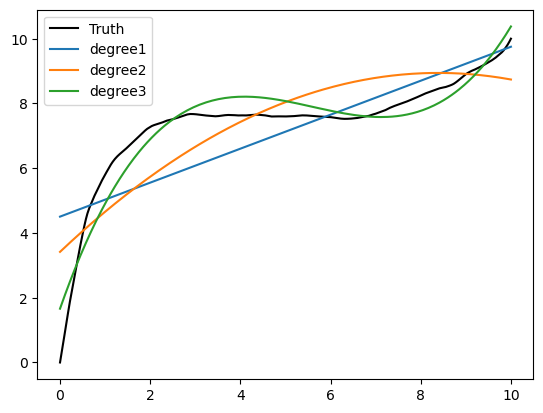

loss [0.10058061582280503, 0.18619115539102044, 0.2942936995983696]
mse [1.61242505850277, 1.190591051596162, 0.26204670293480253]


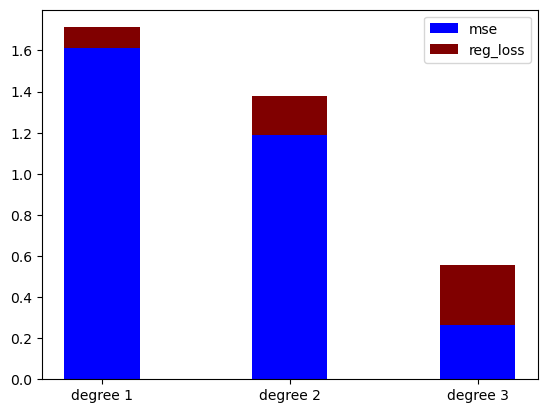

imgur.com


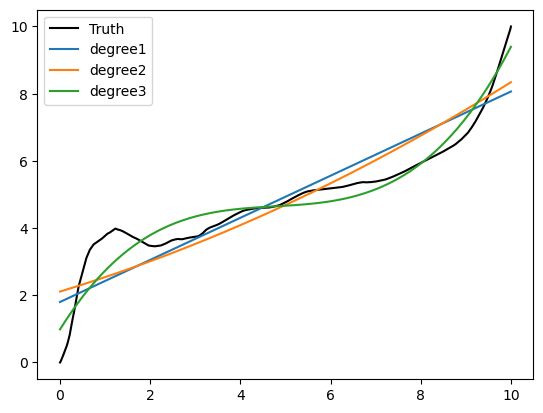

loss [0.04852966916579206, 0.1015961589269227, 0.16390129476565726]
mse [0.7143400215015722, 0.6804460142343782, 0.2473669552458502]


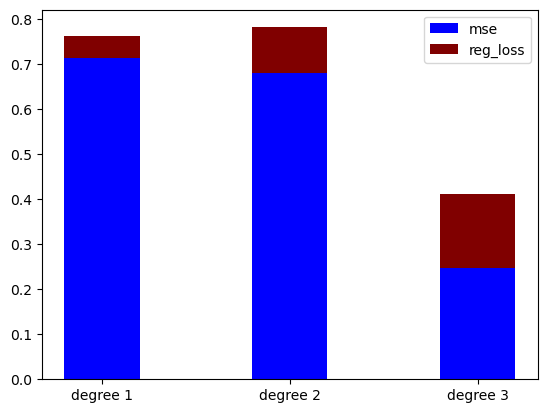

independent.co.uk


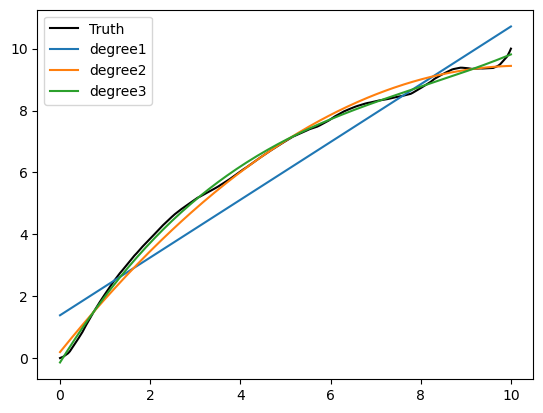

loss [0.04631378203571375, 0.0764674299843042, 0.11977341669250134]
mse [0.6250142033998562, 0.05576738459568022, 0.012412835609790939]


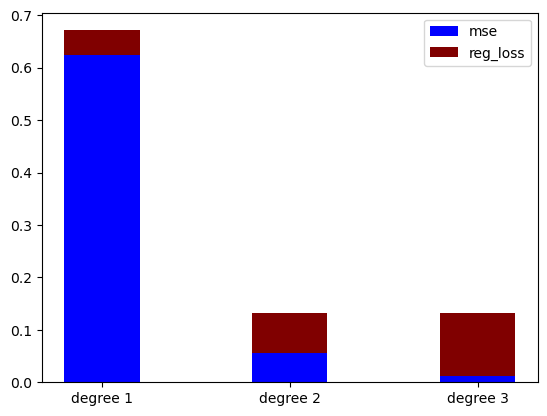

indiamart.com


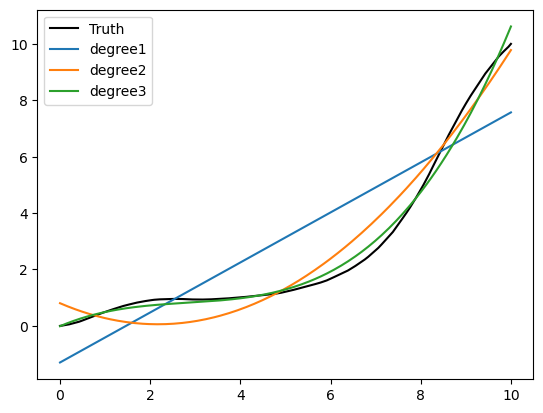

loss [-0.008206330334065261, 0.011007202200806554, 0.029503646370490487]
mse [2.30615593227658, 0.3426539832271457, 0.06811704251698761]


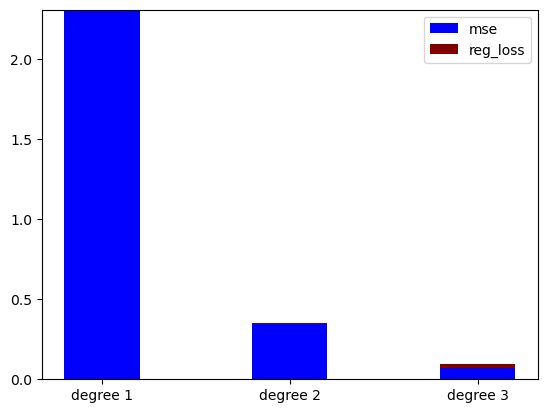

infourok.ru


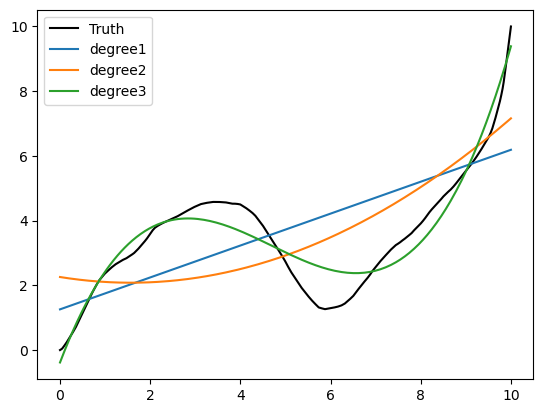

loss [0.035015357871906065, 0.08417647747170752, 0.1453147238050464]
mse [2.6465689912412804, 2.2813662999203848, 0.25299941033458284]


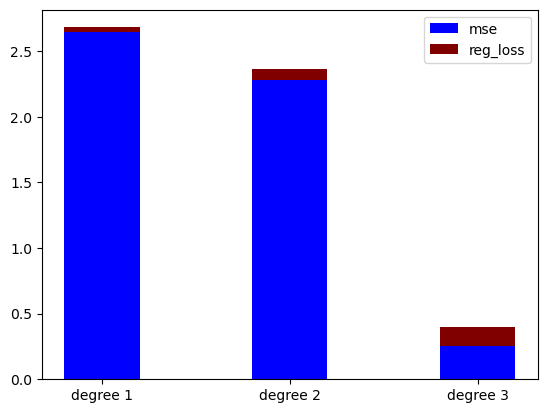

inquirer.net


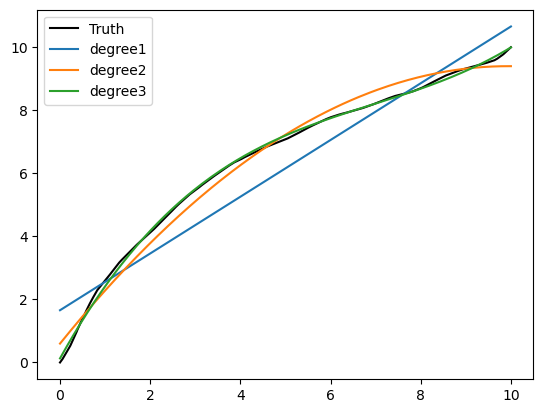

loss [0.05114784999560528, 0.09125351131287338, 0.14489391967607784]
mse [0.6485116744131693, 0.10125290297519646, 0.009582455266136134]


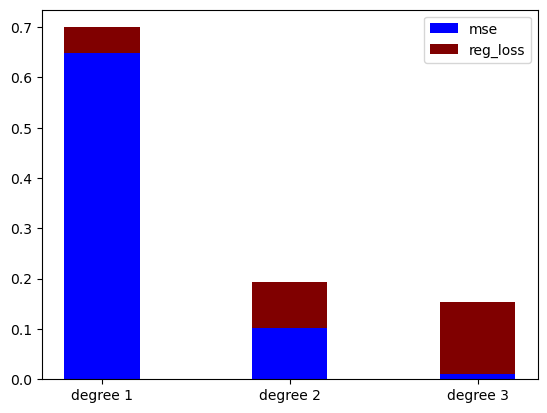

instagram.com


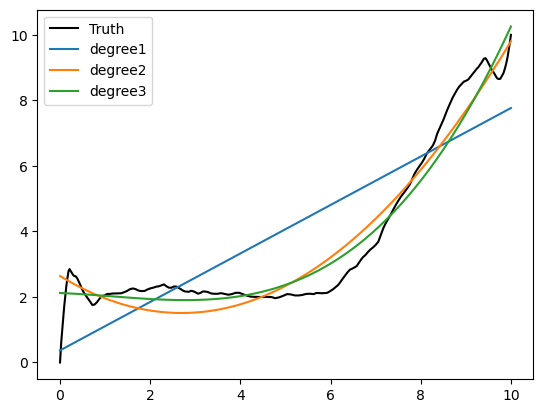

loss [0.022169507579454708, 0.07827257655721814, 0.1220522548901711]
mse [2.1769207344640313, 0.4426405168698099, 0.3591710076299833]


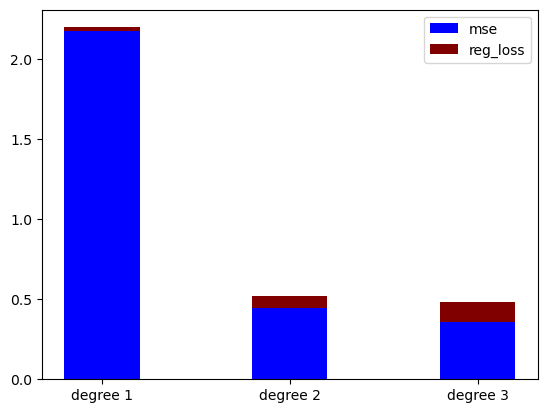

instructure.com


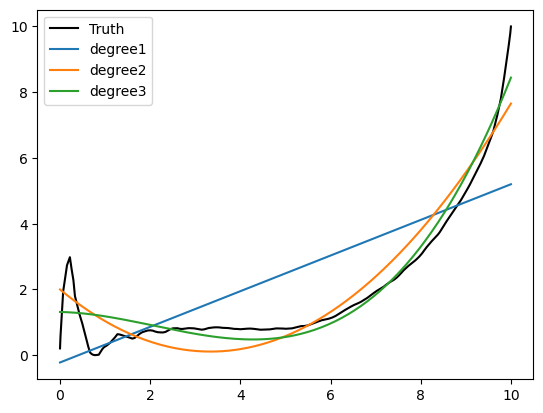

loss [0.006387750478061603, 0.041390786603399336, 0.07087753146984398]
mse [2.5454539269680185, 0.49614544146042144, 0.31584184010044547]


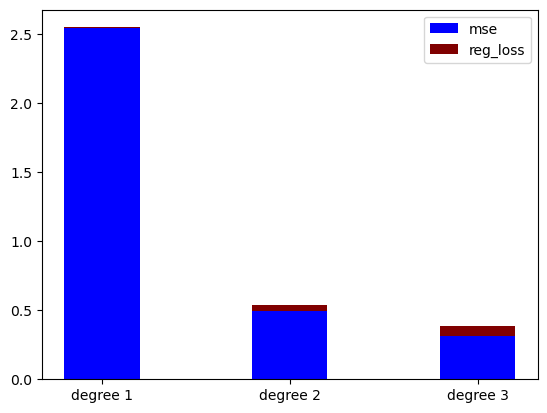

interia.pl


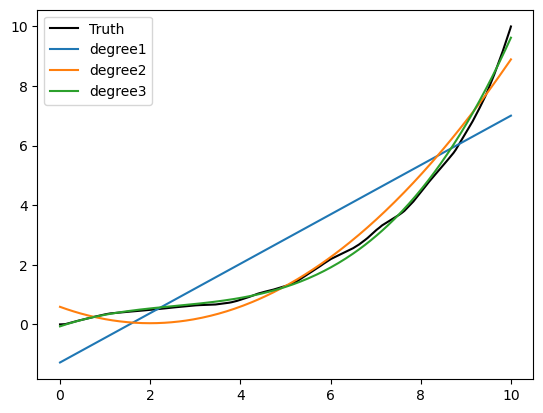

loss [-0.008996301066851063, 0.007064890627836162, 0.019417964454389997]
mse [1.586919569342716, 0.203330288585023, 0.019619389782174486]


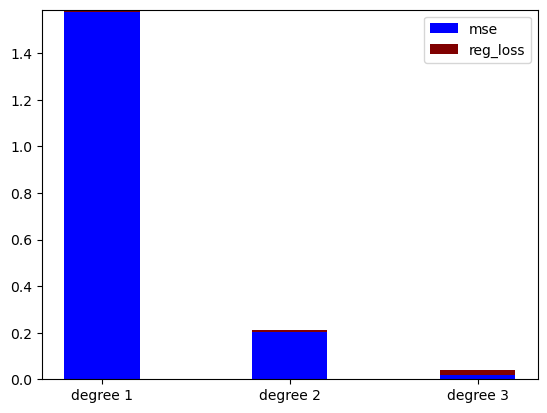

issuu.com


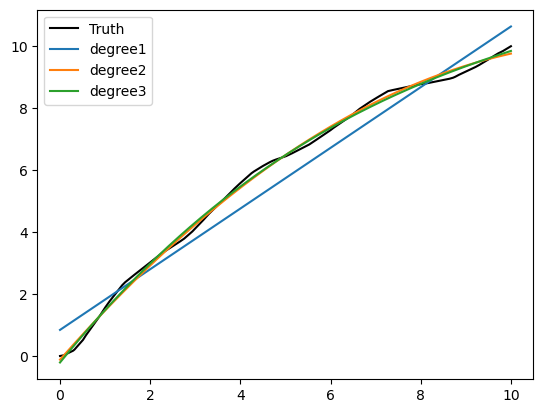

loss [0.03643697916648662, 0.05873773867554855, 0.08905122949199383]
mse [0.34346190273373145, 0.01838880158773575, 0.015611263112757616]


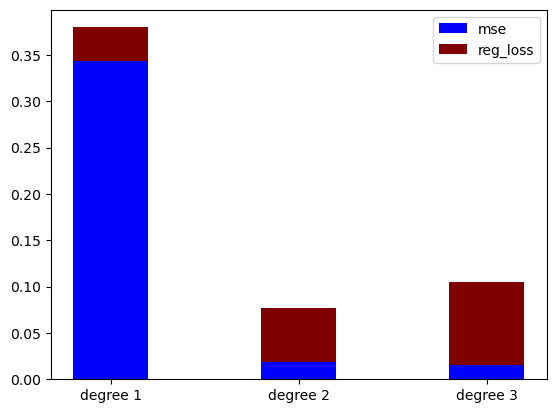

japanpost.jp


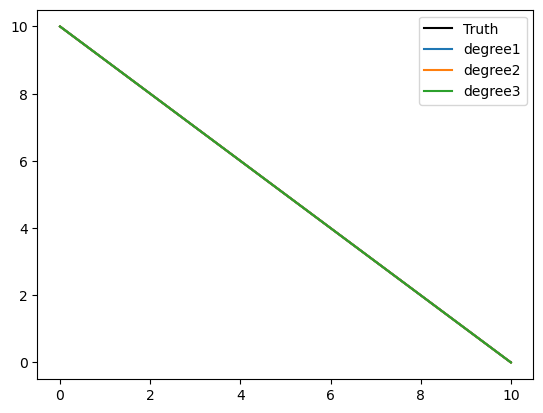

loss [0.17999999993669963, 0.35999999993861737, 0.5399999999828944]
mse [3.6593340737365573e-19, 7.101590081518605e-20, 7.980848400137889e-21]


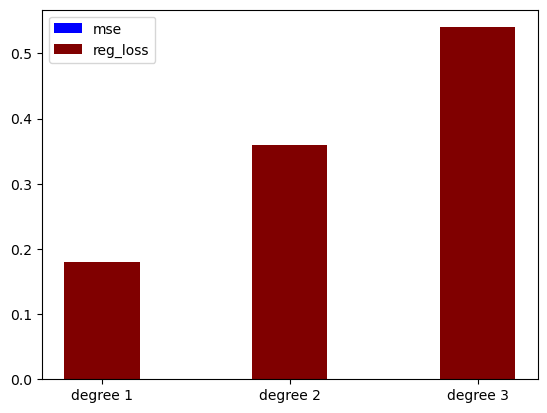

jd.com


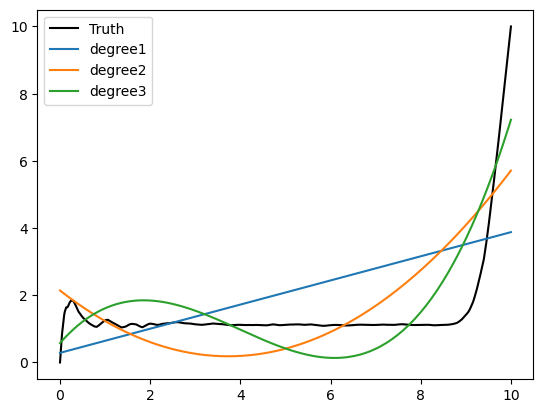

loss [0.012909911581327886, 0.04933608909292756, 0.09680653753804067]
mse [3.568930919003005, 2.088269640778123, 1.1377481502512965]


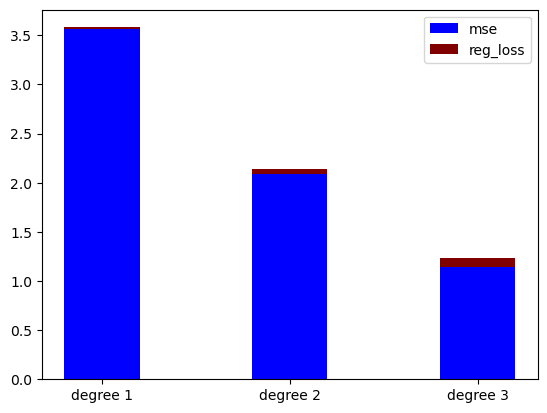

k618.cn


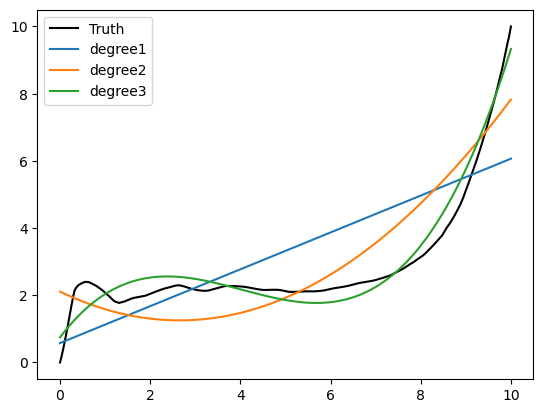

loss [0.022541245639093748, 0.0634101227277289, 0.12212382726661894]
mse [2.232470144405813, 1.0528706242742503, 0.18527815326287356]


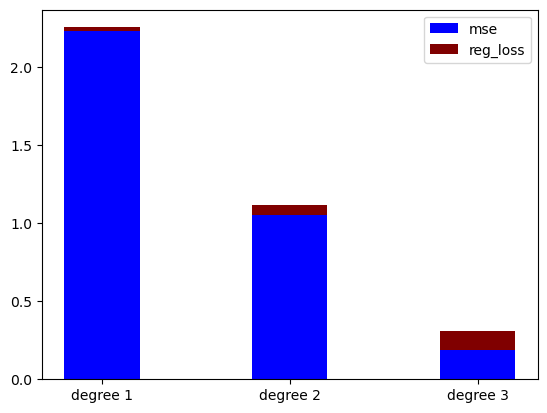

kapanlagi.com


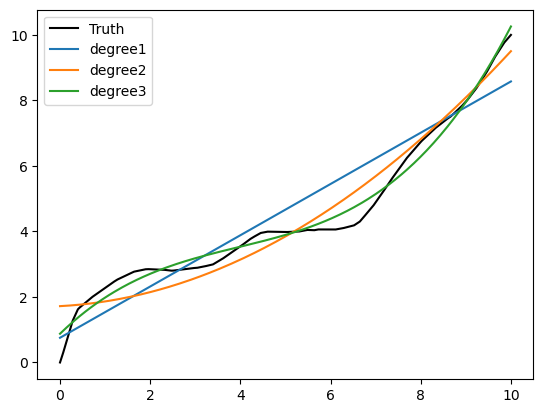

loss [0.030735170597675047, 0.07452773631911673, 0.11889038554284184]
mse [0.6322947321917499, 0.2907493908273628, 0.0777346703450149]


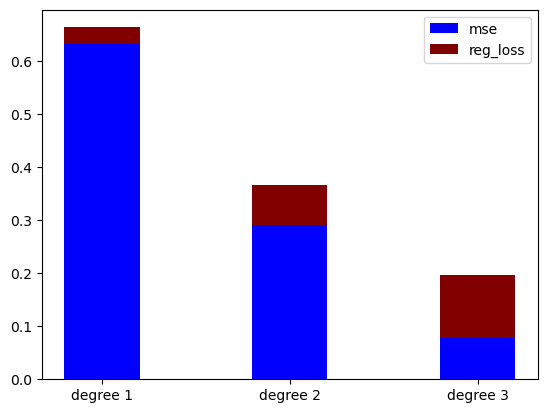

kaskus.co.id


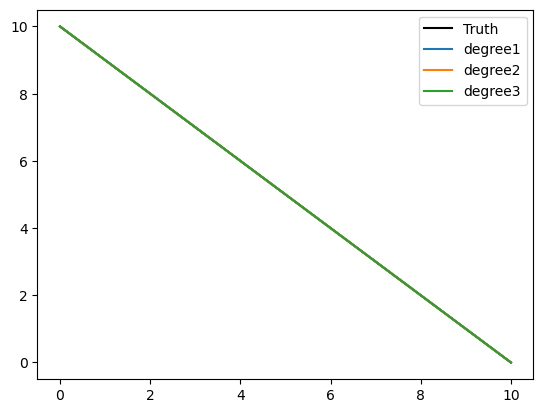

loss [0.17999999999999902, 0.36000000000000026, 0.5430885918557679]
mse [1.5069030856304585e-27, 1.4417773717851435e-27, 1.2595543886934012e-27]


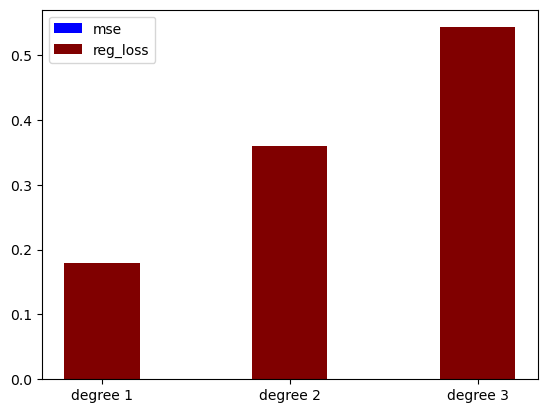

khanacademy.org


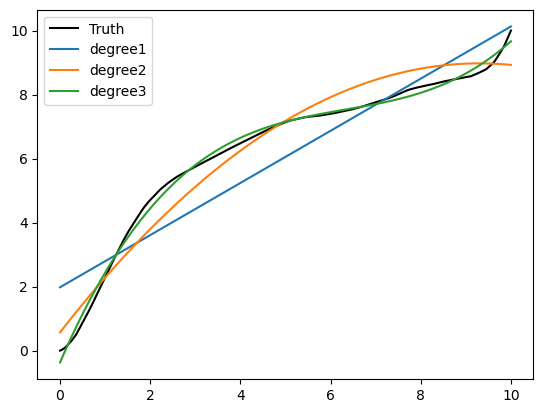

loss [0.055866680904950776, 0.09117903058771215, 0.14624336119352158]
mse [1.054703263398754, 0.31870075085211275, 0.0262742701662007]


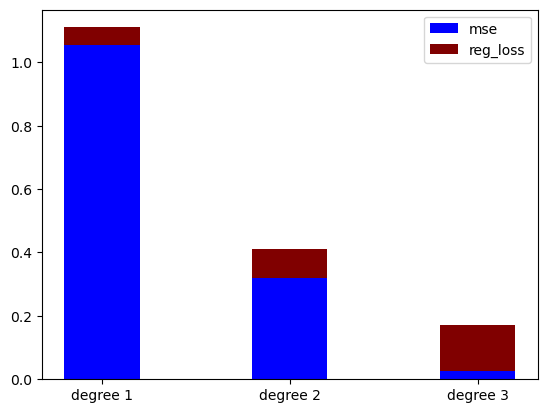

kijiji.ca


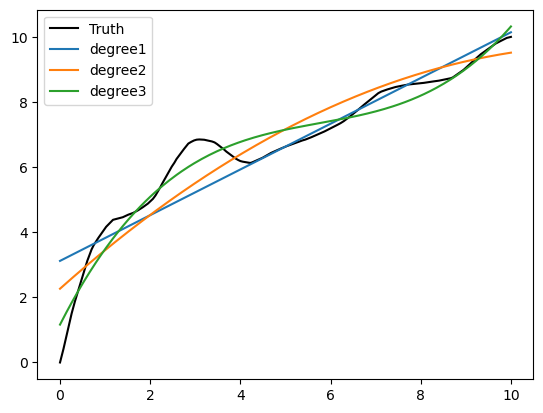

loss [0.0764449166087841, 0.13798208205517104, 0.2088742231134529]
mse [0.6383425306915277, 0.4536405818465728, 0.18057103418558007]


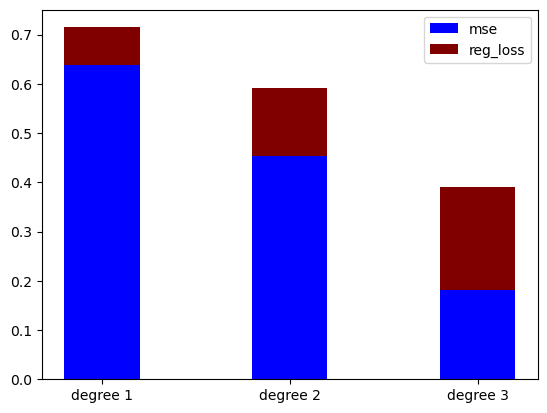

kinopoisk.ru


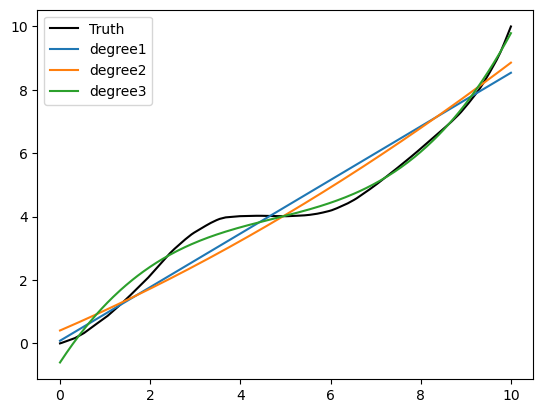

loss [0.018589471497685844, 0.041766339774029715, 0.07265638020475157]
mse [0.4255379783753199, 0.3855204405335493, 0.060847575701393056]


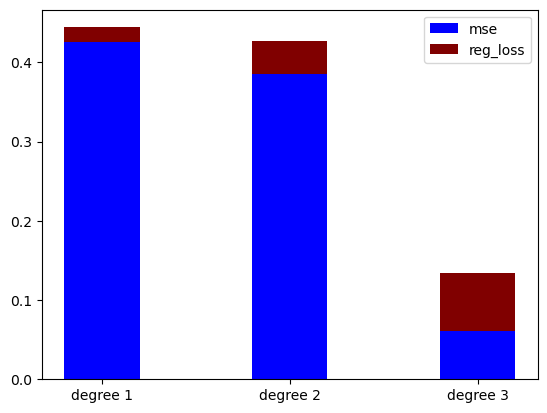

kompas.com


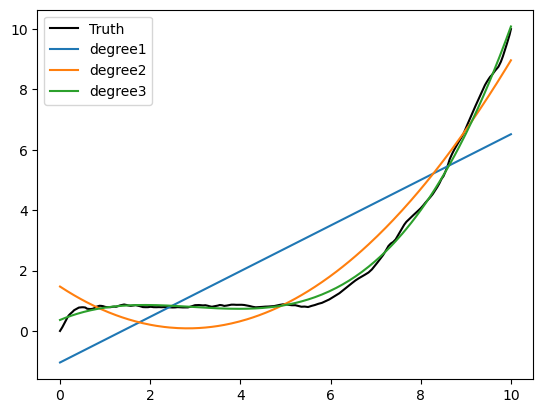

loss [-0.00576115350837624, 0.026620629523765423, 0.0463797675429232]
mse [2.4070171860120104, 0.3717881339297914, 0.020818025459447935]


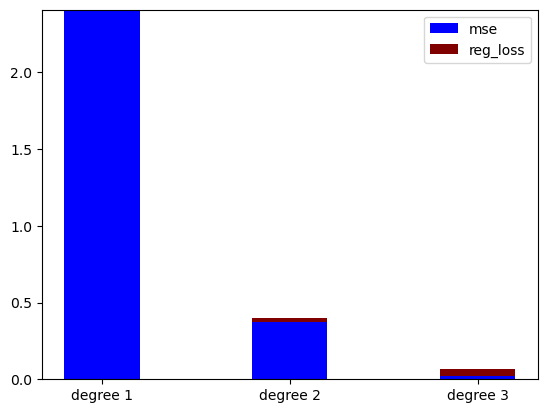

lenta.ru


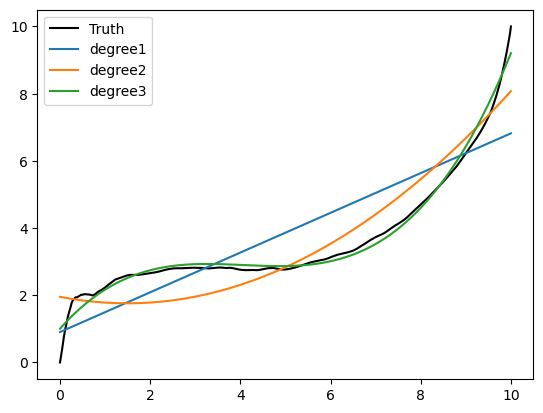

loss [0.0299497713203706, 0.07126726036586079, 0.13012293823916177]
mse [1.1113833436955165, 0.5141526859348887, 0.07082579864003165]


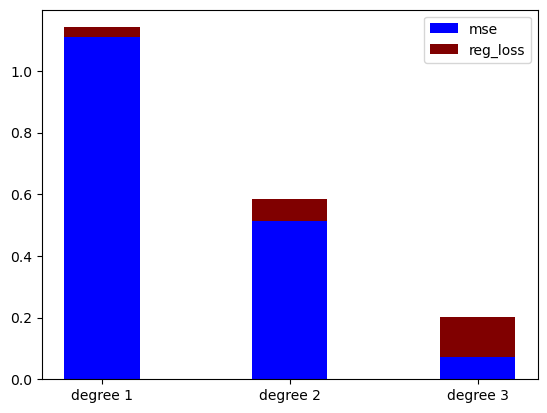

libero.it


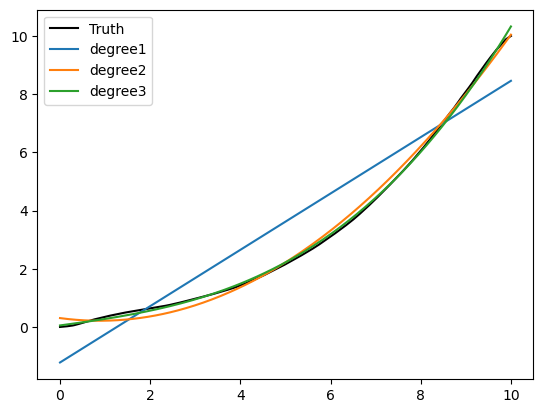

loss [-0.005066317349564218, 0.008588394612966267, 0.01653237333632148]
mse [1.0136871984117575, 0.032363007309260595, 0.007428129723388142]


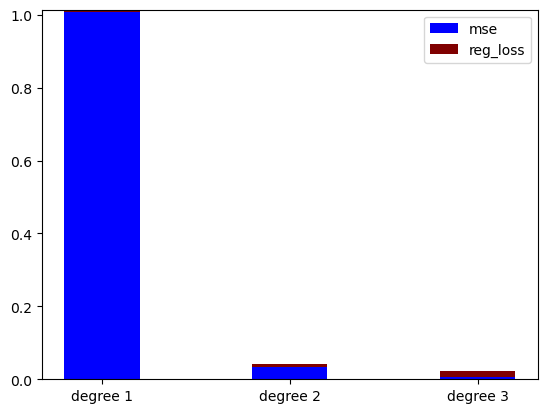

lifedaily.com


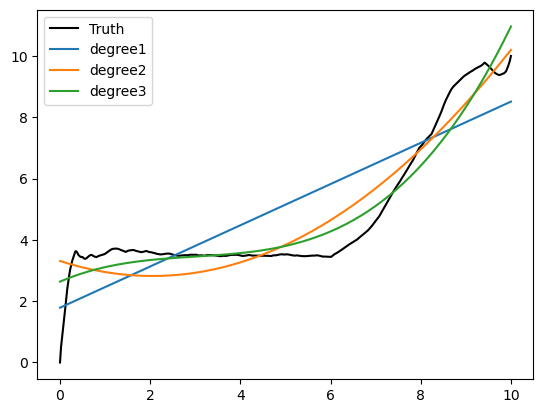

loss [0.04918699372241165, 0.11801150147928115, 0.18661144016126507]
mse [1.6544274714869383, 0.6513346289985184, 0.4816765991146655]


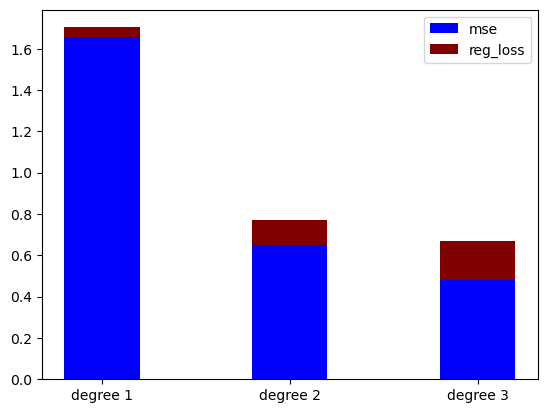

liputan6.com


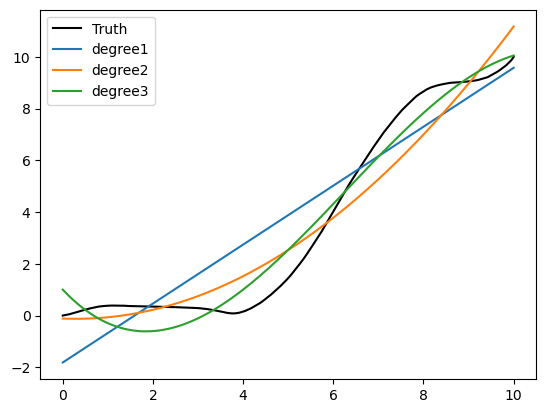

loss [-0.01348775941083031, -0.0026318924662069856, -0.017682495302912563]
mse [1.9196061959715542, 0.8567622883529428, 0.4058671225402668]


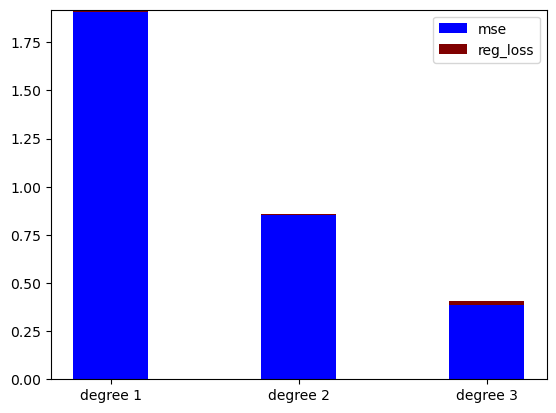

list.tmall.com


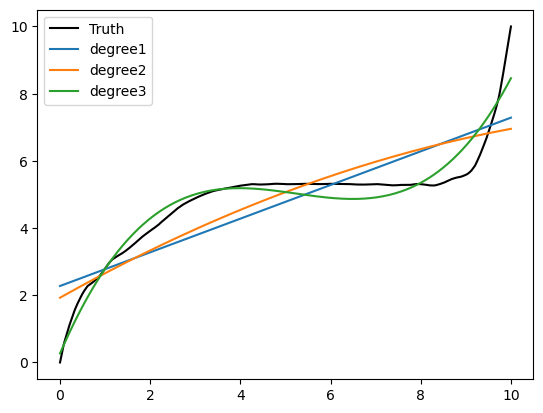

loss [0.055546631771581166, 0.10624380181063513, 0.1672637268951987]
mse [0.9476712322384402, 0.9066440006198484, 0.1989623875095218]


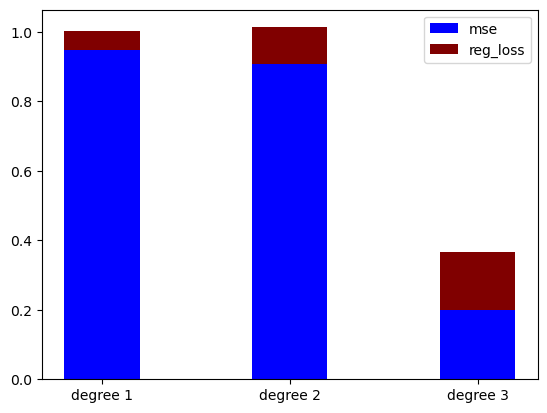

live.com


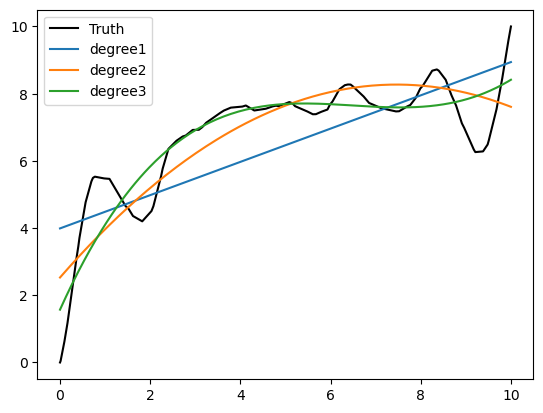

loss [0.08970402917785879, 0.1585818542783588, 0.2461259644114376]
mse [1.7903383553246361, 1.0252946901998425, 0.7513954485857701]


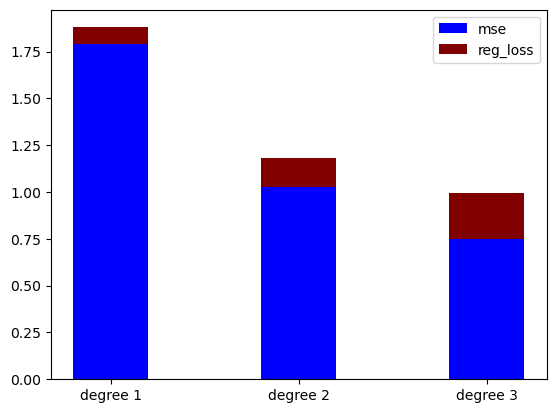

livedoor.com


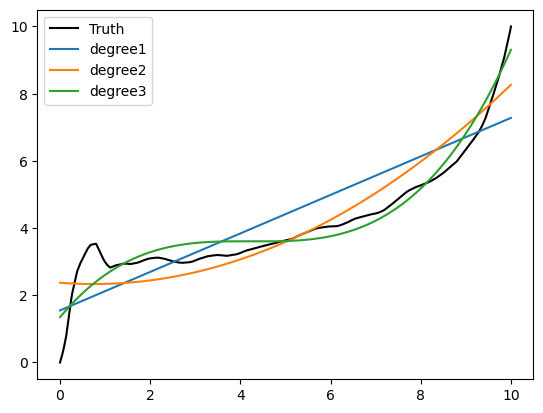

loss [0.042449401233206424, 0.0935468679629102, 0.15641558674714065]
mse [1.035456062138837, 0.6874671825115516, 0.2737130861440587]


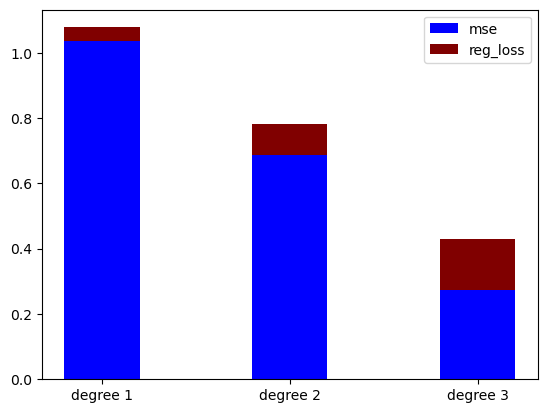

livedoor.jp


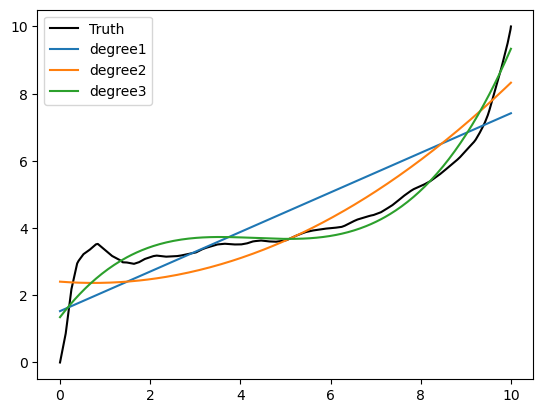

loss [0.04235018000078432, 0.09488591752478417, 0.16280495308446916]
mse [1.1169947185646916, 0.7379331890247525, 0.24667448164466843]


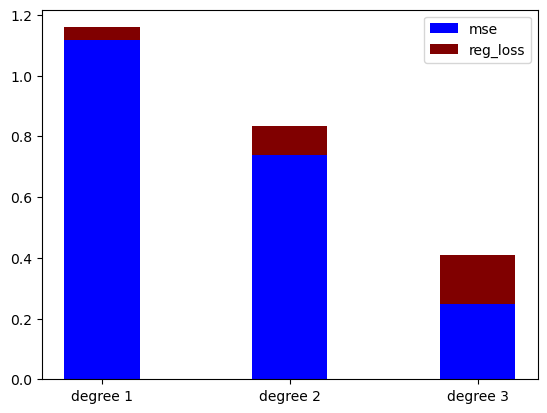

livejasmin.com


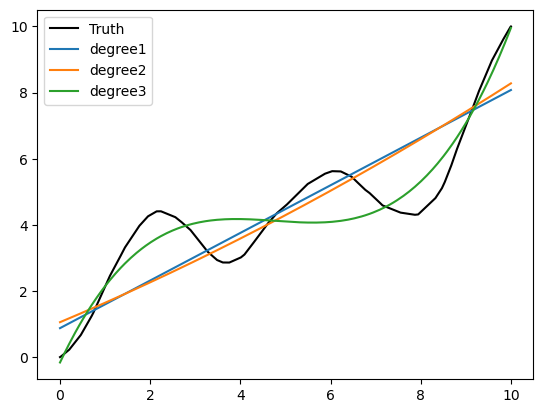

loss [0.031924309733939914, 0.06575763176830486, 0.12874849499610214]
mse [1.4094870578596583, 1.3925476537061159, 0.4307426317729329]


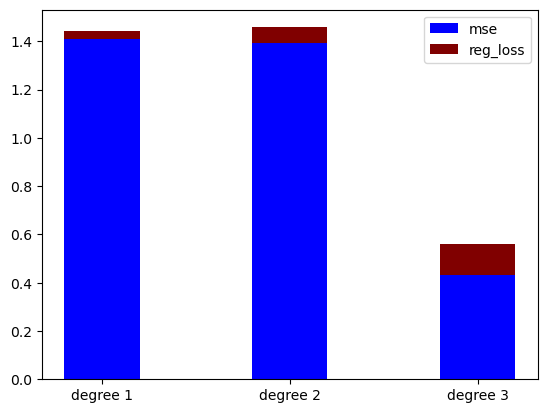

livejournal.com


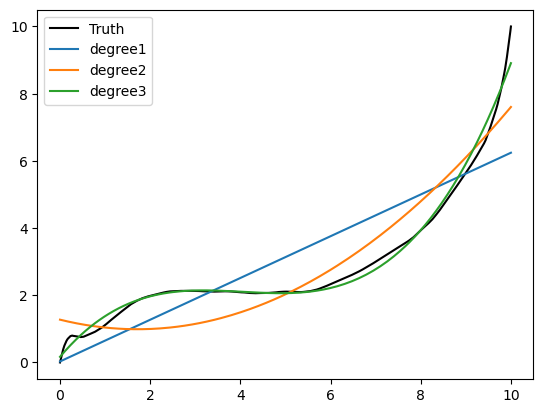

loss [0.01302431009301571, 0.04157160960857785, 0.0827390238568363]
mse [1.258840988580613, 0.5718854877325257, 0.05315357040038045]


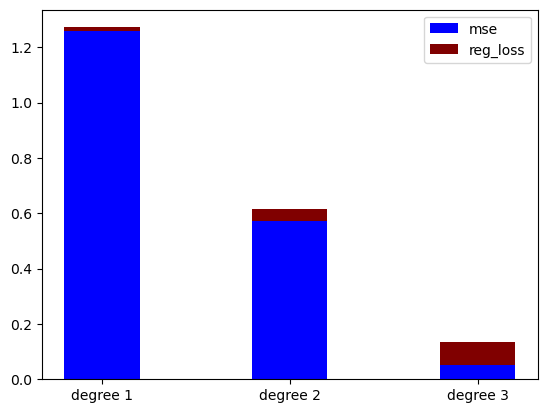

login.tmall.com


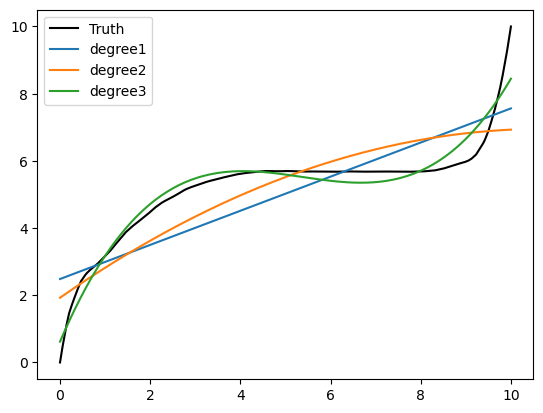

loss [0.059837772607569555, 0.11275592730539896, 0.19043891570022983]
mse [0.9648257624121599, 0.8291018986678035, 0.16024097269546417]


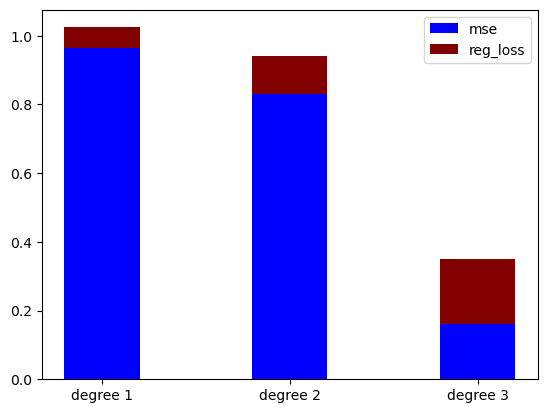

mail.ru


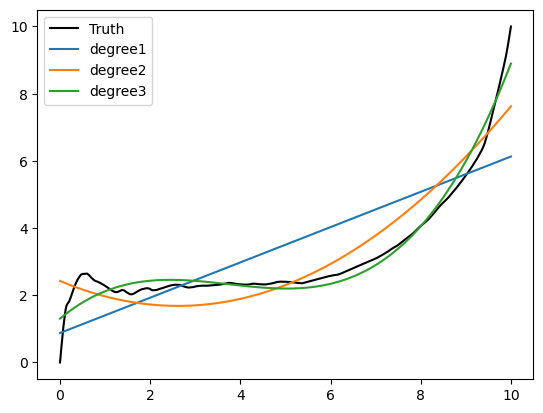

loss [0.028069778140093784, 0.07867779154093033, 0.1271804431664455]
mse [1.362574771013497, 0.5614606020337201, 0.13527662338345017]


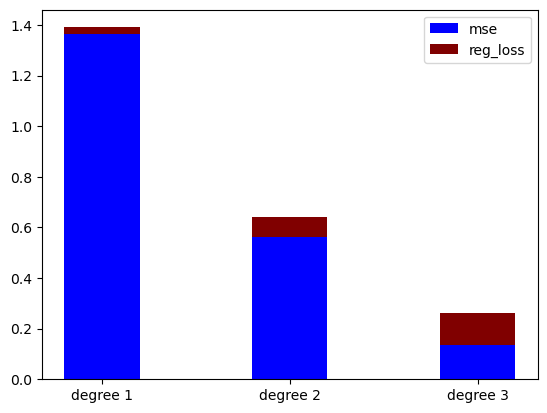

mama.cn


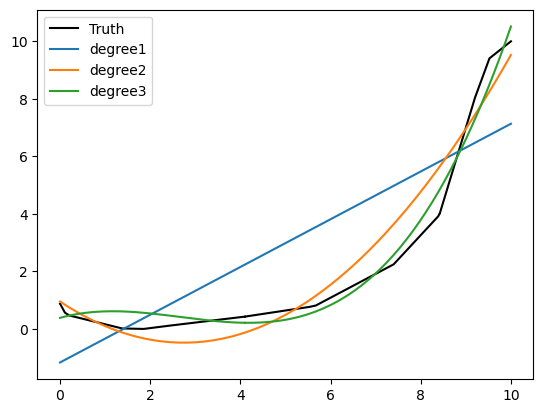

loss [-0.006735981895458394, 0.003999251237329519, 0.036608311903543016]
mse [3.668742712389878, 0.5258615743742917, 0.1538942735237007]


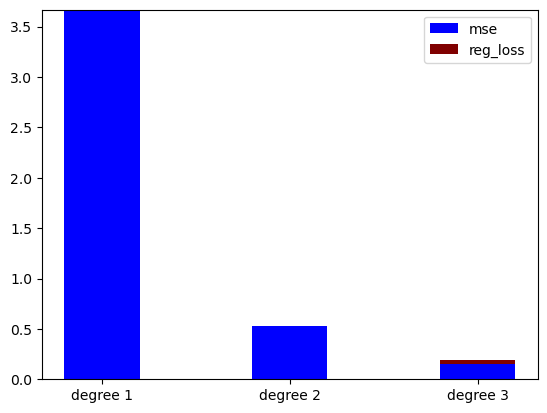

manoramaonline.com


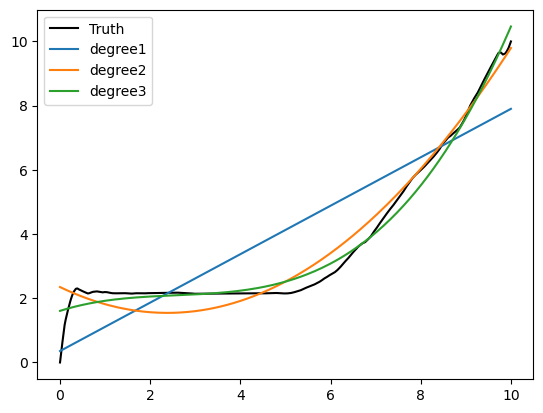

loss [0.022208616915042674, 0.07262207849688415, 0.11531589220158484]
mse [1.741277150247672, 0.2872743937241959, 0.12000149142232805]


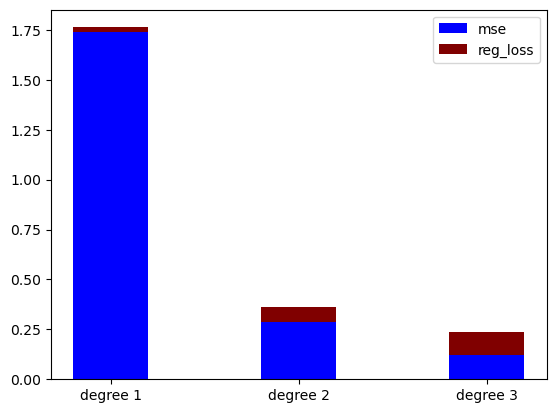

marca.com


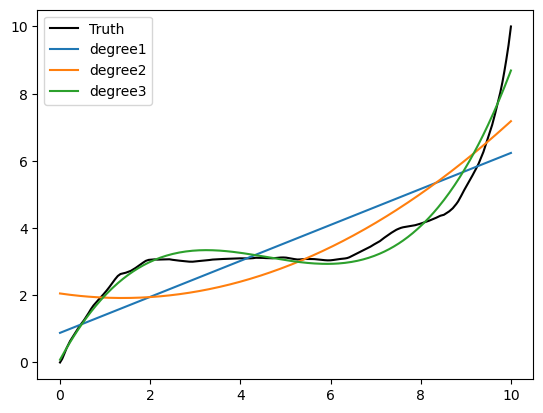

loss [0.02834231220128877, 0.07717387459057617, 0.11985622193382094]
mse [1.2257802763407726, 0.8864940076807852, 0.12265321731137846]


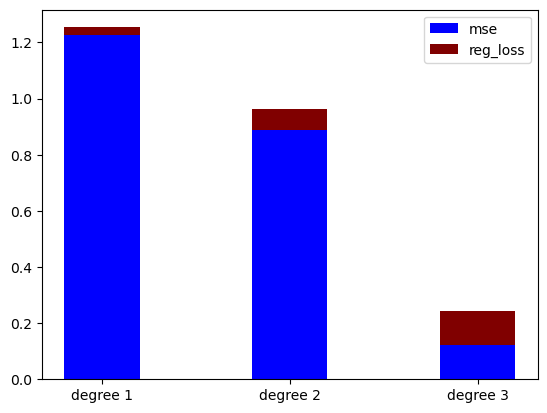

mercadolibre.com.ar


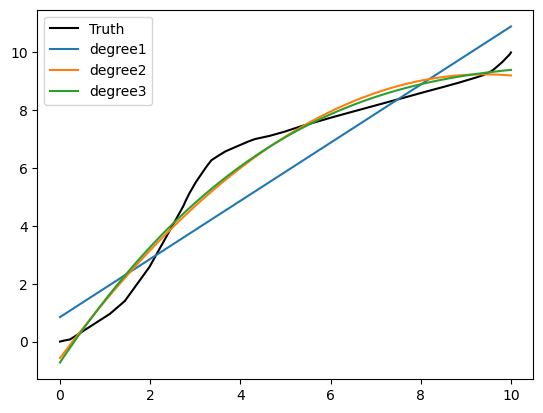

loss [0.037048276004066405, 0.05617515208621737, 0.08631123741294086]
mse [1.1434297238260016, 0.263648115941087, 0.2536778681357529]


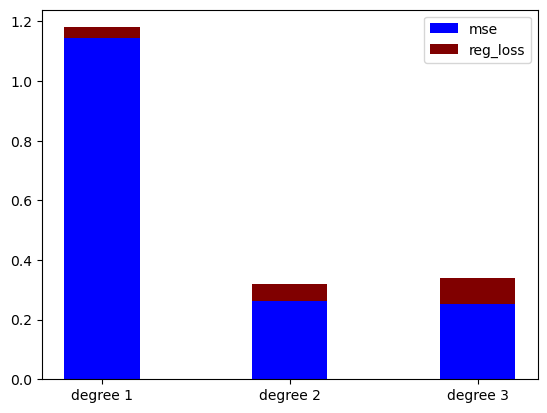

mercadolibre.com.ve


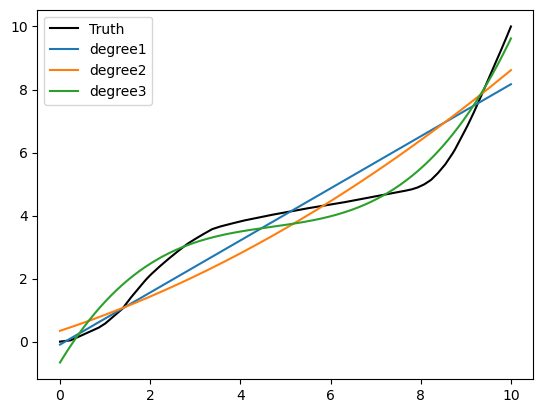

loss [0.014661514416318305, 0.03406690011788274, 0.07606379156807462]
mse [0.7704928087284926, 0.6716789360425209, 0.16813647919408087]


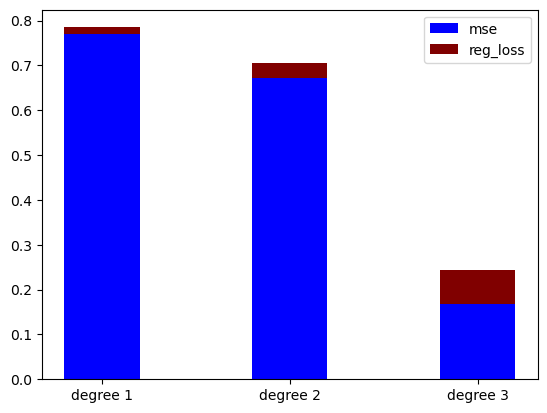

mercadolivre.com.br


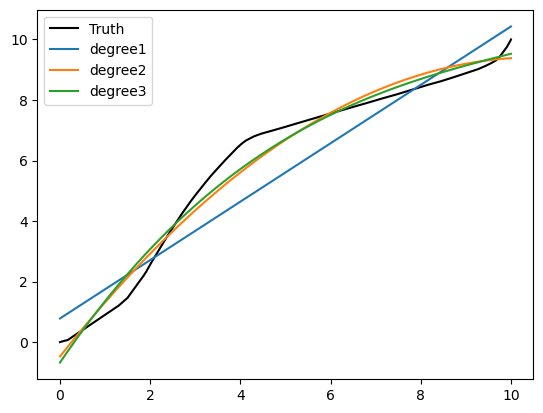

loss [0.03492968874240494, 0.05257107804934392, 0.08123265828876383]
mse [0.7867872874338031, 0.18264719653397532, 0.16943485496653532]


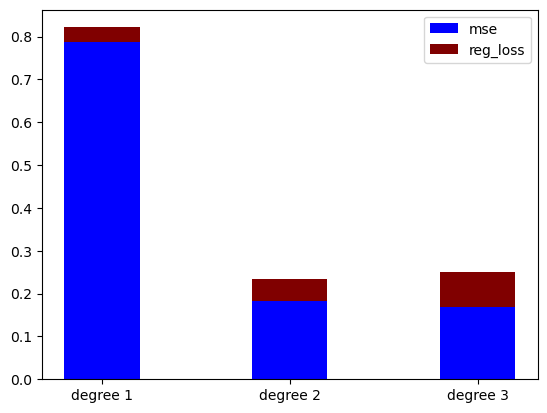

metropoles.com


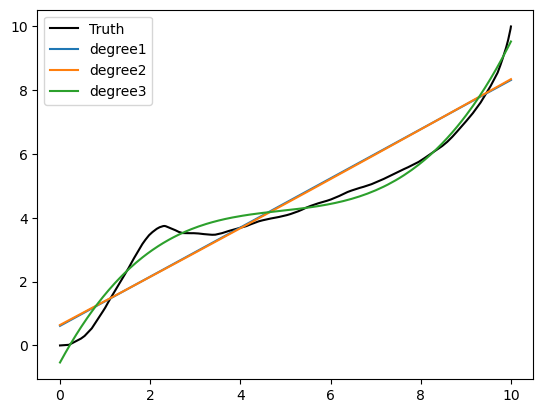

loss [0.02771333076102608, 0.05576492185679279, 0.09611715358610136]
mse [0.6433434964684536, 0.6430405757404114, 0.08943913387513908]


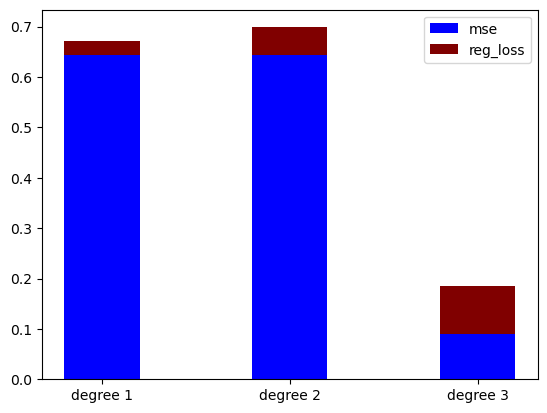

miao.tmall.com


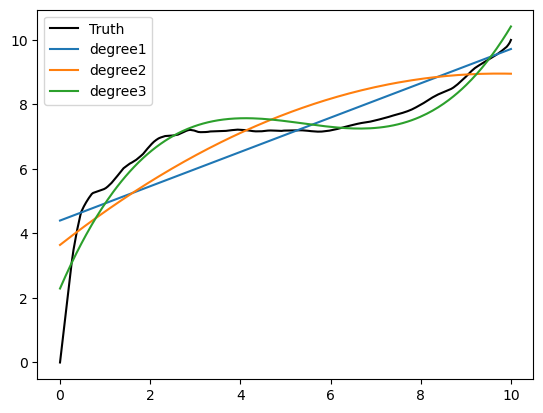

loss [0.09864571977053904, 0.18724734501344245, 0.2958081693036001]
mse [1.171142925299219, 0.9426254844878057, 0.28284604827496596]


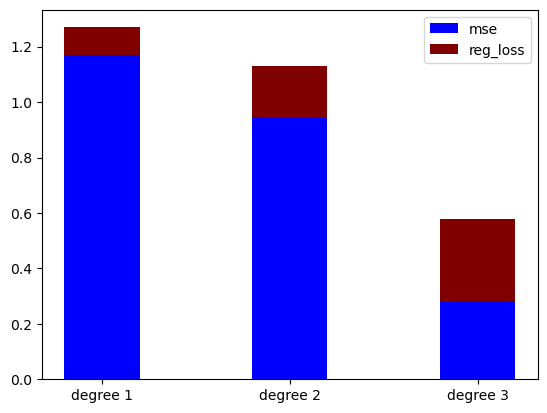

microsoft.com


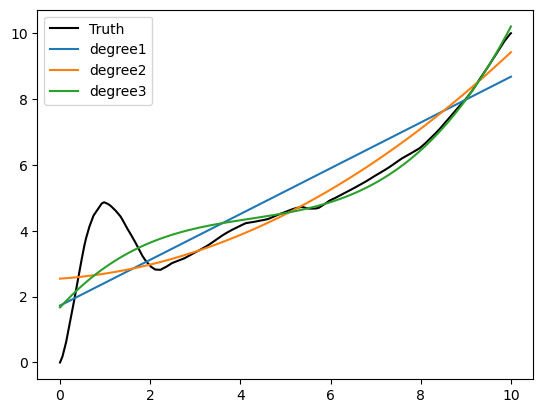

loss [0.04846475321318472, 0.10800655316007139, 0.17335405956672134]
mse [1.0077084385653243, 0.7457255535950319, 0.49366007019666414]


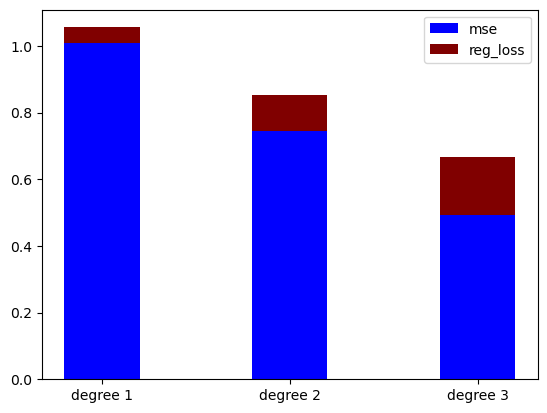

mozilla.org


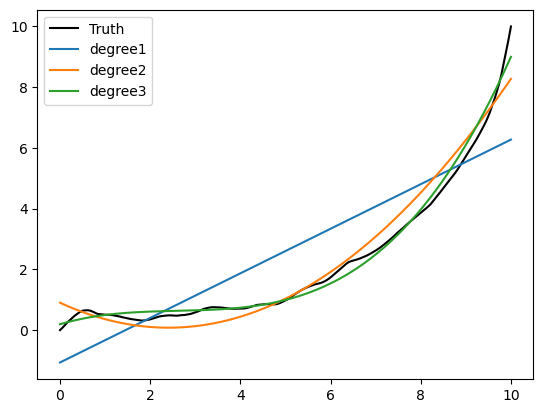

loss [-0.006636193114089948, 0.014426514732919218, 0.029896525119915286]
mse [1.7524998843969501, 0.23896145267529148, 0.06289959575199294]


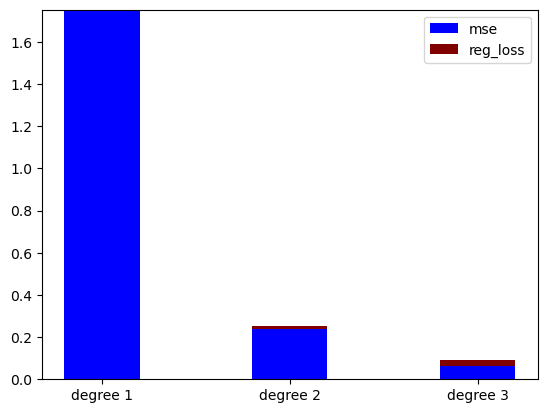

myanimelist.net


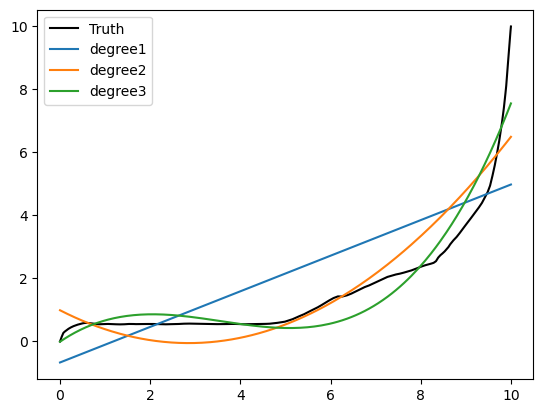

loss [-0.002026342539910664, 0.015548658981655228, 0.04012835439802733]
mse [2.0337141178843963, 0.8413249179325383, 0.3918611004679892]


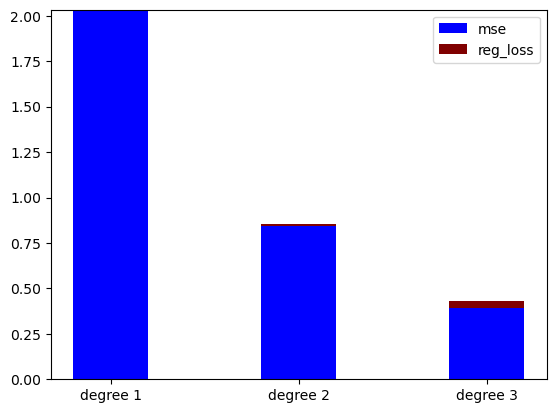

myhome.tmall.com


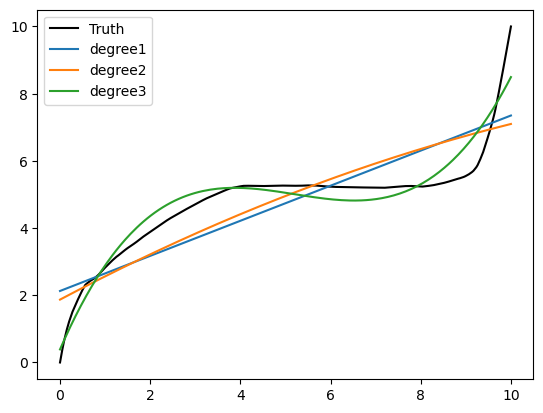

loss [0.05300710518480717, 0.10251612853960282, 0.173269065360632]
mse [0.9629118957716563, 0.9367262835194203, 0.24076248884288098]


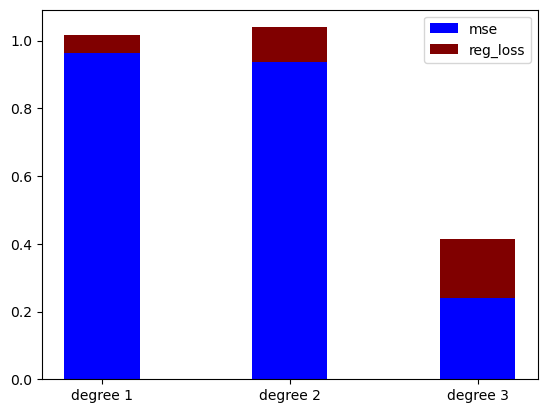

n11.com


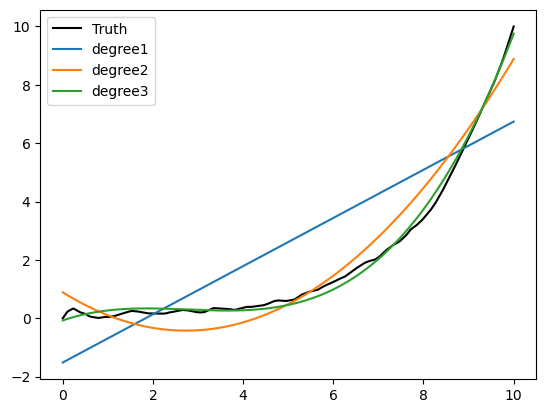

loss [-0.01379853759282233, 0.004132655252836184, 0.016112511915189184]
mse [2.542911622986525, 0.34024713369157505, 0.029699284692034818]


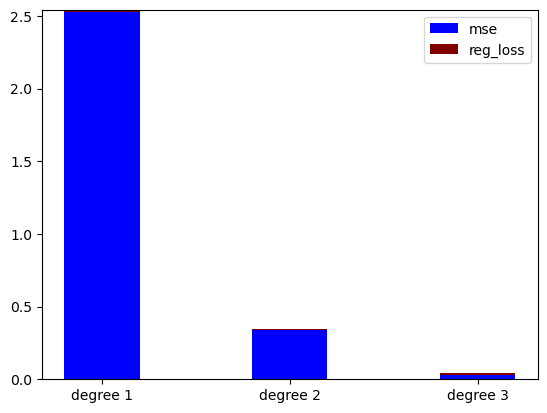

naija.ng


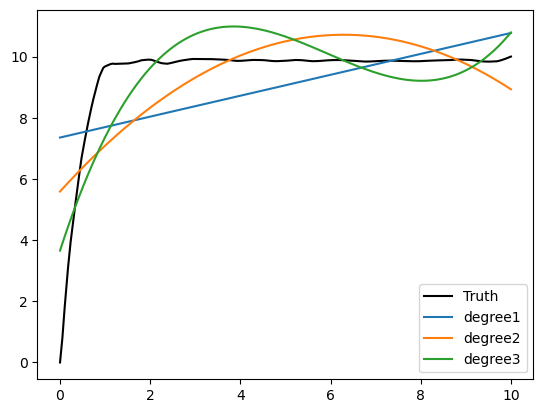

loss [0.15389258089279323, 0.28356965791541433, 0.44205109629127515]
mse [3.356209099186067, 2.212918181808854, 1.1482554893569918]


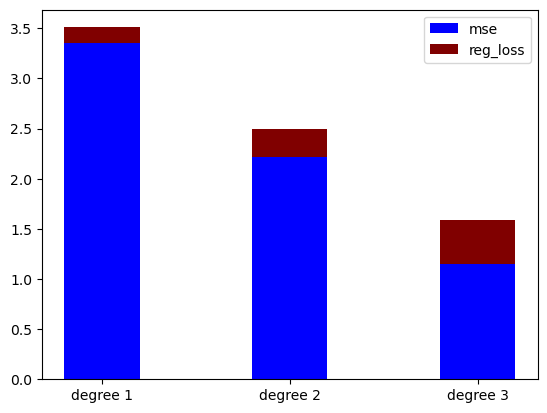

newstarads.com


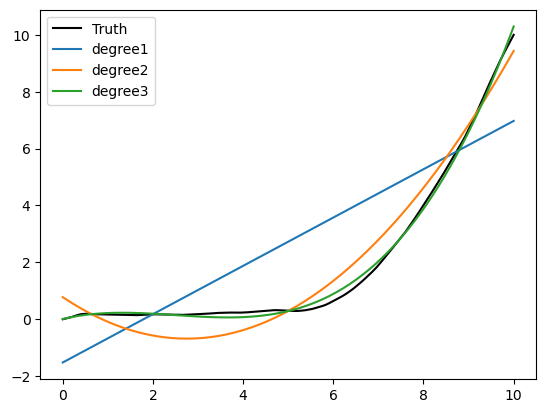

loss [-0.013405380038953411, -0.0036039120935656577, 0.013111506419366776]
mse [3.142555445909552, 0.29939510813239006, 0.014568061075438427]


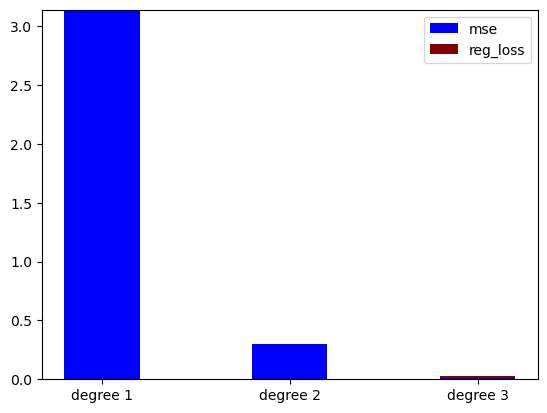

nianhuo.tmall.com


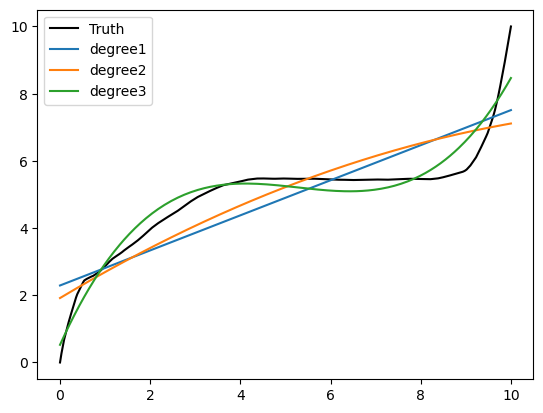

loss [0.05627353056076079, 0.1076331015255696, 0.17630927489343834]
mse [0.8310208456954594, 0.7739701307019773, 0.19871575371426745]


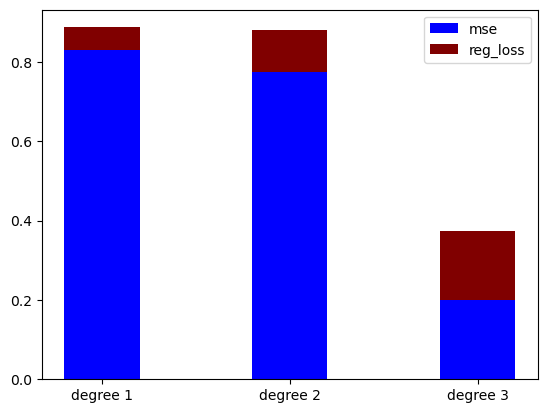

ninisite.com


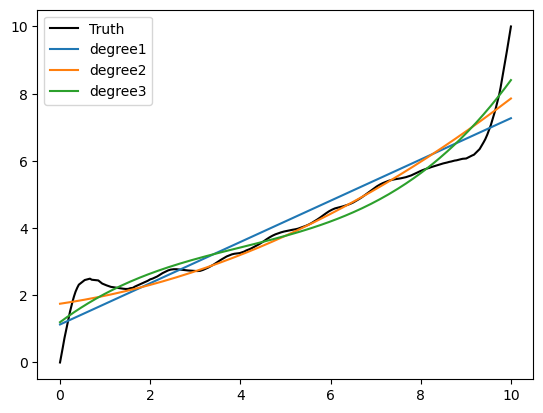

loss [0.0348994276986979, 0.07950978590092325, 0.12284990211748363]
mse [0.4179605081453829, 0.29956662370714954, 0.215755594936042]


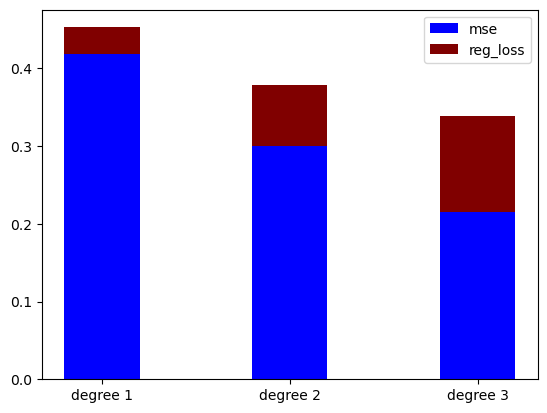

nordstrom.com


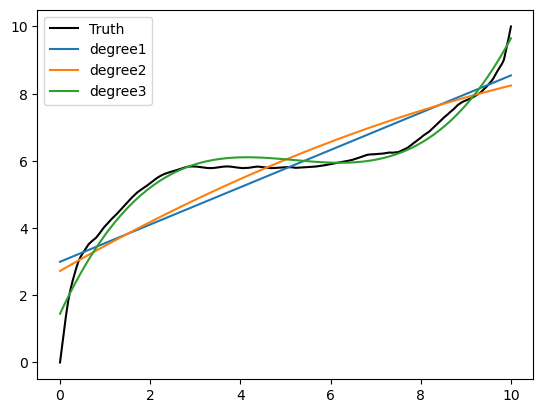

loss [0.07103825647271826, 0.13896901301240364, 0.22779773254071486]
mse [0.7681579158792837, 0.7340358472851554, 0.10247641741410497]


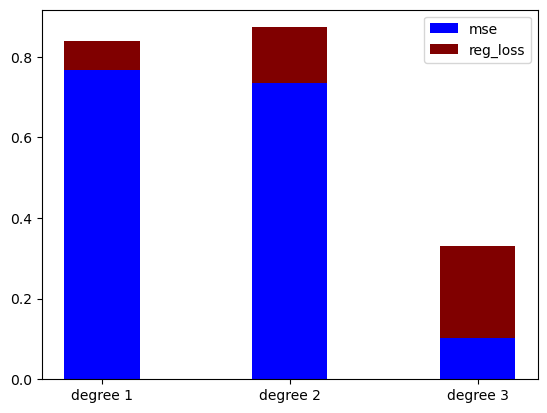

npr.org


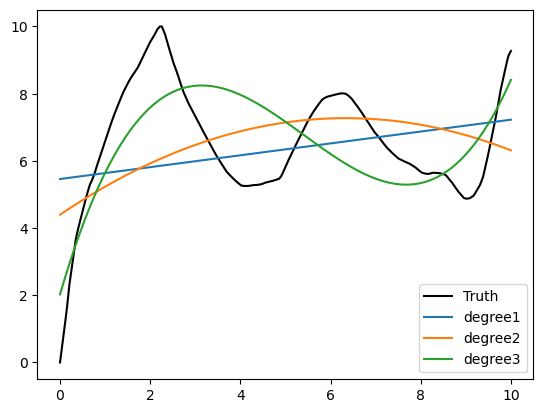

loss [0.11273064171869131, 0.20932087599158739, 0.338696776433983]
mse [4.004149311103369, 3.619225774665141, 1.7885060510840427]


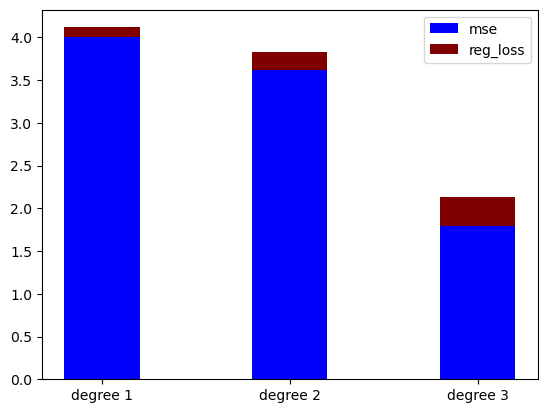

nvzhuang.tmall.com


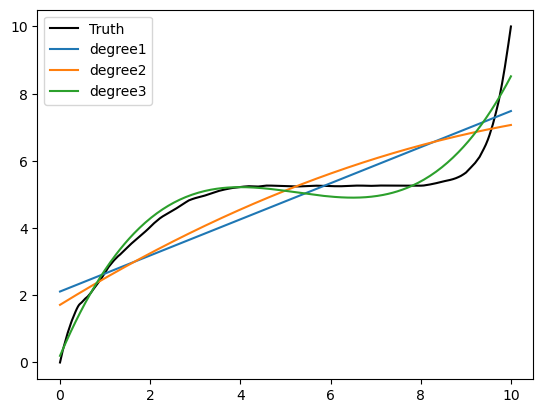

loss [0.05297751102626977, 0.10047526328873525, 0.16551501038548513]
mse [0.9297036307330816, 0.8681659803241701, 0.1558745055605985]


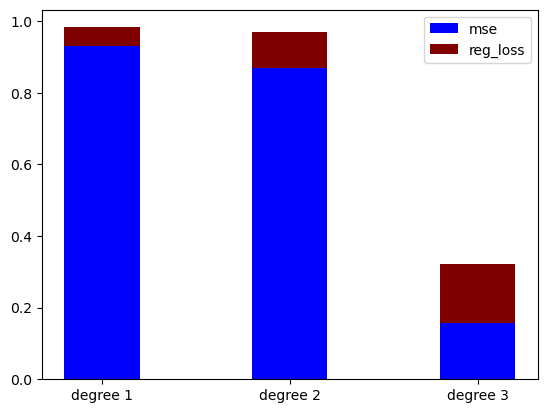

olx.pl


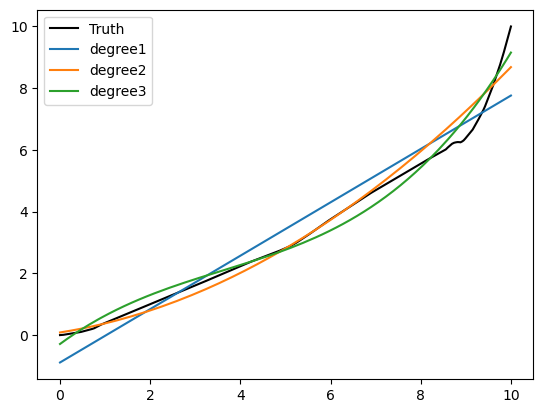

loss [-0.0004516863100521573, 0.015142984253231712, 0.037833689902967385]
mse [0.5348795625581504, 0.1510753059261861, 0.08407642615658696]


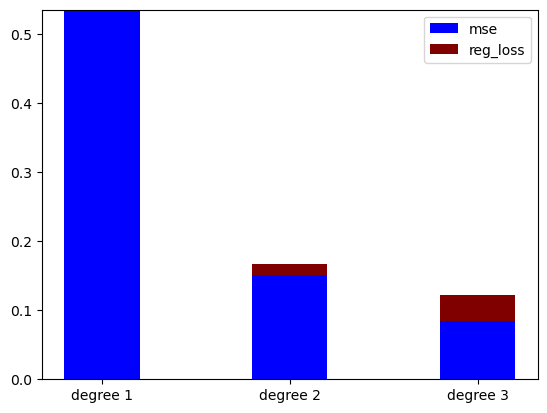

orange.fr


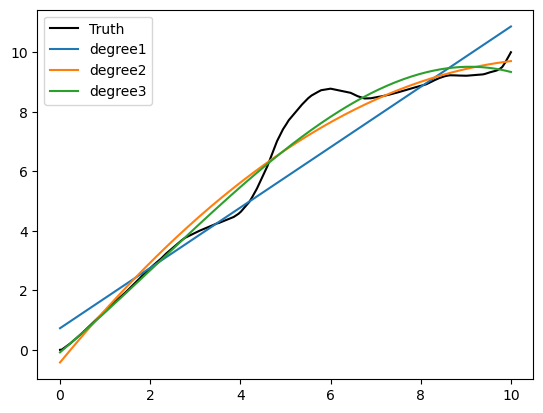

loss [0.0348020263417515, 0.05343027652500022, 0.07560069093577447]
mse [0.7522291833905179, 0.23190701356096863, 0.18345901007089663]


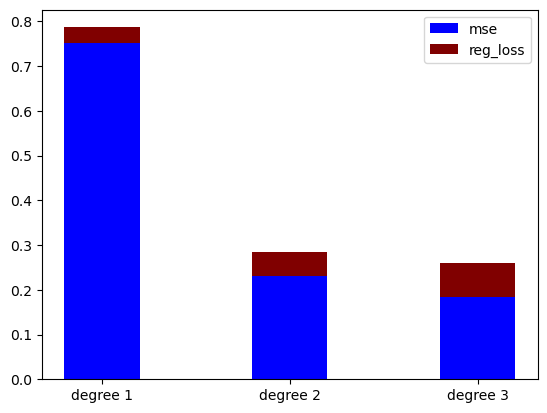

pages.tmall.com


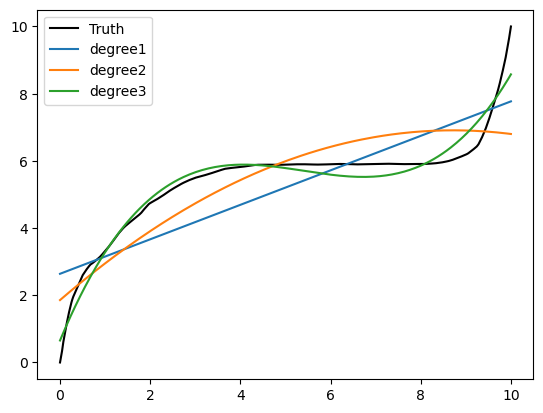

loss [0.06305048617596906, 0.1179791004797362, 0.19680974601415416]
mse [1.1251342822590382, 0.8320095285948202, 0.13264392182323825]


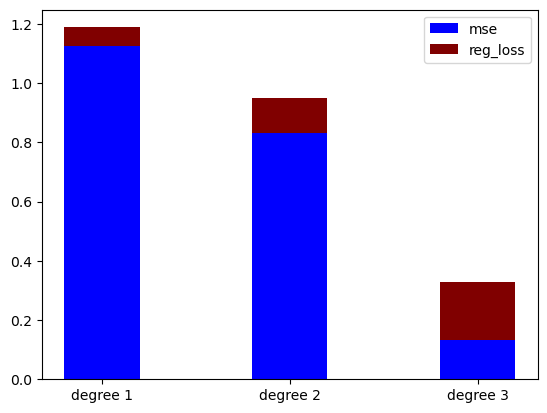

patch.com


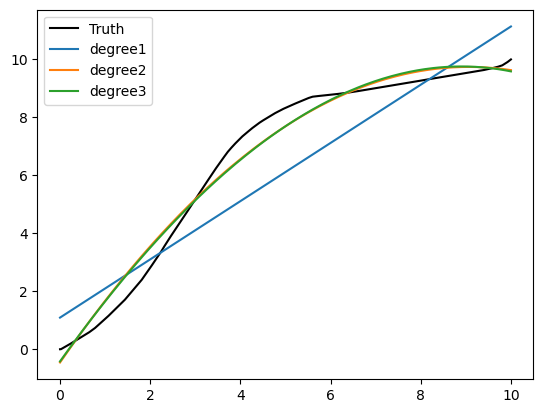

loss [0.04191963143983845, 0.06681513044425072, 0.09907541941569521]
mse [1.4165530241531554, 0.16836590431563334, 0.1673609163813834]


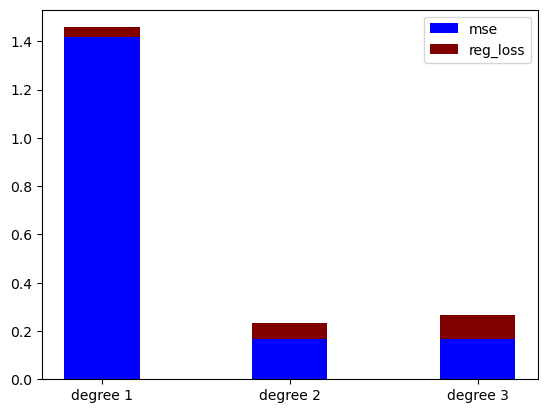

paypal.com


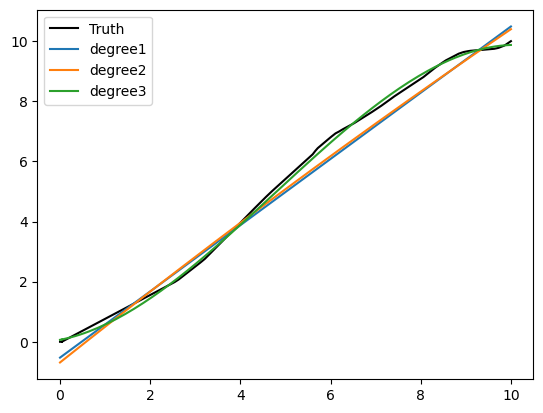

loss [0.011487040625725482, 0.01998346531316202, 0.034349810172882654]
mse [0.14335423952152096, 0.13882815224433215, 0.008207268949946377]


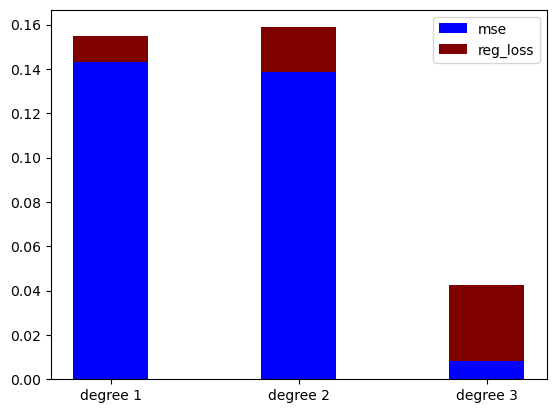

pikabu.ru


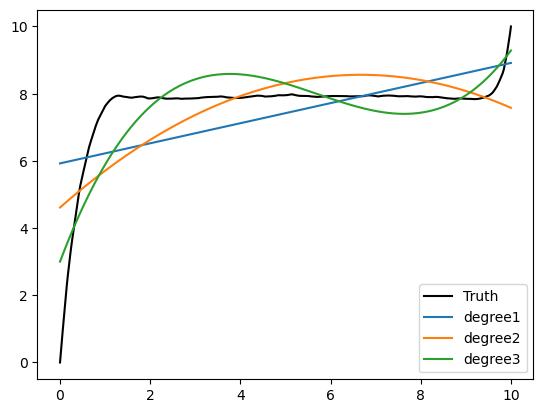

loss [0.1244854555520705, 0.2283007414655356, 0.35332898133774976]
mse [1.9198175723385076, 1.3743977205638829, 0.6323426681922745]


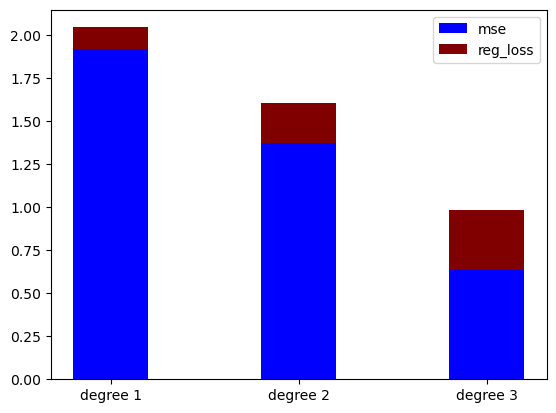

pinimg.com


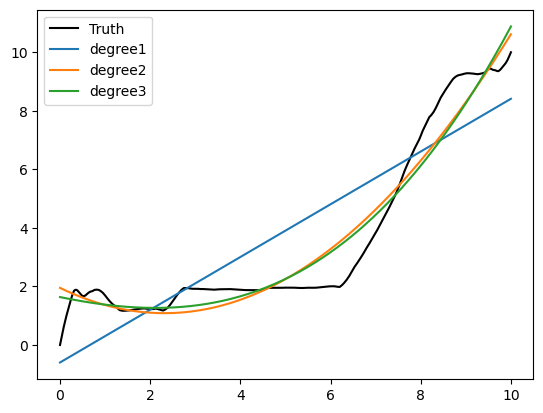

loss [0.006056926773165175, 0.054602127739292614, 0.08266214523309301]
mse [2.321268927360434, 0.5465630097389144, 0.5236897558305638]


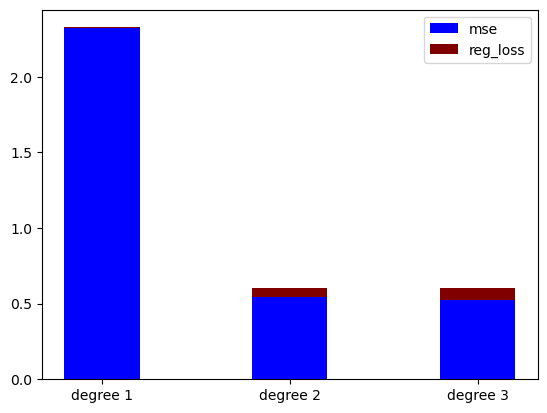

pinterest.com


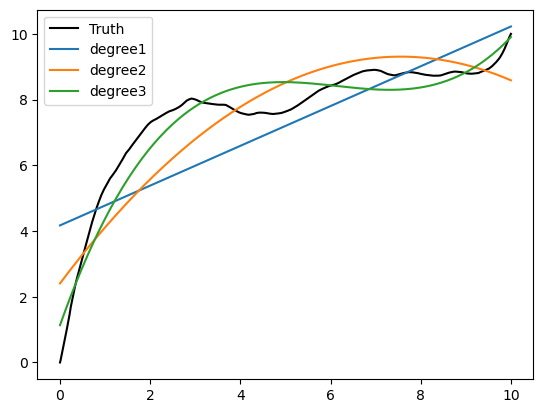

loss [0.09553716281192128, 0.16446607334639032, 0.26267213620338725]
mse [1.9792367452224173, 0.8994042399022136, 0.30617217720197015]


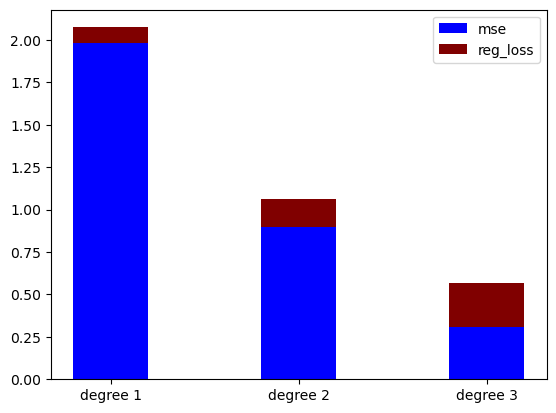

pixnet.net


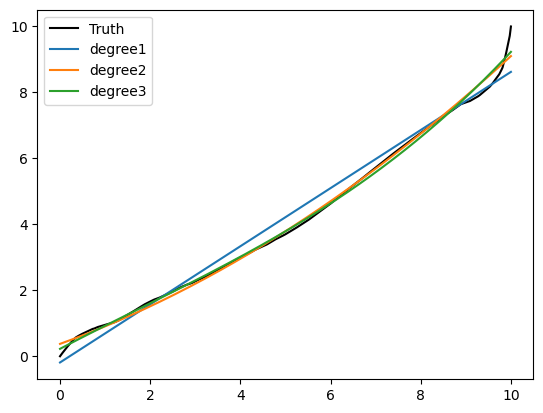

loss [0.01384755128098695, 0.0362691867706353, 0.05549800771665803]
mse [0.14209055342231544, 0.0378159839943954, 0.031104439703958667]


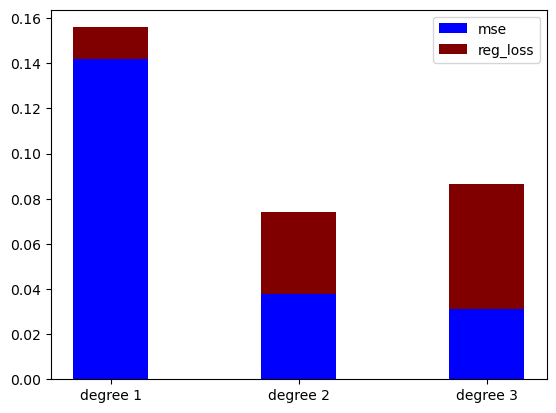

porn555.com


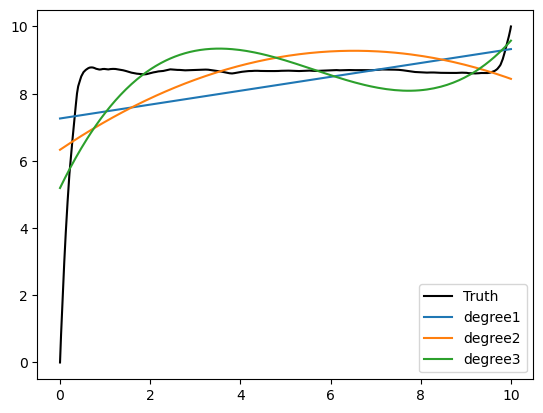

loss [0.1493626024043687, 0.2865809031370195, 0.44560509986036584]
mse [2.0879589653099497, 1.7260188987669511, 1.2264226186561398]


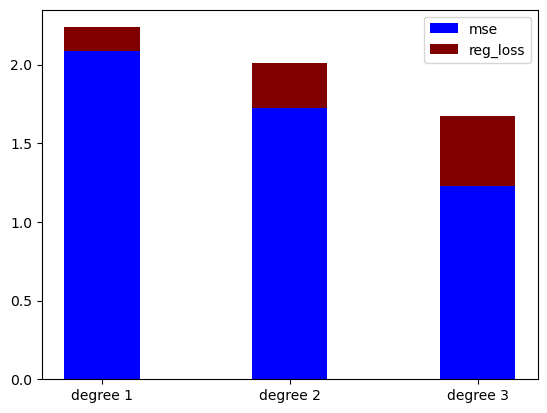

prezi.com


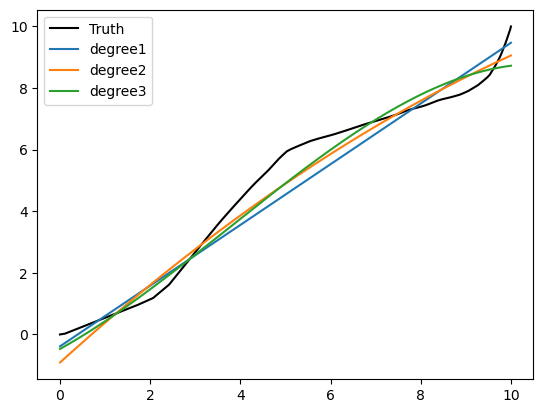

loss [0.011988282667702448, 0.01529399482803088, 0.02573527114334228]
mse [0.3017340064824618, 0.24417579688018898, 0.21086943080753848]


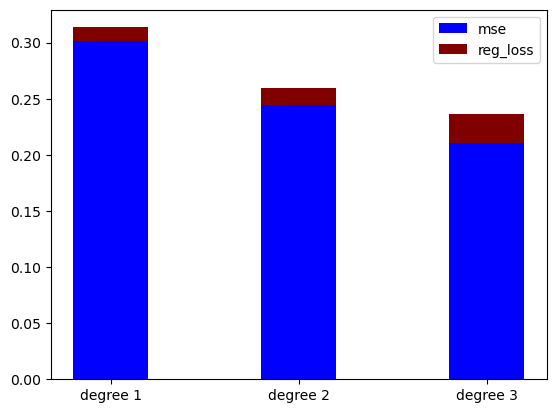

prothomalo.com


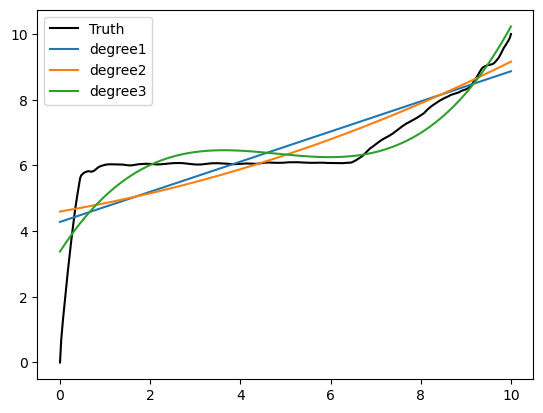

loss [0.09476119471141392, 0.19401175708593169, 0.3041063070335834]
mse [0.9855212997395902, 0.9478975302147636, 0.49085583213301465]


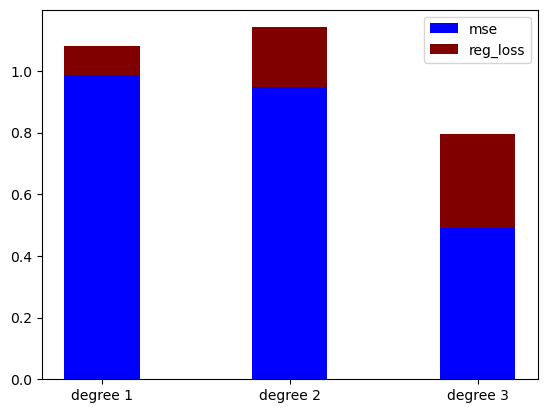

quora.com


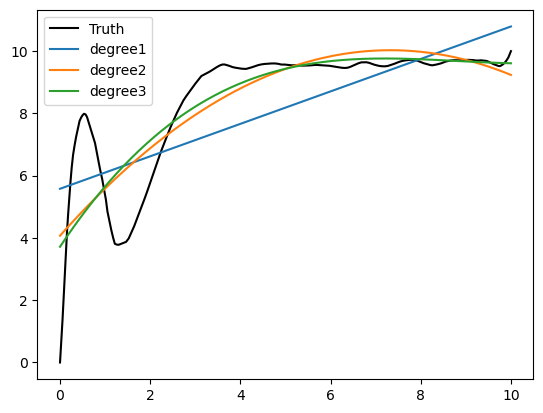

loss [0.1220043068889928, 0.22350447162828924, 0.3391448370149341]
mse [2.317462592750182, 1.4516427273058947, 1.409797786652747]


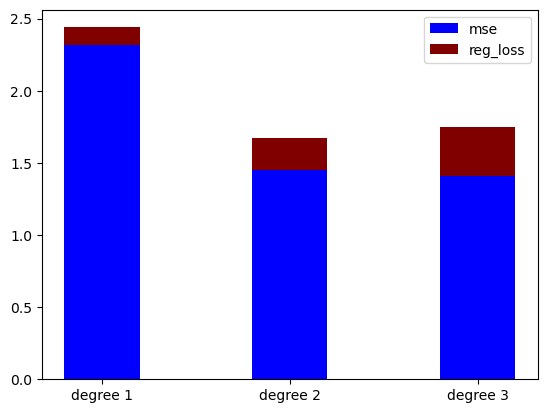

rbc.ru


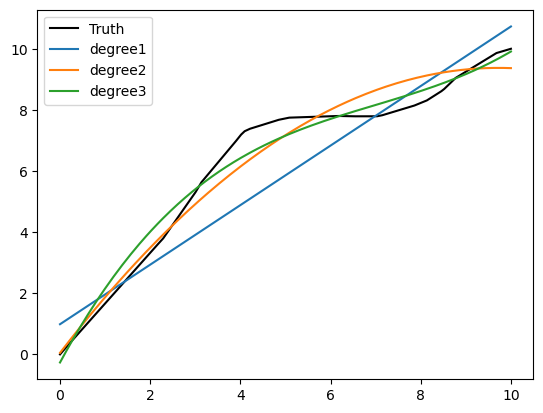

loss [0.03923022041489915, 0.07479687293850897, 0.12935048087210504]
mse [1.0447371125192382, 0.24896579114099318, 0.12512104235006125]


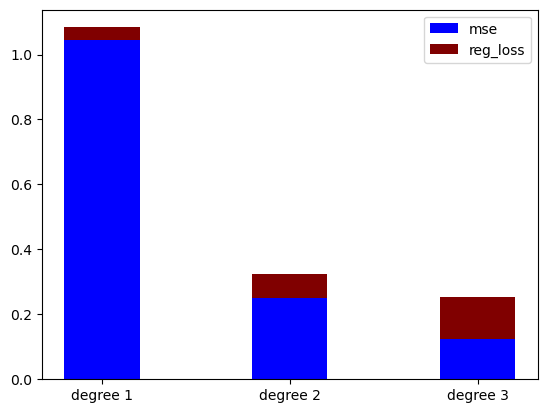

rediff.com


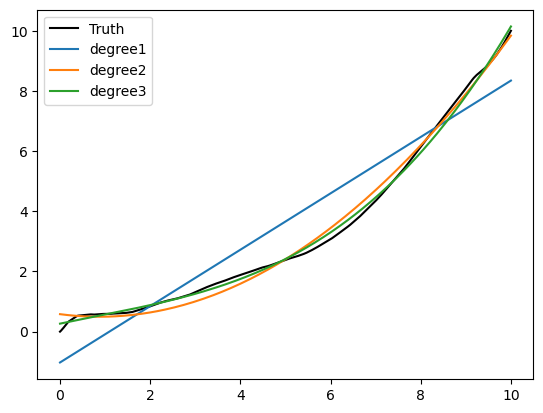

loss [-0.001762128216813268, 0.019890667339683917, 0.03413198472566715]
mse [1.0170172477486004, 0.05461396165587318, 0.020838021057562106]


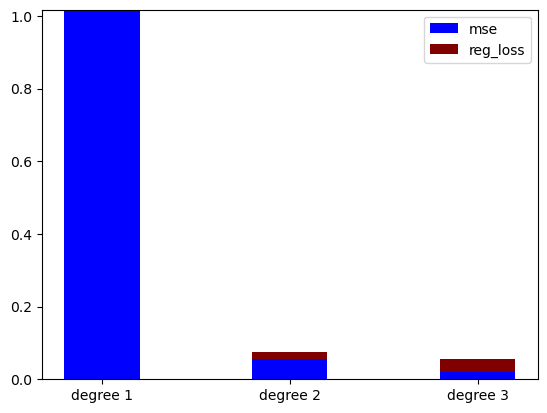

redtube.com


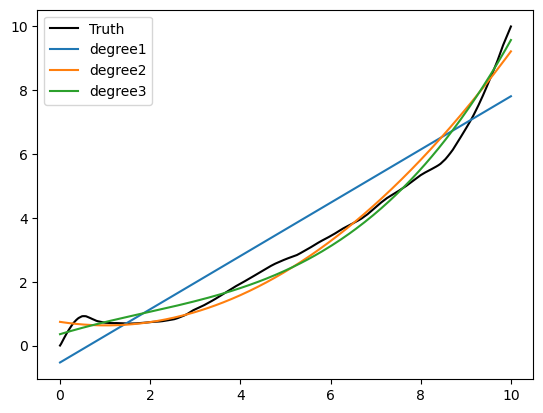

loss [0.006069094918642905, 0.02527544538918761, 0.04415380243700041]
mse [0.9675647734190784, 0.14484755732312524, 0.08660058302703183]


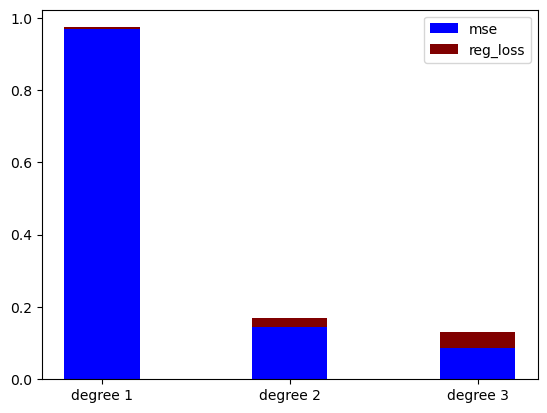

repubblica.it


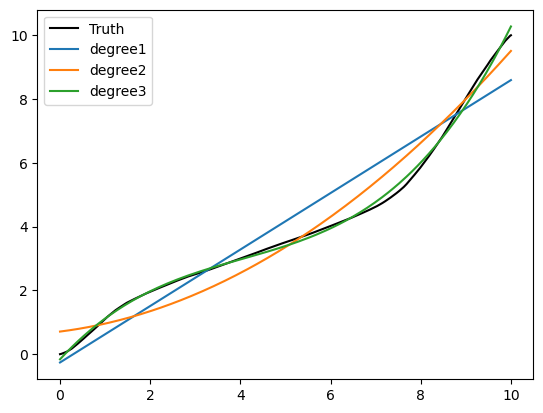

loss [0.01249695281803211, 0.03831772273160909, 0.06703555021339595]
mse [0.6251400018192484, 0.26282094916749393, 0.013959810986217458]


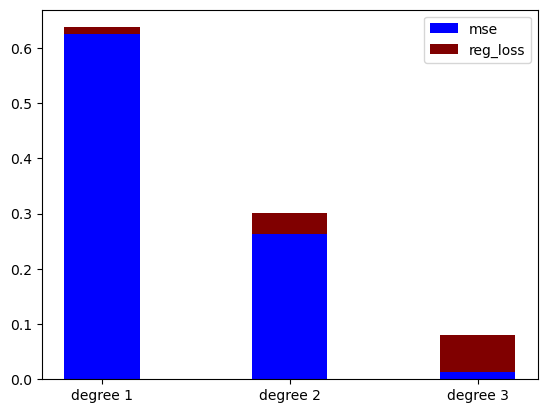

reuters.com


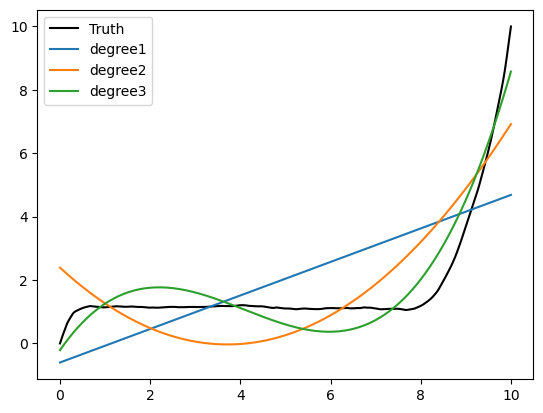

loss [-0.0014575532245460843, 0.05043180718557823, 0.07533919448149323]
mse [3.6630101808077677, 1.5698383332344215, 0.3702655531467015]


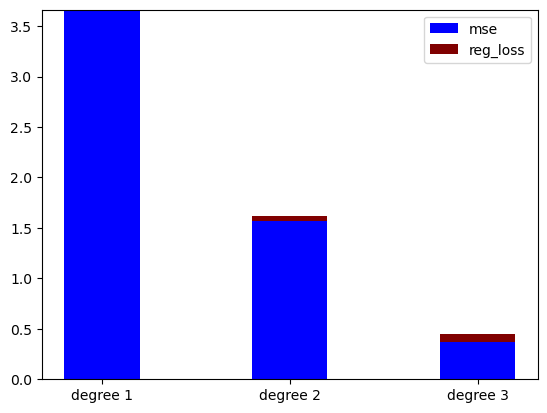

rotumal.com


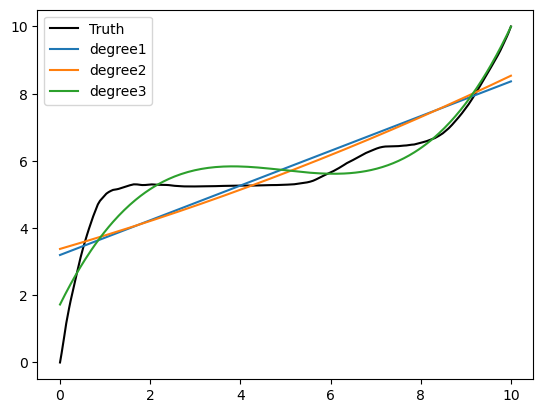

loss [0.0743123985891524, 0.1513141153577069, 0.23425024779269246]
mse [0.9402871706749846, 0.9299621999224571, 0.25969403374664]


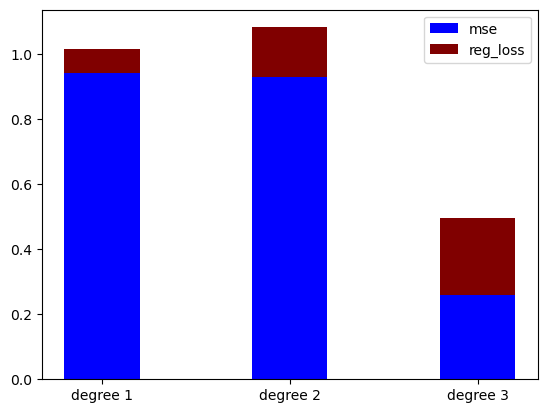

ruliweb.com


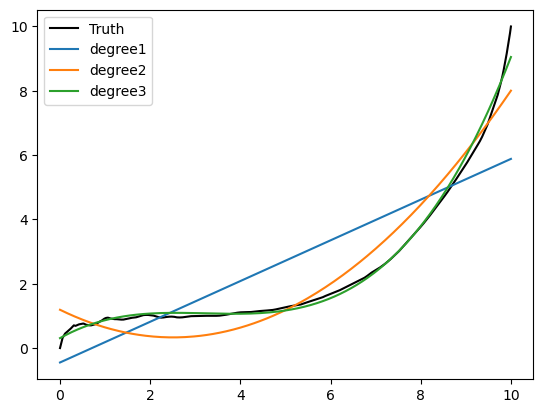

loss [0.003692591644621581, 0.025678909881721626, 0.05199181021922932]
mse [1.6726298628839067, 0.34200519570544186, 0.0325004870019493]


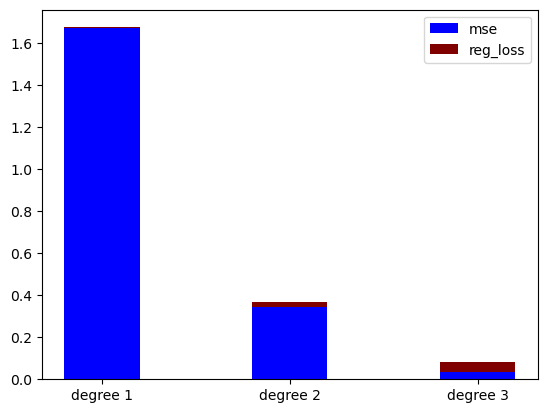

rutracker.org


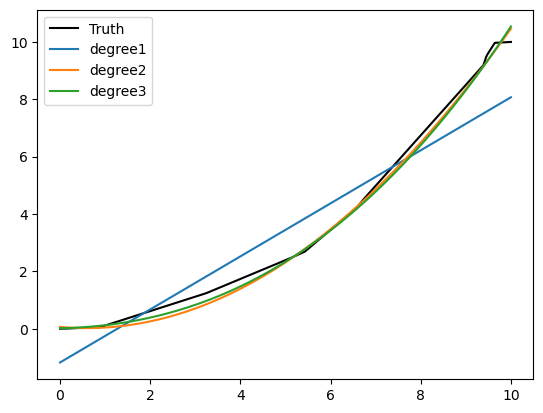

loss [-0.00507075956985114, 0.0016036346124692425, 0.00723905420148047]
mse [1.449347313919549, 0.02467763314707403, 0.022368608879001675]


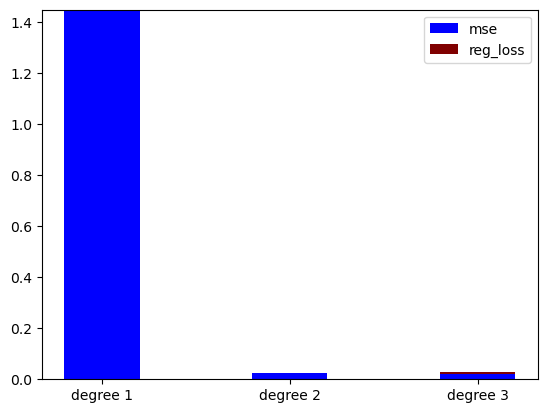

rutube.ru


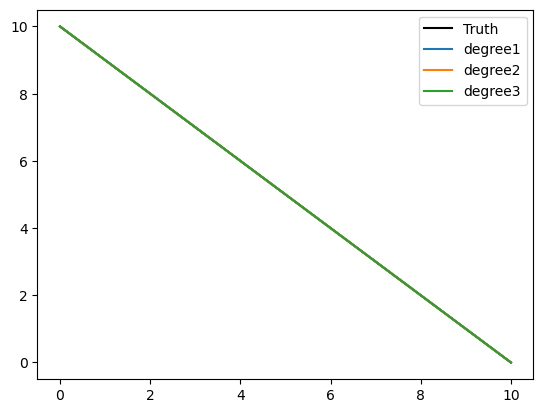

loss [0.18000000003868835, 0.36000000003245797, 0.5399999999559678]
mse [1.0497843642371757e-15, 1.0495032049688416e-15, 1.0494637960860577e-15]


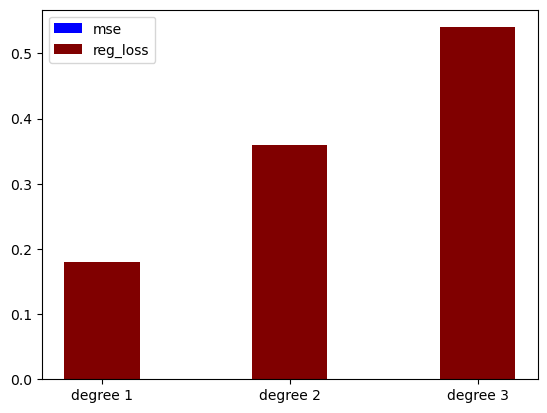

scol.com.cn


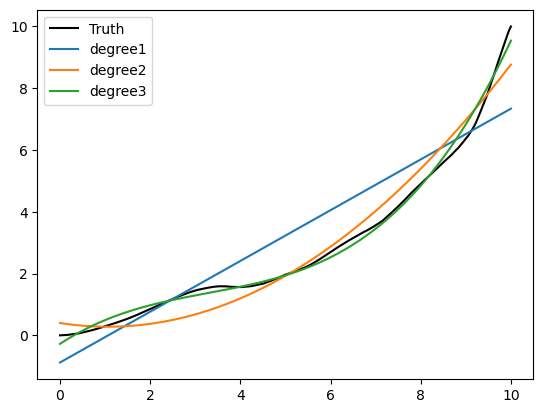

loss [-0.0011359920669318459, 0.011171805709279323, 0.02964493519631132]
mse [1.054935093502037, 0.24630509135086756, 0.04451537233348696]


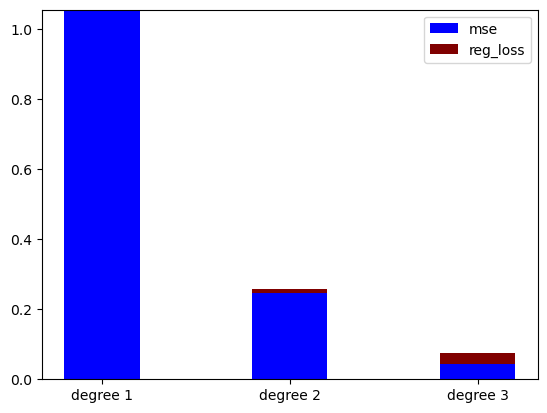

scribd.com


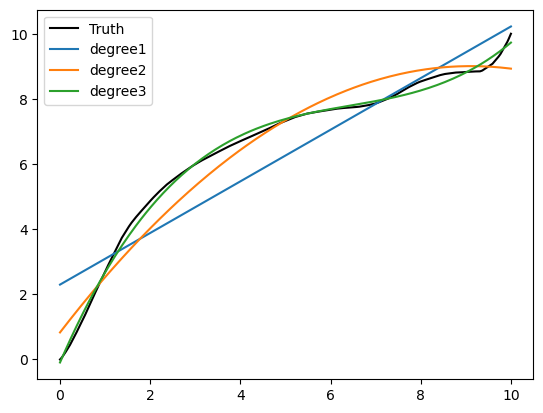

loss [0.061816365232656906, 0.10106214703328416, 0.16034373493026338]
mse [0.9998315731016979, 0.2762210953362114, 0.02231475175105464]


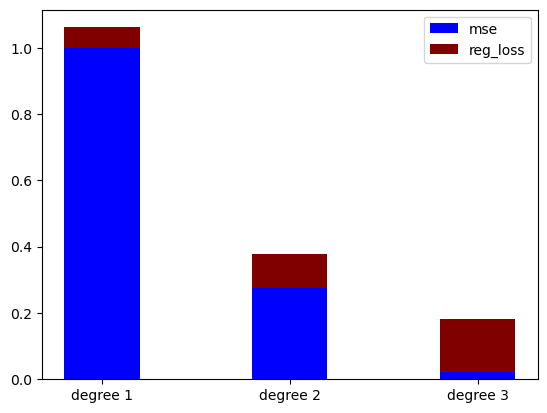

sex.com


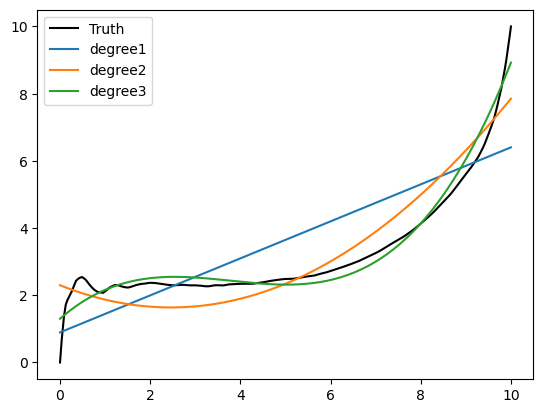

loss [0.02892096014420502, 0.07482314794798223, 0.12969283114878247]
mse [1.5031054815960394, 0.6037999957433202, 0.14987144634461338]


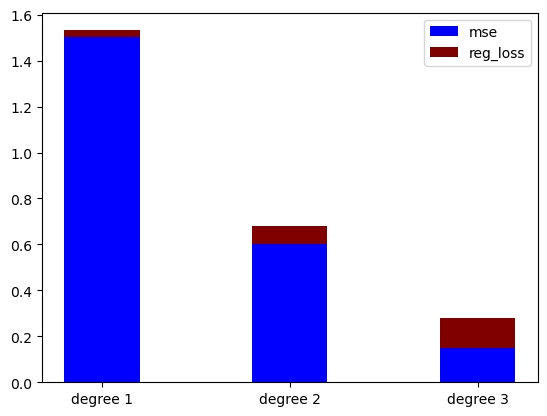

slack.com


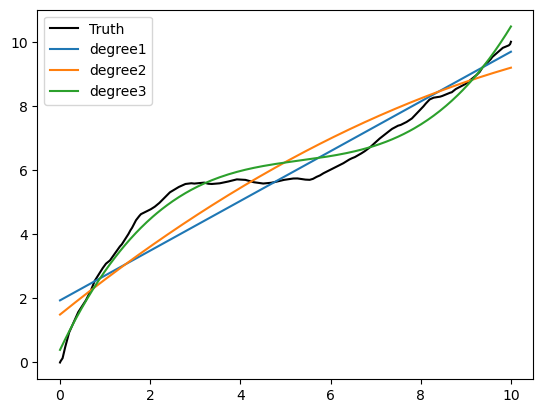

loss [0.05423843541626539, 0.10363725414567483, 0.1712152999613783]
mse [0.6726654676800479, 0.5842445035713039, 0.09909970980021272]


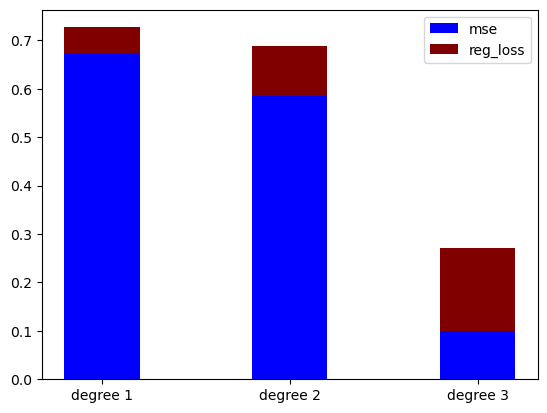

slideshare.net


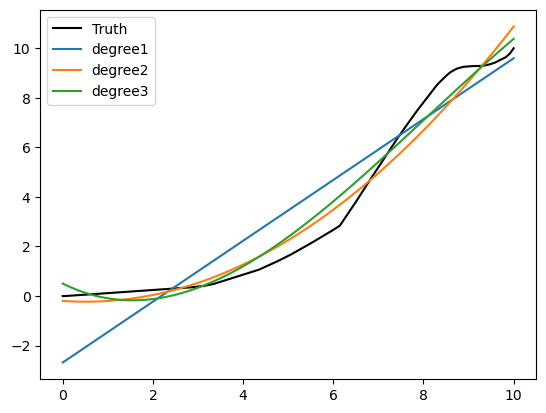

loss [-0.02906399077612244, -0.008019305323364073, -0.005513359822343193]
mse [1.0873786119486235, 0.2959425326682322, 0.20934125456593222]


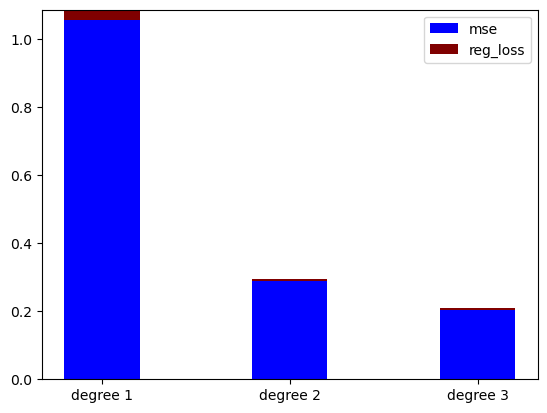

so.com


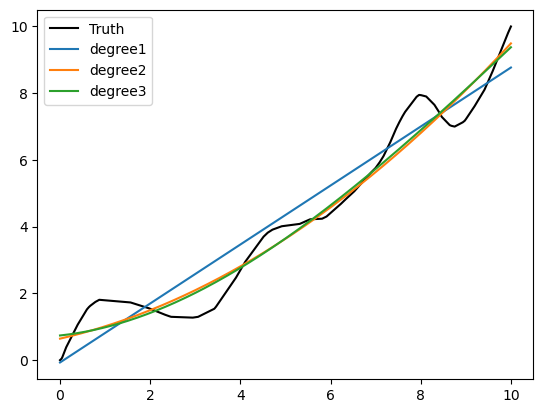

loss [0.016280119590656717, 0.04054346221033491, 0.059018634217099984]
mse [0.5424816308300997, 0.30830487153989117, 0.3036798143645144]


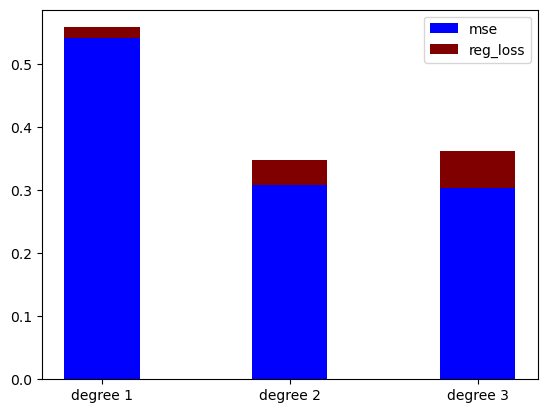

softonic.com


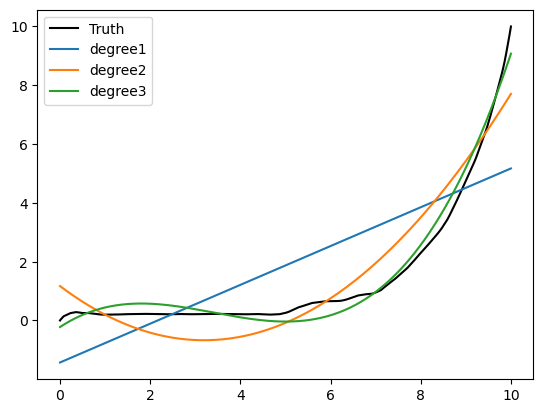

loss [-0.015364768407093544, 0.007874787442488188, 0.02655354419442254]
mse [3.153137810558781, 0.7580310806839522, 0.10468612628695753]


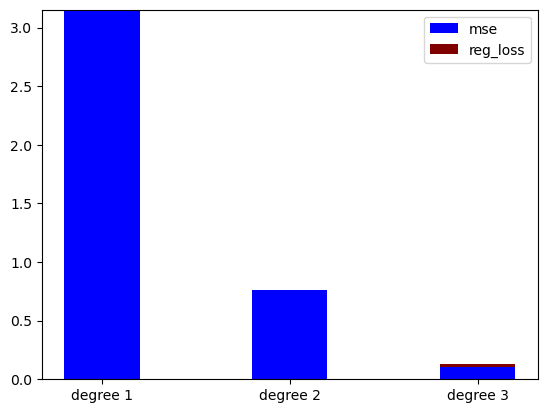

sogou.com


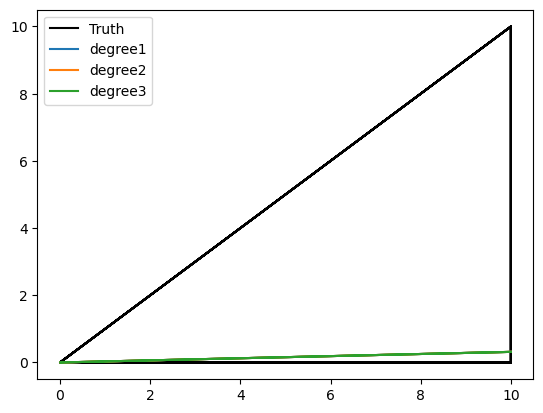

loss [0.0006315789473684214, 0.0006947368421052612, 0.0007010526315789427]
mse [2.862328234379052, 2.862328234379052, 2.862328234379052]


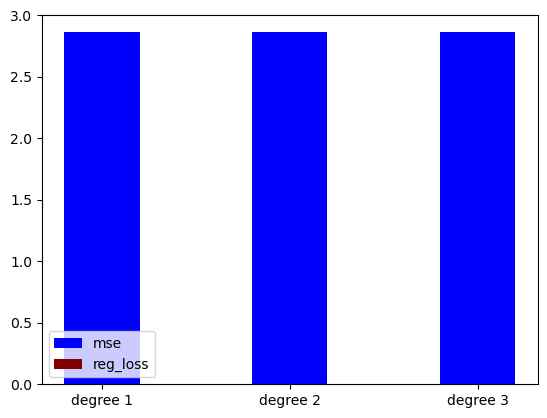

spiegel.de


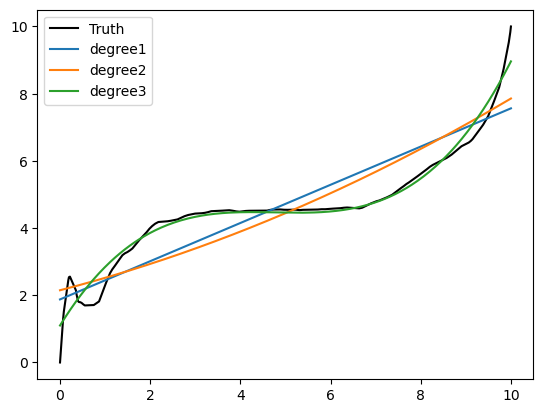

loss [0.04891290783646723, 0.10075459640636122, 0.17059503245774557]
mse [0.6450123649441956, 0.6081499737579619, 0.14121869166559695]


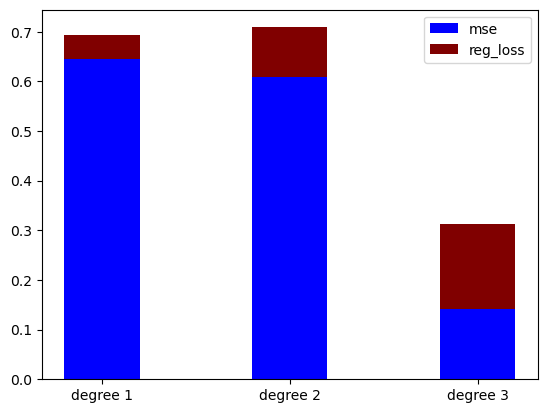

spotify.com


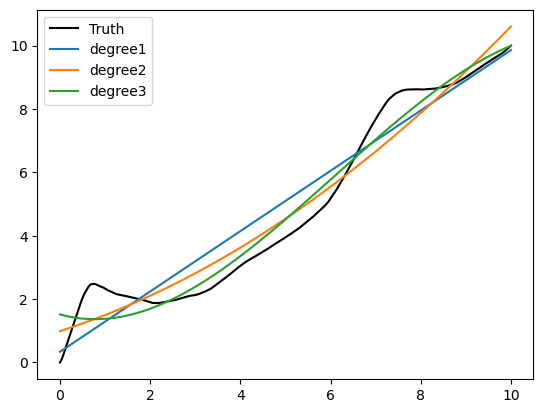

loss [0.025807167481455107, 0.059905163085116425, 0.08267652486049047]
mse [0.6105570153328551, 0.4327398683741543, 0.3307043665940669]


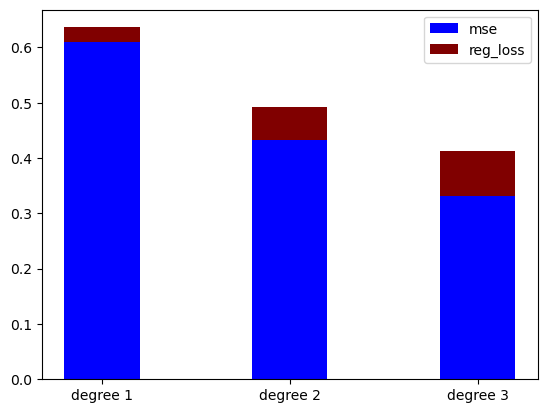

springer.com


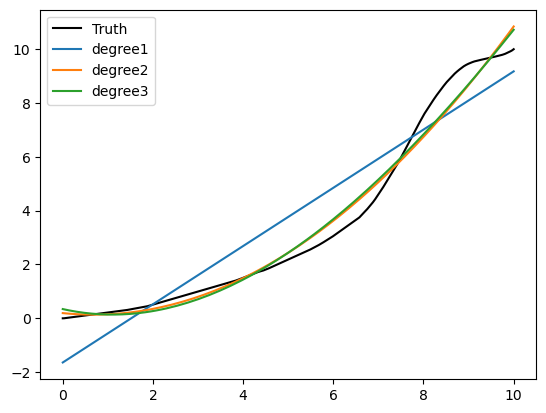

loss [-0.011192874347325419, 0.005939802748279088, 0.008408971926583278]
mse [1.2474089352694342, 0.18486863457051303, 0.1797468430824051]


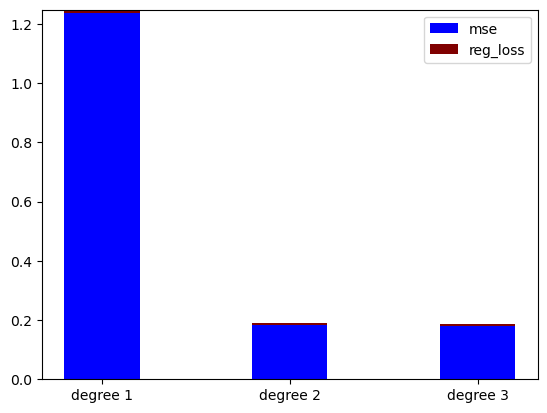

sputniknews.com


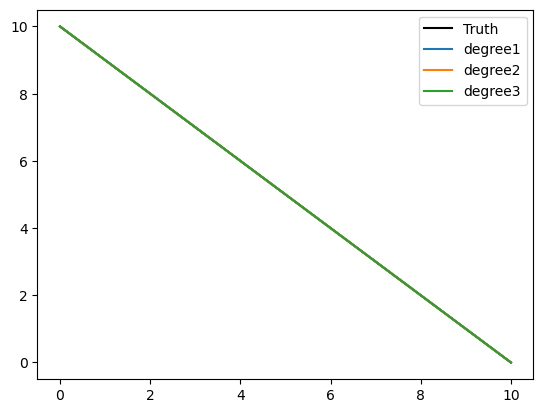

loss [0.1799999995453145, 0.3599999995782433, 0.5399999997535678]
mse [4.693453286706894e-16, 4.56642827021631e-16, 4.533953260770301e-16]


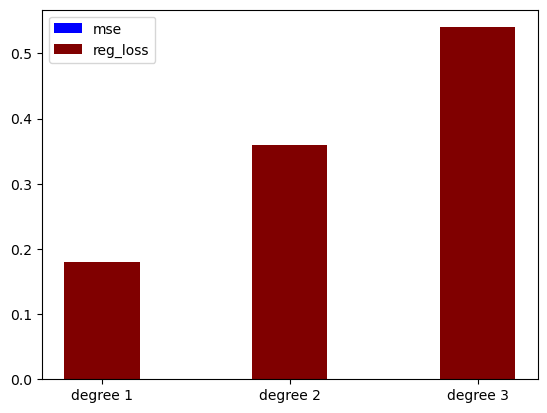

squarespace.com


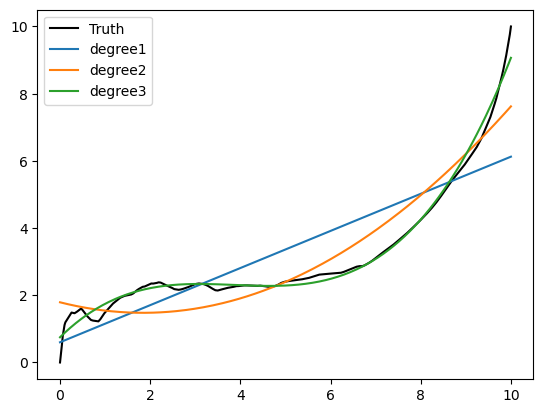

loss [0.023076693287905244, 0.06174444623323992, 0.10471631754214096]
mse [1.0514187900349488, 0.4765668128258863, 0.04720115999370259]


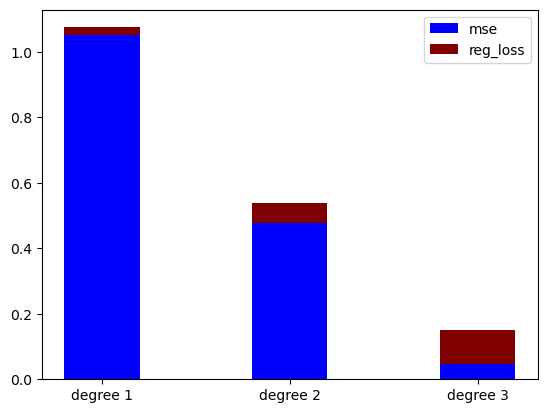

stackexchange.com


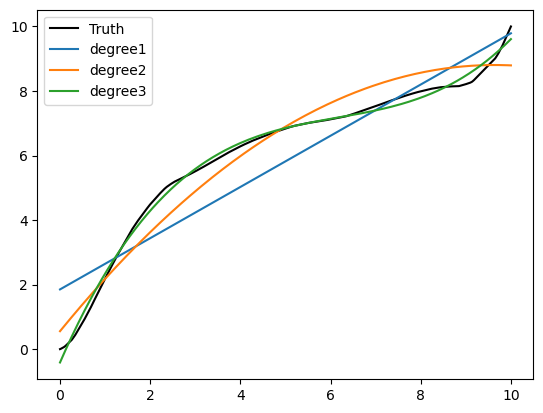

loss [0.05289752907291295, 0.08716875217690287, 0.14048660723616035]
mse [0.9206887003972984, 0.35025702577478696, 0.028842782321950547]


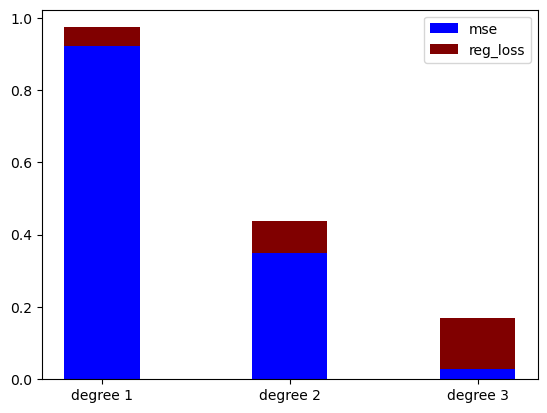

stackoverflow.com


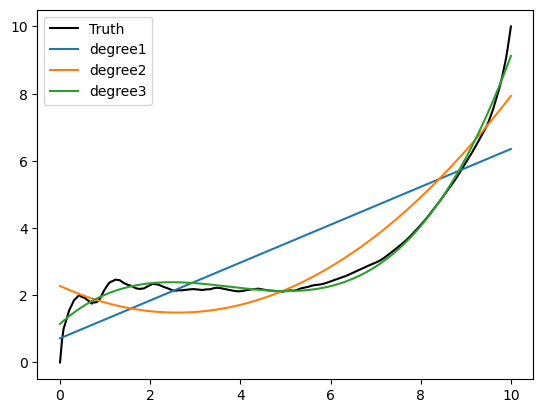

loss [0.025633194576204783, 0.0713622384259585, 0.12109657284551346]
mse [1.470176408716177, 0.4821877954923101, 0.05604279033056162]


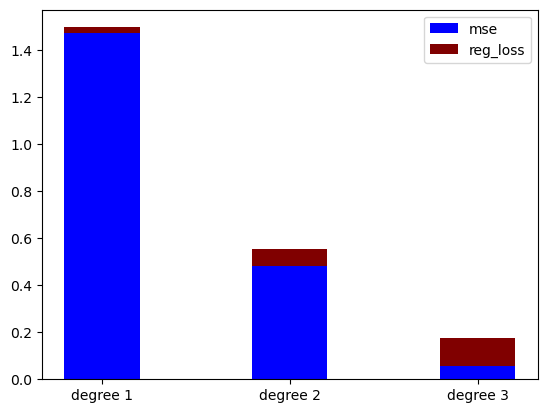

state.gov


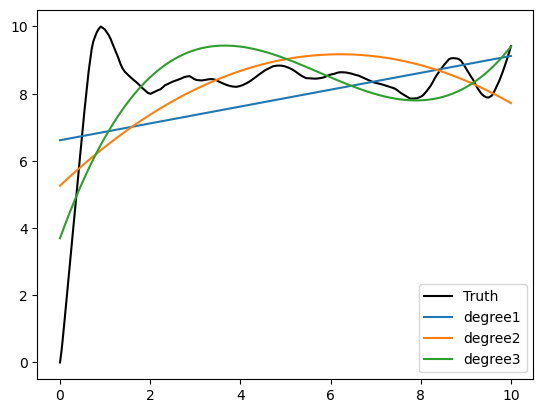

loss [0.13729282128105935, 0.25678253352102787, 0.40250560867982893]
mse [3.3007988188391955, 2.597054834215764, 1.7653628681183324]


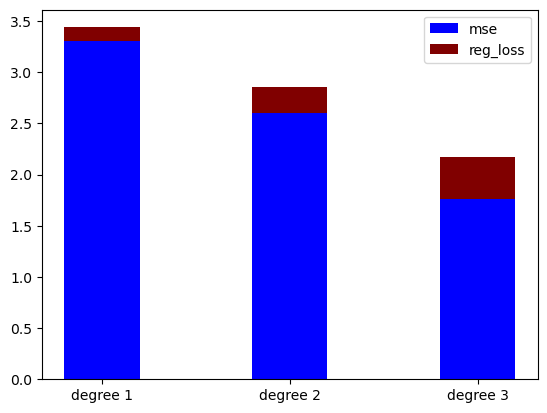

steampowered.com


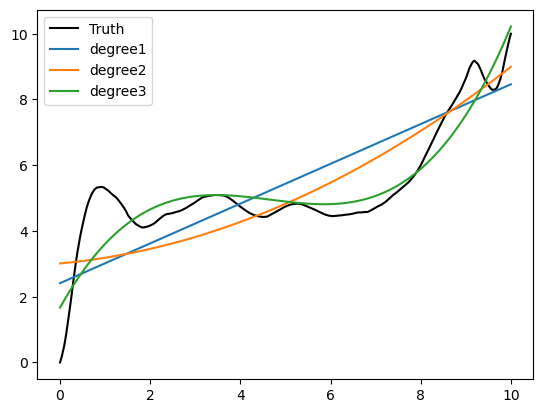

loss [0.06034738003050238, 0.12744429502591506, 0.21646813231544393]
mse [1.5776812721079372, 1.414896927603078, 0.6609211535796892]


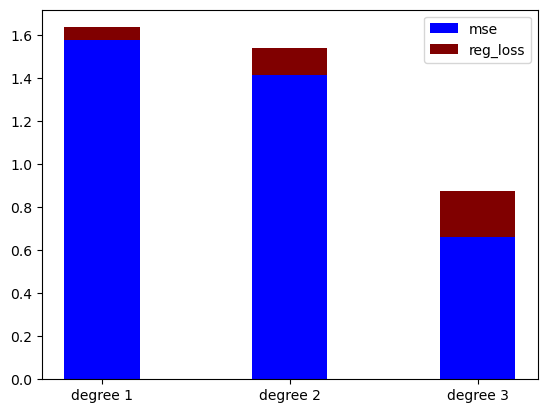

subject.tmall.com


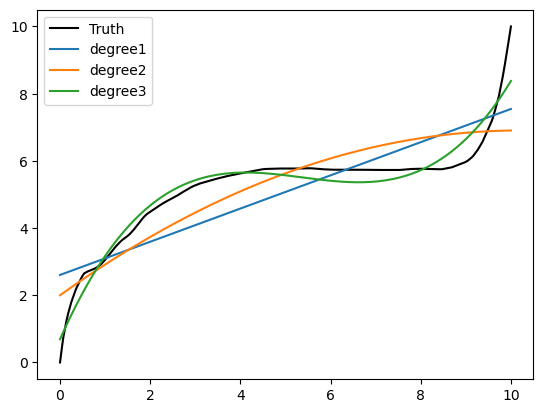

loss [0.06197708018793092, 0.1165948269479839, 0.19006693431792956]
mse [0.9229268040238804, 0.7734105715337394, 0.16961074982507832]


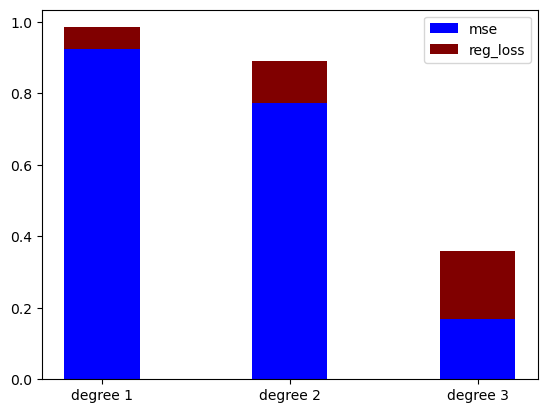

t.co


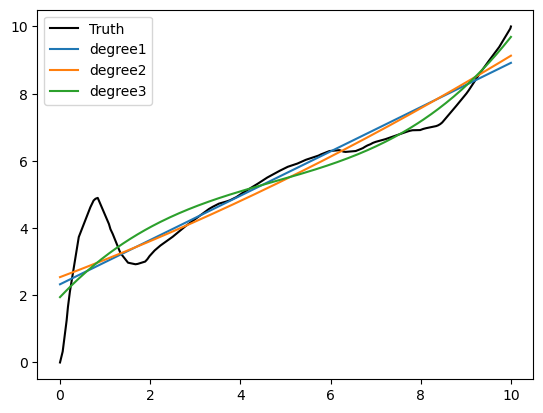

loss [0.059723337176299796, 0.12243630374803917, 0.1895319552966946]
mse [0.5723735675708302, 0.5553844076298404, 0.4473728711032879]


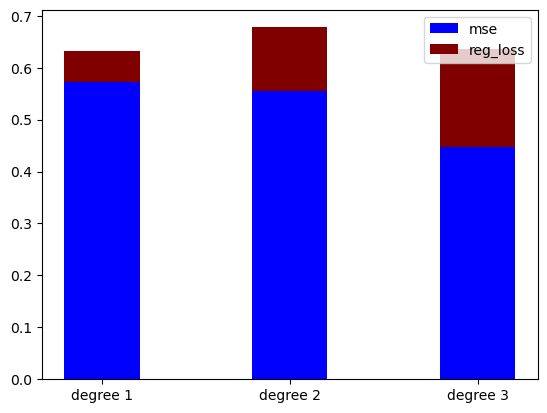

telegram.org


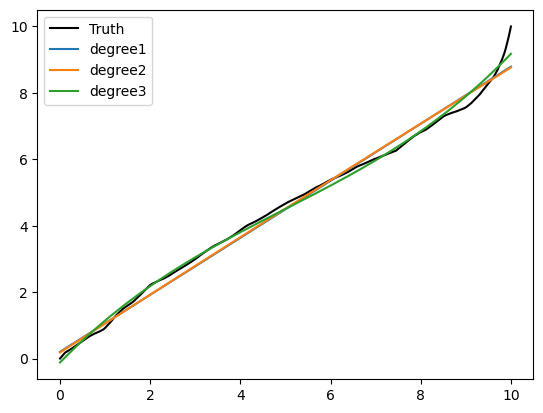

loss [0.021189496291942122, 0.042189495712326656, 0.06859210848584267]
mse [0.07273690241142855, 0.07256363354405869, 0.028822033650314036]


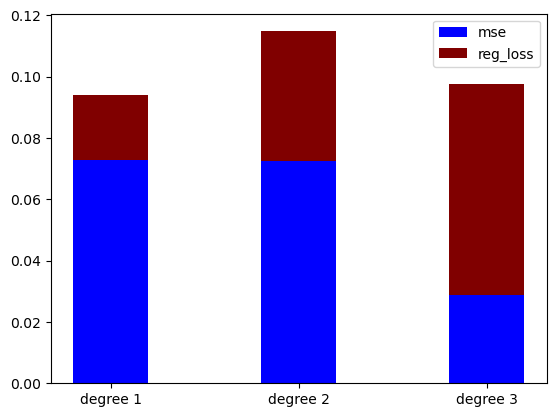

thefreedictionary.com


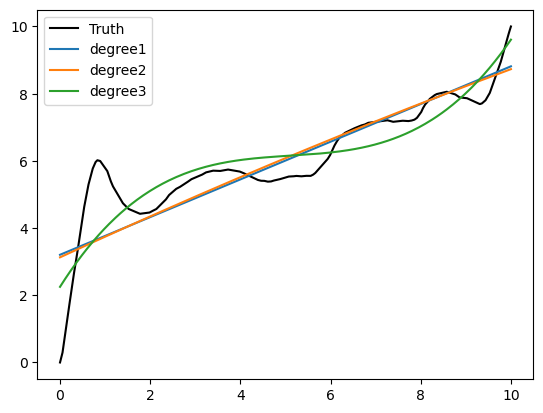

loss [0.07532552481027809, 0.14975374271246003, 0.24002463476059402]
mse [1.0959407658777804, 1.0931657750155046, 0.7974083902124299]


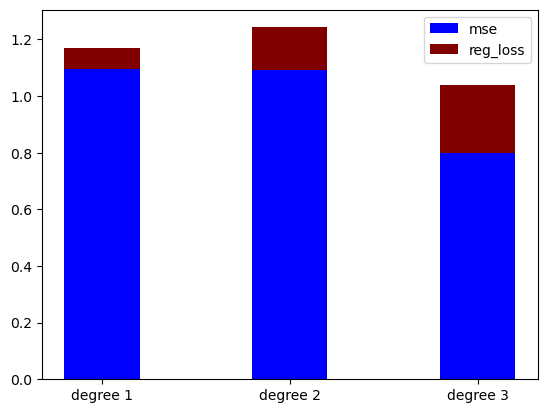

theguardian.com


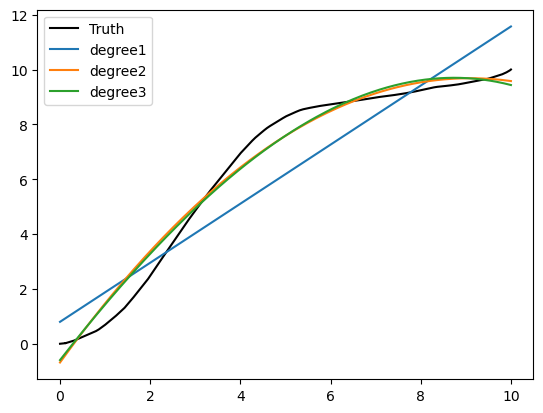

loss [0.037524641602764065, 0.05887601699079619, 0.08585640649360148]
mse [1.3750658096837043, 0.20037905637061074, 0.1953152940382495]


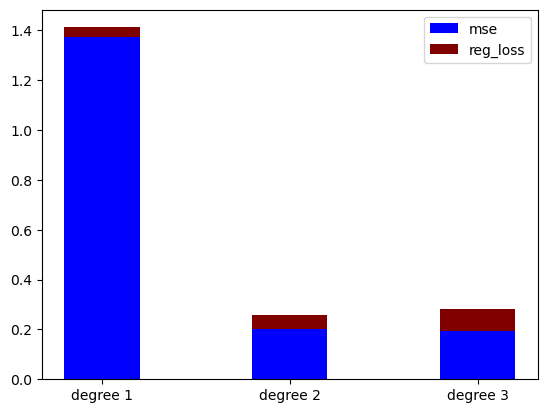

thepiratebay.org


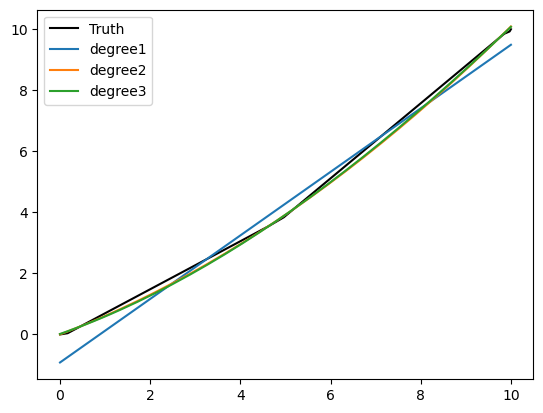

loss [0.0024542367194682747, 0.02423181999712969, 0.03543369395666305]
mse [0.2218124880254605, 0.006917935547710087, 0.006798730878408783]


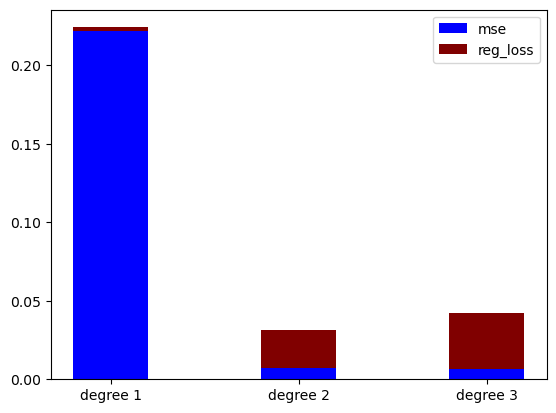

thesaurus.com


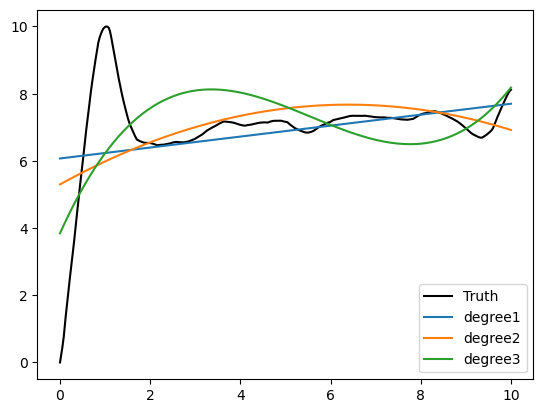

loss [0.12469299641605983, 0.23934405172669151, 0.3736776858828843]
mse [3.1157876275412755, 2.871241827225885, 2.254176967108628]


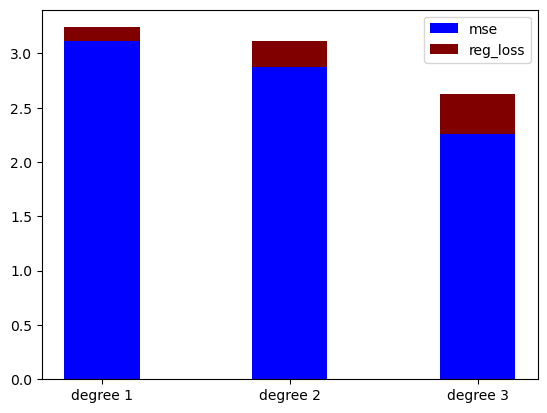

tmall.com


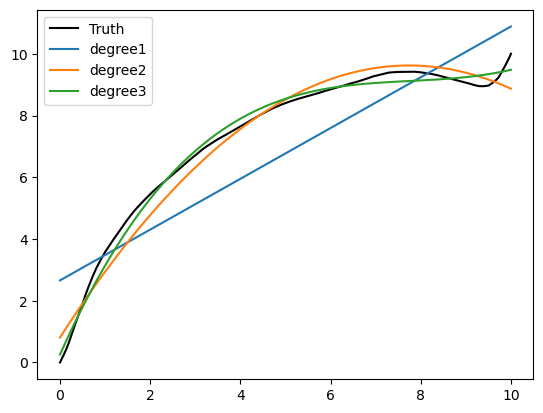

loss [0.06963508154648146, 0.1175863915995911, 0.1883613044507624]
mse [1.880779611488443, 0.1980994967246348, 0.056771251255401986]


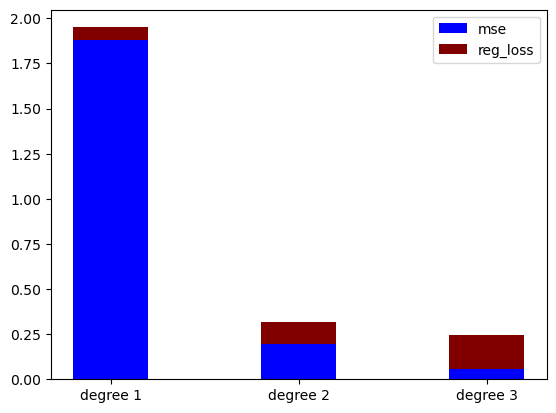

tribunnews.com


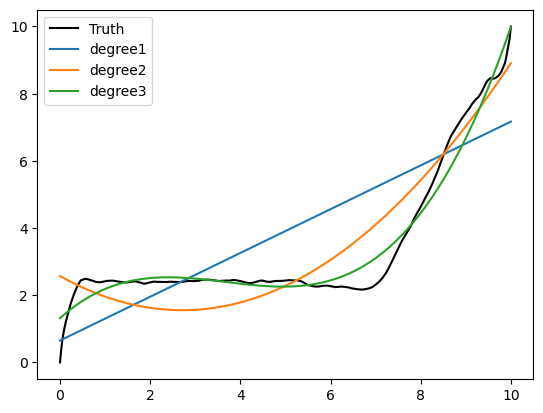

loss [0.02610147324368142, 0.0784066519802906, 0.13126881836422233]
mse [2.1302922798010586, 0.6984199804197827, 0.16957326543894674]


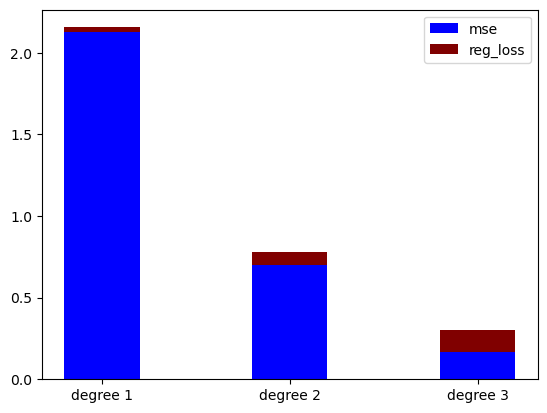

tube8.com


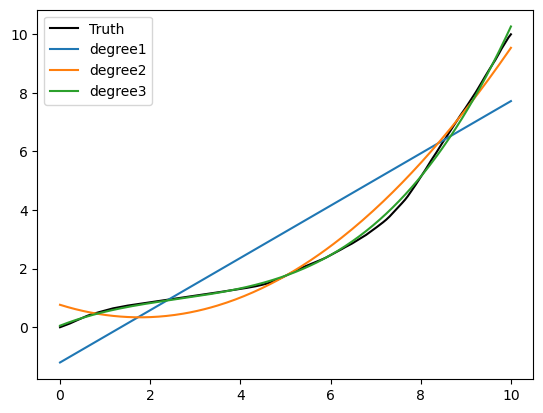

loss [-0.006215889077987653, 0.0167990950879392, 0.03174342493558152]
mse [1.445510386571052, 0.16360459328834287, 0.009588834067986782]


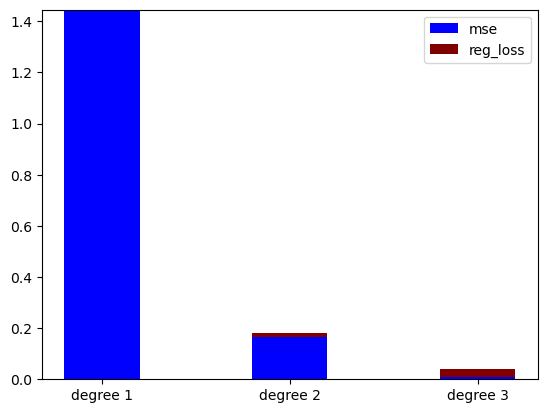

turkiye.gov.tr


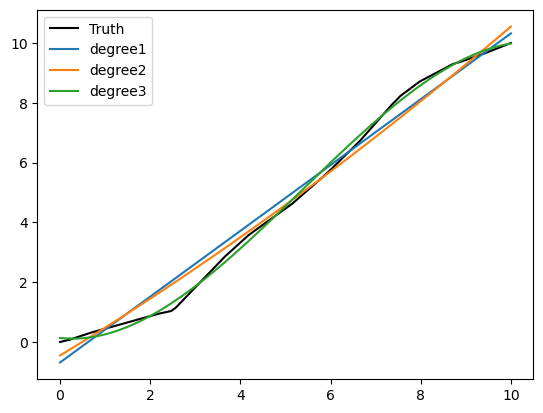

loss [0.00831431787089289, 0.019223157923984484, 0.015323708708325952]
mse [0.23358355180133536, 0.20626761426302356, 0.01344438336330133]


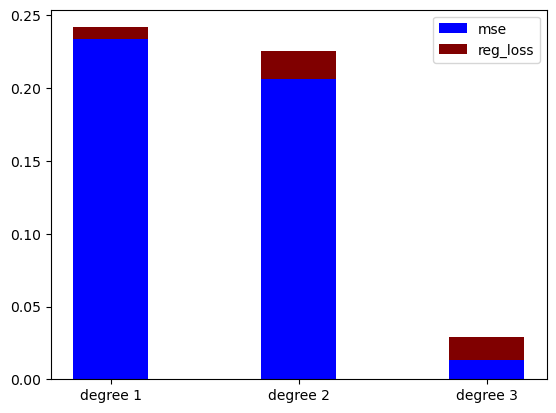

tutorialspoint.com


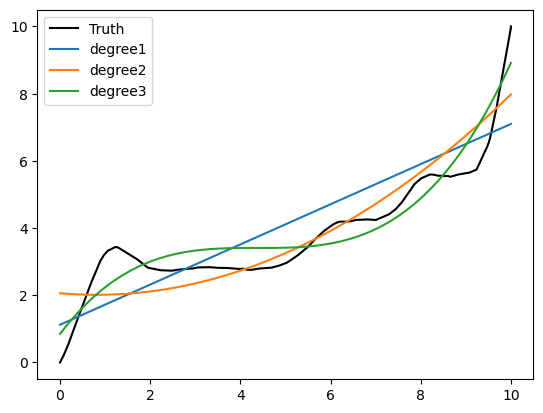

loss [0.034417150803492794, 0.08065116505286535, 0.1342152175367779]
mse [1.1689377923972146, 0.8127432542991685, 0.37873582961681723]


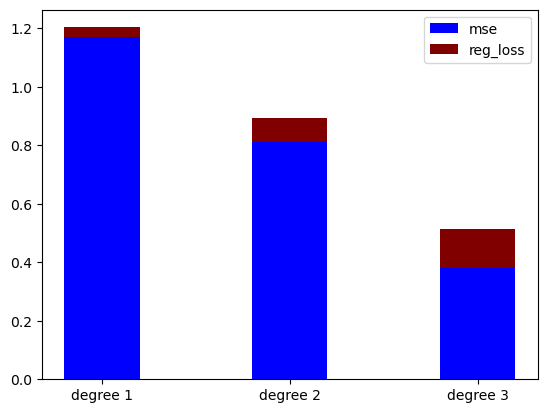

twitch.tv


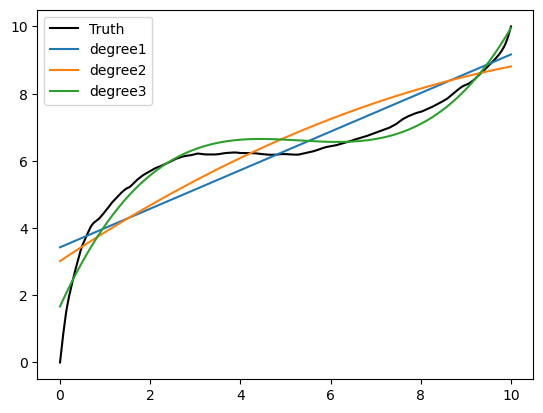

loss [0.08004624373955771, 0.1551938951416664, 0.24497548362810254]
mse [0.7831176228591973, 0.7172637965164886, 0.1456166465199764]


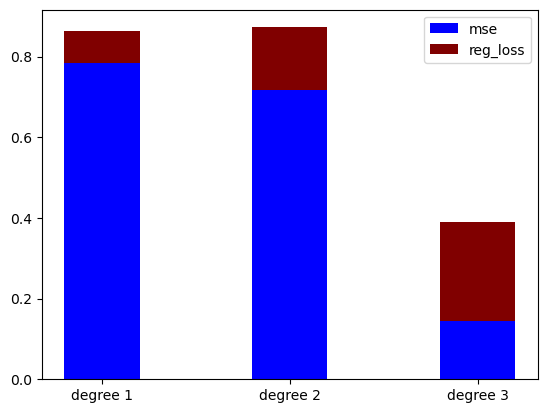

twitter.com


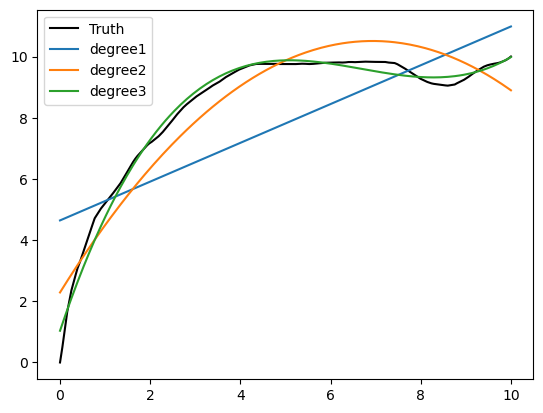

loss [0.10554633055645164, 0.17957708280447512, 0.28486294615738944]
mse [2.8413154586297034, 0.6576039110938919, 0.07913772267713129]


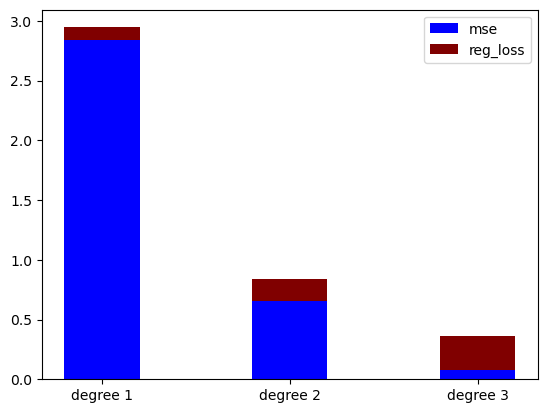

udn.com


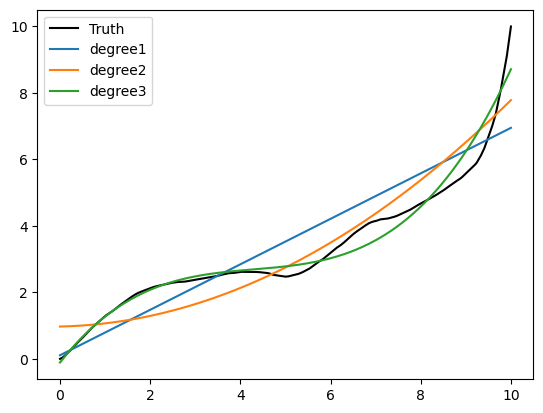

loss [0.015854319749917366, 0.042707407364238135, 0.07638231211497036]
mse [0.8281398657244076, 0.5173511419550676, 0.1433193102521286]


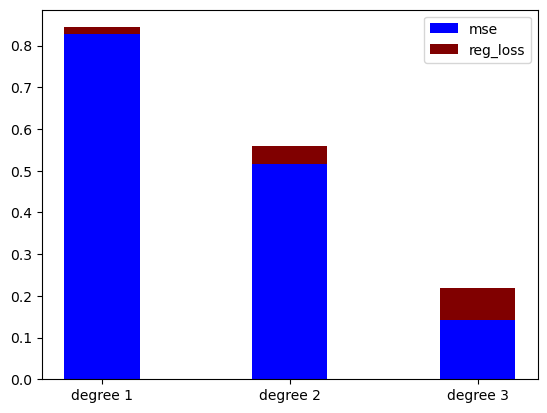

uniqlo.tmall.com


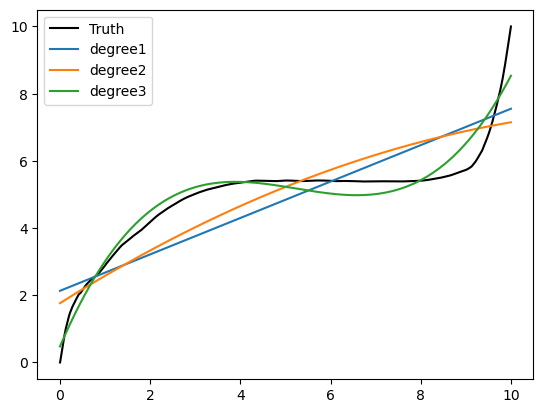

loss [0.053503231780450806, 0.10323245898037112, 0.18085445242392265]
mse [0.9975619859742775, 0.9272714456348156, 0.1985924874739323]


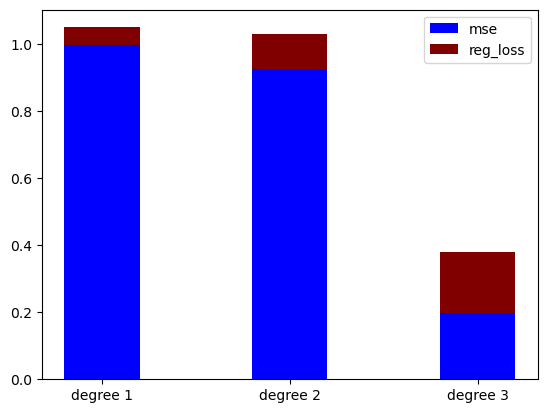

unsplash.com


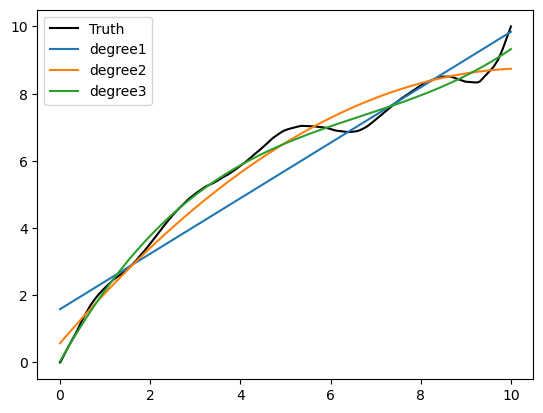

loss [0.04822646831852885, 0.08264646406968992, 0.12892053109891383]
mse [0.5271977680658342, 0.13596004108028933, 0.04818084643072084]


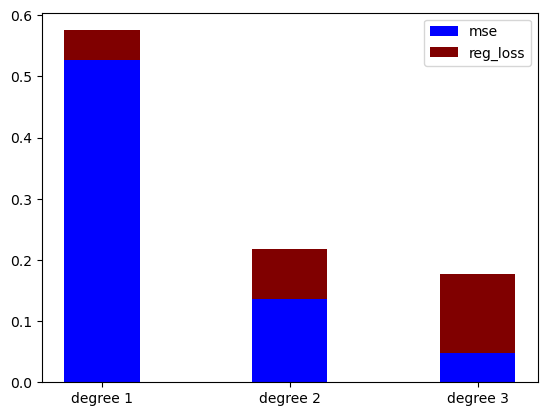

upornia.com


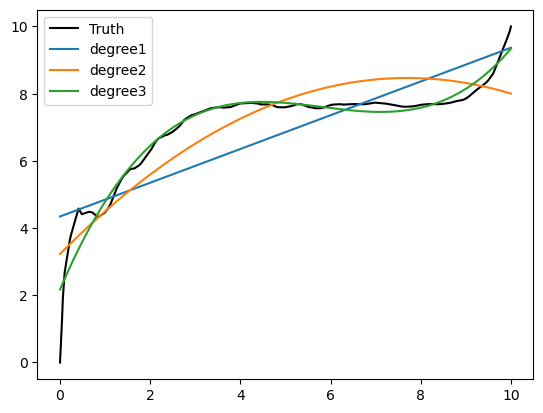

loss [0.09694538298000772, 0.1799646554140895, 0.28715078999996196]
mse [1.2313409494231444, 0.6537024067722568, 0.18440379596571824]


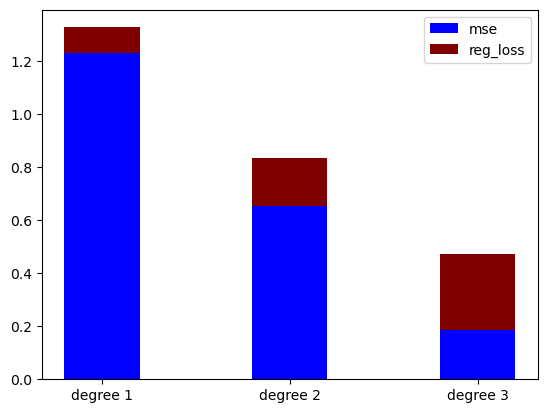

urbandictionary.com


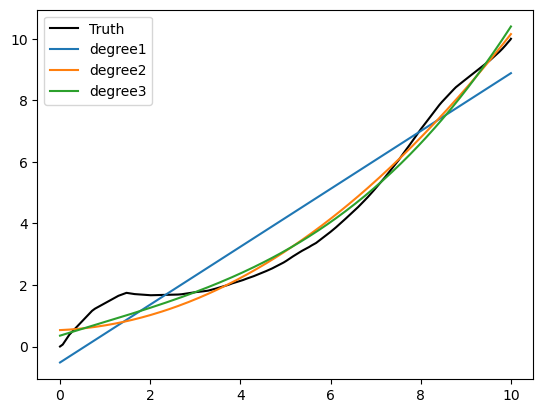

loss [0.008421761408733882, 0.027475222007092893, 0.04799856596404977]
mse [0.8099970805630464, 0.14392942764634156, 0.1195851745760588]


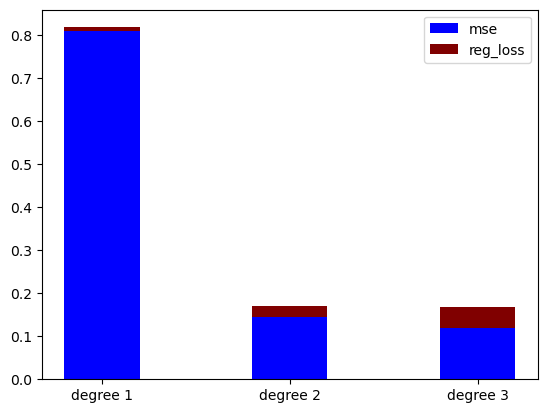

userapi.com


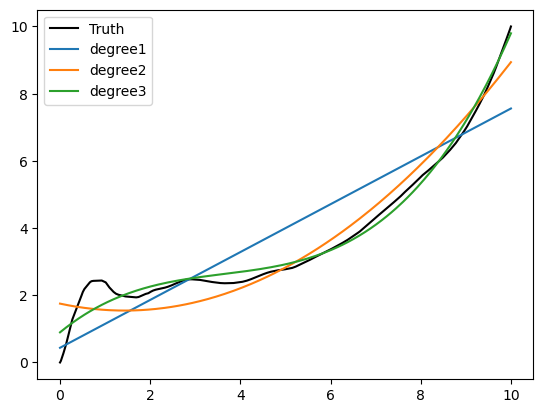

loss [0.022992452926572465, 0.06255629179907586, 0.10586725139667484]
mse [1.067718688382293, 0.35197400859532635, 0.09913827932449783]


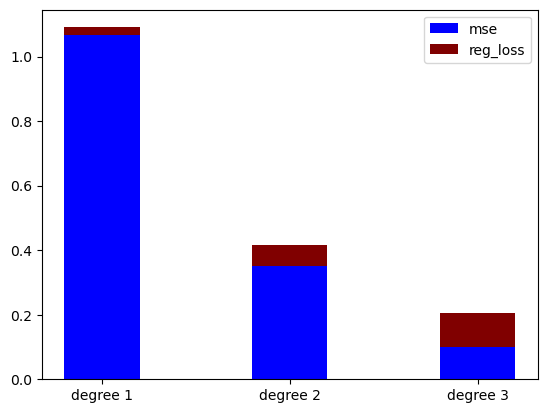

vice.com


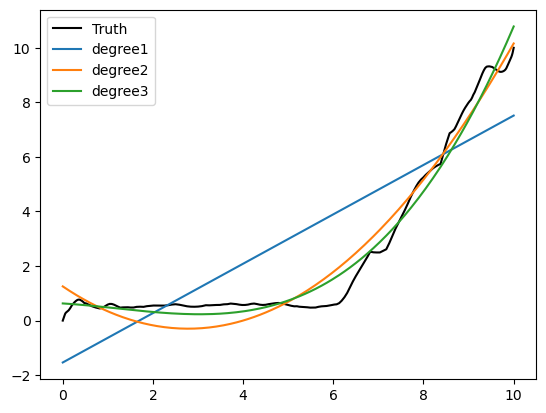

loss [-0.012590070471593391, 0.013589705744949044, 0.029008743156364918]
mse [3.2810530768464528, 0.3613189349283165, 0.23303632174979746]


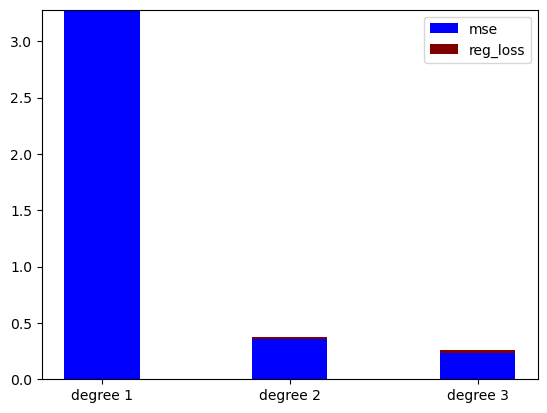

vidio.com


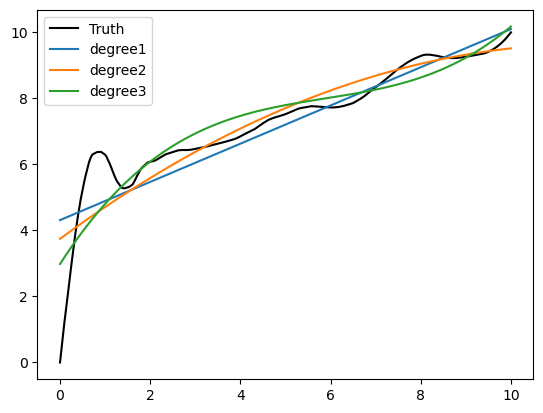

loss [0.0978192163524487, 0.18835545512742483, 0.28822503297286545]
mse [0.8417287039978607, 0.7205916977706096, 0.5763953537031776]


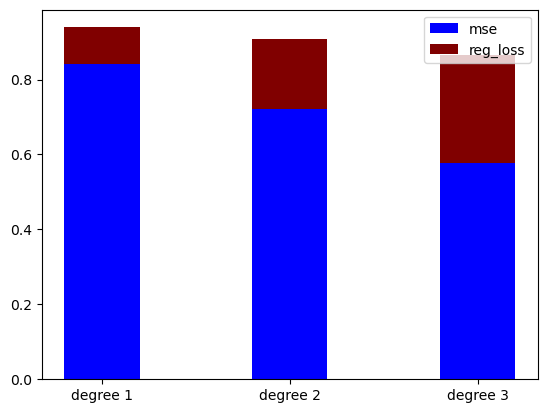

vk.com


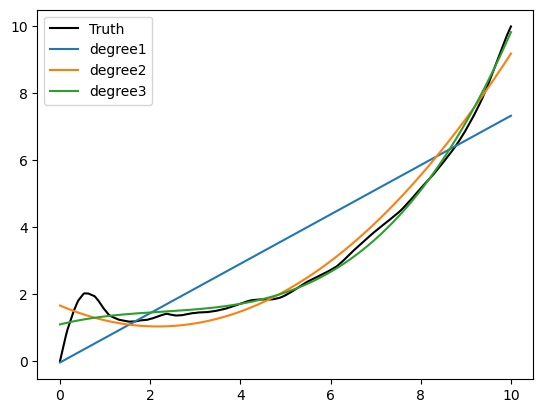

loss [0.013876801289678158, 0.04857926166268358, 0.0800796024278427]
mse [1.4609219703311913, 0.21446844908505064, 0.09004947647671172]


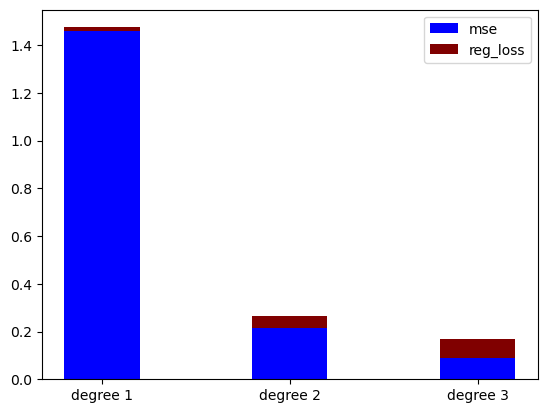

vnexpress.net


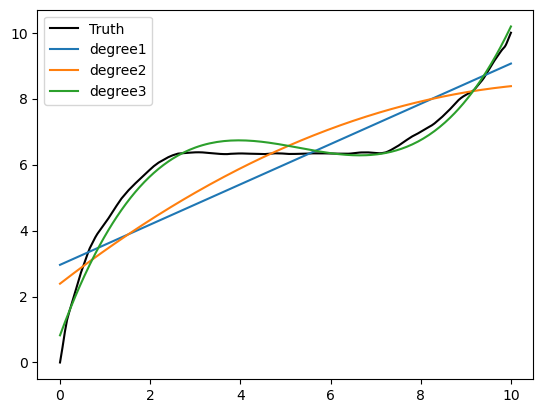

loss [0.07143029933436684, 0.13606183449102072, 0.23066833265163358]
mse [1.3011658109762707, 1.1466752386173025, 0.07573758324397144]


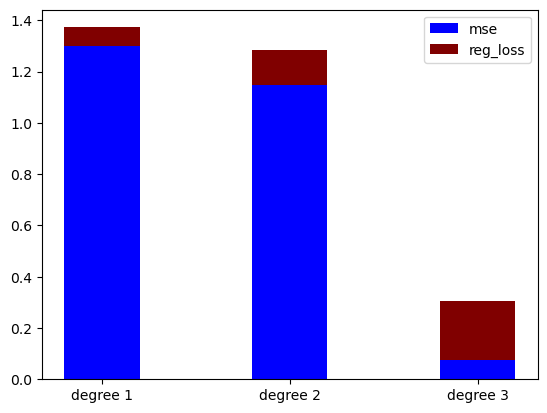

voot.com


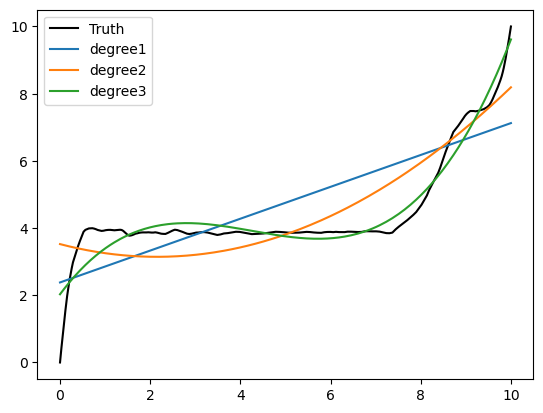

loss [0.057120773541917275, 0.13012017316636829, 0.2035763650244519]
mse [1.2896234772799215, 0.8512405873678893, 0.21902811858186594]


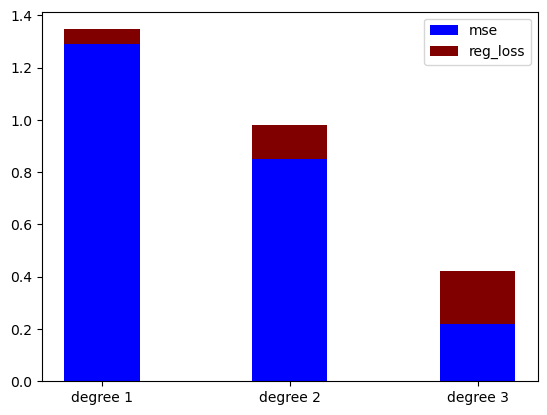

w3schools.com


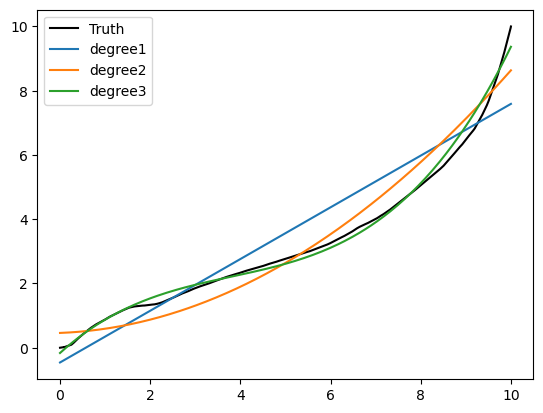

loss [0.006923115925388237, 0.023660272575909042, 0.052450019162863154]
mse [0.765685069883306, 0.28858621840391496, 0.04719897904286752]


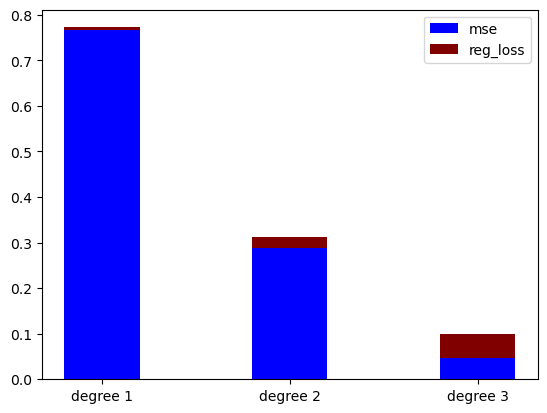

walmart.com


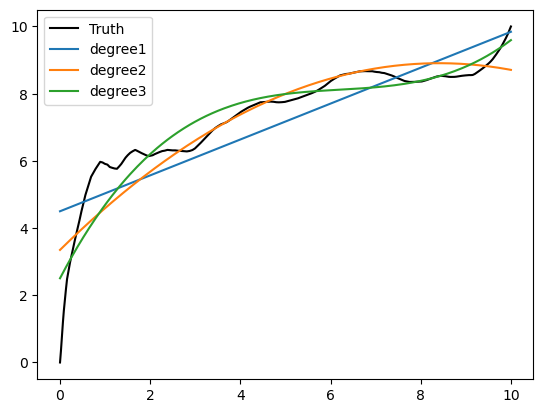

loss [0.10069072045110511, 0.18372107951693664, 0.2814496889944241]
mse [0.9975787531948757, 0.5762606383540991, 0.3656881955955171]


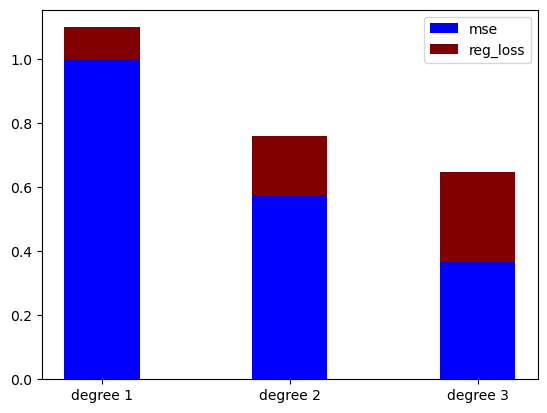

web.de


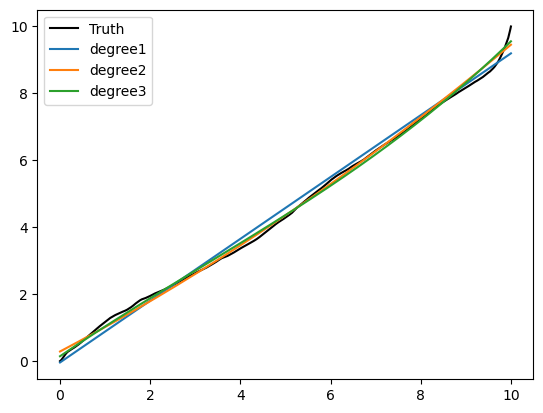

loss [0.017643634038226334, 0.04070880609047772, 0.0620468647651581]
mse [0.059248419327011276, 0.026459477362626792, 0.02090816946961322]


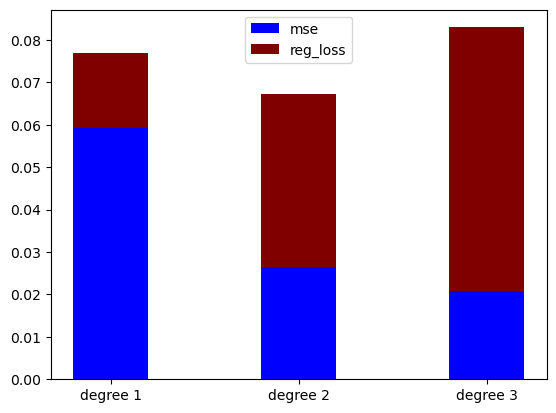

weblio.jp


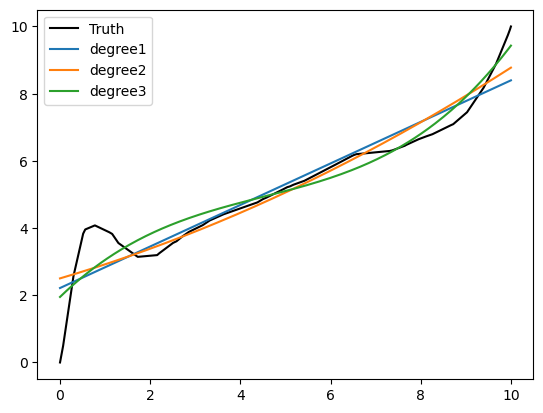

loss [0.056681060286490136, 0.11684797426163829, 0.18317765226029514]
mse [0.4832743536533624, 0.44579650398723325, 0.3343129248350976]


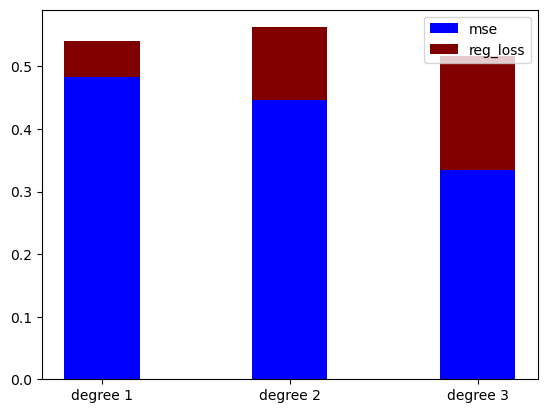

weebly.com


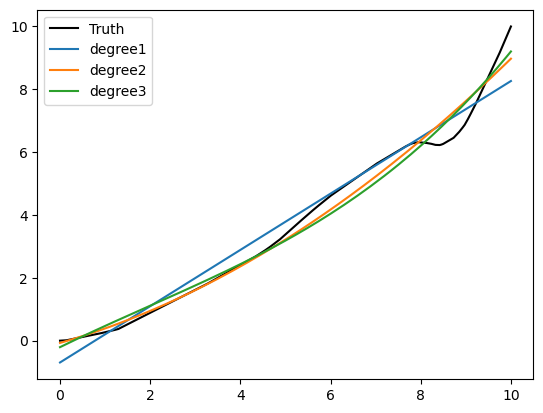

loss [0.004037753643164543, 0.015563657633986261, 0.02819688447871621]
mse [0.3226305572313184, 0.11922406624543408, 0.1076394060198599]


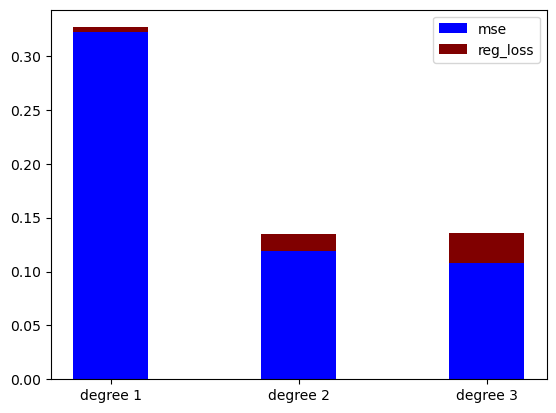

wikia.com


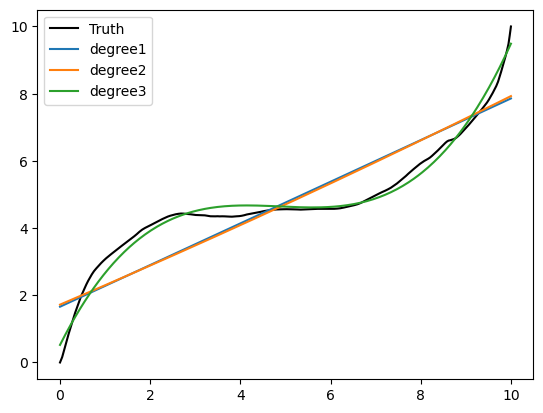

loss [0.04559260030827788, 0.09194262090647762, 0.15977807219298412]
mse [0.7590077532373131, 0.7573240827052397, 0.0628568250977325]


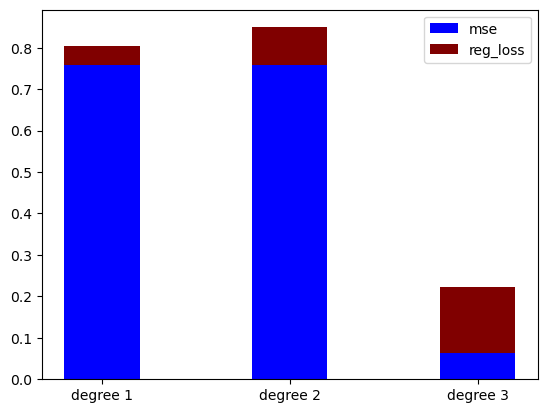

wikihow.com


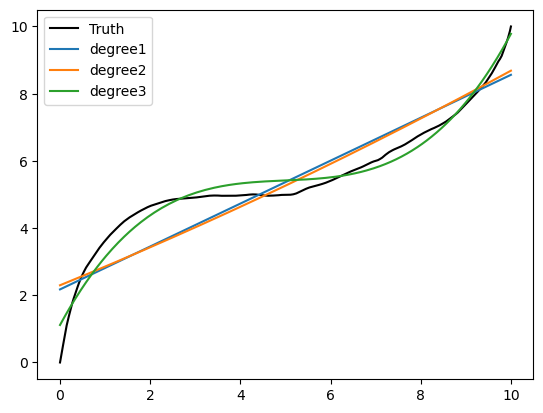

loss [0.05626883660334053, 0.11417571265488803, 0.18806555469874975]
mse [0.5902961976839678, 0.5841654405073998, 0.10800541049627409]


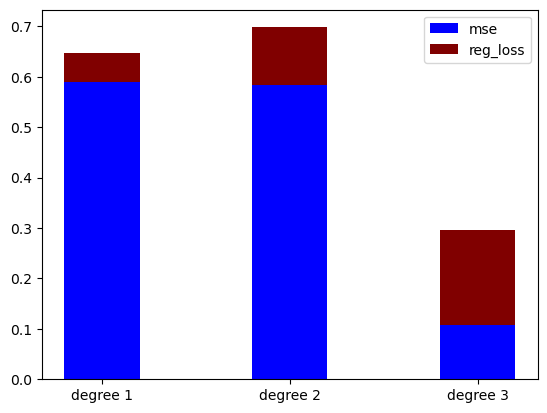

wix.com


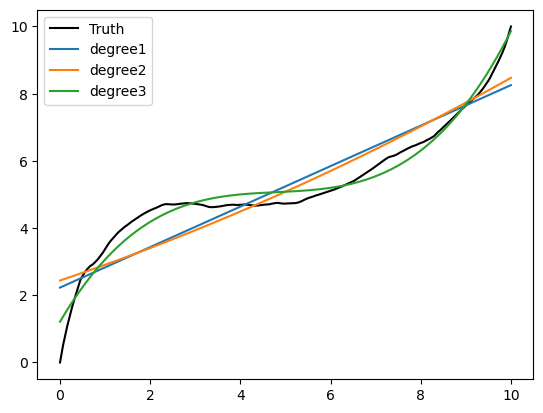

loss [0.05662713766077483, 0.11632650205881642, 0.1838766131274038]
mse [0.5387801067817947, 0.524223290559023, 0.09284956837765534]


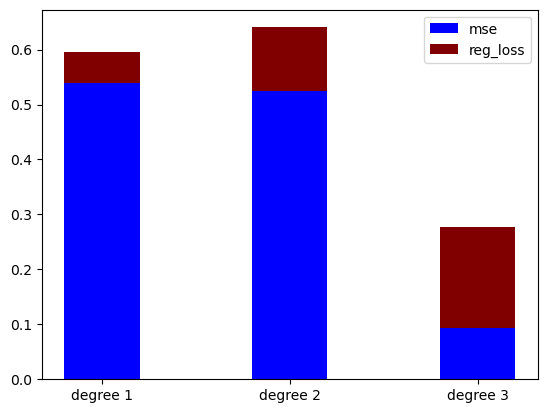

wixsite.com


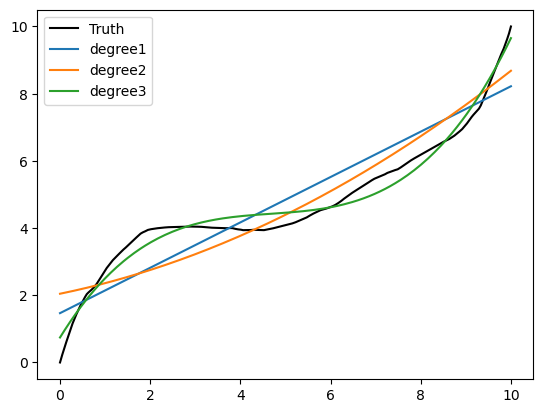

loss [0.04286865774072797, 0.09442403691711901, 0.15029529236393355]
mse [0.6054138898243747, 0.4974258464484483, 0.0887282647177657]


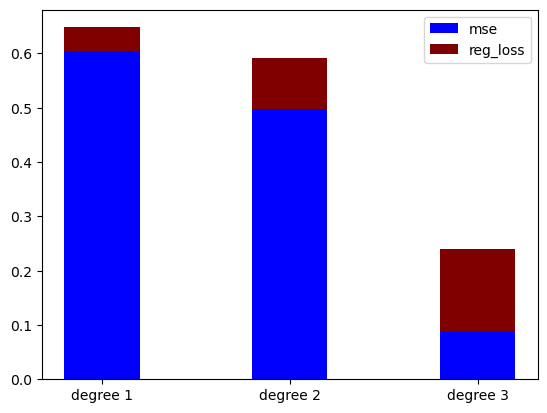

wordreference.com


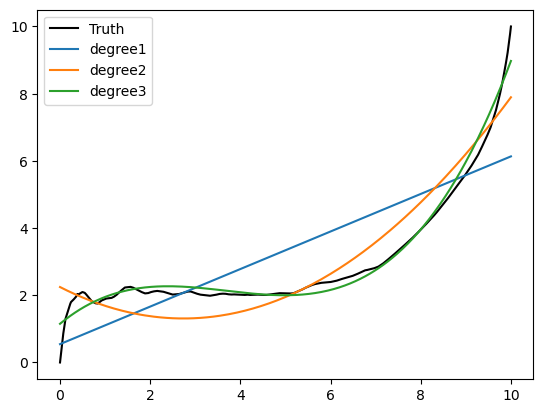

loss [0.02209819939286133, 0.06746368206067735, 0.11700197342670421]
mse [1.7286190533831098, 0.5395572724573966, 0.09362205469941964]


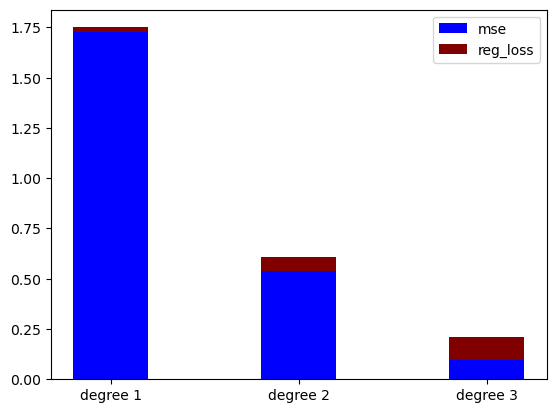

wp.pl


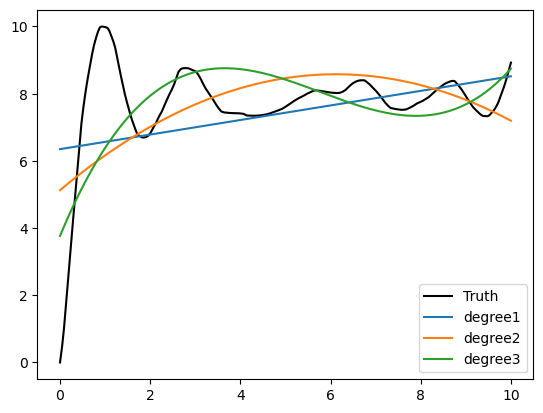

loss [0.131319847062172, 0.2465376768836411, 0.38323332665502363]
mse [3.259765023750216, 2.6897193521106892, 2.0486238468982787]


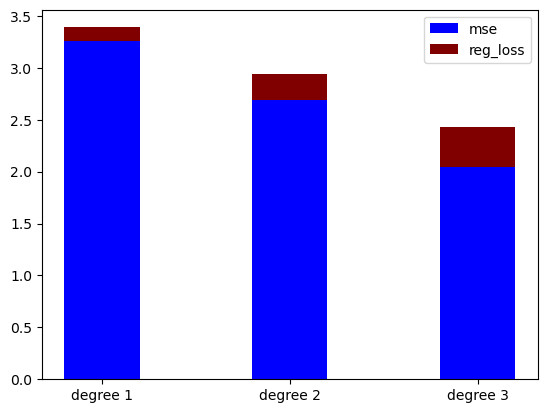

www.gov.uk


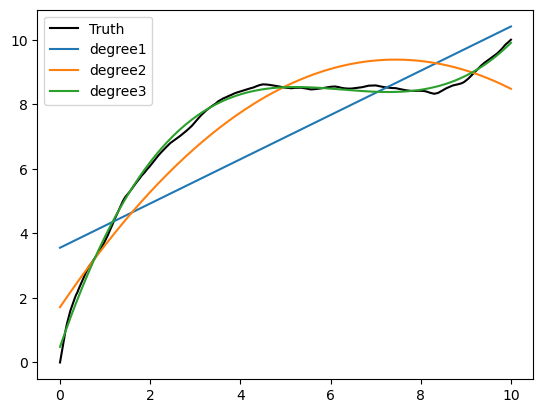

loss [0.08480365740551582, 0.1454484331949972, 0.2343881682857891]
mse [1.922088390998118, 0.5795125125291478, 0.01726177057400825]


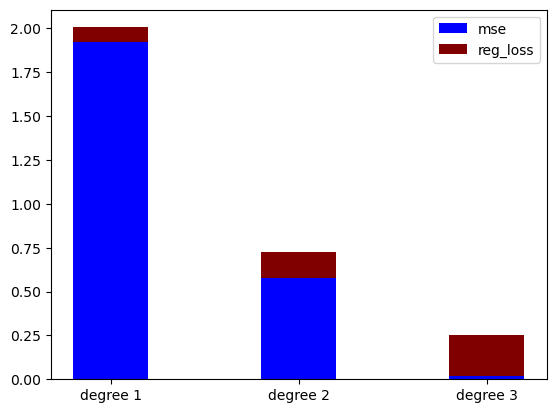

xfinity.com


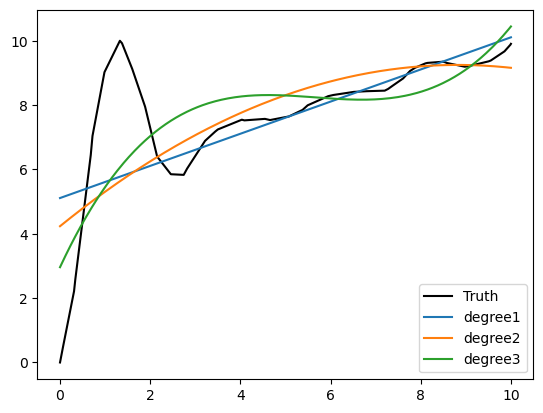

loss [0.11222086565349113, 0.21232980356329692, 0.32713868910246163]
mse [2.943402626440093, 2.6624127477188826, 2.1571830118305795]


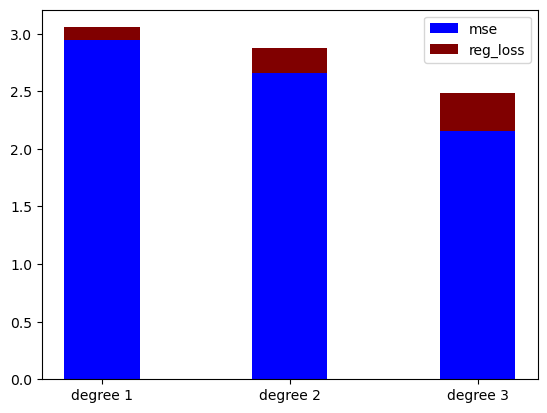

xinhuanet.com


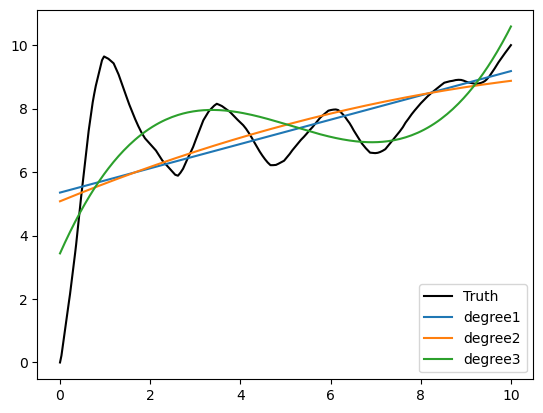

loss [0.11472458732992999, 0.2256416329733487, 0.3586744159692325]
mse [2.8529773982030706, 2.8224679914953263, 1.9169058265733032]


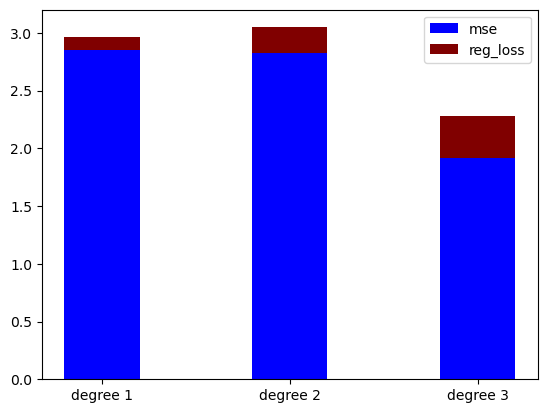

yahoo.co.jp


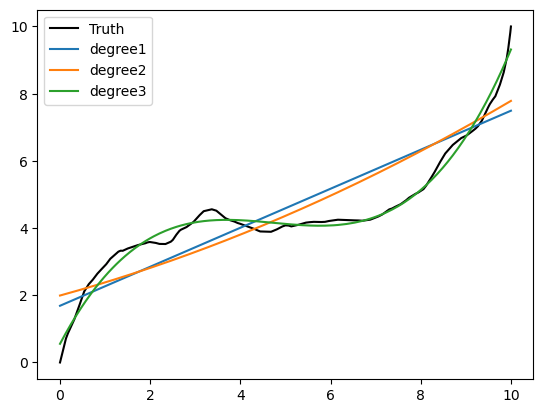

loss [0.04537076758122894, 0.0953178258200611, 0.15425220759342195]
mse [0.8212349069990795, 0.7896584656764738, 0.054836055170387955]


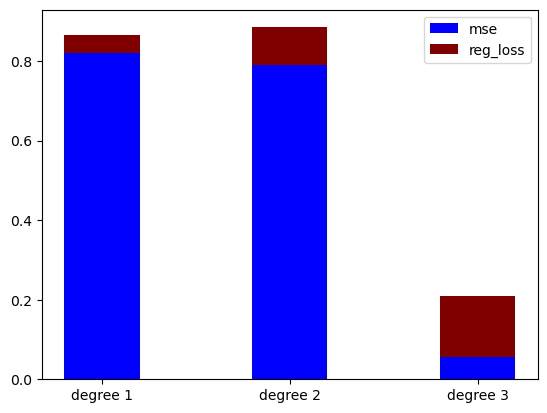

yahoo.com


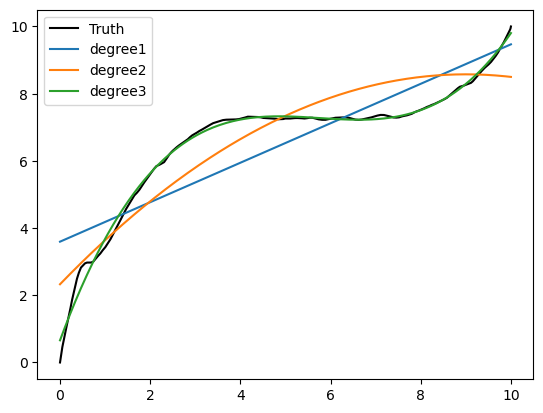

loss [0.08365423437262448, 0.14556995677160336, 0.2208655947718899]
mse [1.044090231253595, 0.636350023156118, 0.022255275891384166]


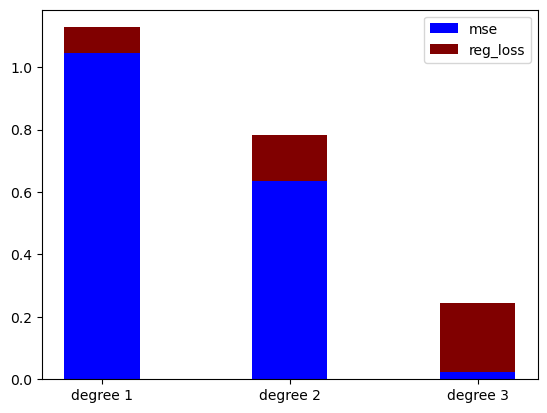

yandex.kz


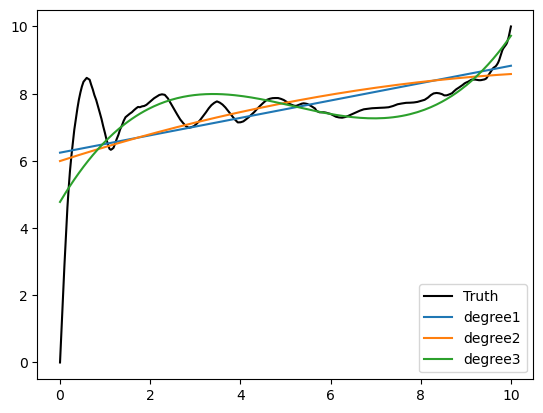

loss [0.13006174570411025, 0.2564766815120432, 0.39444736409255804]
mse [1.375904639403744, 1.3534659002856553, 0.9377180260680085]


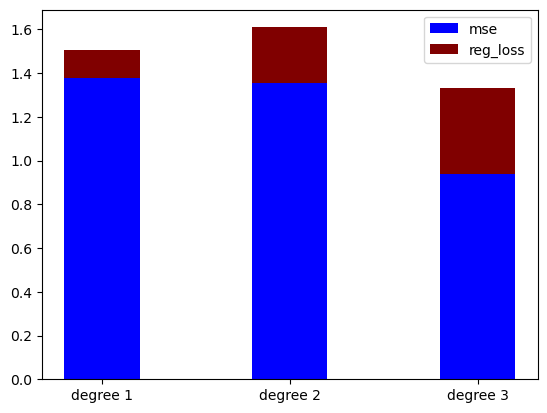

yao.tmall.com


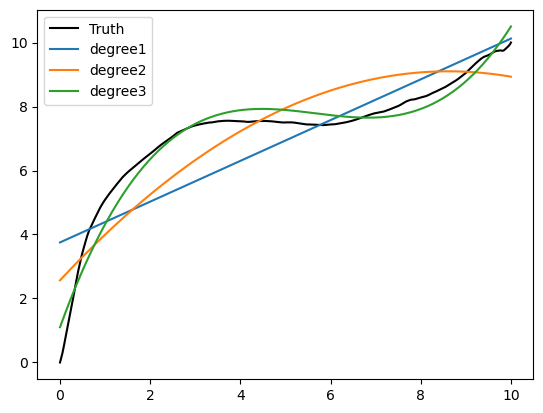

loss [0.0877918519994395, 0.15986125221849165, 0.25929524721294045]
mse [1.5737750228848248, 1.008525813583743, 0.17482188012529734]


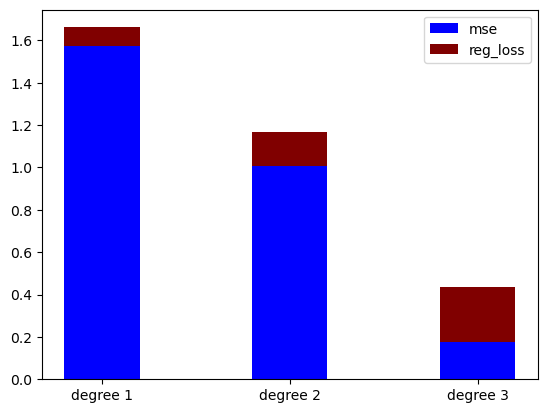

yelp.com


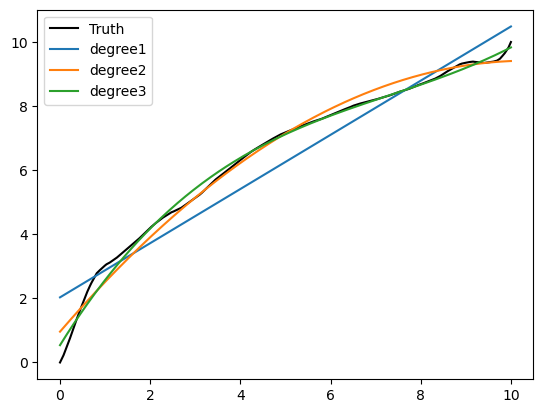

loss [0.05755353160146334, 0.1005408019514769, 0.15438164036023194]
mse [0.5332807517951828, 0.10265103572979471, 0.04534645132382274]


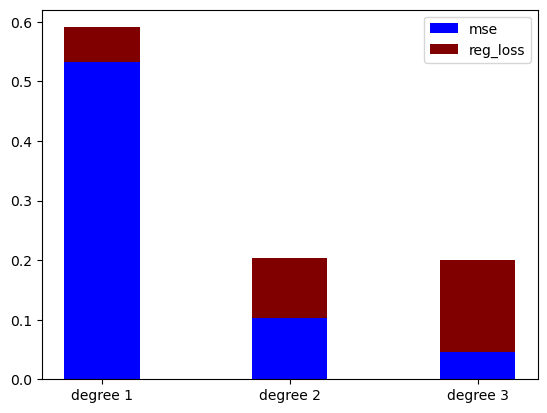

youtube.com


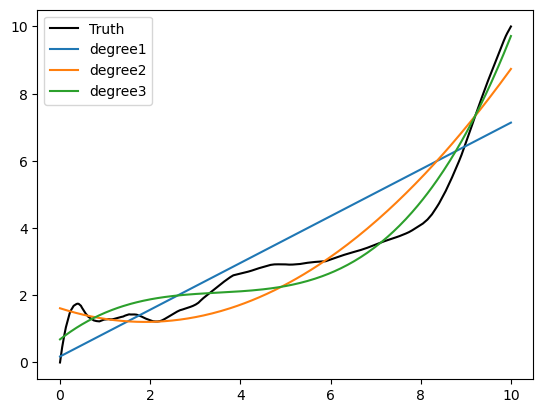

loss [0.017490550123863947, 0.05186816938788565, 0.08885305357201652]
mse [1.435389272436577, 0.5201546642500061, 0.20290692114340333]


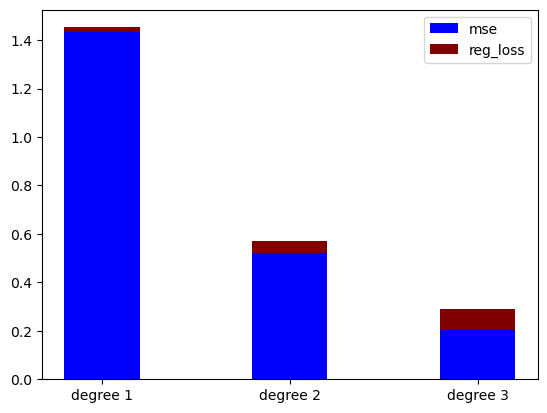

yy.com


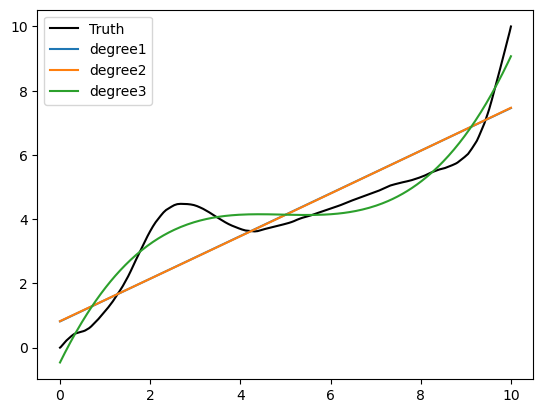

loss [0.029626441462315273, 0.05934175424951584, 0.11107801362847175]
mse [0.9046348963279429, 0.9046143641846741, 0.19595053854272448]


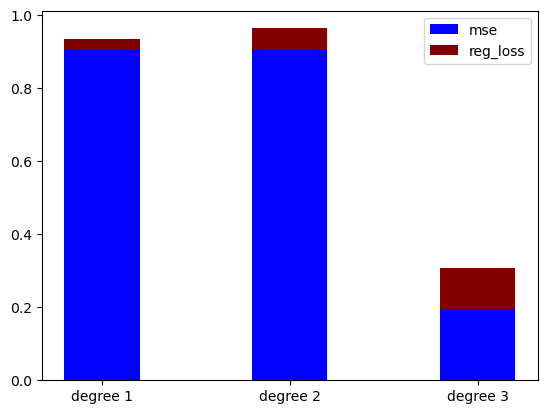

zendesk.com


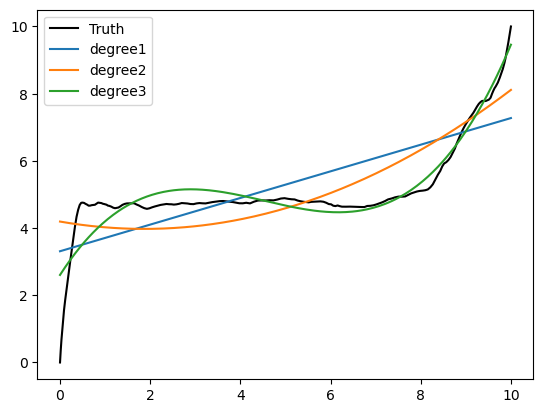

loss [0.07413846579937386, 0.16090778059906405, 0.25209032691034167]
mse [1.1911980553899852, 0.9171840496788167, 0.2610556859173743]


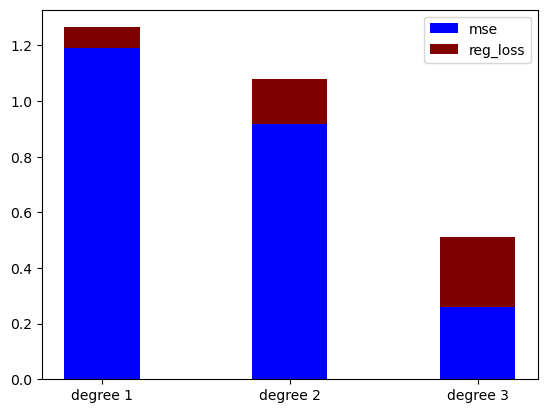

zillow.com


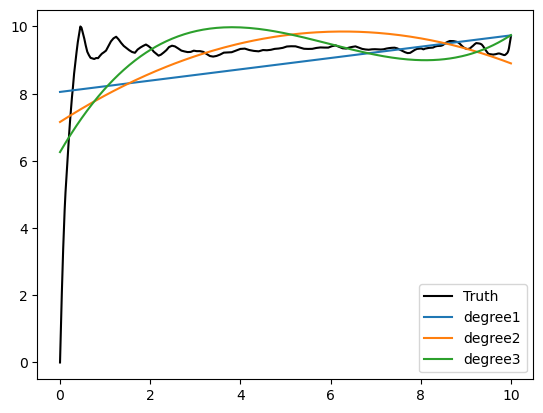

loss [0.1644086915806548, 0.3178965230994048, 0.48912540903405743]
mse [1.8873426596815905, 1.5616364581027706, 1.2713715491367472]


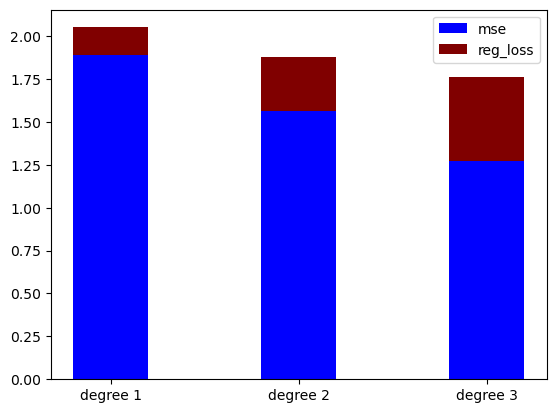

In [407]:
web_cc_mp, too_much_error = getBestDegree(web_mp)

In [408]:
print("The ones that have too much error", len(too_much_error.keys()))

The ones that have too much error 27


In [409]:
counts = [0,0,0]
for web in web_cc_mp:
    counts[web_cc_mp[web]['deg']-1]+=1
print("1,2,3")
print(counts)

1,2,3
[13, 19, 162]


In [357]:
web_cc_mp

{'3c.tmall.com': {'deg': 3,
  'coeff': [0.03286082633634334,
   -0.5409930137565644,
   2.873355002377852,
   0.5081493840995913],
  'error': 0.5293645367434671},
 '3dmgame.com': {'deg': 3,
  'coeff': [0.04169681383545647,
   -0.5480205200857299,
   2.2704806436387597,
   0.8745270155478249],
  'error': 0.4982994280195908},
 'activetect.net': {'deg': 3,
  'coeff': [0.03471173213473108,
   -0.45177020895559333,
   1.8323717747458486,
   3.183458705366594],
  'error': 0.9543016150928803},
 'aimer.tmall.com': {'deg': 3,
  'coeff': [0.04370704166734615,
   -0.7060263300342675,
   3.583796055855667,
   1.4504780838479603],
  'error': 0.7370917054489454},
 'aliyun.com': {'deg': 3,
  'coeff': [0.02094688277531914,
   -0.22400593021480505,
   1.1609657614095323,
   -0.681820116060183],
  'error': 0.08380048249887903},
 'ameblo.jp': {'deg': 3,
  'coeff': [0.025040761507335425,
   -0.5344616014818149,
   3.7128338817312097,
   0.6680482363867941],
  'error': 0.5337081648907377},
 'android.com': 

In [359]:
import pickle
with open('vals_cubicQ_new.txt', 'rb') as f:
    vals_cubicQ = pickle.load(f)

In [360]:
vals_cubicQ.pop('vegas')

{1: [array([ 0.02505765, -0.46138329,  2.53237461]),
  array([ 0.03185394, -0.54928383,  2.75128854]),
  array([ 0.02475685, -0.44602818,  2.34049464]),
  array([ 0.02844166, -0.50881397,  2.61282569]),
  array([ 0.02755241, -0.42390002,  1.84129994]),
  array([ 0.02916567, -0.5052842 ,  2.53101974]),
  array([ 0.03287782, -0.55009534,  2.64319402]),
  array([ 0.01939292, -0.37190103,  2.04760771]),
  array([ 0.02943892, -0.5067403 ,  2.54313324]),
  array([ 0.03526777, -0.60188843,  2.97972555]),
  array([ 0.03234282, -0.57203819,  2.96473487]),
  array([ 0.03006904, -0.51849016,  2.61229756]),
  array([ 0.02662128, -0.45749356,  2.27964278]),
  array([ 0.03088309, -0.52022828,  2.50501101]),
  array([ 0.04066227, -0.68247994,  3.25699729]),
  array([ 0.02776718, -0.50557339,  2.65709942]),
  array([ 0.04317139, -0.73839182,  3.60324689]),
  array([ 0.02377635, -0.43079801,  2.2593502 ]),
  array([ 0.03723095, -0.6369106 ,  3.10005794]),
  array([ 0.02806726, -0.48079716,  2.41220204]

In [361]:
vals_cubicQ.pop('nv')

{1: [array([ 0.0591397 , -0.65498091,  0.92915213]),
  array([-0.00432868,  0.10055585,  0.36447126]),
  array([-0.00472131,  0.10617744,  0.35252546]),
  array([-0.01426867,  0.25631285, -0.21150565]),
  array([-0.00709259,  0.14662029,  0.19948404]),
  array([-0.0114205 ,  0.21699053, -0.09286304]),
  array([-0.00548447,  0.11782863,  0.33513465]),
  array([-0.00707632,  0.14445051,  0.20868102]),
  array([-0.01234915,  0.231385  , -0.15478278]),
  array([ 0.04311369, -0.60071644,  2.70385581]),
  array([-0.00843546,  0.16130104,  0.1560726 ]),
  array([ 0.03529344, -0.41173938,  1.04028161]),
  array([-0.00822246,  0.15632655,  0.19447696]),
  array([-0.00736637,  0.14895094,  0.19558922]),
  array([ 0.03045992, -0.32104422,  0.64045346]),
  array([ 0.03903641, -0.38765092,  0.9128883 ]),
  array([ 0.05377929, -0.85797699,  4.23738321]),
  array([-0.00994553,  0.193272  ,  0.00652856]),
  array([-0.00937813,  0.17357211,  0.14550216]),
  array([ 0.05525284, -0.87841779,  4.26835497]

In [299]:
# Not using vegas and nv

In [611]:
cc_degree = {'bic': 1,
 'dctcp': 2,
 'highspeed': 2,
 'htcp': 3,
 'lp': 2,
 'scalable': 1,
 'veno': 3,
 'westwood': 2,
 'yeah': 1,
 'cubic': 3,
 'reno': 2,
'cubicQ':3}

In [621]:
# Saving the cc_gaussian_params:
import pickle
with open("../analysis/final/cc_degree.txt",'wb') as f:
    pickle.dump(cc_degree,f)

# Detecting Outliers through distance measures

### Scaling the coeff for correct analysis according to degree and calculating mean 

In [363]:
from sklearn.preprocessing import StandardScaler

In [410]:
degrees = [1,2,3]

In [65]:
# mm_scaled_vals = {}
# for cc in vals_cubicQ:
#     if cc == 'nv' :
#         continue
#     if cc_degree[cc] not in mm_scaled_vals:
#         mm_scaled_vals[cc_degree[cc]] = {}
#     mm_scaled_vals[cc_degree[cc]][cc] = vals_cubicQ[cc][1]

# for d in mm_scaled_vals:
#     temp_data = []
#     for cc in mm_scaled_vals[d]:
#         temp_data+=mm_scaled_vals[d][cc]
#     temp_data = np.array(temp_data)
#     min_data = np.min(temp_data)
#     max_data = np.max(temp_data)
#     for cc in mm_scaled_vals[d]:
#         mm_scaled_vals[d][cc] = (mm_scaled_vals[d][cc]-min_data)/(max_data-min_data)
#     mm_scaled_vals[d]['max_data'] = max_data 
#     mm_scaled_vals[d]['min_data'] = min_data

In [411]:
scaled_vals = {}
for cc in vals_cubicQ:
    if cc_degree[cc] not in scaled_vals:
        scaled_vals[cc_degree[cc]] = {}
    scaled_vals[cc_degree[cc]][cc] = vals_cubicQ[cc][1]

for d in scaled_vals:
    temp_data = []
    for cc in scaled_vals[d]:
        temp_data += scaled_vals[d][cc]
    scaler = StandardScaler().fit(temp_data)
    for cc in scaled_vals[d]:
        scaled_vals[d][cc] = np.array(scaler.transform(scaled_vals[d][cc]))
        if cc == 'scalable':
            for i in range(len(scaled_vals[d][cc])):
                if scaled_vals[d][cc][i] > 10 :
                    scaled_vals[d][cc][i] = scaled_vals[d][cc][i-1]
                    
    scaled_vals[d]['scaler'] = scaler

In [609]:
# Saving the cc_gaussian_params:
import pickle
with open("../analysis/final/vals.txt",'wb') as f:
    pickle.dump(vals_cubicQ,f)

In [618]:
# Saving the cc_gaussian_params:
import pickle
with open("../analysis/final/scaled_vals.txt",'wb') as f:
    pickle.dump(scaled_vals,f)

### Plotting all the ccs with the websites

In [412]:
def get_website_by_degree(d):
    labels = []
    result = []
    for web in web_cc_mp:
        if web_cc_mp[web]['deg'] == d:
            labels.append(web)
            result.append(web_cc_mp[web]['coeff'][0:d])
    return {'labels' : labels, 'data' : result}

In [413]:
web_data = {}
scaled_web_data = {}

In [614]:
degree = 2
scaled_vals[degree]['combined'] = []
for cc in ['dctcp','highspeed','lp','reno']:
    scaled_vals[degree]['combined'] += list(scaled_vals[degree][cc])
    scaled_vals[degree].pop(cc)
scaled_vals[degree]['combined'] = np.array(scaled_vals[degree]['combined'])

In [617]:
scaled_vals[2].keys()

dict_keys(['westwood', 'scaler', 'combined'])

In [414]:
# web_data = {}
# mm_scaled_web_data = {}

#### D = 1

In [369]:
# not_cc = ['max_data','min_data']

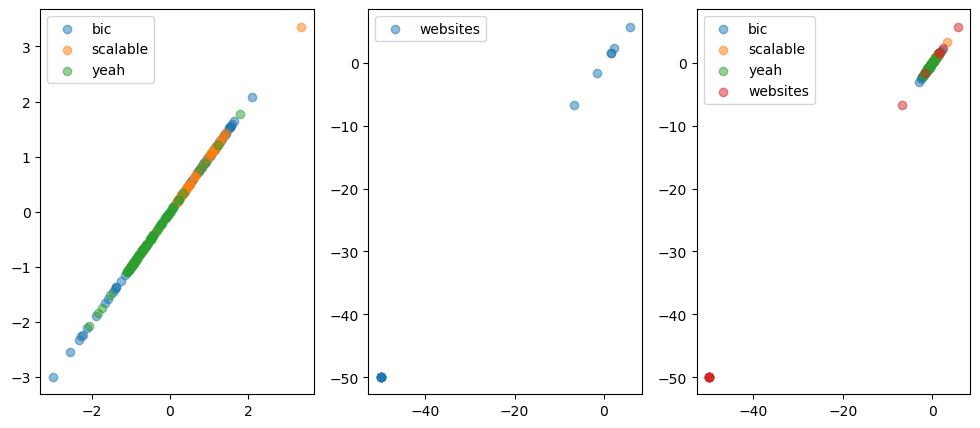

In [415]:
degree = 1
web_data[degree]  = get_website_by_degree(degree)
scaled_web_data[degree] = {'labels':web_data[degree]['labels'], 'data':np.array(scaled_vals[degree]['scaler'].transform(web_data[degree]['data']))}

fig, axs = plt.subplots(nrows=1,ncols=3,figsize=(12,5))
for cc in scaled_vals[degree]:
    if cc != 'scaler' :
        axs[0].scatter(scaled_vals[degree][cc][:,0],scaled_vals[degree][cc][:,0],label=cc,alpha=0.5)
axs[0].legend()

axs[1].scatter(scaled_web_data[degree]['data'][:,0], scaled_web_data[degree]['data'][:,0], label='websites',alpha=0.5)
axs[1].legend()

for cc in scaled_vals[degree]:
    if cc != 'scaler' :
        axs[2].scatter(scaled_vals[degree][cc][:,0],scaled_vals[degree][cc][:,0],label=cc,alpha=0.5)
axs[2].legend()

axs[2].scatter(scaled_web_data[degree]['data'][:,0], scaled_web_data[degree]['data'][:,0], label='websites',alpha=0.5)
axs[2].legend()


In [248]:
# degree = 1
# web_data[degree]  = get_website_by_degree(degree)
# mm_scaled_web_data[degree] = {'labels':web_data[degree]['labels'],
#                               'data':(web_data[degree]['data']-mm_scaled_vals[degree]['min_data'])/(mm_scaled_vals[degree]['max_data']-mm_scaled_vals[degree]['min_data'])}

# fig, axs = plt.subplots(nrows=1,ncols=3,figsize=(12,5))
# for cc in mm_scaled_vals[degree]:
#     if cc not in not_cc:
#         axs[0].scatter(mm_scaled_vals[degree][cc][:,0],mm_scaled_vals[degree][cc][:,0],label=cc,alpha=0.5)
# axs[0].legend()

# axs[1].scatter(mm_scaled_web_data[degree]['data'][:,0], mm_scaled_web_data[degree]['data'][:,0], label='websites',alpha=0.5)
# axs[1].legend()

# for cc in mm_scaled_vals[degree]:
#     if cc not in not_cc :
#         axs[2].scatter(mm_scaled_vals[degree][cc][:,0],mm_scaled_vals[degree][cc][:,0],label=cc,alpha=0.5)
# axs[2].legend()

# axs[2].scatter(mm_scaled_web_data[degree]['data'][:,0], mm_scaled_web_data[degree]['data'][:,0], label='websites',alpha=0.5)
# axs[2].legend()


In [89]:
# degree = 2
# mm_scaled_vals[degree]['combined'] = []
# for cc in ['dctcp','highspeed','lp','reno']:
#     mm_scaled_vals[degree]['combined'] += list(mm_scaled_vals[degree][cc])
# mm_scaled_vals[degree]['combined'] = np.array(mm_scaled_vals[degree]['combined'])

In [416]:
degree = 2
scaled_vals[degree]['combined'] = []
for cc in ['dctcp','highspeed','lp','reno']:
    scaled_vals[degree]['combined'] += list(scaled_vals[degree][cc])
scaled_vals[degree]['combined'] = np.array(scaled_vals[degree]['combined'])

In [374]:
# degree = 2
# web_data[degree]  = get_website_by_degree(degree)
# mm_scaled_web_data[degree] = {'labels':web_data[degree]['labels'],
#                               'data':(web_data[degree]['data']-mm_scaled_vals[degree]['min_data'])/(mm_scaled_vals[degree]['max_data']-mm_scaled_vals[degree]['min_data'])}

# fig, axs = plt.subplots(nrows=1,ncols=3,figsize=(12,5))
# for cc in mm_scaled_vals[degree]:
#     if cc not in not_cc:
#         axs[0].scatter(mm_scaled_vals[degree][cc][:,0],mm_scaled_vals[degree][cc][:,1],label=cc,alpha=0.5)
# axs[0].legend()

# axs[1].scatter(mm_scaled_web_data[degree]['data'][:,0], mm_scaled_web_data[degree]['data'][:,1], label='websites',alpha=0.5)
# axs[1].legend()

# for cc in mm_scaled_vals[degree]:
#     if cc not in not_cc :
#         axs[2].scatter(mm_scaled_vals[degree][cc][:,0],mm_scaled_vals[degree][cc][:,1],label=cc,alpha=0.5)
# axs[2].legend()

# axs[2].scatter(mm_scaled_web_data[degree]['data'][:,0], mm_scaled_web_data[degree]['data'][:,1], label='websites',alpha=0.5)
# axs[2].legend()


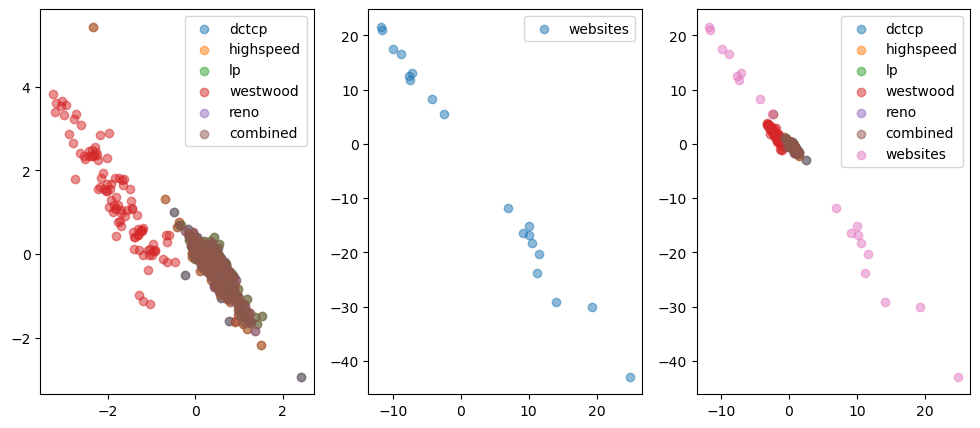

In [417]:
degree = 2
web_data[degree]  = get_website_by_degree(degree)
scaled_web_data[degree] = {'labels':web_data[degree]['labels'], 'data':np.array(scaled_vals[degree]['scaler'].transform(web_data[degree]['data']))}

fig, axs = plt.subplots(nrows=1,ncols=3,figsize=(12,5))
for cc in scaled_vals[degree]:
    if cc != 'scaler' :
        axs[0].scatter(scaled_vals[degree][cc][:,0],scaled_vals[degree][cc][:,1],label=cc,alpha=0.5)
axs[0].legend()

axs[1].scatter(scaled_web_data[degree]['data'][:,0], scaled_web_data[degree]['data'][:,1], label='websites',alpha=0.5)
axs[1].legend()

for cc in scaled_vals[degree]:
    if cc != 'scaler' :
        axs[2].scatter(scaled_vals[degree][cc][:,0],scaled_vals[degree][cc][:,1],label=cc,alpha=0.5)
axs[2].legend()

axs[2].scatter(scaled_web_data[degree]['data'][:,0], scaled_web_data[degree]['data'][:,1], label='websites',alpha=0.5)
axs[2].legend()


In [251]:
# degree = 2
# fig = plt.figure(figsize=(10,5))
# for cc in mm_scaled_vals[degree]:
#     if cc not in not_cc:
#         if cc != 'cubicQ' and cc != "htcp": 
            
#             plt.scatter(mm_scaled_vals[degree][cc][:,0],mm_scaled_vals[degree][cc][:,1],label=cc,alpha=0.5)
# plt.legend()
# plt.show()

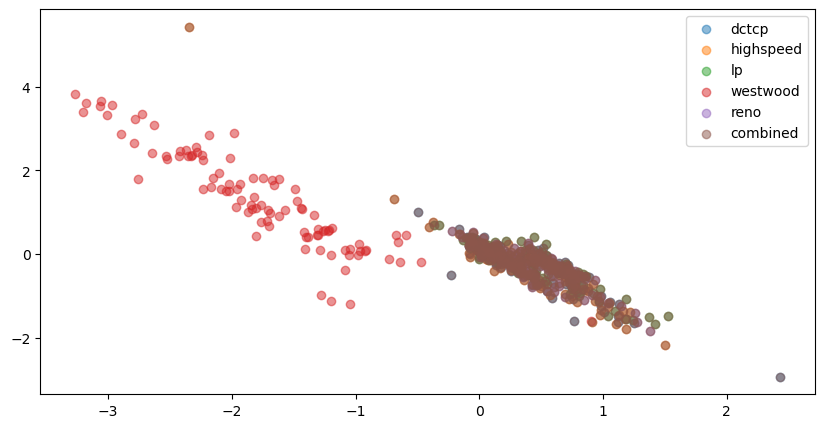

In [418]:
degree = 2
fig = plt.figure(figsize=(10,5))
for cc in scaled_vals[degree]:
    if cc != 'scaler':
        if cc != 'cubicQ' and cc != "htcp":
            plt.scatter(scaled_vals[degree][cc][:,0],scaled_vals[degree][cc][:,1],label=cc,alpha=0.5)
plt.legend()
plt.show()

Combining dctcp, highspeed, lp, reno and westwood

In [419]:
from mpl_toolkits.mplot3d import Axes3D

In [256]:
# degree = 3
# web_data[degree]  = get_website_by_degree(degree)
# mm_scaled_web_data[degree] = {'labels':web_data[degree]['labels'],
#                               'data':(web_data[degree]['data']-mm_scaled_vals[degree]['min_data'])/(mm_scaled_vals[degree]['max_data']-mm_scaled_vals[degree]['min_data'])}

# fig = plt.figure(figsize=(15,8))
# ax = fig.add_subplot(111, projection='3d')

# for cc in mm_scaled_vals[degree]:
#     if cc not in not_cc :
#         ax.scatter(mm_scaled_vals[degree][cc][:,0],mm_scaled_vals[degree][cc][:,1], mm_scaled_vals[degree][cc][:,2], label=cc,alpha=0.5)
# ax.legend()


# fig = plt.figure(figsize=(15,8))
# ax = fig.add_subplot(111, projection='3d')

# ax.scatter(mm_scaled_web_data[degree]['data'][:,0], mm_scaled_web_data[degree]['data'][:,1], mm_scaled_web_data[degree]['data'][:,2],  label='websites',alpha=0.5)
# ax.legend()


# fig = plt.figure(figsize=(15,8))
# ax = fig.add_subplot(111, projection='3d')

# for cc in mm_scaled_vals[degree]:
#     if cc not in not_cc :
#         ax.scatter(mm_scaled_vals[degree][cc][:,0],mm_scaled_vals[degree][cc][:,1],mm_scaled_vals[degree][cc][:,2],label=cc,alpha=0.5)
# ax.legend()

# ax.scatter(mm_scaled_web_data[degree]['data'][:,0], mm_scaled_web_data[degree]['data'][:,1],mm_scaled_web_data[degree]['data'][:,2], label='websites',alpha=0.5)
# ax.legend()


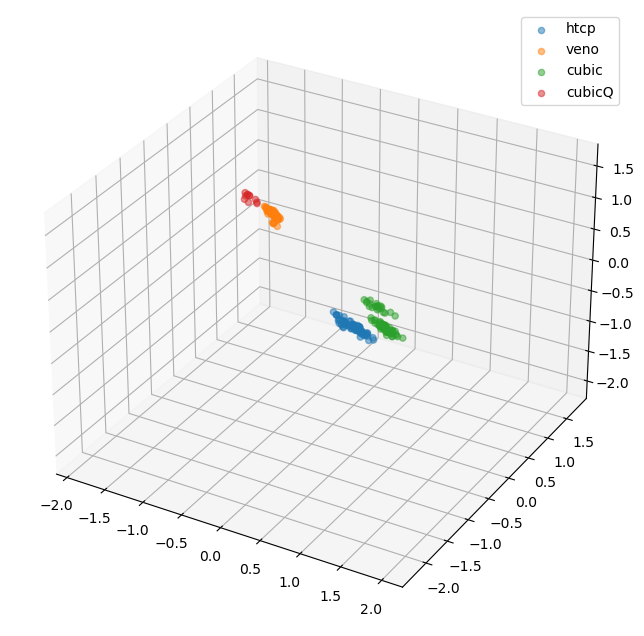

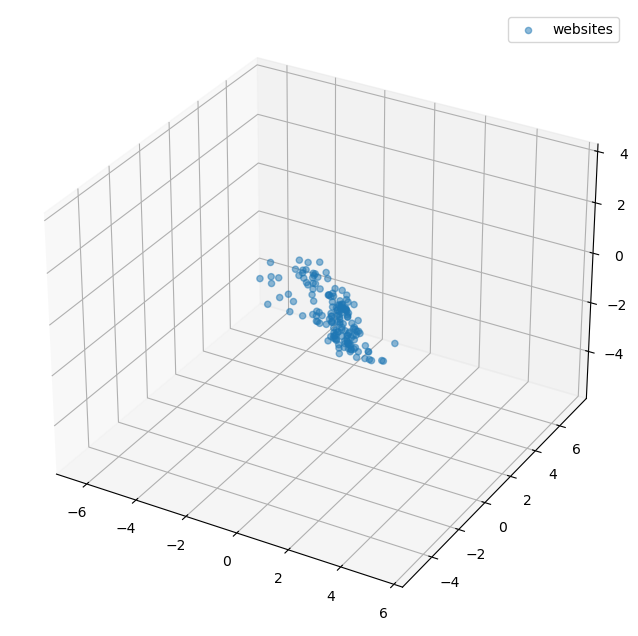

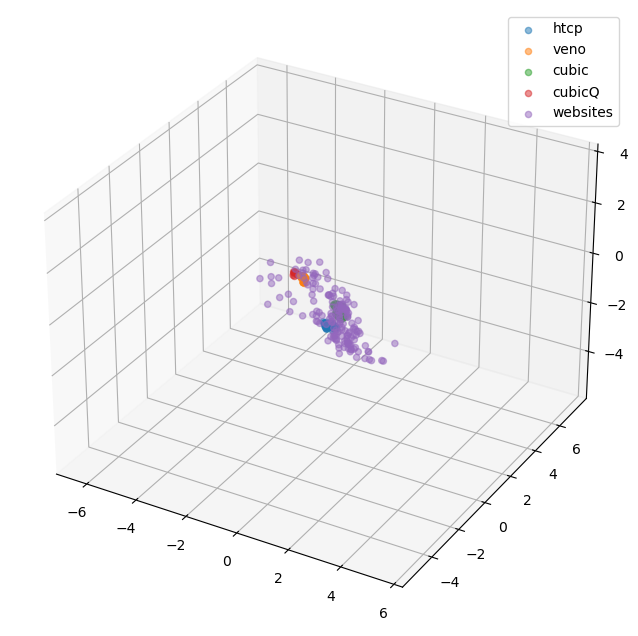

In [420]:
degree = 3
web_data[degree]  = get_website_by_degree(degree)
scaled_web_data[degree] = {'labels':web_data[degree]['labels'], 'data':np.array(scaled_vals[degree]['scaler'].transform(web_data[degree]['data']))}

fig = plt.figure(figsize=(15,8))
ax = fig.add_subplot(111, projection='3d')

for cc in scaled_vals[degree]:
    if cc != 'scaler' :
        ax.scatter(scaled_vals[degree][cc][:,0],scaled_vals[degree][cc][:,1], scaled_vals[degree][cc][:,2], label=cc,alpha=0.5)
ax.legend()


fig = plt.figure(figsize=(15,8))
ax = fig.add_subplot(111, projection='3d')

ax.scatter(scaled_web_data[degree]['data'][:,0], scaled_web_data[degree]['data'][:,1], scaled_web_data[degree]['data'][:,2],  label='websites',alpha=0.5)
ax.legend()


fig = plt.figure(figsize=(15,8))
ax = fig.add_subplot(111, projection='3d')

for cc in scaled_vals[degree]:
    if cc != 'scaler' :
        ax.scatter(scaled_vals[degree][cc][:,0],scaled_vals[degree][cc][:,1], scaled_vals[degree][cc][:,2],label=cc,alpha=0.5)
ax.legend()

ax.scatter(scaled_web_data[degree]['data'][:,0], scaled_web_data[degree]['data'][:,1],scaled_web_data[degree]['data'][:,2], label='websites',alpha=0.5)
ax.legend()


### Detecting outliers (different thresholds for different degree)

In [421]:
def calc_thresh(thresh,degree):
    return np.array(degree*[thresh])    

In [422]:
# def calc_thresh(degree,weight=[1]):
#     total_sum = 0
#     total_len = 0
#     for cc in scaled_vals[degree]:
#         if cc in not_cc:
#             continue
#         mn = np.mean(scaled_vals[degree][cc])
# #         print(mn)
#         dist = weight*(abs(scaled_vals[degree][cc]-mn))
#         dist = np.sqrt(np.sum((dist**2),axis=1))
# #         print(dist)
#         total_sum += np.sum(dist)
#         total_len += len(dist)
# #         print(total_sum,total_len)
#     return total_sum/total_len
        

In [423]:
def get_non_outliers(degree,thresh,weight=[1]):
    non_outliers_index = []
    
    for cc in scaled_vals[degree]:
        if cc == 'scaler':
            continue
        for i in range(len(x)):
            isNo = 1
            for d in range(degree):
                if abs(x[i][d]) > thresh:
                    isNo = 0
            if isNo:
                non_outliers_index.append(i)
    non_outliers_index = list(set(non_outliers_index))
    return non_outliers_index

In [424]:
# def get_non_outliers(degree,weight=[1]):
#     non_outliers_index = []
#     for cc in scaled_vals[degree]:
#         if cc in not_cc:
#             continue
#         mn = np.mean(scaled_vals[degree][cc],axis=0)
#         dist = weight*(abs(x-mn))
#         dist = np.sqrt(np.sum(dist**2,axis=1))
#         for i in range(len(x)):
#             print(dist[i],dist[i]<thresh)
#             if dist[i] < thresh:
#                 non_outliers_index.append(i)
#     non_outliers_index = list(set(non_outliers_index))
#     return non_outliers_index

In [425]:
def plot_index(out,l,co='b'):
    n_rows = math.ceil(len(out)/3)
    if n_rows == 0:
        return
    fig, ax = plt.subplots(n_rows,3,figsize=(10,3*n_rows))
    c=0
    if n_rows == 1:
        for j in range(3):
            if c < len(out):
                ax[j].plot(web_mp[l[out[c]]]['time'],web_mp[l[out[c]]]['data'],color=co)
                ax[j].set_title(label=l[out[c]])
                c+=1
        return
        
    for i in range(n_rows):
        for j in range(3):
            if c < len(out):
                ax[i][j].plot(web_mp[l[out[c]]]['time'],web_mp[l[out[c]]]['data'],color=co)
                ax[i][j].set_title(label=l[out[c]])
                c+=1


In [431]:
usable_web = {}

Thresh [1 1 1]
Total 13
Non outliers 4
Outliers 9


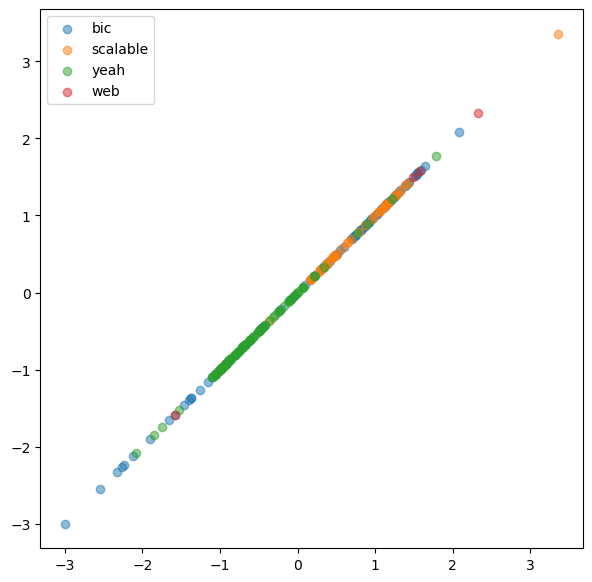

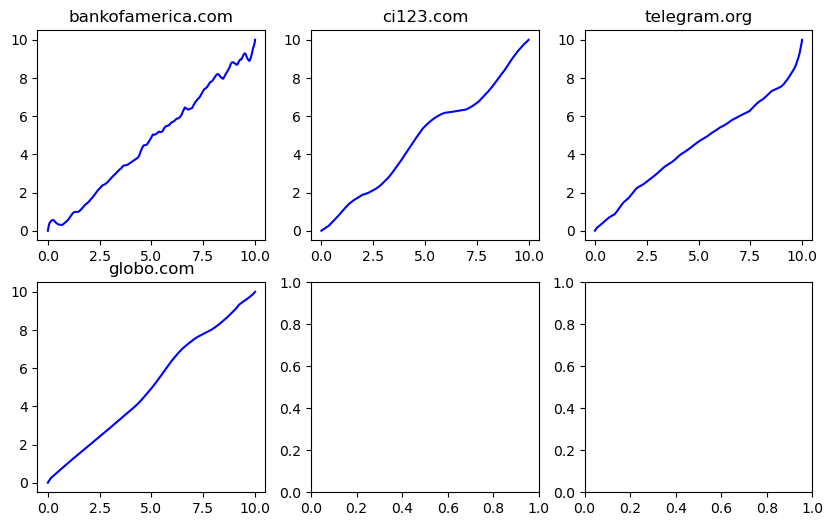

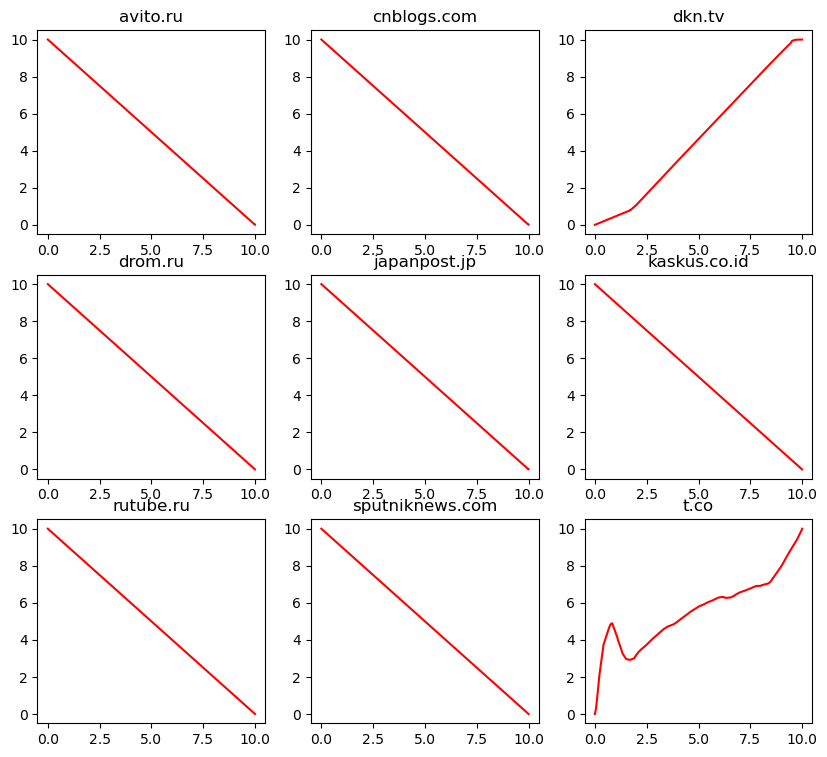

In [432]:
degree = 1
thresh = calc_thresh(degree,3)
print("Thresh", thresh)
non_outliers_index = []
x = scaled_web_data[degree]['data']
l = scaled_web_data[degree]['labels']
print("Total",len(l))
non_outliers_index = get_non_outliers(degree,3)
print("Non outliers", len(non_outliers_index))
fig = plt.figure(figsize=(7,7))
for cc in scaled_vals[degree]:
    if cc=='scaler':
        continue
    plt.scatter(scaled_vals[degree][cc][:,0],scaled_vals[degree][cc][:,0],label=cc,alpha=0.5)
pts = np.array([scaled_web_data[degree]['data'][i] for i in non_outliers_index])
plt.scatter(pts[:,0], pts[:,0],label='web',alpha=0.5)
plt.legend()

plot_index(non_outliers_index,l)
# n_rows = math.ceil(len(non_outliers_index)/3)
# fig, ax = plt.subplots(n_rows,3,figsize=(10,3*n_rows))
# c=0
# for i in range(n_rows):
#     for j in range(3):
#         if c < len(non_outliers_index):
#             ax[i][j].plot(web_mp[l[non_outliers_index[c]]]['time'],web_mp[l[non_outliers_index[c]]]['data'],label=l[c])
#             c+=1
# plt.legend()
outliers_index = [i for i in range(len(l)) if i not in non_outliers_index]
print("Outliers",len(outliers_index))
plot_index(outliers_index,l,'r')

# n_rows = math.ceil(len(outliers_index)/3)
# fig, ax = plt.subplots(n_rows,3,figsize=(10,3*n_rows))
# c = 0
# for i in range(n_rows):
#     for j in range(3):
#         if c < len(l):
#             ax[i][j].plot(web_mp[l[c]]['time'],web_mp[l[c]]['data'],color='r')
#             c+=1
usable_web[degree] = non_outliers_index

Thresh [2 2 2]
Total 19
Non outliers 6


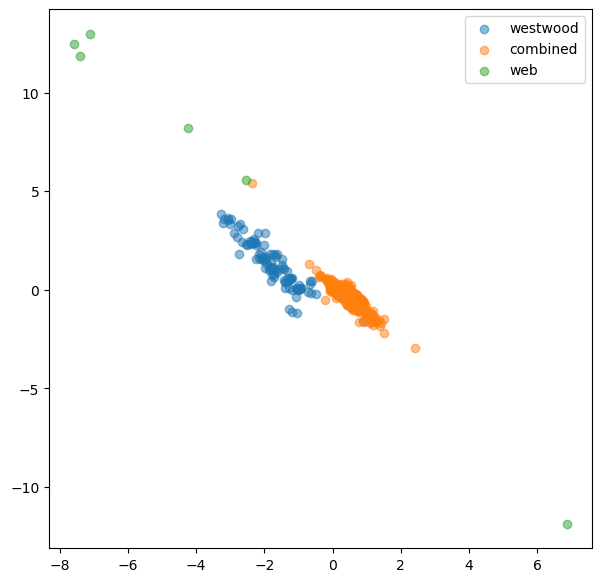

Outliers 13


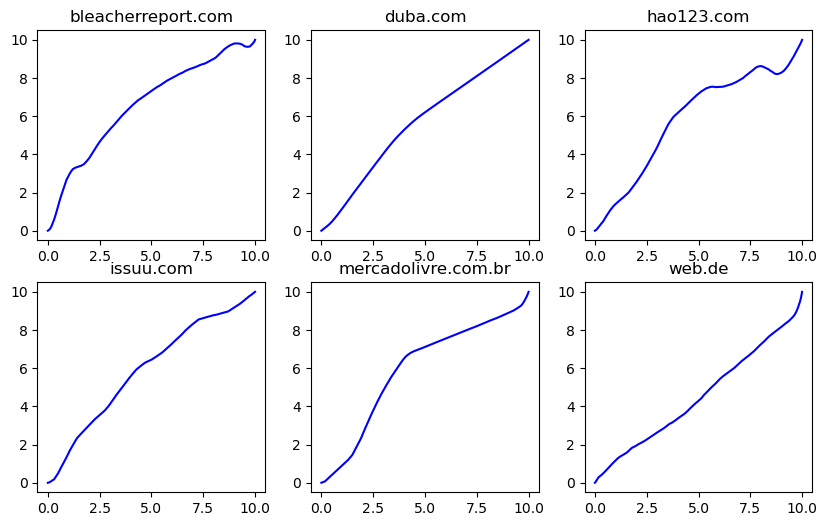

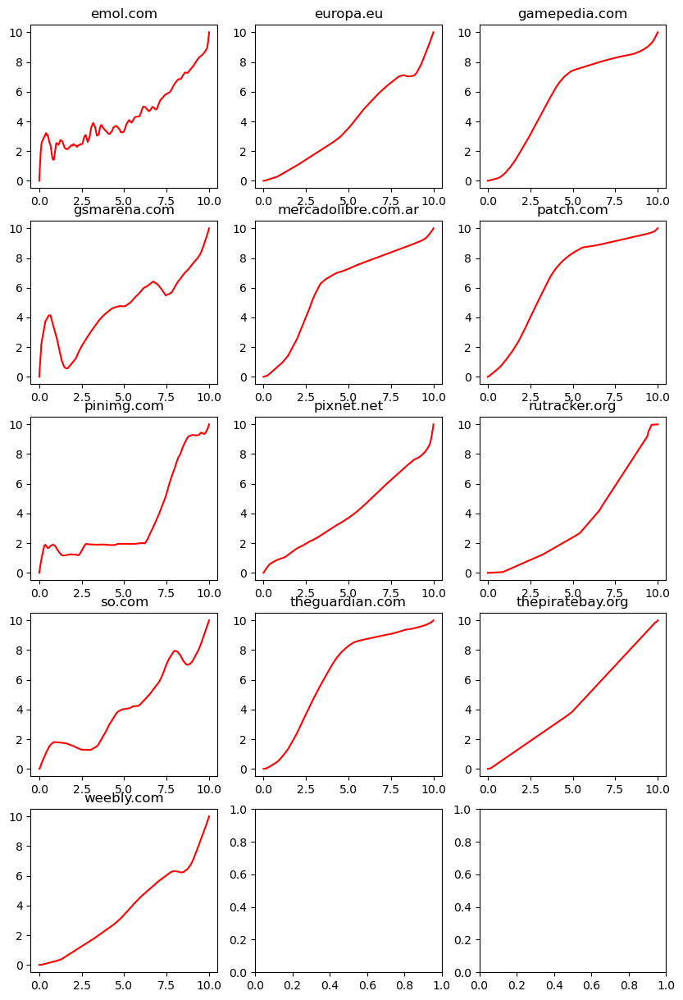

In [434]:
degree = 2
thresh = calc_thresh(degree,3)
print("Thresh", thresh)
non_outliers_index = []
x = scaled_web_data[degree]['data']
l = scaled_web_data[degree]['labels']
print("Total",len(l))
non_outliers_index = get_non_outliers(degree,15,[0.67,0.33])
print("Non outliers", len(non_outliers_index))

fig = plt.figure(figsize=(7,7))
for cc in scaled_vals[degree]:
    if cc=='scaler':
        continue
    if cc in ['reno','lp','dctcp','highspeed']:
        continue
    plt.scatter(scaled_vals[degree][cc][:,0],scaled_vals[degree][cc][:,1],label=cc,alpha=0.5)
pts = np.array([scaled_web_data[degree]['data'][i] for i in non_outliers_index])
if len(pts) > 0:
    plt.scatter(pts[:,0], pts[:,1],label='web',alpha=0.5)
plt.legend()
plt.show()

plot_index(non_outliers_index,l)
# n_rows = math.ceil(len(non_outliers_index)/3)
# fig, ax = plt.subplots(n_rows,3,figsize=(10,3*n_rows))
# c=0
# for i in range(n_rows):
#     for j in range(3):
#         if c < len(non_outliers_index):
#             ax[i][j].plot(web_mp[l[non_outliers_index[c]]]['time'],web_mp[l[non_outliers_index[c]]]['data'],label=l[c])
#             c+=1
# plt.legend()
outliers_index = [i for i in range(len(l)) if i not in non_outliers_index]
print("Outliers",len(outliers_index))
plot_index(outliers_index,l,'r')
# n_rows = math.ceil(len(outliers_index)/3)
# fig, ax = plt.subplots(n_rows,3,figsize=(10,3*n_rows))
# c = 0
# for i in range(n_rows):
#     for j in range(3):
#         if c < len(l):
#             ax[i][j].plot(web_mp[l[c]]['time'],web_mp[l[c]]['data'],color='r')
#             c+=1
usable_web[degree] = non_outliers_index

Reading ../../aws/website_measurements/26_1k_cut/mumbai/inquirer.net-0-50-200-2-tcp.csv...
All Ports :  dict_keys(['45550'])
Port 45550


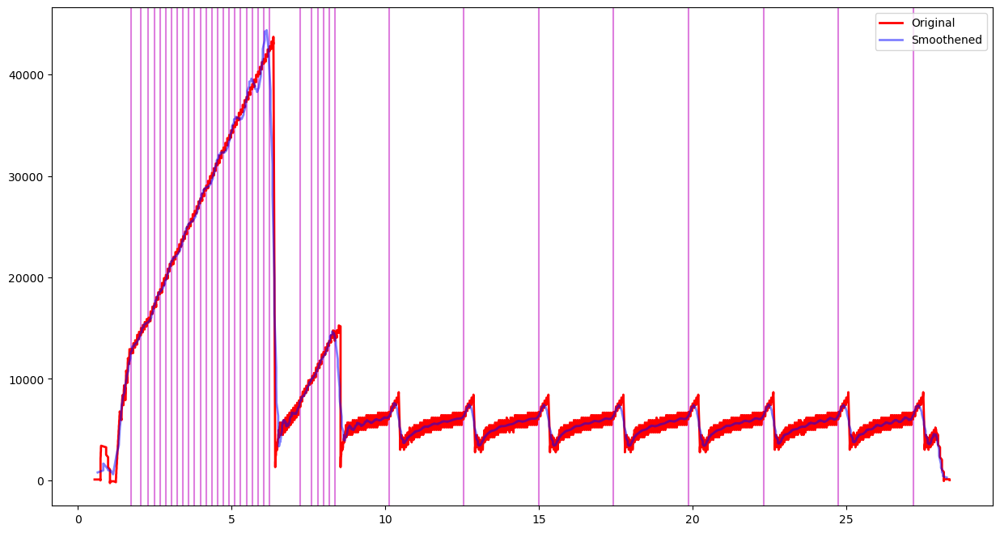

([0.6475375000000001,
  0.8296445,
  0.8296485,
  0.82965,
  0.8296585000000001,
  0.8296600000000001,
  0.8296615,
  0.8296635,
  0.8296650000000001,
  0.8296665000000001,
  0.8296685,
  0.8304145,
  0.8304195000000001,
  0.8304275000000001,
  0.8304295,
  0.8304355,
  0.831455,
  0.831459,
  0.8314675,
  0.8314695000000001,
  0.8314895,
  0.8314915,
  0.8314995000000001,
  0.8315015,
  0.831509,
  0.831511,
  0.8346990000000001,
  0.8347035,
  0.8378355,
  0.8378395000000001,
  0.840998,
  0.986287,
  0.9862905,
  0.986292,
  0.9862935,
  1.0791685,
  1.079173,
  1.0791745000000001,
  1.079176,
  1.079178,
  1.147544,
  1.147548,
  1.1475495,
  1.147551,
  1.1475585000000001,
  1.1475605,
  1.147562,
  1.147564,
  1.1475655,
  1.1475675,
  1.1482495,
  1.1482715,
  1.1482765000000001,
  1.268864,
  1.3359785,
  1.3370354999999998,
  1.3377585,
  1.3377629999999998,
  1.3451635,
  1.3451680000000001,
  1.3525415,
  1.3525455000000002,
  1.3572095000000002,
  1.3572190000000002,
  1.36

In [224]:
name = "inquirer.net" 
new_name = "../../aws/website_measurements/26_1k_cut/mumbai/" + name + "-0-50-200-2-tcp.csv"
plot_one_bt(new_name,p="y",t=1)

Thresh [3 3 3]
Total 162
Non outliers 140


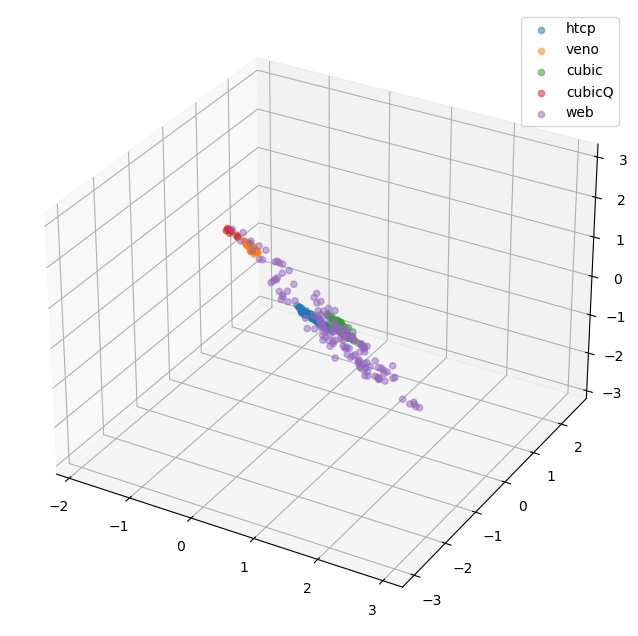

Outliers 22


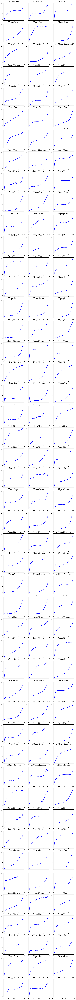

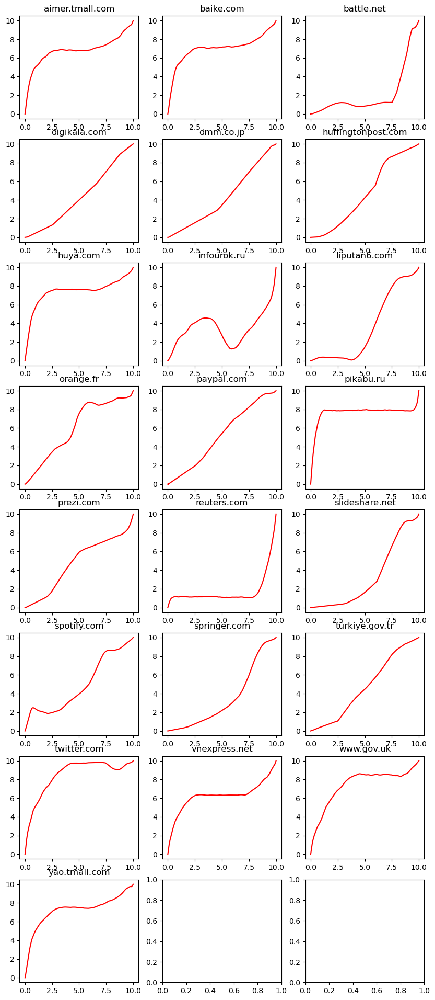

In [435]:
degree = 3
thresh = calc_thresh(degree,3)
print("Thresh", thresh)
non_outliers_index = []
x = scaled_web_data[degree]['data']
l = scaled_web_data[degree]['labels']
print("Total",len(l))

non_outliers_index = get_non_outliers(degree,3,[0.50,0.33,0.17])

print("Non outliers", len(non_outliers_index))

fig = plt.figure(figsize=(15,8))
ax = fig.add_subplot(111, projection='3d')

for cc in scaled_vals[degree]:
    if cc=='scaler':
        continue
    ax.scatter(scaled_vals[degree][cc][:,0],scaled_vals[degree][cc][:,1],scaled_vals[degree][cc][:,2],label=cc,alpha=0.5)
pts = np.array([scaled_web_data[degree]['data'][i] for i in non_outliers_index])
ax.scatter(pts[:,0], pts[:,1], pts[:,2],label='web',alpha=0.5)
ax.legend()
plt.show()
plot_index(non_outliers_index,l)
# n_rows = math.ceil(len(non_outliers_index)/3)
# fig, ax = plt.subplots(n_rows,3,figsize=(10,3*n_rows))
# c=0
# for i in range(n_rows):
#     for j in range(3):
#         if c < len(non_outliers_index):
#             ax[i][j].plot(web_mp[l[non_outliers_index[c]]]['time'],web_mp[l[non_outliers_index[c]]]['data'],label=l[c])
#             c+=1
# plt.legend()
outliers_index = [i for i in range(len(l)) if i not in non_outliers_index]
print("Outliers",len(outliers_index))
plot_index(outliers_index,l,'r')
# n_rows = math.ceil(len(outliers_index)/3)
# fig, ax = plt.subplots(n_rows,3,figsize=(10,3*n_rows))
# c = 0
# for i in range(n_rows):
#     for j in range(3):
#         if c < len(l):
#             ax[i][j].plot(web_mp[l[c]]['time'],web_mp[l[c]]['data'],color='r')
#             c+=1
usable_web[degree] = non_outliers_index

## Now applying gaussian model on all the website data and getting the best probability

In [462]:
scaled_vals[2].pop('combined')

array([[ 1.64788933e-01,  1.86340693e-01],
       [ 5.93347410e-01, -2.82277947e-01],
       [ 2.45708967e-01, -1.66573473e-01],
       [ 1.02930860e-01,  1.50872002e-01],
       [ 3.30957229e-01, -3.84714451e-01],
       [ 4.95443549e-01, -1.23596701e-01],
       [-6.75124877e-02,  2.56450350e-01],
       [-1.38261284e-02,  7.71328979e-02],
       [ 4.30035571e-01, -2.99230224e-01],
       [ 2.21443494e-01,  1.70560893e-02],
       [ 9.86232455e-01, -1.25327105e+00],
       [ 5.67889742e-02, -3.74322644e-02],
       [ 3.90585043e-01,  2.07623602e-01],
       [ 4.72217848e-01,  9.11439965e-02],
       [ 3.69025033e-01,  2.41560873e-02],
       [ 2.48173910e-01, -2.34858233e-01],
       [ 4.66157410e-01, -7.33368571e-01],
       [ 7.52587874e-01, -4.85052025e-01],
       [-8.46606076e-02,  4.03384154e-01],
       [ 8.21947099e-01, -7.25002212e-01],
       [ 6.82059461e-01, -4.84002060e-01],
       [ 3.33008732e-01, -8.87521573e-02],
       [ 7.13311914e-01, -2.58717321e-01],
       [ 5.

In [486]:
def create_test_data(degree):
    data = []
    labels = []
    for i in usable_web[degree]:
        data.append(scaled_web_data[degree]['data'][i])
        labels.append(scaled_web_data[degree]['labels'][i])
    return data,labels

In [463]:
def create_train_data(degree):
    X = []
    y = []
    count_to_map = {}
    count = 1
    for cc in scaled_vals[degree]:
        if cc != 'scaler':
            X += list(scaled_vals[degree][cc])
            y += [count]*len(scaled_vals[degree][cc])
            count_to_map[count] = cc
            count+=1
    return X, y, count_to_map

In [596]:
X = {}
y = {}
count_to_mp = {}

In [597]:
for d in [1,2,3]:
    X[d], y[d], count_to_mp[d] = create_train_data(d)

In [598]:
data_test = {}
for i in [1,2,3]:
    data_test[i] = {}
    data_test[i]['data'], data_test[i]['labels'] = create_test_data(i)

In [599]:
def plot_test(out,l,predict_cc, co='b'):
    n_rows = math.ceil(len(out)/3)
    if n_rows == 0:
        return
    fig, ax = plt.subplots(n_rows,3,figsize=(10,3*n_rows))
    c=0
    if n_rows == 1:
        for j in range(3):
            if c < len(out):
                ax[j].plot(web_mp[l[out[c]]]['time'],web_mp[l[out[c]]]['data'],color=co)
                ax[j].set_title(label = predict_cc[c] + " " + l[out[c]])
                c+=1
        return
        
    for i in range(n_rows):
        for j in range(3):
            if c < len(out):
                ax[i][j].plot(web_mp[l[out[c]]]['time'],web_mp[l[out[c]]]['data'],color=co)
                ax[i][j].set_title(label = predict_cc[c] + " " + l[out[c]])
                c+=1


In [496]:
# To ADD :
# Count and prior probability check
# Result storing and showing on the graph

In [623]:
classifiers = {}

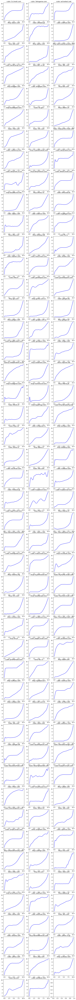

In [625]:
degree = 3
from sklearn.naive_bayes import GaussianNB
clf = GaussianNB()
X_t = np.array(X[degree])
y_t = np.array(y[degree])
clf.fit(X_t,y_t)
classifiers[degree] = clf
estimates = clf.predict(data_test[degree]['data'])
prob = clf.predict_proba(data_test[degree]['data'])
inde = [i for i in range(len(data_test[degree]['data']))]
cc_predict = [count_to_mp[degree][i] for i in estimates]
plot_test(inde,data_test[degree]['labels'],cc_predict)


In [604]:
cc_count = {}
for cc in cc_predict:
    if cc not in cc_count:
        cc_count[cc] = 0
    cc_count[cc]+=1
print(cc_count)

{'cubic': 83, 'htcp': 49, 'veno': 7, 'cubicQ': 1}


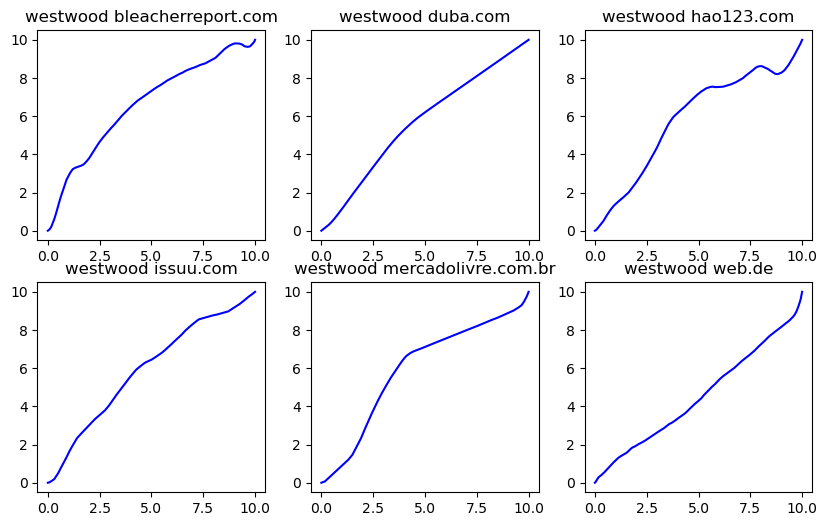

In [627]:
degree = 2
from sklearn.naive_bayes import GaussianNB
clf = GaussianNB()
X_t = np.array(X[degree])
y_t = np.array(y[degree])
clf.fit(X_t,y_t)
classifiers[degree] = clf
estimates = clf.predict(data_test[degree]['data'])
prob = clf.predict_proba(data_test[degree]['data'])
inde = [i for i in range(len(data_test[degree]['data']))]
cc_predict = [count_to_mp[degree][i] for i in estimates]
plot_test(inde,data_test[degree]['labels'],cc_predict)


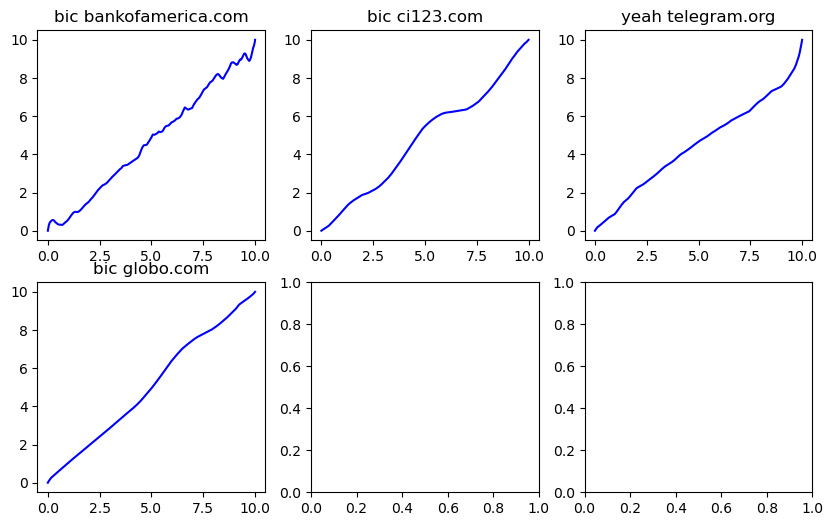

In [629]:
degree = 1
from sklearn.naive_bayes import GaussianNB
clf = GaussianNB()
X_t = np.array(X[degree])
y_t = np.array(y[degree])
clf.fit(X_t,y_t)
classifiers[degree] = clf
estimates = clf.predict(data_test[degree]['data'])
prob = clf.predict_proba(data_test[degree]['data'])
inde = [i for i in range(len(data_test[degree]['data']))]
cc_predict = [count_to_mp[degree][i] for i in estimates]
plot_test(inde,data_test[degree]['labels'],cc_predict)


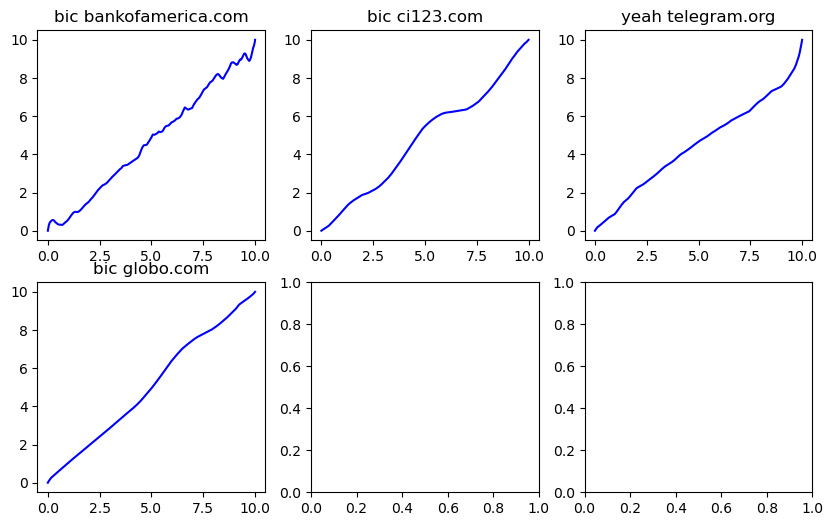

In [631]:
degree = 1
clf = classifiers[degree]
estimates = clf.predict(data_test[degree]['data'])
prob = clf.predict_proba(data_test[degree]['data'])
inde = [i for i in range(len(data_test[degree]['data']))]
cc_predict = [count_to_mp[degree][i] for i in estimates]
plot_test(inde,data_test[degree]['labels'],cc_predict)


In [633]:
with open("../analysis/final/classifiers.txt","wb") as f:
    pickle.dump(classifiers,f)

In [635]:
with open("../analysis/final/count_to_mp.txt","wb") as f:
    pickle.dump(count_to_mp,f)

In [630]:
classifiers

{3: GaussianNB(), 2: GaussianNB(), 1: GaussianNB()}

## Simultaneously using a model shape from the websites to help use Dynamic Time Wraping

In [536]:
step = 0.05
n_t = []
for i in range(201):
    n_t.append(round(step*i,2))

In [550]:
coeff_best = {}

bic
[0.9298038947886891]


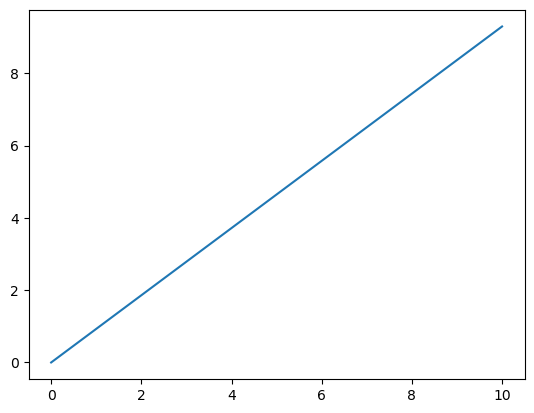

dctcp
[-0.029970724376191263, 1.2517587946311495]


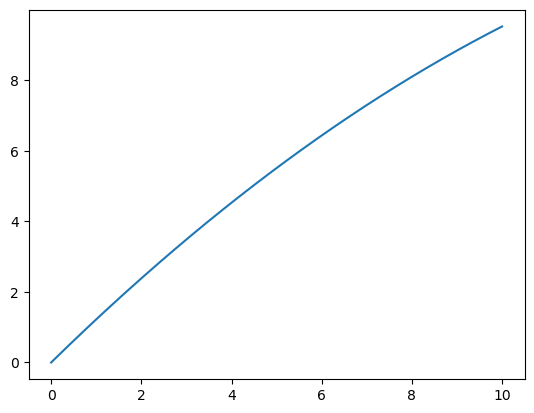

highspeed
[-0.029755144358185614, 1.2487899159378537]


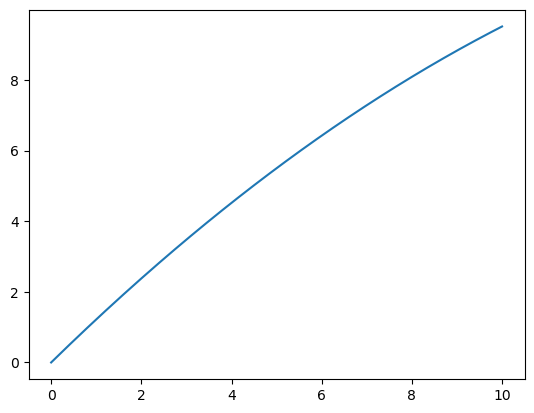

htcp
[0.01862751129015389, -0.1732027290792356, 0.8553147694052095]


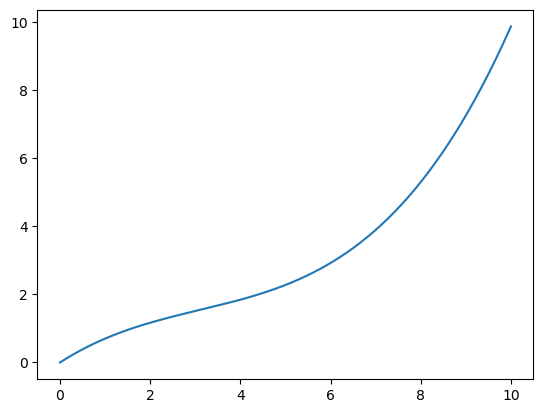

lp
[-0.029904686842757617, 1.2542140547591456]


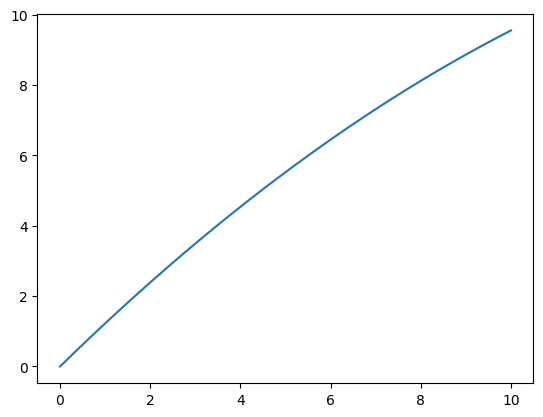

scalable
[0.9483330868678786]


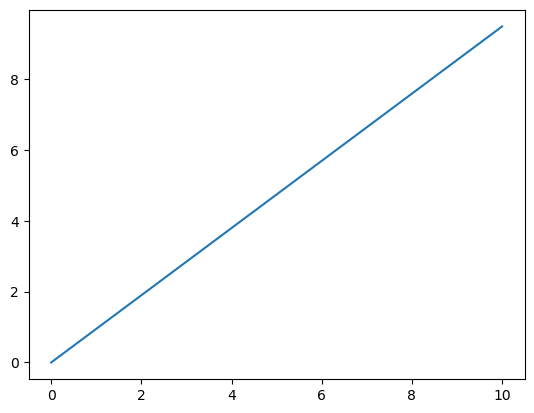

veno
[0.01362567641402264, -0.2713641713000938, 2.3308007184637716]


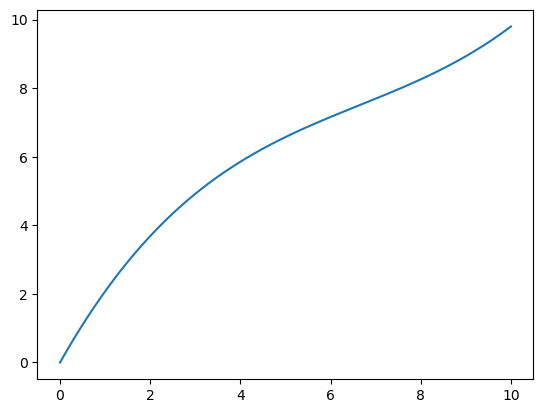

westwood
[-0.04691649695049201, 1.3281107795848743]


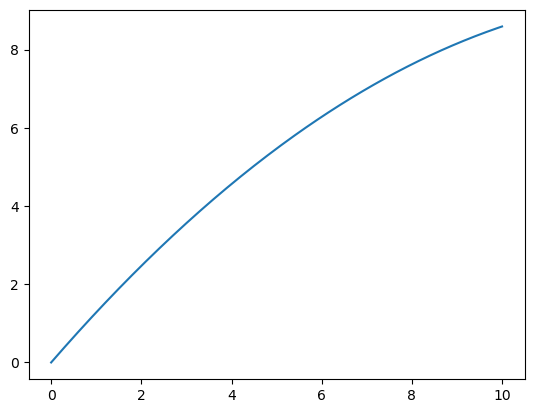

yeah
[0.8969937034735426]


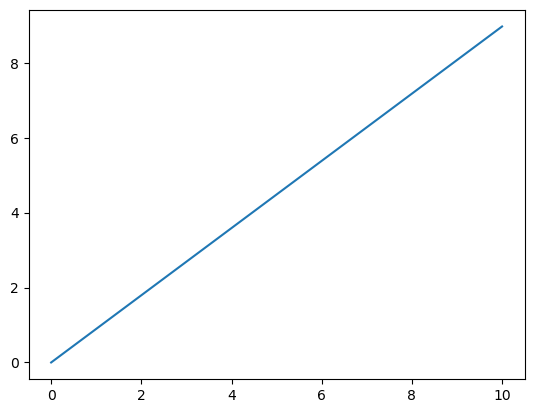

cubic
[0.03203187820347732, -0.45707264446991575, 2.3098077648600635]


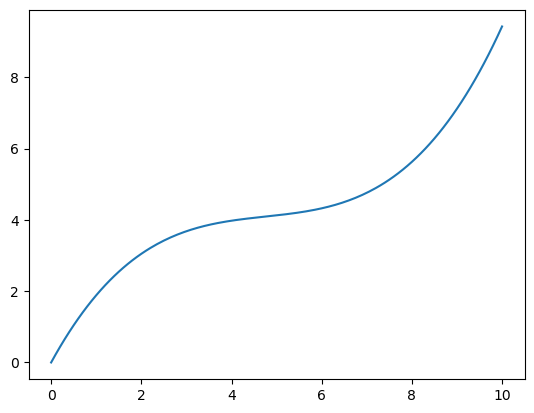

reno
[-0.029995581846606053, 1.253829254506586]


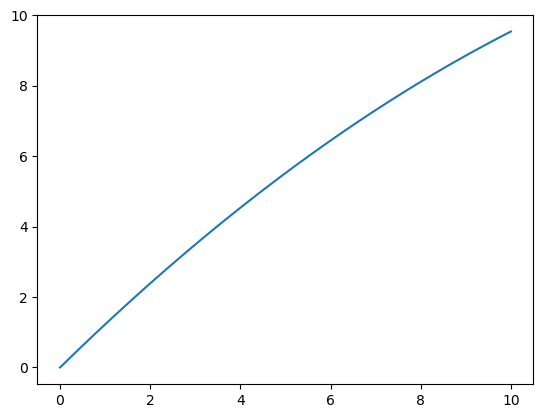

cubicQ
[0.007955138927217305, -0.1905231254353349, 2.0877181163318204]


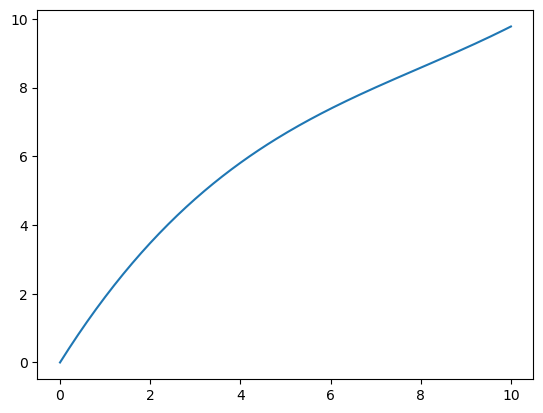

In [551]:
for cc in vals_cubicQ:
    deg = cc_degree[cc]
    coeff_cc = list(np.mean(vals_cubicQ[cc][1],axis=0))
    print(cc)
    print(coeff_cc)
    coeff_cc.append(0)
    y_cc = np.polyval(coeff_cc,n_t)
    if deg not in coeff_best:
        coeff_best[deg] = {}
    coeff_best[deg][cc] = y_cc
    plt.plot(n_t,y_cc)
    plt.show()

In [552]:
coeff_best

{1: {'bic': array([0.        , 0.04649019, 0.09298039, 0.13947058, 0.18596078,
         0.23245097, 0.27894117, 0.32543136, 0.37192156, 0.41841175,
         0.46490195, 0.51139214, 0.55788234, 0.60437253, 0.65086273,
         0.69735292, 0.74384312, 0.79033331, 0.83682351, 0.8833137 ,
         0.92980389, 0.97629409, 1.02278428, 1.06927448, 1.11576467,
         1.16225487, 1.20874506, 1.25523526, 1.30172545, 1.34821565,
         1.39470584, 1.44119604, 1.48768623, 1.53417643, 1.58066662,
         1.62715682, 1.67364701, 1.72013721, 1.7666274 , 1.81311759,
         1.85960779, 1.90609798, 1.95258818, 1.99907837, 2.04556857,
         2.09205876, 2.13854896, 2.18503915, 2.23152935, 2.27801954,
         2.32450974, 2.37099993, 2.41749013, 2.46398032, 2.51047052,
         2.55696071, 2.60345091, 2.6499411 , 2.69643129, 2.74292149,
         2.78941168, 2.83590188, 2.88239207, 2.92888227, 2.97537246,
         3.02186266, 3.06835285, 3.11484305, 3.16133324, 3.20782344,
         3.25431363, 3.3

In [546]:
!pip install fastdtw

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 133.4/133.4 kB 672.2 kB/s eta 0:00:00m eta 0:00:010:01
  Preparing metadata (setup.py) ... done
  Created wheel for fastdtw: filename=fastdtw-0.3.4-cp39-cp39-linux_x86_64.whl size=106580 sha256=85010a54b527bf3c1f5be7d0d0623a73bef55fca001989b403c1e6d299f373d7
  Stored in directory: /home/lakshayr/.cache/pip/wheels/1f/a1/63/bfd0fddb5bf0b59f564872e29272cee8a2de0cd745d88fede5
Successfully built fastdtw


In [ ]:


a = np.random.random(100)
b = np.random.random(200)

distance, path = fastdtw(a, b, dist=euclidean)
print(f"DTW Distance: {distance}")

In [558]:
web_cc_mp

{'3c.tmall.com': {'deg': 3,
  'coeff': [0.03286082633634334,
   -0.5409930137565644,
   2.873355002377852,
   0.5081493840995913],
  'error': 0.3569622048000337},
 '3dmgame.com': {'deg': 3,
  'coeff': [0.04169681383545647,
   -0.5480205200857299,
   2.2704806436387597,
   0.8745270155478249],
  'error': 0.3399783908434122},
 'activetect.net': {'deg': 3,
  'coeff': [0.03471173213473108,
   -0.45177020895559333,
   1.8323717747458486,
   3.183458705366594],
  'error': 0.6783752948953854},
 'aimer.tmall.com': {'deg': 3,
  'coeff': [0.04370704166734615,
   -0.7060263300342675,
   3.583796055855667,
   1.4504780838479603],
  'error': 0.4747744143687431},
 'aliyun.com': {'deg': 3,
  'coeff': [0.02094688277531914,
   -0.22400593021480505,
   1.1609657614095323,
   -0.681820116060183],
  'error': 0.06723528662428721},
 'ameblo.jp': {'deg': 3,
  'coeff': [0.025040761507335425,
   -0.5344616014818149,
   3.7128338817312097,
   0.6680482363867941],
  'error': 0.3014204882021262},
 'android.com': 

In [565]:
from fastdtw import fastdtw
from scipy.spatial.distance import euclidean
import numpy as np

a = np.random.random(100)
b = np.random.random(200)

distance, path = fastdtw(a, b)
print(f"DTW Distance: {distance}")

DTW Distance: 35.61517884764212


In [573]:
from fastdtw import fastdtw
from scipy.spatial.distance import euclidean
import numpy as np

web_dtw = {}
for web in web_mp:
    dist = []
    cc_ts = []
    test_ts = web_mp[web]['data']
    if web in web_cc_mp:
        deg = web_cc_mp[web]['deg']
    else:
        continue
    for cc in coeff_best[deg]:
        cc_ts.append(cc)
        orig_ts = coeff_best[deg][cc]
#         print(test_ts)
#         print(orig_ts)
        distance, path = fastdtw(test_ts, orig_ts)
        dist.append(distance)
    if deg not in web_dtw:
        web_dtw[deg] = {}
    web_dtw[deg][web] = {
        'cc' : cc_ts,
        'dist' : dist
    }

In [576]:
web_dtw

{3: {'3c.tmall.com': {'cc': ['htcp', 'veno', 'cubic', 'cubicQ'],
   'dist': [7.358106880545286,
    8.354659194498163,
    6.838112859381028,
    8.27422983197717]},
  '3dmgame.com': {'cc': ['htcp', 'veno', 'cubic', 'cubicQ'],
   'dist': [11.611031017145313,
    11.742167148550813,
    17.56723918801191,
    11.687783349378163]},
  'activetect.net': {'cc': ['htcp', 'veno', 'cubic', 'cubicQ'],
   'dist': [16.23284633477669,
    10.326214717543577,
    22.07616270926661,
    11.183680566854319]},
  'aimer.tmall.com': {'cc': ['htcp', 'veno', 'cubic', 'cubicQ'],
   'dist': [10.514991324822583,
    5.500429590487483,
    12.63195868066388,
    5.796742279395472]},
  'aliyun.com': {'cc': ['htcp', 'veno', 'cubic', 'cubicQ'],
   'dist': [14.25856498498179,
    19.383078356268758,
    26.64618042567453,
    15.721385516986945]},
  'ameblo.jp': {'cc': ['htcp', 'veno', 'cubic', 'cubicQ'],
   'dist': [17.525137656960684,
    15.677764967807658,
    18.26545328319968,
    15.5560181824391]},
  'and

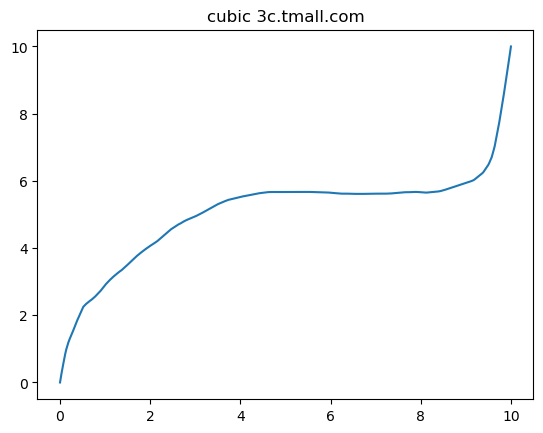

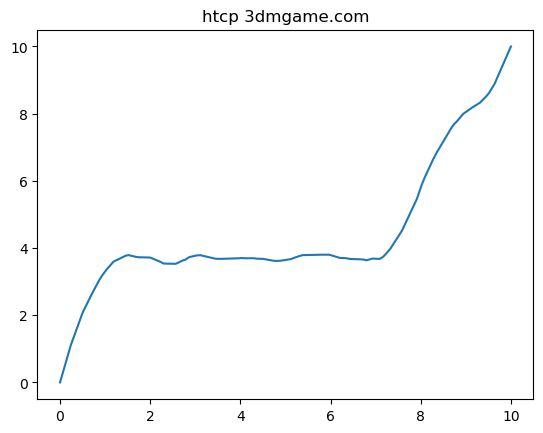

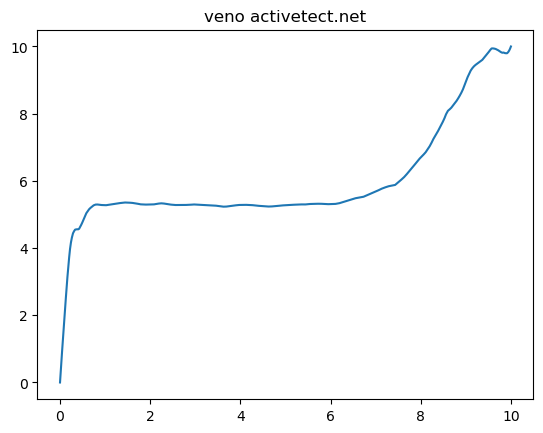

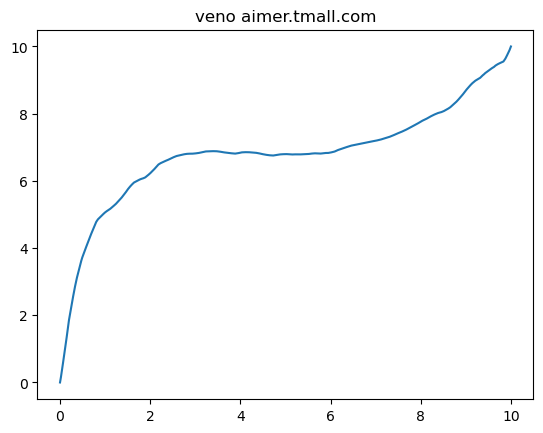

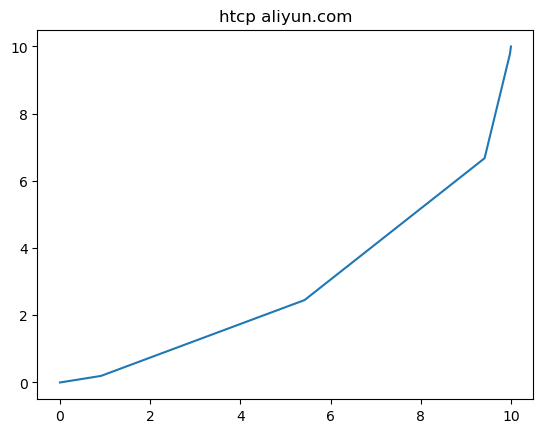

...

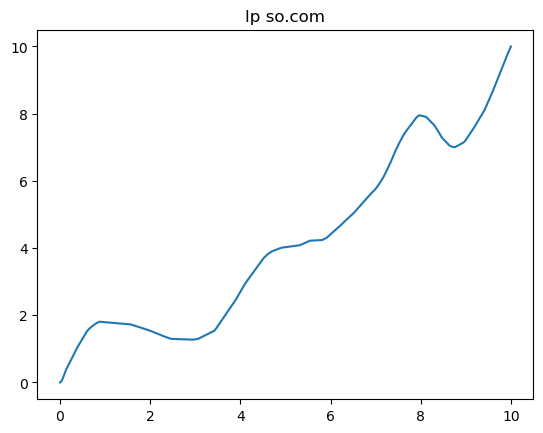

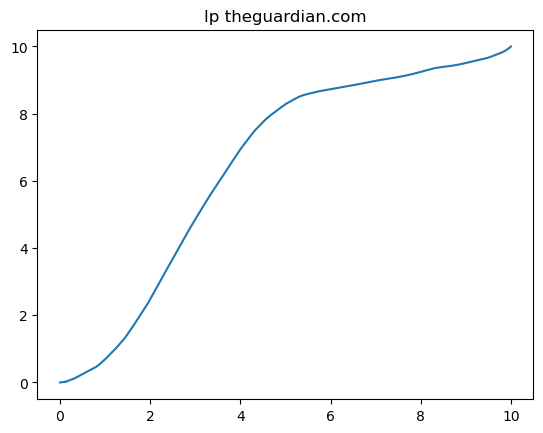

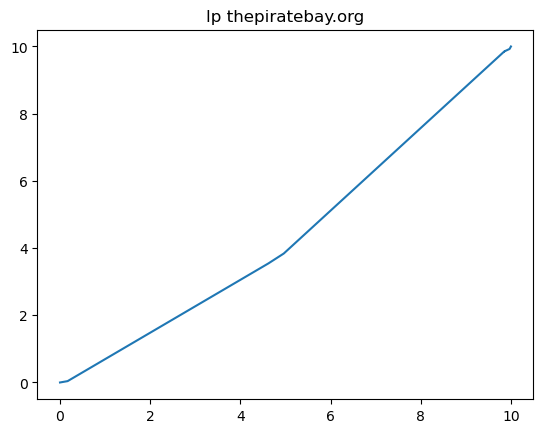

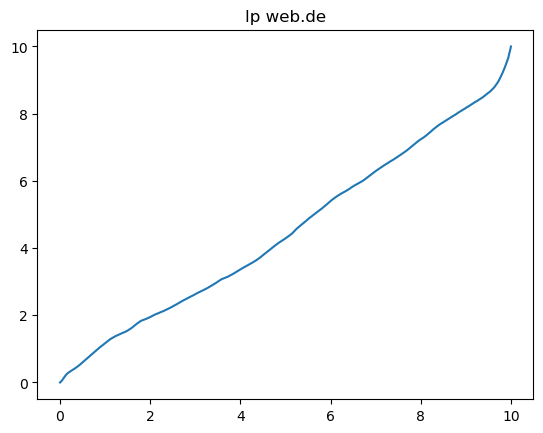

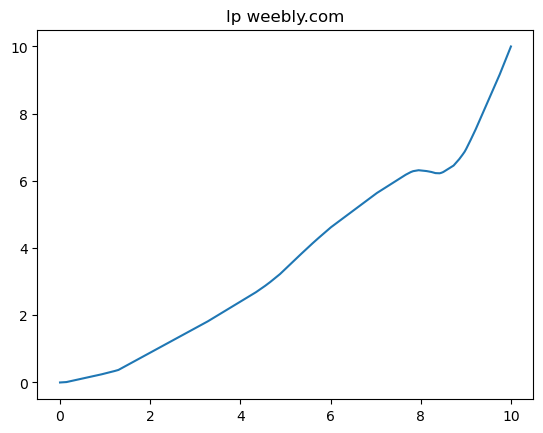

In [579]:
for deg in web_dtw:
    for web in web_dtw[deg]:
        min_ind = web_dtw[deg][web]['dist'].index(min(web_dtw[deg][web]['dist']))
        cc_ind =  web_dtw[deg][web]['cc'][min_ind]b
        plt.plot(web_mp[web]['time'], web_mp[web]['data'])
        plt.title(cc_ind+" "+web)
        plt.show()

In [580]:
fast_web_dtw = web_dtw

In [578]:
!pip install dtw-python

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 648.1/648.1 kB 1.9 MB/s eta 0:00:00m eta 0:00:010:00:01


In [590]:
from dtw import *
import numpy as np

web_dtw = {}
for web in web_mp:
    dist = []
    cc_ts = []
    test_ts = web_mp[web]['data']
    if web in web_cc_mp:
        deg = web_cc_mp[web]['deg']
    else:
        continue
    for cc in coeff_best[deg]:
        cc_ts.append(cc)
        orig_ts = coeff_best[deg][cc]
#         print(test_ts)
#         print(orig_ts)
        alignment = dtw(test_ts,orig_ts,dist_method=euclidean)
#         plt.plot(alignment.index1, alignment.index2)  
#         plt.show()
        dist.append(alignment.distance)
    if deg not in web_dtw:
        web_dtw[deg] = {}
    web_dtw[deg][web] = {
        'cc' : cc_ts,
        'dist' : dist
    }

[9.677750902597863, 11.021147984826795, 8.8264447806006, 10.679116701071353]


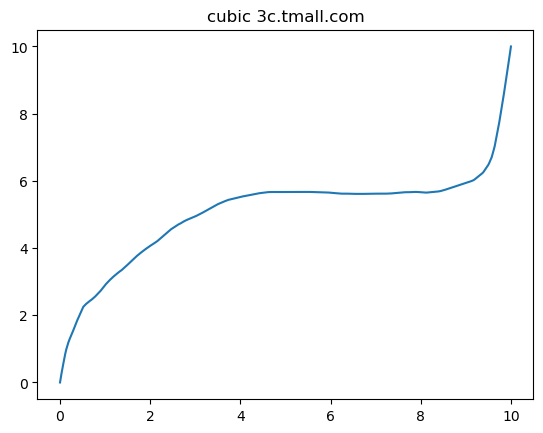

[13.975530345058218, 13.969561100061606, 17.853551183358647, 14.160665345033685]


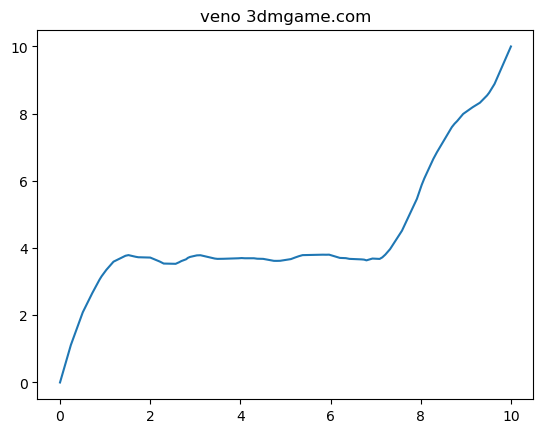

[19.0387471029389, 12.899116216585583, 24.801068490327914, 13.769415519644868]


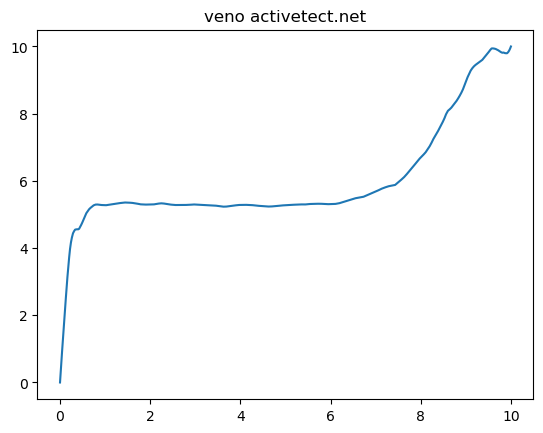

[13.089088727135358, 7.538595204936328, 15.06063077365105, 7.948445661366808]


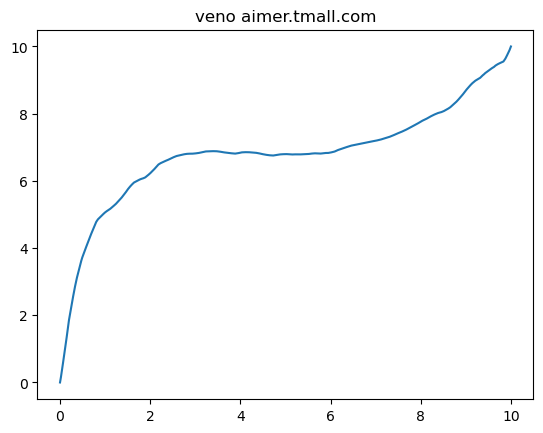

[17.53038436658038, 22.809030607736485, 29.557527600002146, 19.078665883718493]


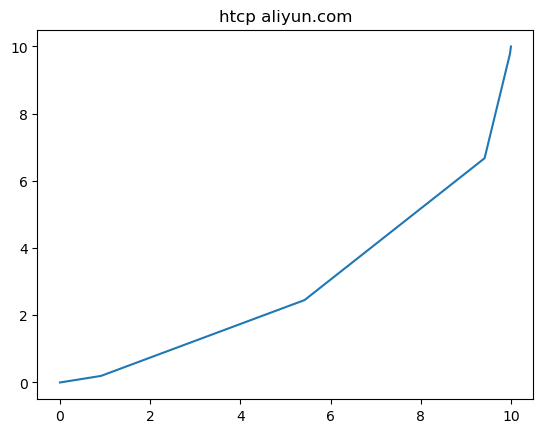

[20.062943606317408, 18.058186119028985, 20.432808564914698, 17.742040881460465]


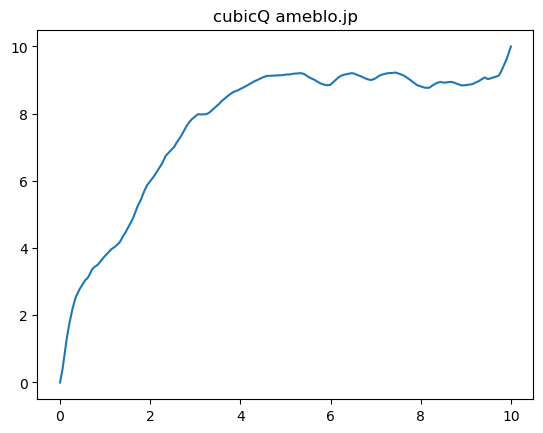

[9.581821017469137, 15.710338376499008, 18.265962349188527, 14.697830802253632]


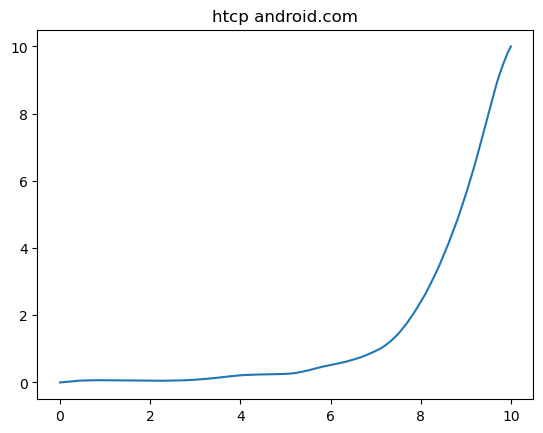

[12.581624135515668, 6.403034563016343, 14.432333634614404, 6.875542693866052]


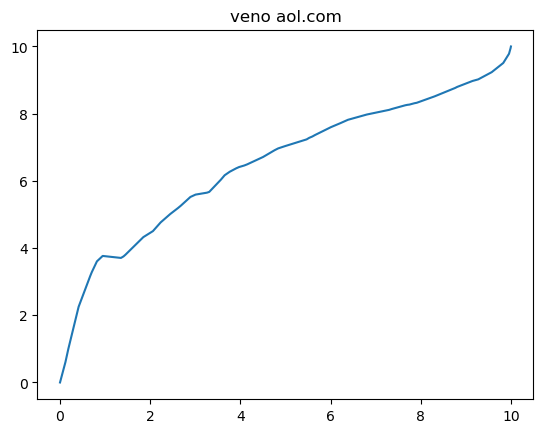

[8.637049487709344, 17.452770833356286, 12.962207729471334, 15.170913950516832]


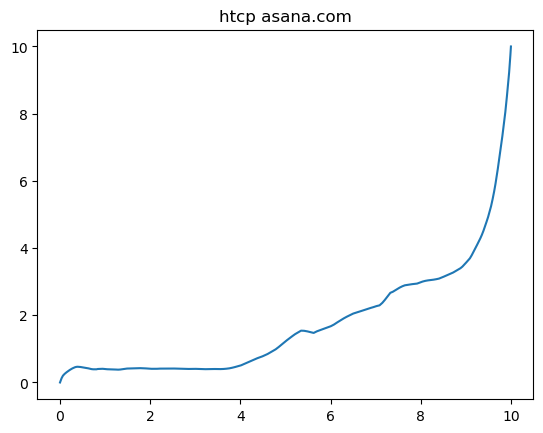

[16.146530213023794, 8.070252014321468, 17.757004847787726, 8.376961247312295]


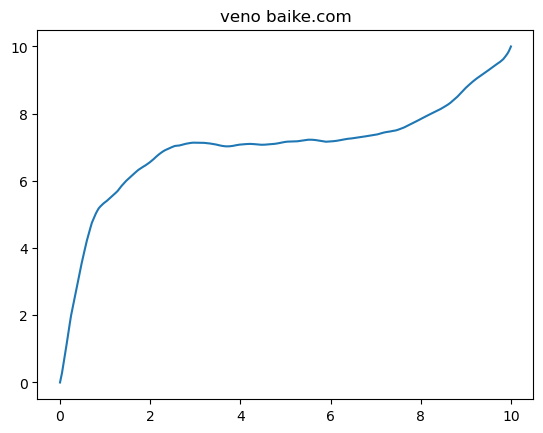

[8.088480984723553, 10.098125616675233, 9.71548976251888, 10.50940245097531]


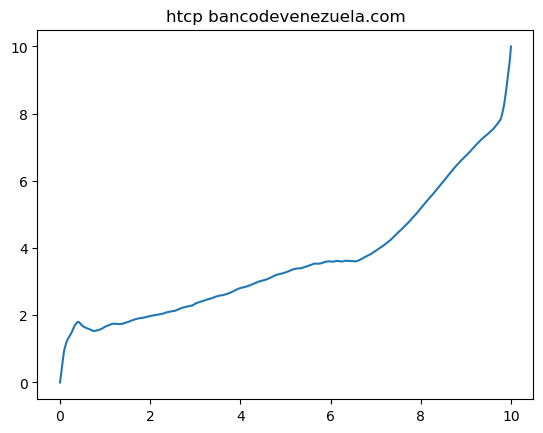

[11.63223797973721, 6.541285312564416, 16.666877110940057, 6.712189438882364]


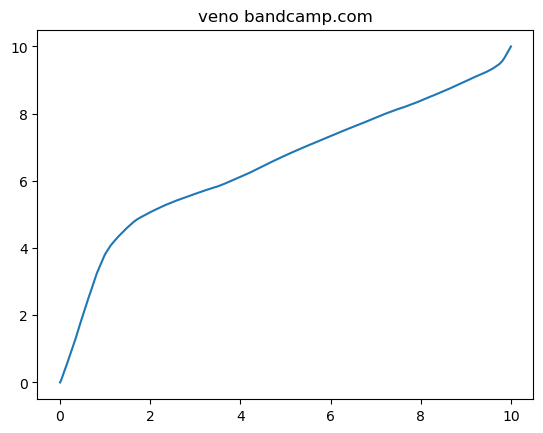

[21.530907492787392, 25.790325013101967, 31.414218787276468, 24.85728762311715]


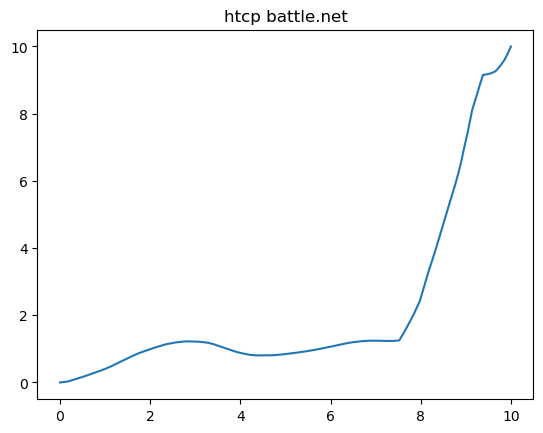

[9.61250782740814, 5.823851466658708, 12.294056729203469, 6.124598957801965]


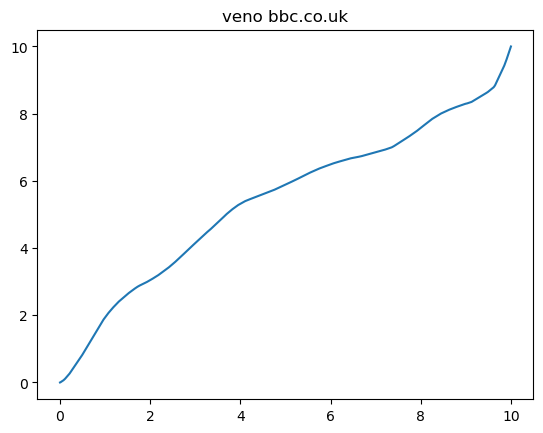

[10.924354833255816, 6.50219681431993, 15.203044686258982, 6.7522442176989665]


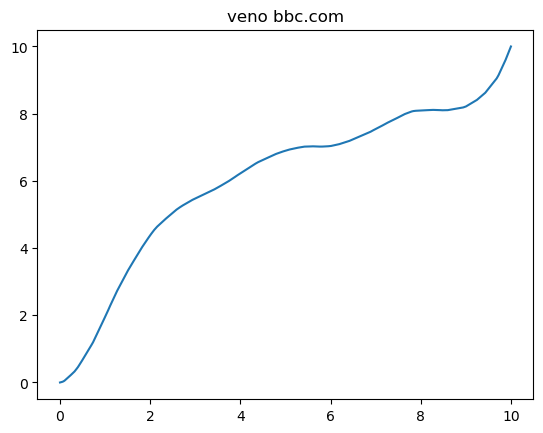

[8.981379520246216, 10.749309153803084, 13.299523643908156, 10.876843890651319]


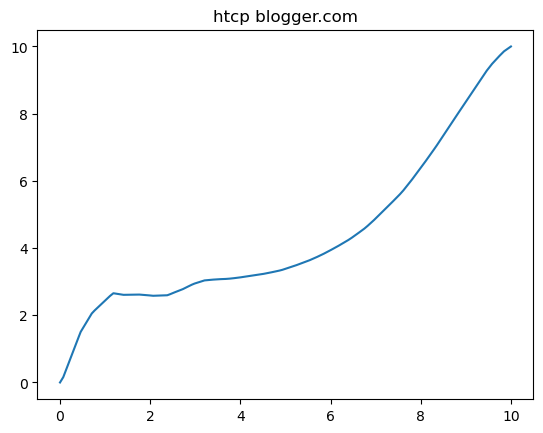

[13.447621261042595, 19.694788216313423, 15.428099939362081, 19.22987428611626]


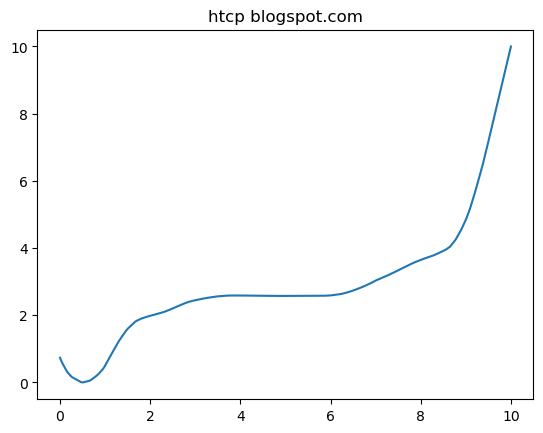

[6.886127477667288, 8.03266747125301, 8.85189947641238, 7.9833478474344295]


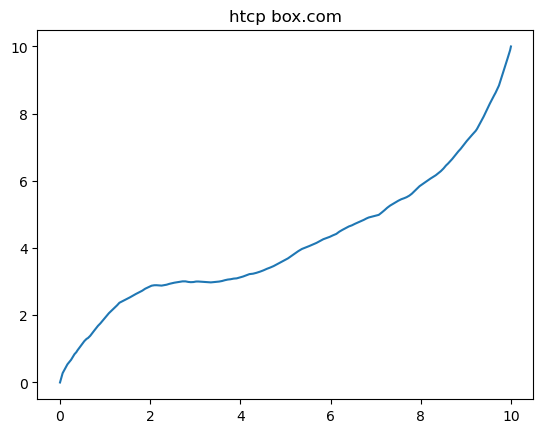

[7.436273708778271, 6.084053772774031, 9.525873275462342, 6.293829912259217]


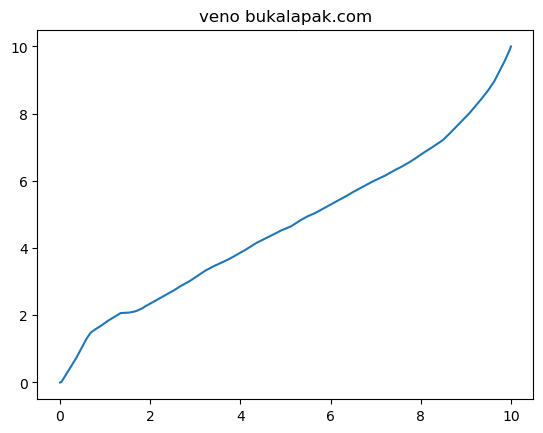

[8.174305177272233, 10.95059554801147, 9.299602890649263, 10.692393181975737]


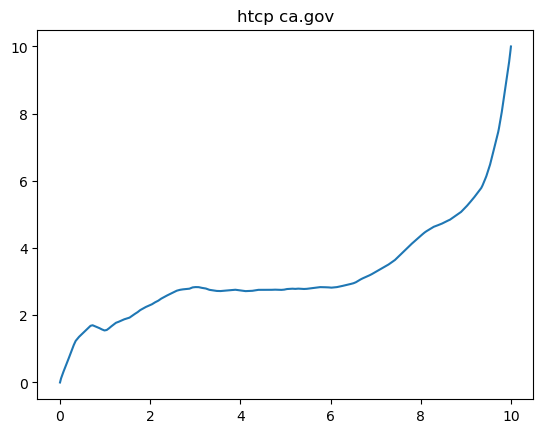

[6.628027313353093, 11.774597382083433, 14.054591103589459, 11.170783390147205]


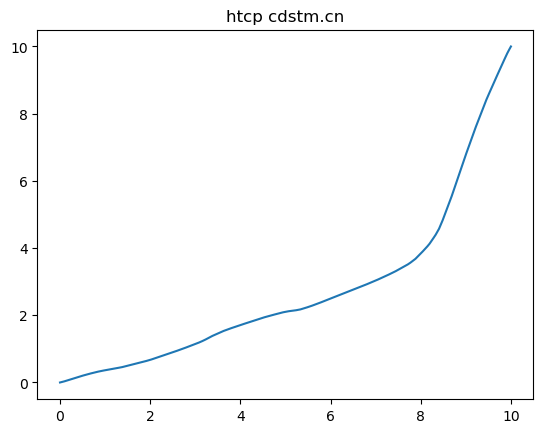

[11.283807617901218, 7.03947235592843, 15.199214839800979, 7.413984583111393]


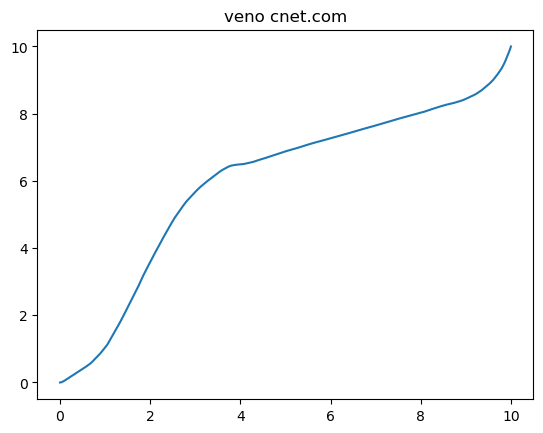

[8.756491717703001, 8.202839627609517, 9.32479894280845, 8.31817070687083]


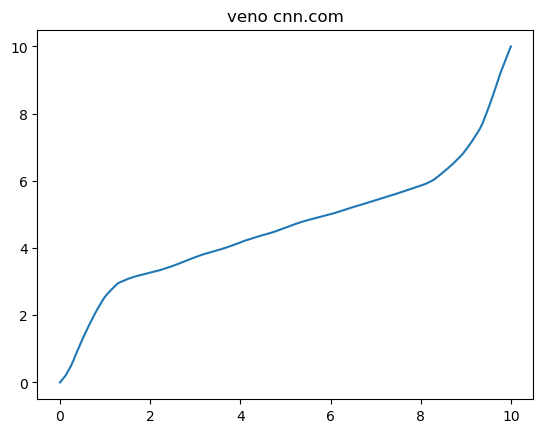

[10.077842611059614, 9.140142018627166, 8.774054310503946, 9.366203917782912]


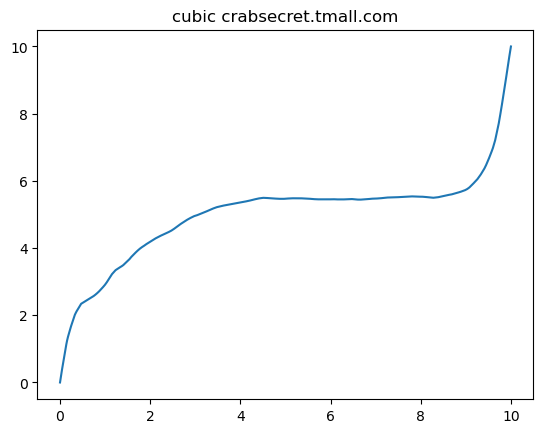

[11.212157890942665, 7.777220953290939, 12.562182619030935, 8.210532548062702]


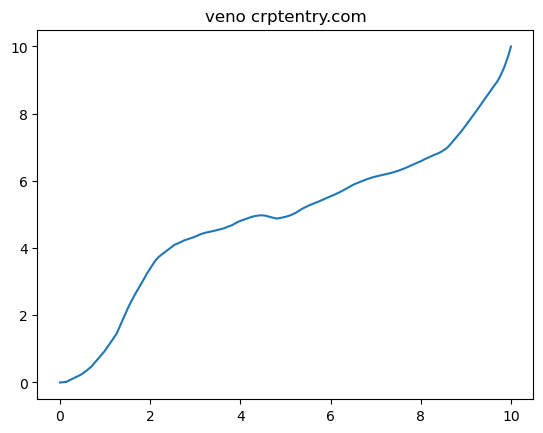

[11.901655339657967, 14.986261439187274, 14.702844951547776, 15.494658220987901]


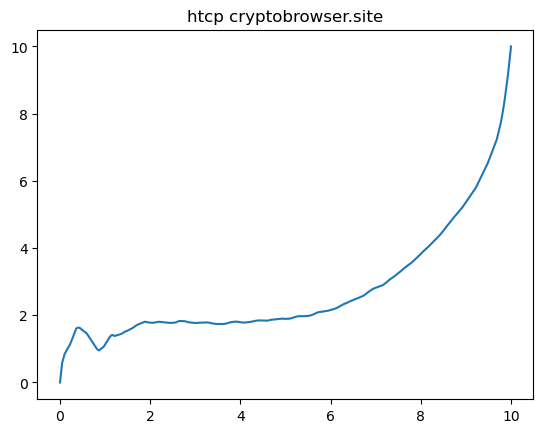

[29.337070522813104, 21.245865150212712, 29.049928580772352, 21.97541386709595]


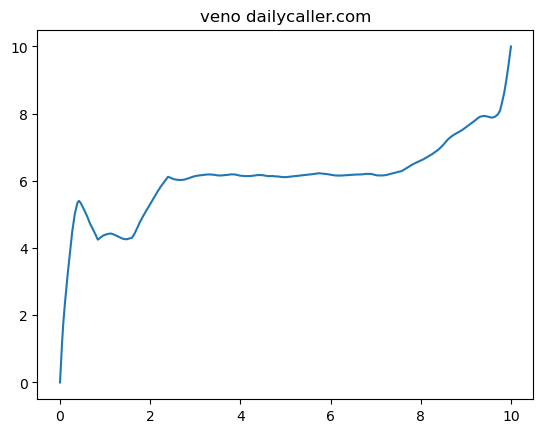

[47.54957561586076, 45.95609027583242, 46.24900841961485, 45.64508839445972]


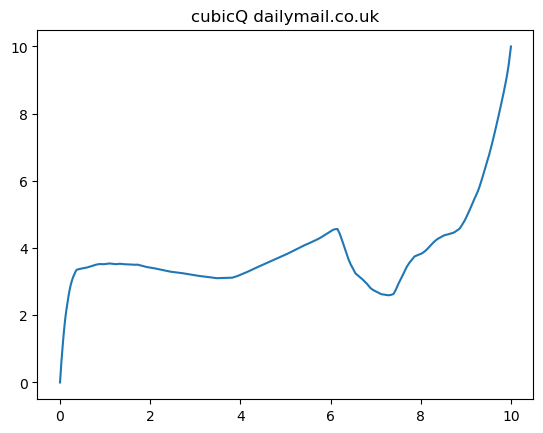

[7.5332813580376055, 10.668615878728298, 9.55699030364824, 10.21529433911493]


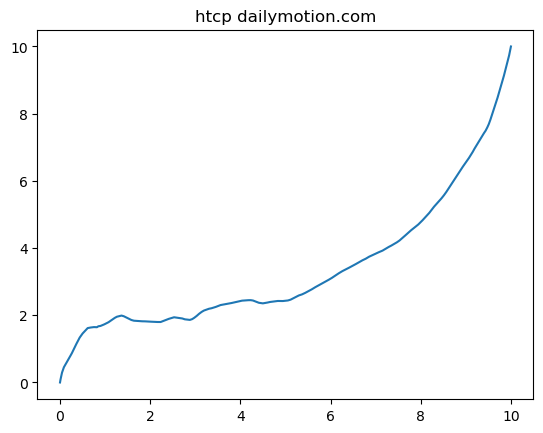

[9.122908820066314, 10.099591587152222, 9.160358306014892, 10.32340756076136]


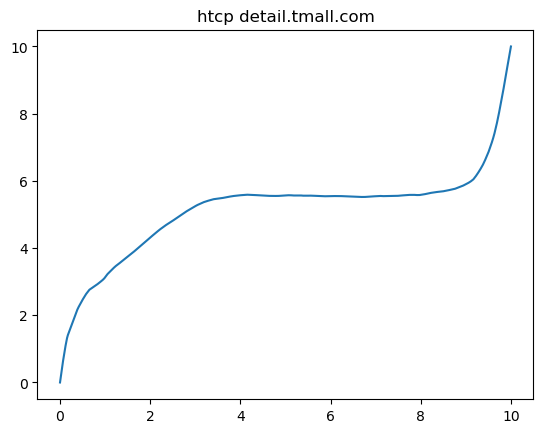

[9.832550076133815, 12.792289157036969, 20.172725791245647, 12.813603648128089]


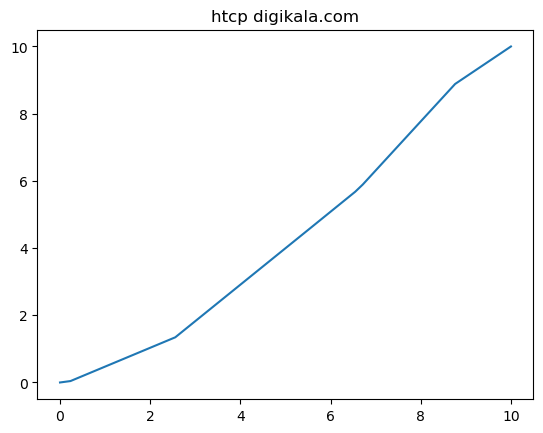

[14.239877784302191, 21.339480477692437, 27.884139707303408, 18.872965469985008]


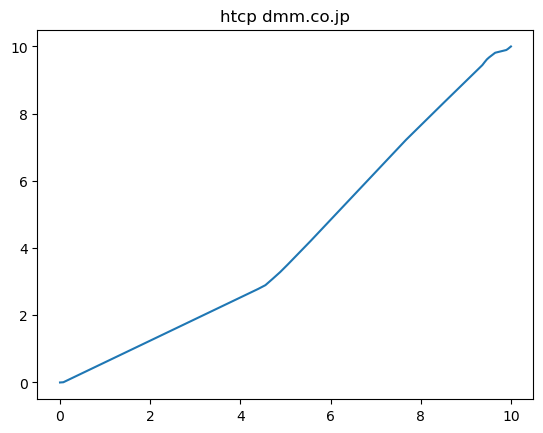

[9.576757512663253, 12.27501087794947, 15.6741703755559, 11.374124572994402]


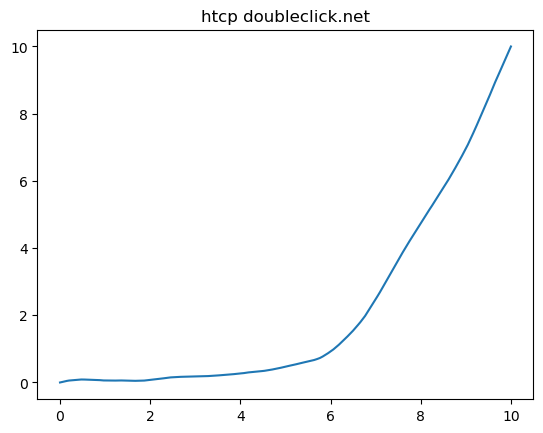

[7.510308133526119, 11.409818311156798, 17.33198077530946, 11.829853016811752]


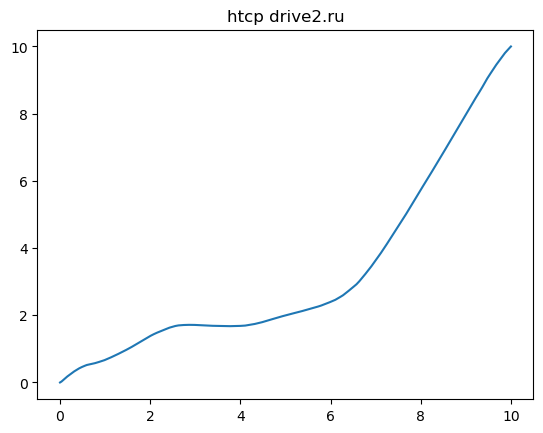

[13.360168056204747, 13.90237406195466, 11.973360009750875, 14.059385147816931]


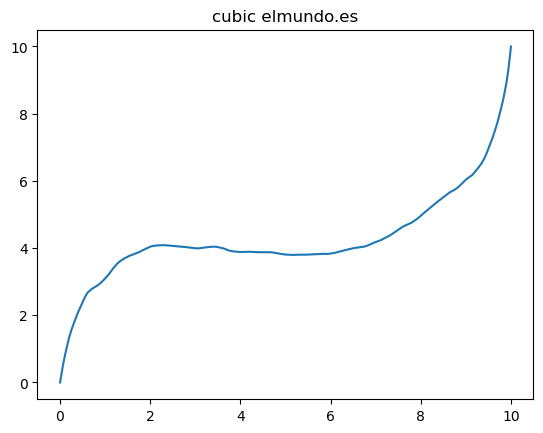

[33.228101149323635, 30.07681903096887, 29.379995309887796, 30.306052721319308]


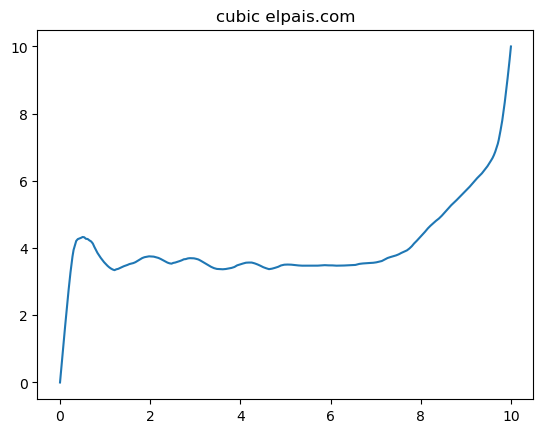

[11.162622656073795, 8.393522868096973, 18.037947137010075, 8.120295411659466]


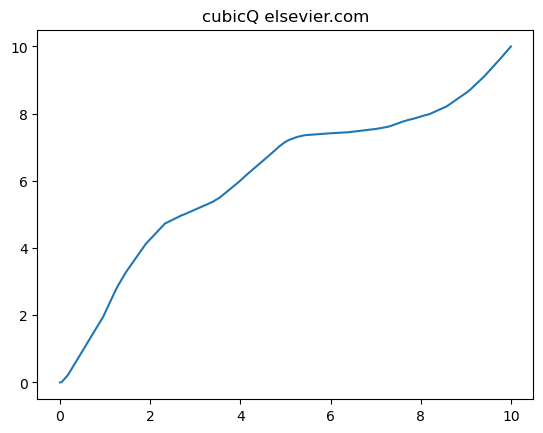

[14.334707679556672, 7.665955429738009, 11.778668313469847, 8.123275717757977]


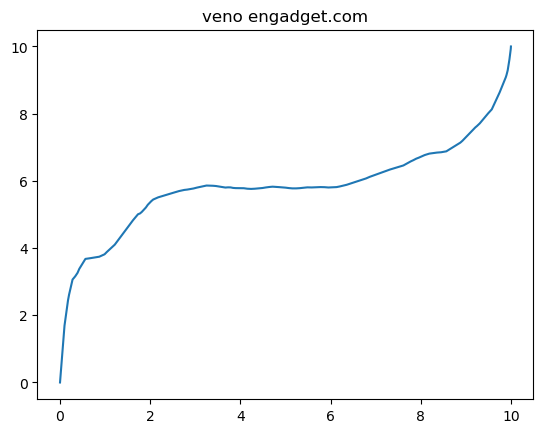

[9.39098748750479, 17.729059348582044, 13.870237087218648, 16.80947667440309]


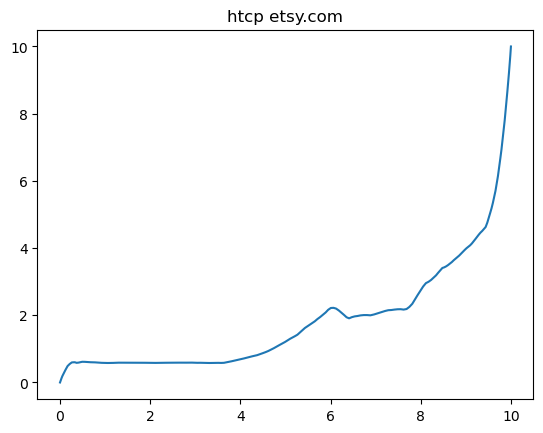

[7.444991417153069, 9.867517143996734, 16.102942122213594, 9.982673427731246]


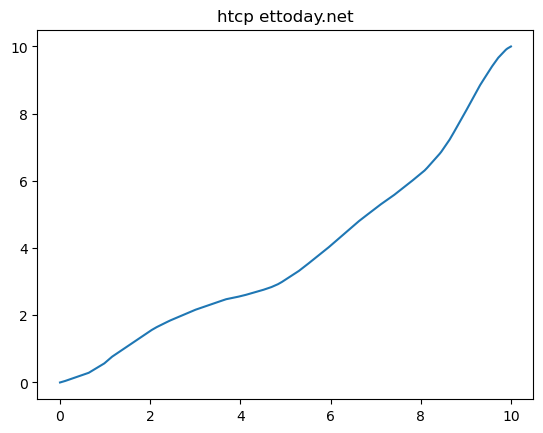

[13.354412838938016, 15.430415021307327, 13.3655763422485, 15.059657667222517]


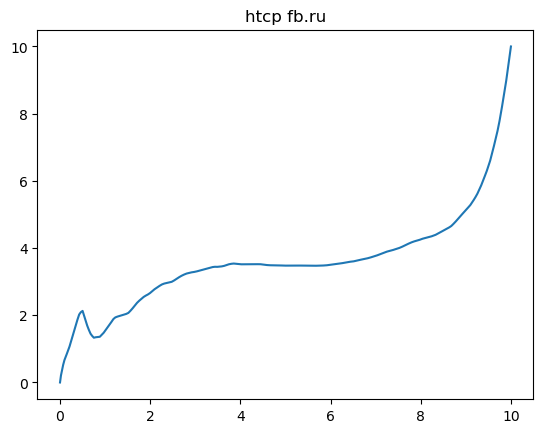

[20.074049648853006, 13.57360999299292, 21.313598868973884, 13.755171305309075]


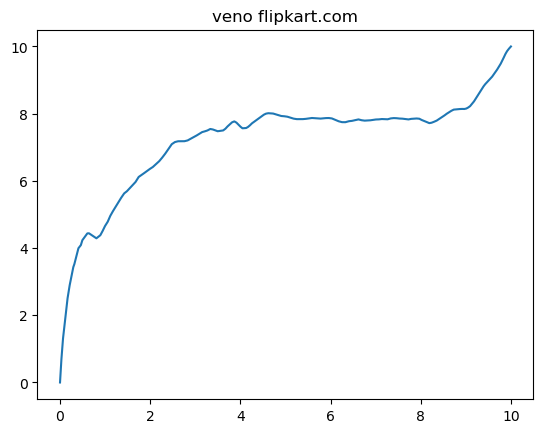

[8.3403341853779, 10.579976598807772, 8.819914723139782, 10.359252862531987]


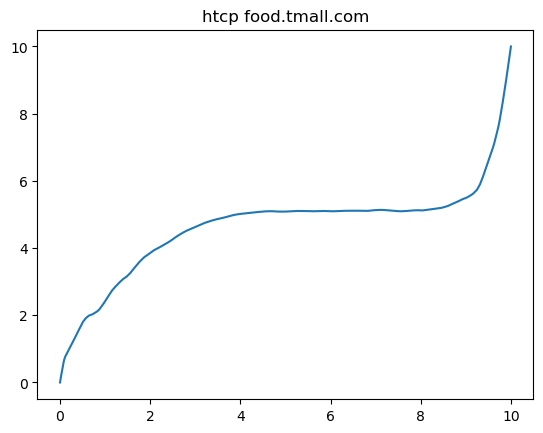

[10.735164538082403, 7.179200399084724, 13.004894949613579, 7.580152142877241]


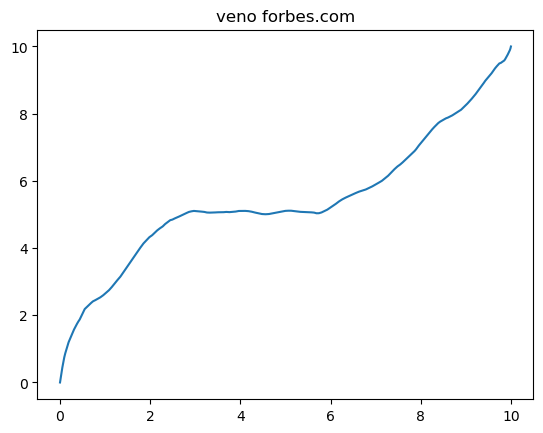

[7.966786807661615, 9.07223925531702, 10.000037319110245, 9.859342061923707]


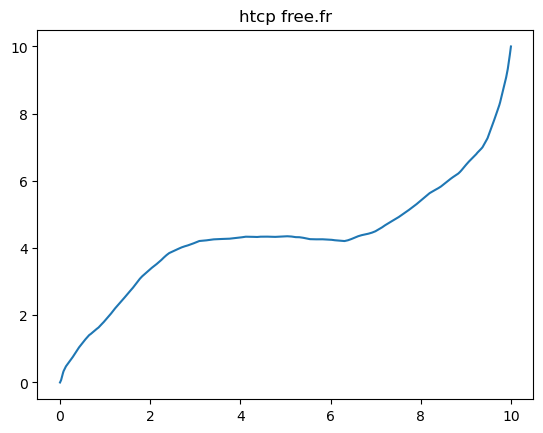

[18.933320494330843, 12.949913161390171, 23.7200996244581, 13.088245132779358]


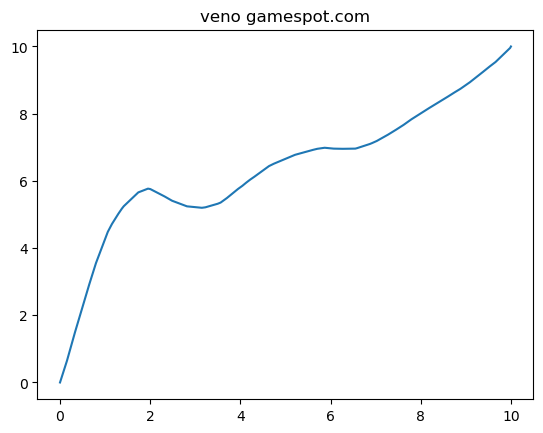

[7.018087252100736, 12.716369777986715, 11.353384979881548, 12.237127354291973]


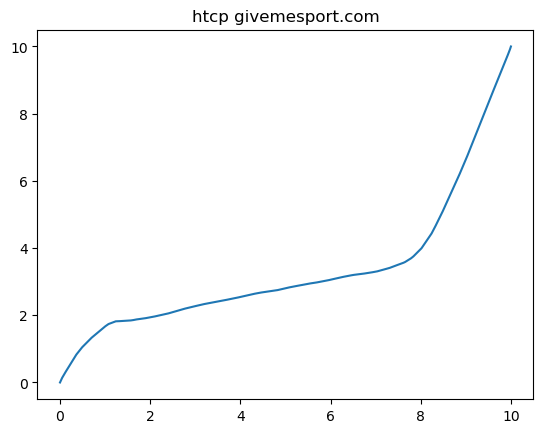

[8.273116051451435, 12.17616607997125, 19.57249110061714, 12.246545021492615]


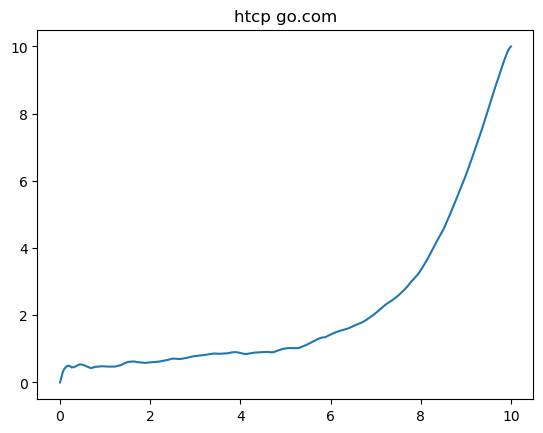

[7.215320335955658, 13.919654819339655, 12.835180508577865, 12.90464392532321]


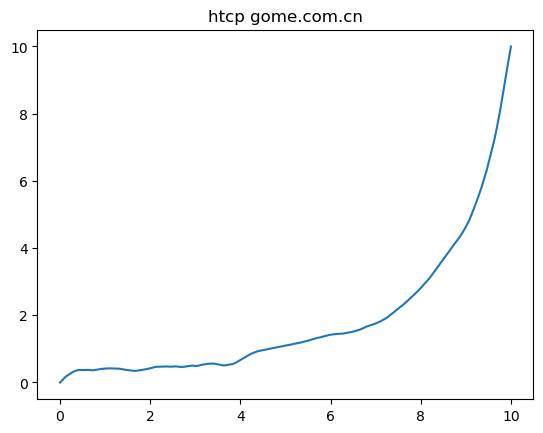

[8.03535438819074, 12.181331859964322, 14.470008008740674, 11.718590935630868]


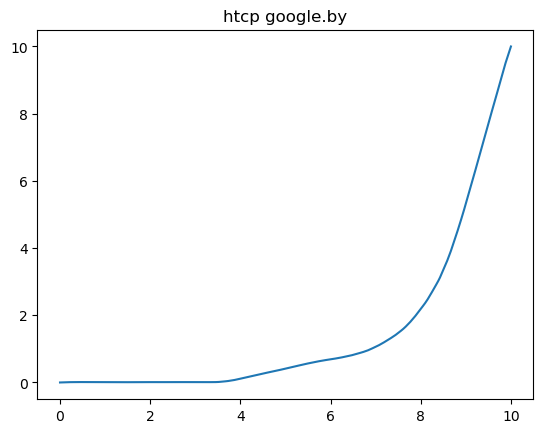

[10.25898683998077, 12.980600190792416, 14.998442265525116, 12.455410876167655]


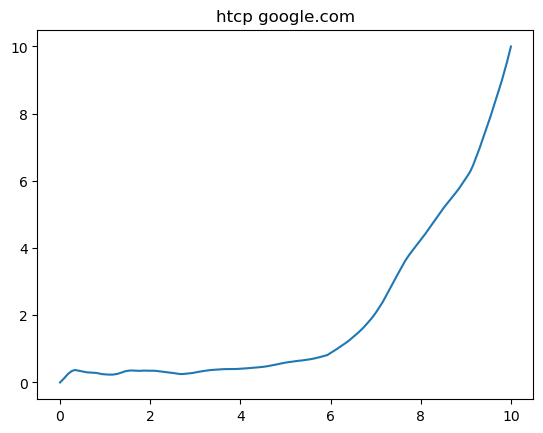

[11.727694469967584, 10.680808699744752, 17.717589548276777, 10.599396262997036]


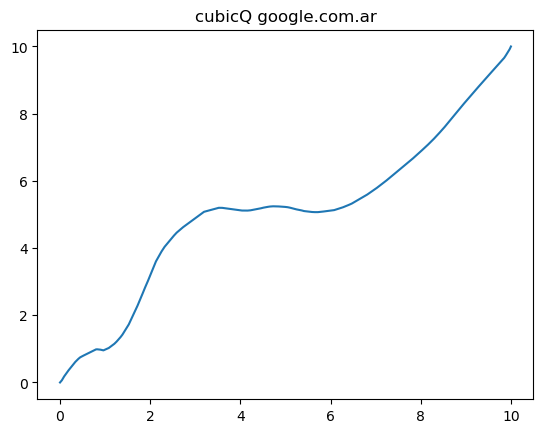

[9.55838367037077, 14.766318702351498, 20.671505759667482, 14.221157443403925]


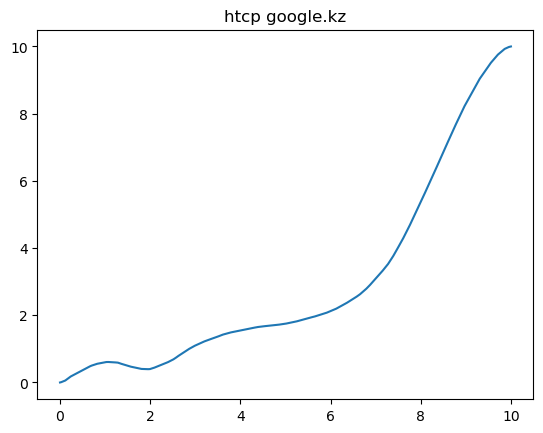

[7.850557991877047, 14.56468356863791, 13.92969502647155, 12.141849552914042]


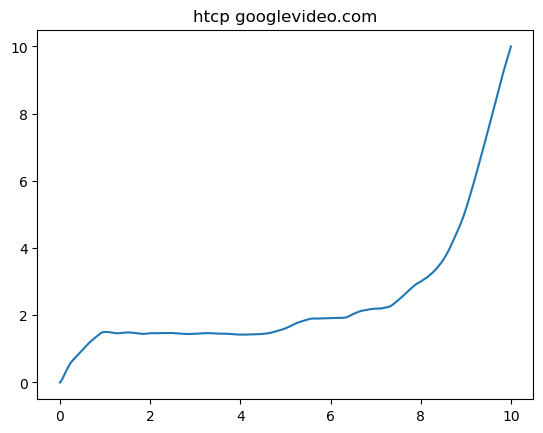

[26.7218833872109, 19.45908068469058, 27.11547257288784, 19.823386134955037]


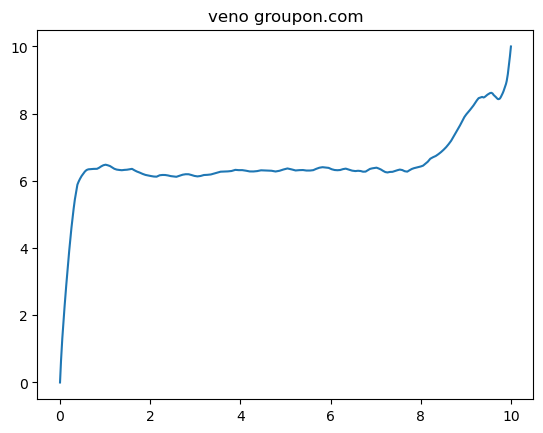

[17.030011643873408, 19.18659260741738, 31.280045310385105, 18.613984285875976]


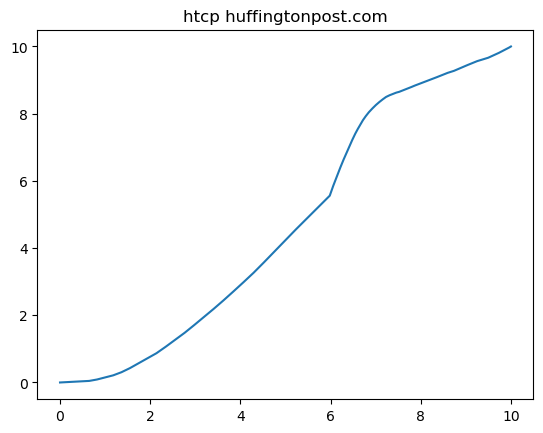

[16.33857721916241, 9.596511213524044, 19.56244982040792, 9.43662549903894]


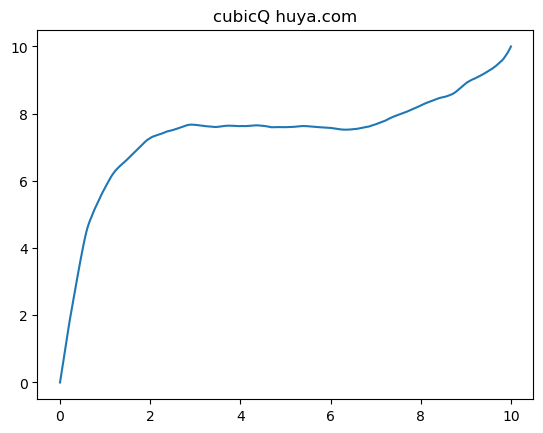

[15.683320583317549, 11.8515108154808, 14.248643162768674, 12.043939655397562]


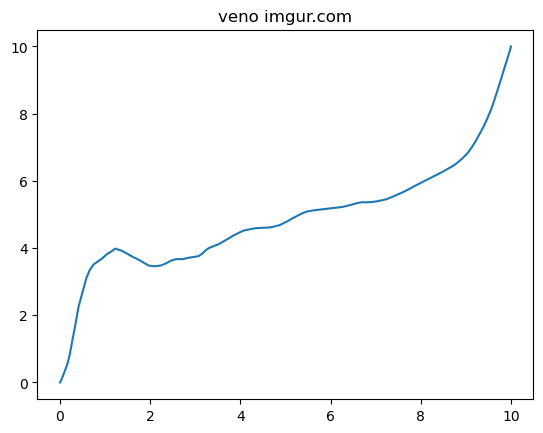

[11.668078057732899, 7.006011948708955, 15.13777084315348, 6.878098890549968]


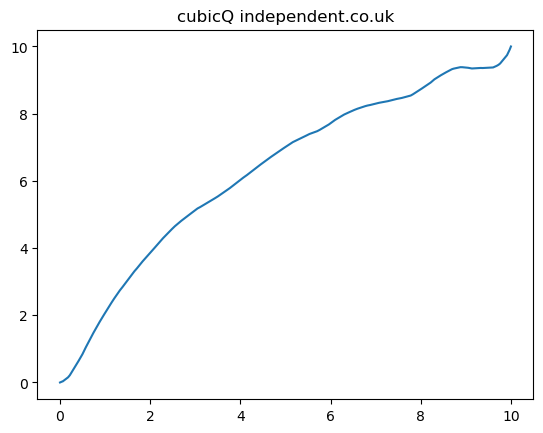

[8.92892272549767, 14.65849549887696, 20.39236845106773, 14.11354860984405]


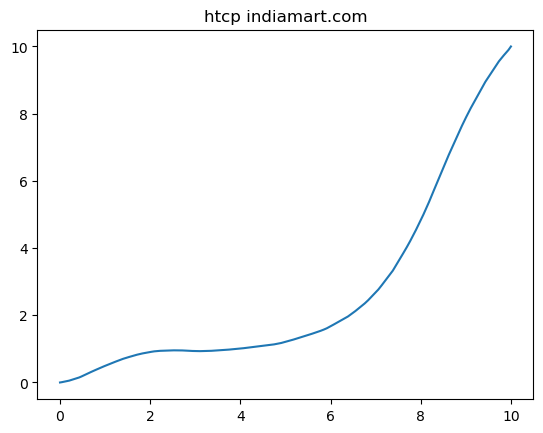

[93.15340768285103, 96.35907973653181, 95.17664692936671, 95.85885082883318]


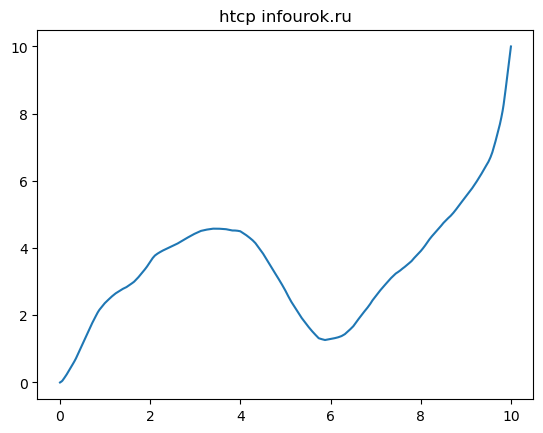

[9.452965654094331, 6.846717371967075, 15.556599525554118, 6.699042943216571]


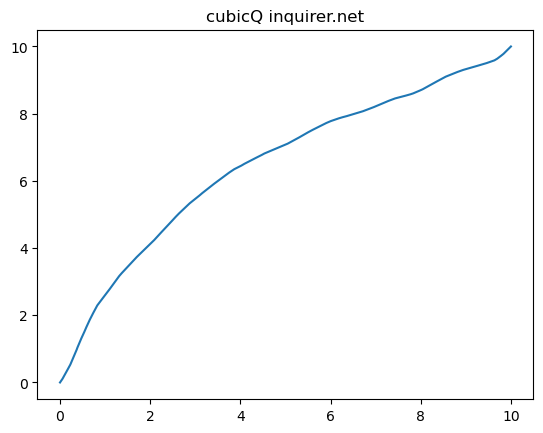

[30.168991636601103, 28.145825083696167, 29.872972913589663, 28.036003322486312]


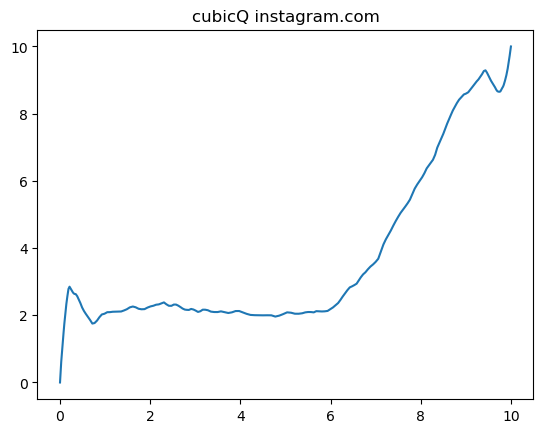

[49.50225404659992, 53.42801885129263, 52.57381479041879, 52.76033069876625]


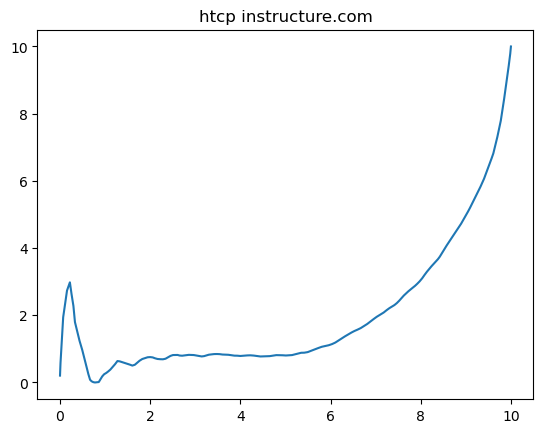

[7.834380906404692, 10.986890850919805, 12.474998331795861, 10.931426054083458]


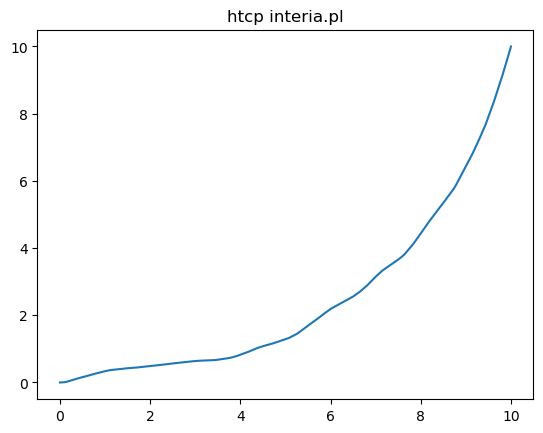

[19.147936034285458, 22.738652490002096, 23.53218017316251, 22.248202160634936]


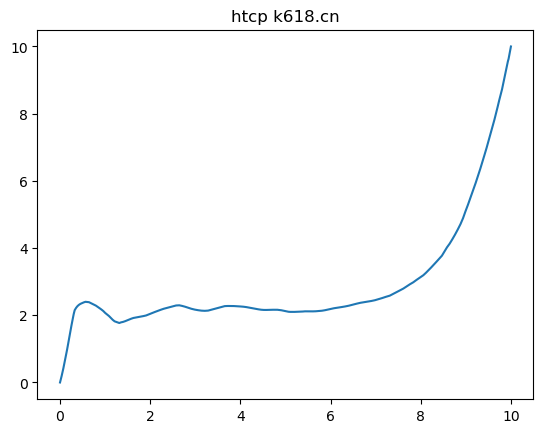

[8.222223456103329, 8.605988605496837, 13.59172550216314, 8.64511574568623]


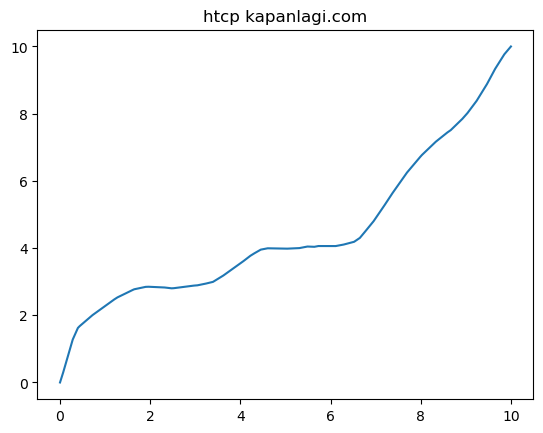

[11.83411695832463, 6.514360489686968, 14.97784118030815, 6.379324178443596]


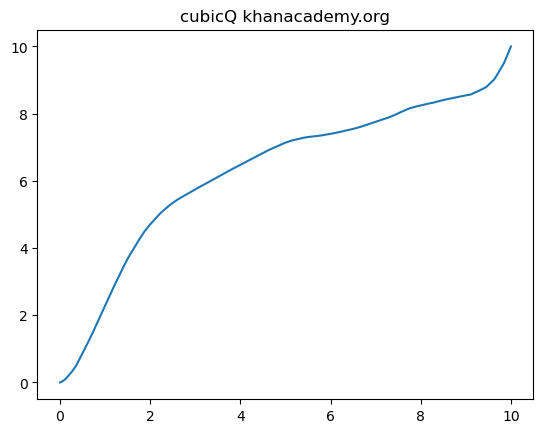

[23.690181236658763, 18.75850911982383, 31.47972969434993, 18.966033092218836]


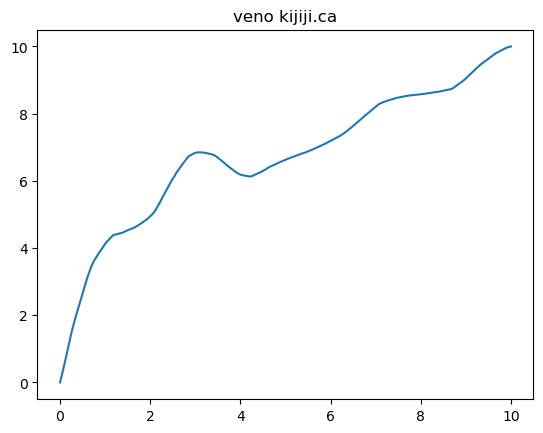

[7.730647216515741, 8.790216864695601, 10.62467864815179, 8.456750058022159]


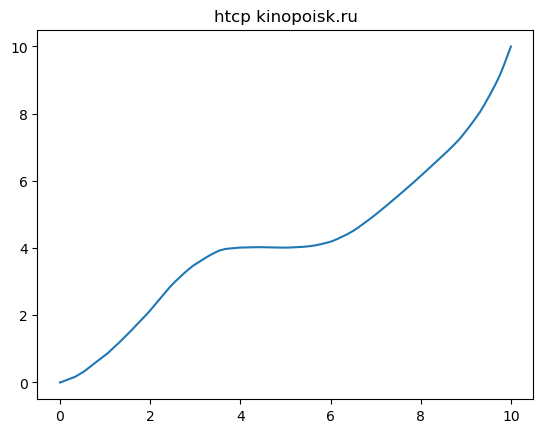

[9.992372143005264, 12.948866766472088, 13.468207214039309, 12.022684513320248]


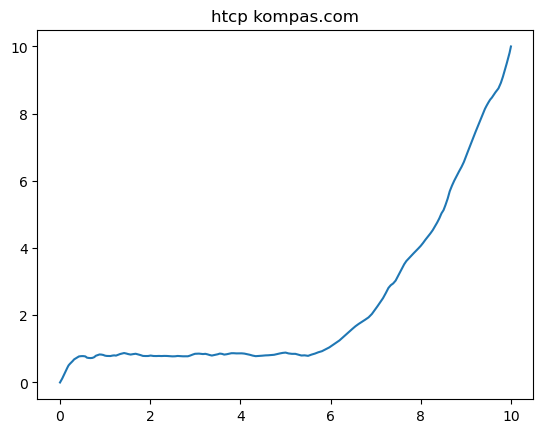

[8.103071333698296, 10.05818398351738, 8.346305174706291, 9.707742926313927]


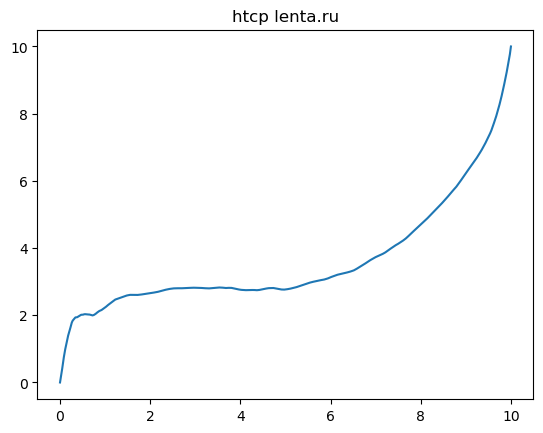

[7.561372387327193, 10.18065481297707, 16.041199719200087, 10.064431767105212]


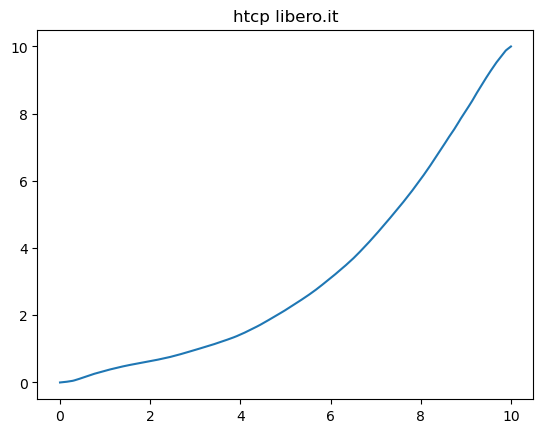

[21.001081258248856, 19.583022748072825, 21.00762918591869, 19.220886077345575]


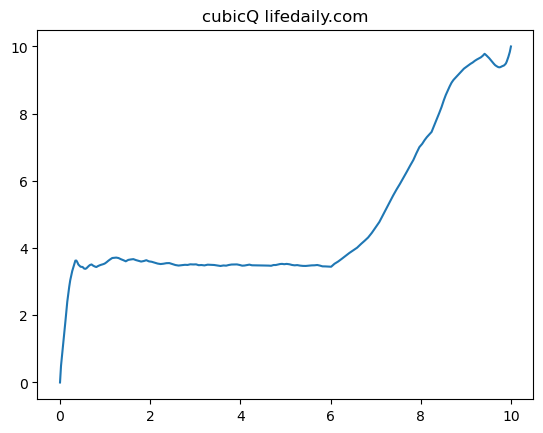

[17.295944291743883, 17.178365447759806, 24.976854009991403, 16.312108681188494]


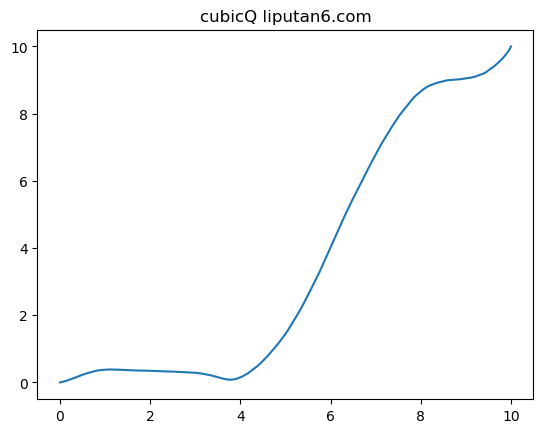

[8.973938335363409, 11.23197740270036, 8.797220665119209, 10.470422936149932]


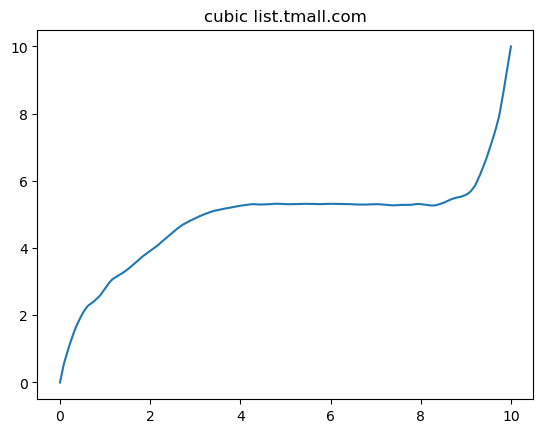

[70.2629780006874, 68.0064215716464, 73.17692816190157, 67.99586452890779]


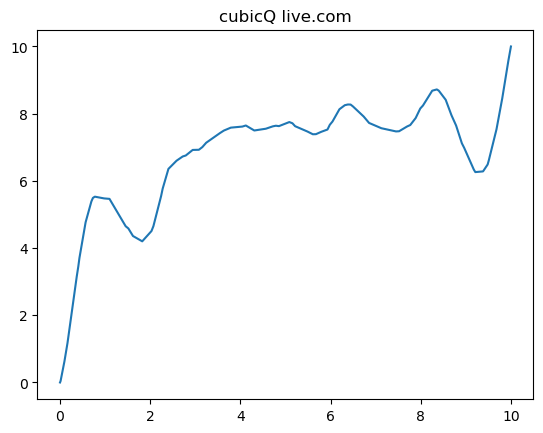

[18.810139060633944, 17.755524831287275, 16.613638956304523, 17.614911459915202]


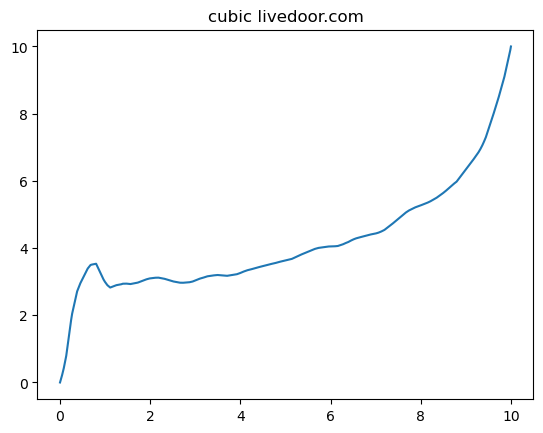

[15.914616997296164, 14.006145815971381, 14.757476040932948, 14.272486383655293]


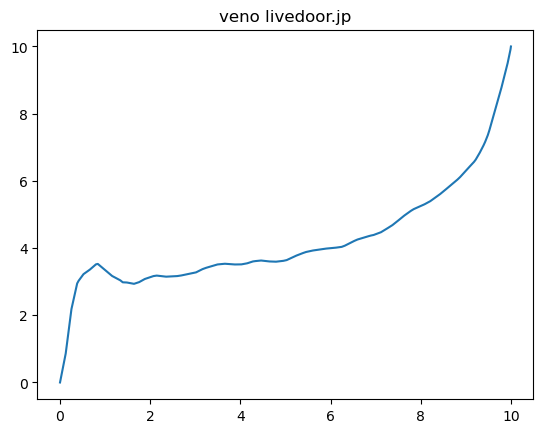

[50.90071163331979, 51.64909743435578, 56.54471889931786, 51.69158821372962]


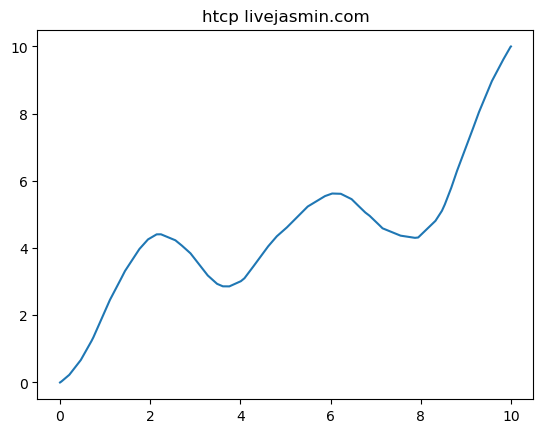

[6.948759497110784, 10.973909447306276, 8.924333308234054, 11.001323335328019]


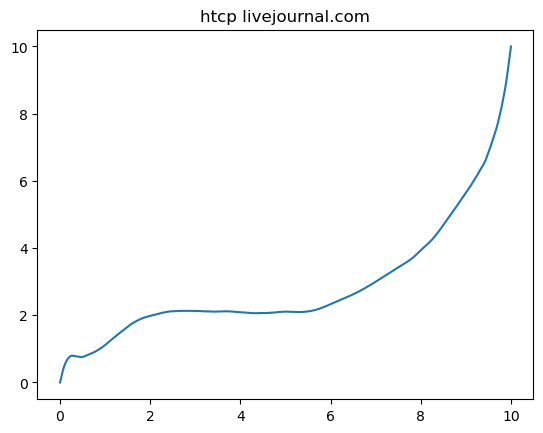

[10.938934302882299, 9.675016708834002, 8.467076275209429, 10.217553259324877]


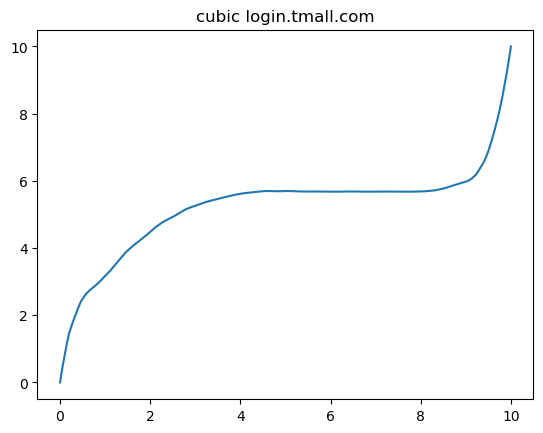

[15.11071920076989, 17.146318767501242, 15.310478612394128, 17.008962208933852]


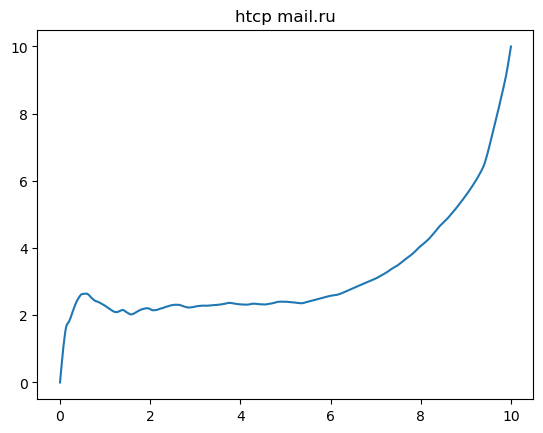

[31.77948324246073, 33.05347361908214, 39.5598557680492, 32.866575559976496]


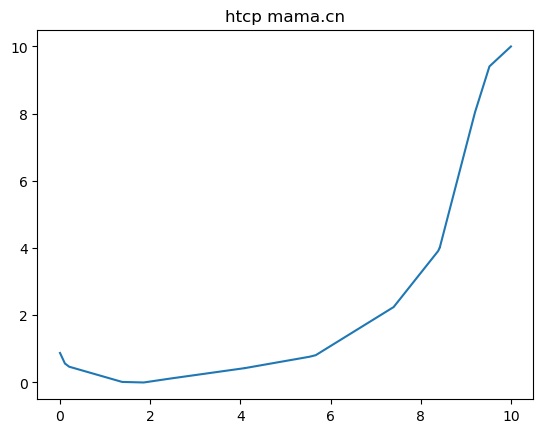

[11.592842269016469, 10.484909458891146, 15.523005779590642, 10.219907069202415]


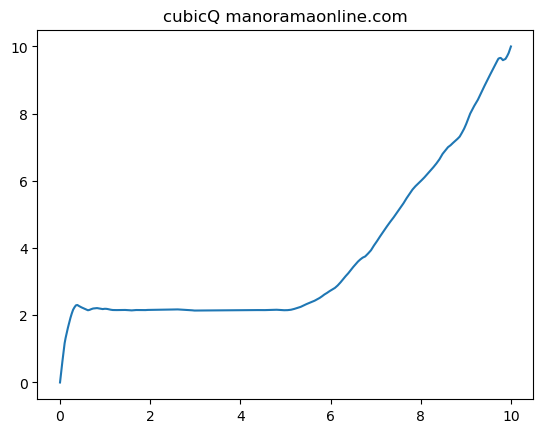

[8.5725937029565, 11.301337849413136, 8.301519423528402, 11.063939169018568]


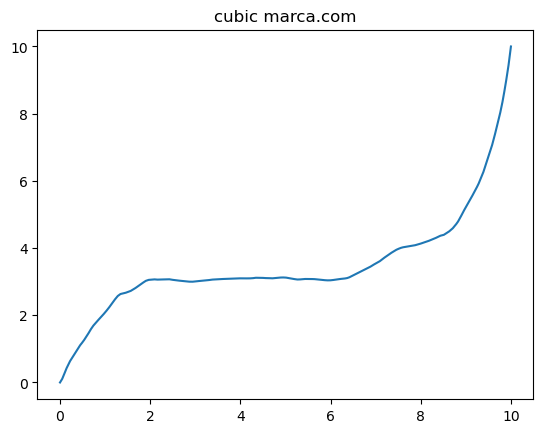

[9.475710906739836, 10.015674432136592, 11.822547715837986, 9.749449187153635]


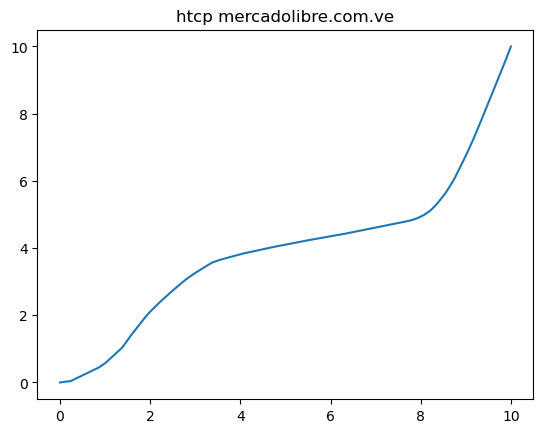

[11.045028211304235, 10.373101628707081, 12.098218418405821, 10.505529356633469]


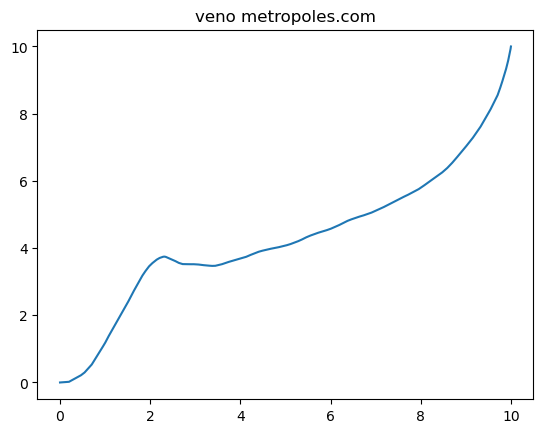

[17.226065279428177, 8.165471738541871, 18.475114794673196, 8.546904898362376]


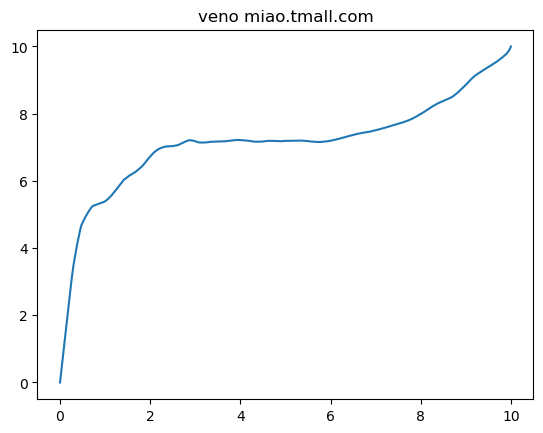

[42.41480280949895, 38.43098567334155, 45.83245791232802, 38.52064689244624]


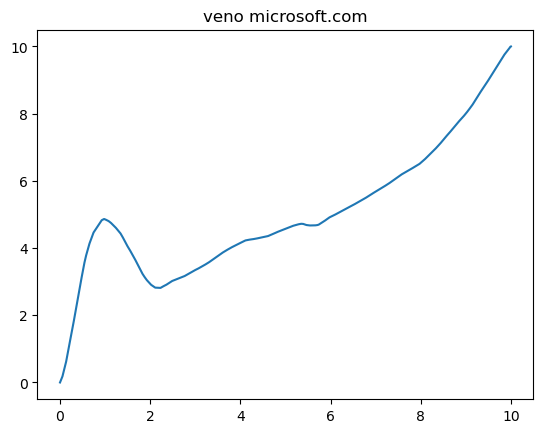

[11.165637377423044, 15.590320342981471, 15.442361994179489, 14.389796126621178]


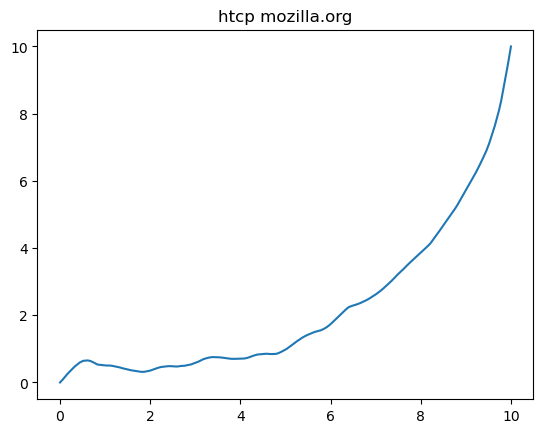

[7.443878303612796, 13.925948335145751, 10.6608305778832, 16.216595704655273]


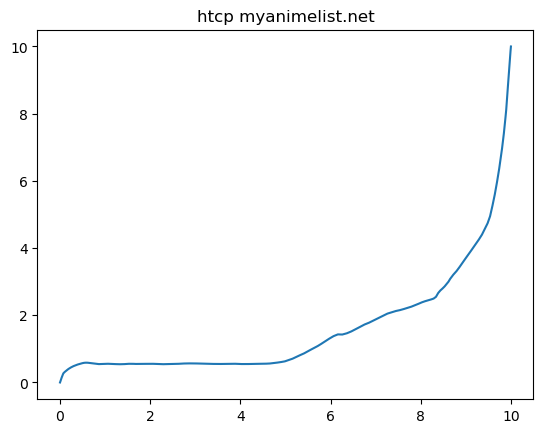

[10.378490407244973, 10.527109148382205, 10.704785795105666, 10.907044610895838]


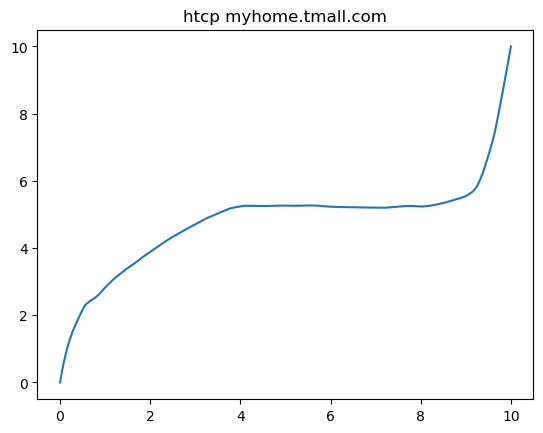

[12.36014828119816, 14.830991650700707, 18.18446238209288, 13.846015802650875]


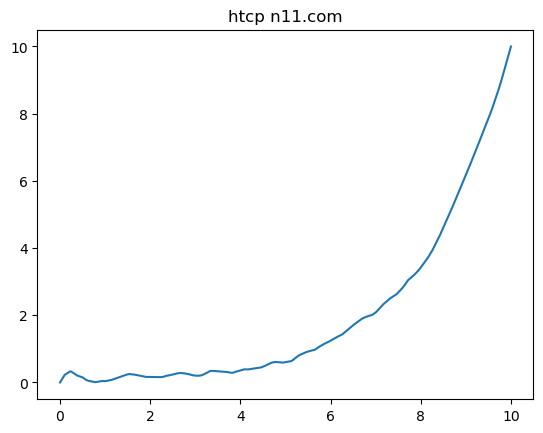

[11.003944876605665, 13.406018671058558, 18.834065298567616, 12.213021012672835]


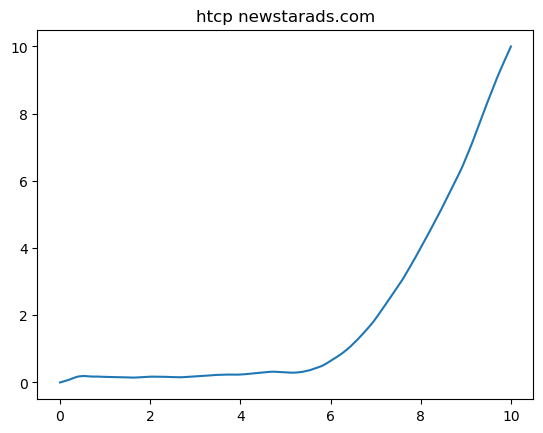

[9.17141493377993, 10.055733937406385, 9.09446428506462, 10.301701511850824]


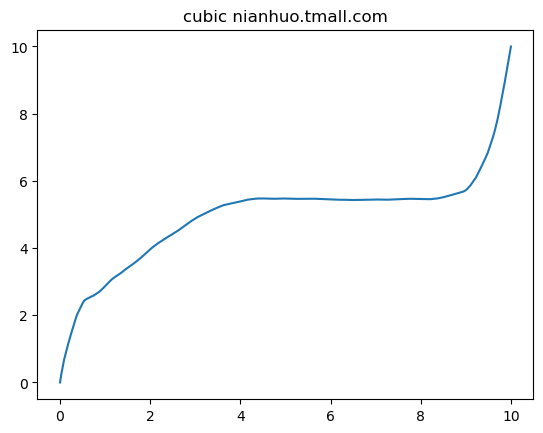

[12.366172190406962, 12.672675376775224, 10.382459573569454, 12.923779277313743]


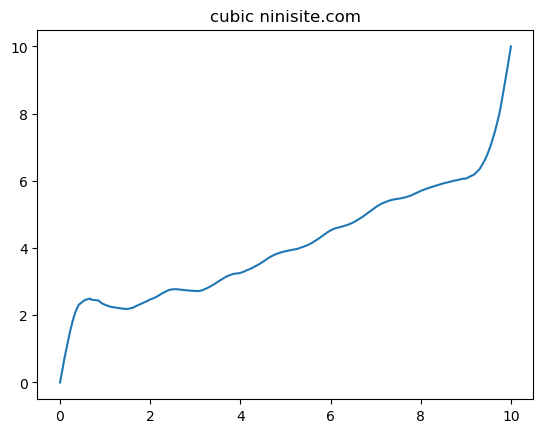

[11.517316417023698, 6.58378163033013, 9.646055547267283, 6.81327452752047]


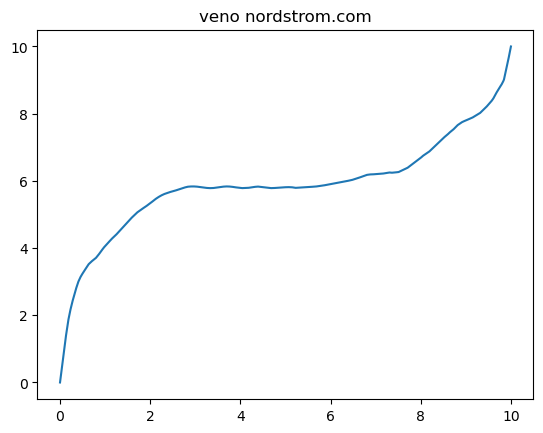

[10.104154370306054, 10.042575078911204, 8.872977442809741, 9.945219765318438]


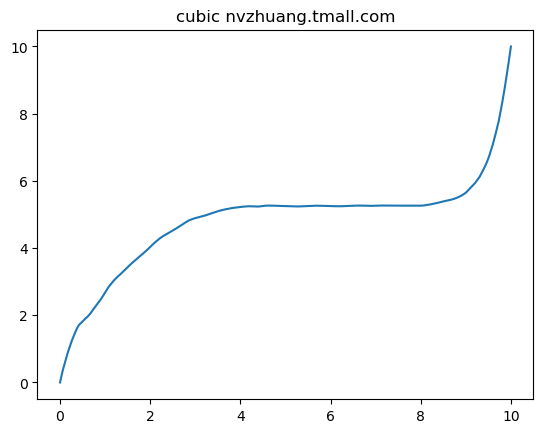

[8.684345184241282, 11.471227769994538, 12.989432157801442, 10.756088761861363]


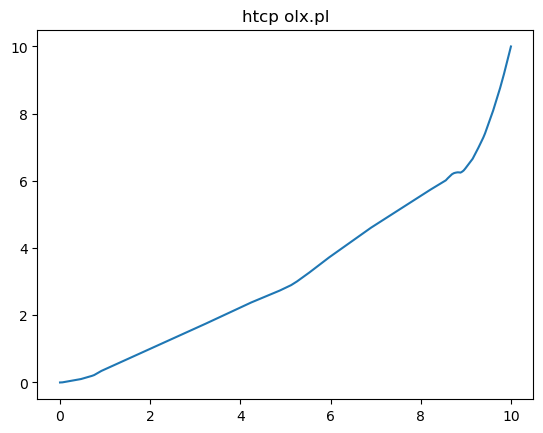

[12.211724739913548, 12.549964992064742, 16.94801960908545, 11.863791208267692]


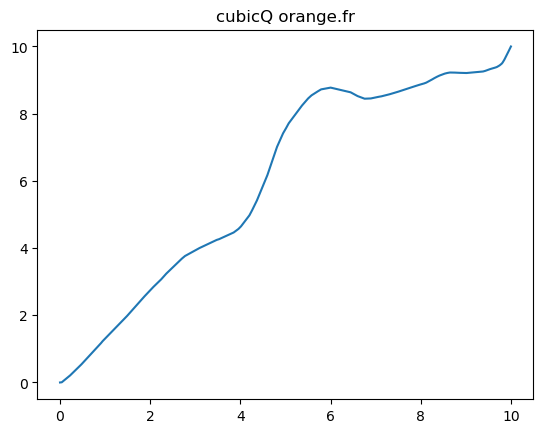

[8.886953990608468, 9.873152486480857, 8.823212374828916, 10.296400163413098]


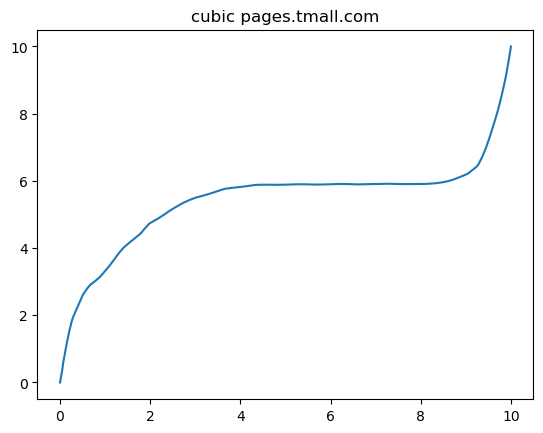

[11.31742554847149, 11.476946137819741, 29.317858377023995, 11.459839520643783]


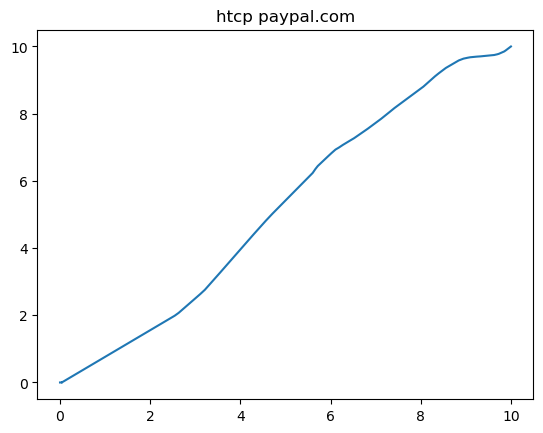

[24.571461687185312, 17.747814551077532, 24.112686800831778, 17.587255639033277]


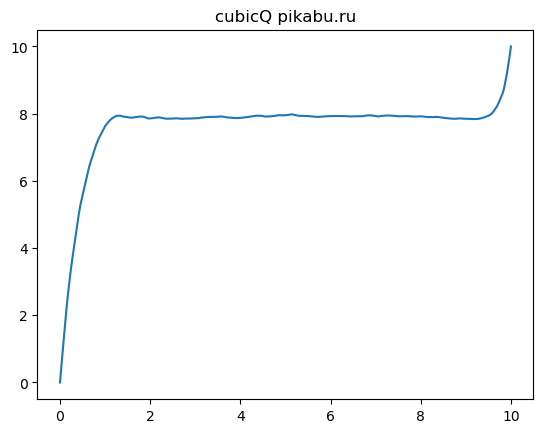

[22.481096415807272, 18.108126865647726, 26.58644811285545, 17.87070957855805]


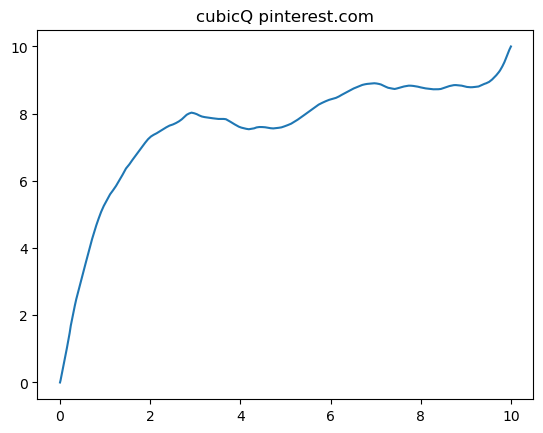

[11.24381975658627, 8.83162450777614, 16.848613956212027, 8.085478209706137]


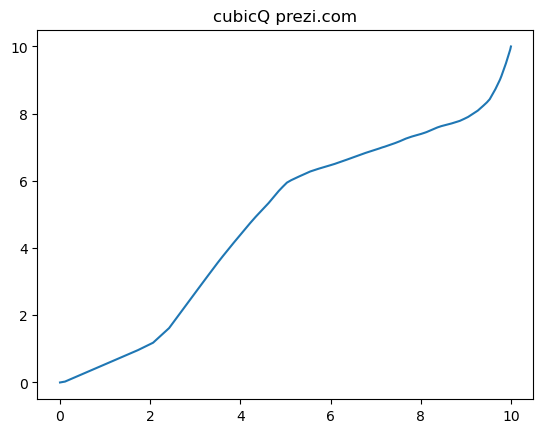

[21.244930354487124, 11.52299287292475, 22.817764116686604, 11.808731299890317]


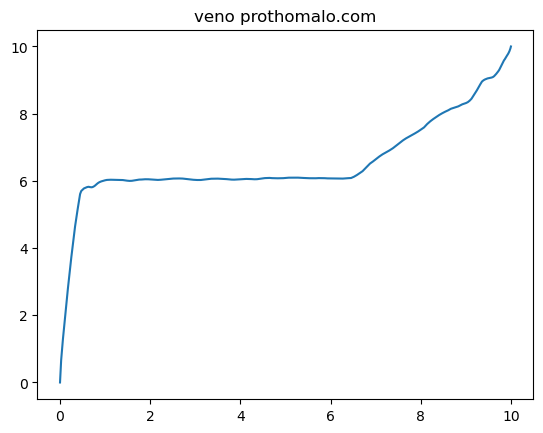

[14.335740741468282, 13.011605082553166, 26.27110877562304, 12.322230659868342]


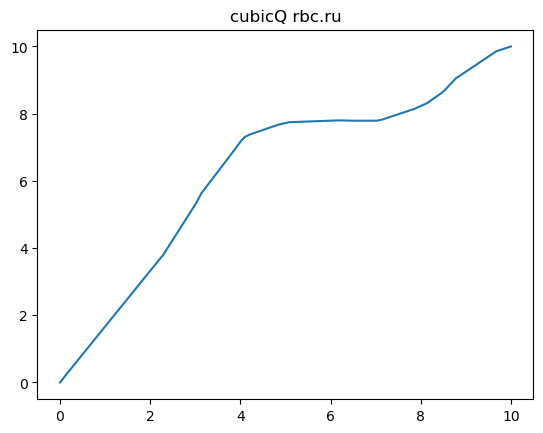

[6.752017244418345, 10.25116744872188, 13.1830382403934, 9.378301457391222]


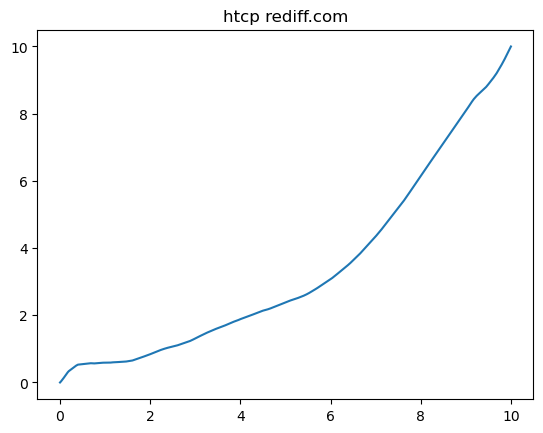

[10.546683107555348, 13.102559364590004, 15.490856734715841, 13.083973911265318]


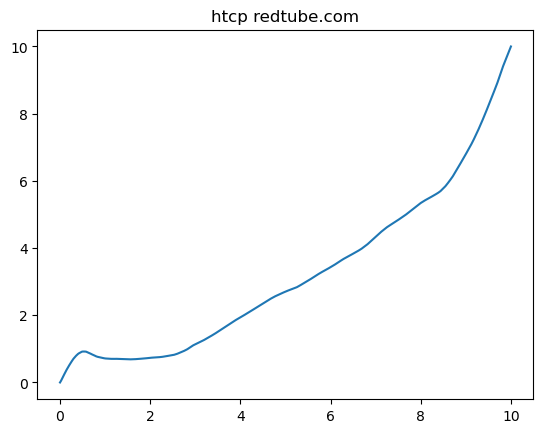

[7.085662858861656, 10.173442158095906, 14.573895261852604, 10.022972124024637]


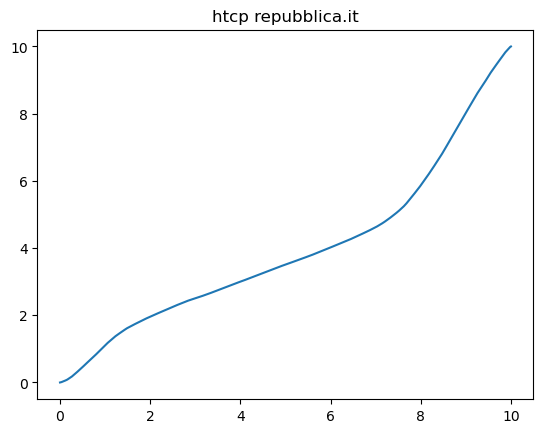

[13.11898457629016, 16.141187612402007, 16.827244709214703, 16.10926885932532]


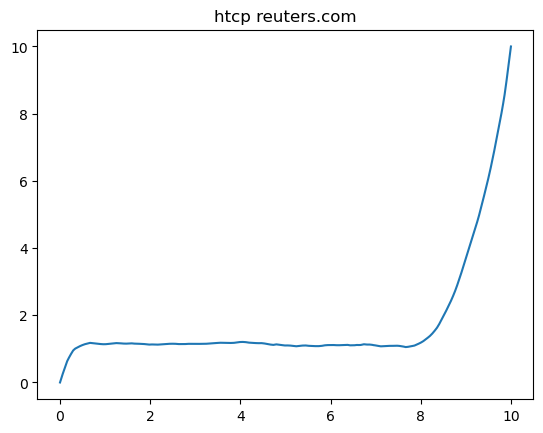

[15.182129914222616, 8.827184275435684, 15.700456489546267, 9.519321790960555]


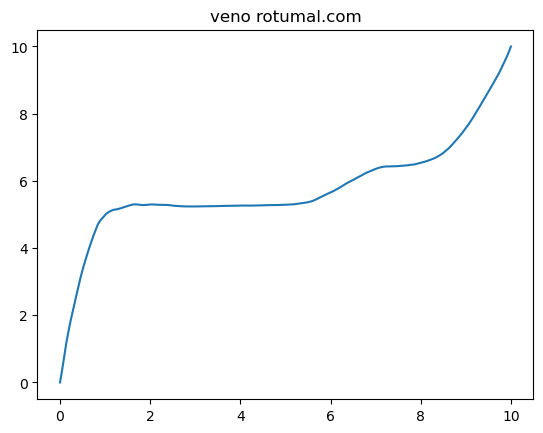

[7.114094386739937, 12.956487444952327, 12.584381987614911, 12.516890673317032]


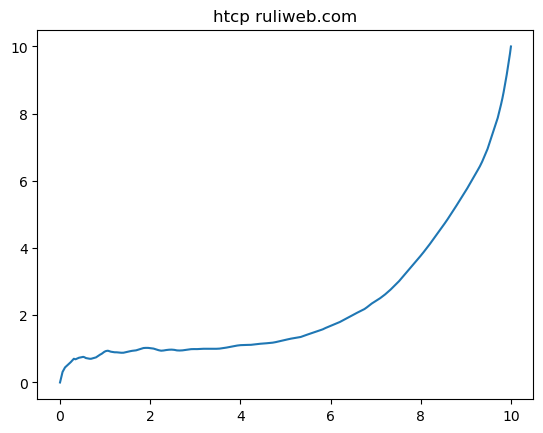

[7.210654164578081, 10.299665795431718, 11.49684243224736, 9.803953858833578]


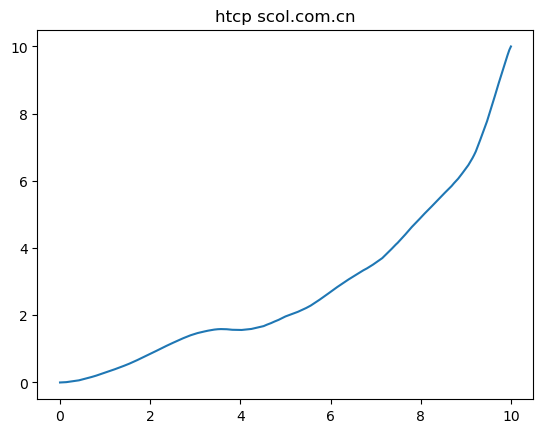

[12.411609141611605, 6.710655048646203, 15.030517613213645, 6.52330707240824]


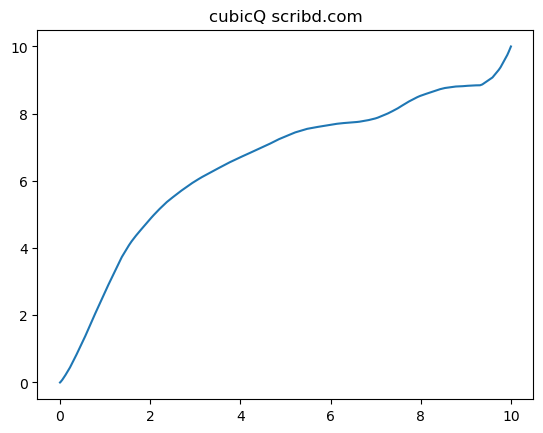

[11.374175997677076, 14.102176584574265, 12.875412642973062, 13.949957656951856]


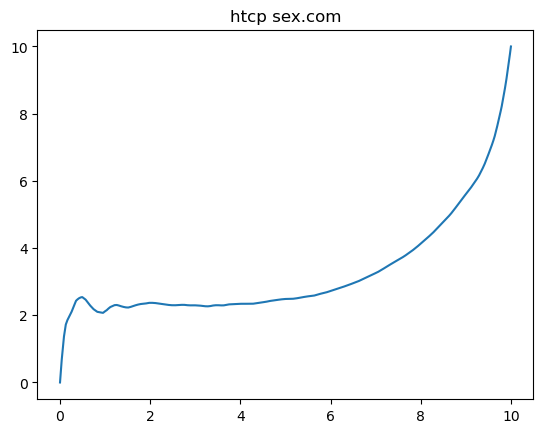

[10.330140840023775, 7.326095788451153, 14.96457354967586, 7.218780517227607]


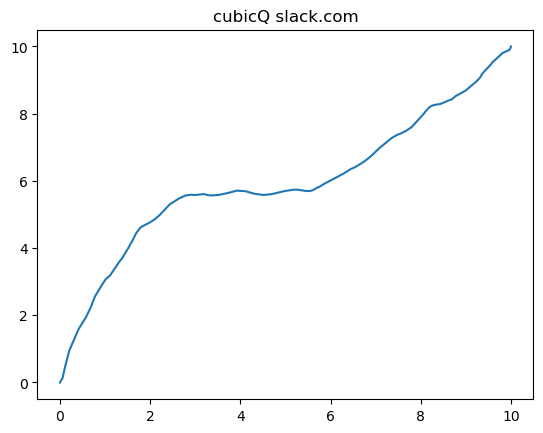

[12.031365725947113, 13.248903498373648, 20.42553665769493, 14.812247682339622]


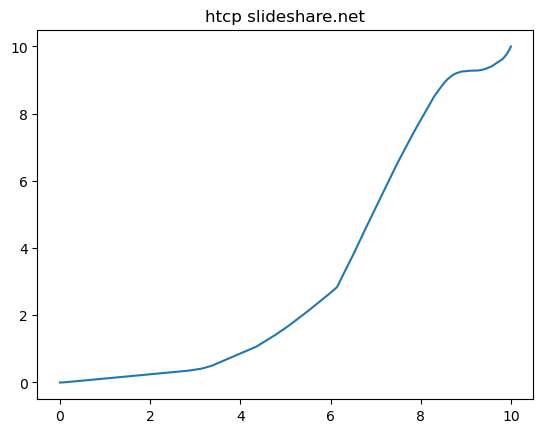

[9.697964634616525, 13.169821320024585, 14.491903366856773, 13.06938055233412]


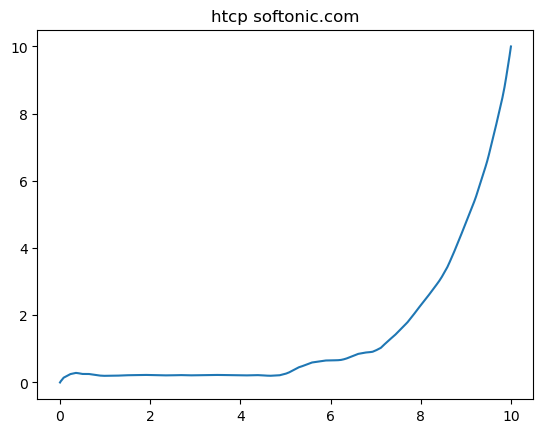

[20.942774915685053, 17.330876728230674, 17.68156332488868, 17.58761463008788]


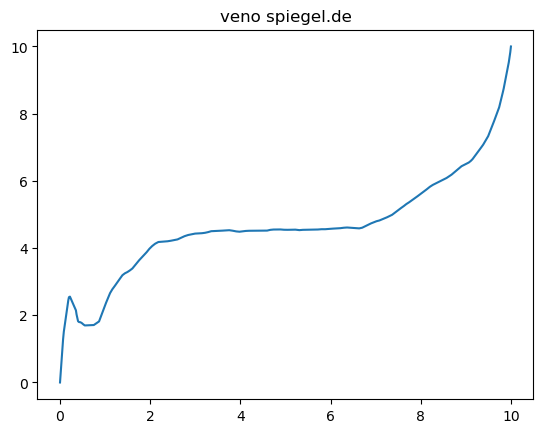

[16.619546809189565, 15.680867779598536, 21.951277104695173, 15.872073232538765]


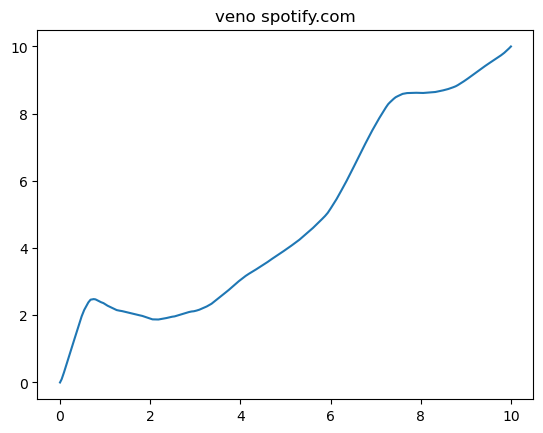

[8.89563409905981, 14.351018131405784, 22.34495244770425, 12.672134963636813]


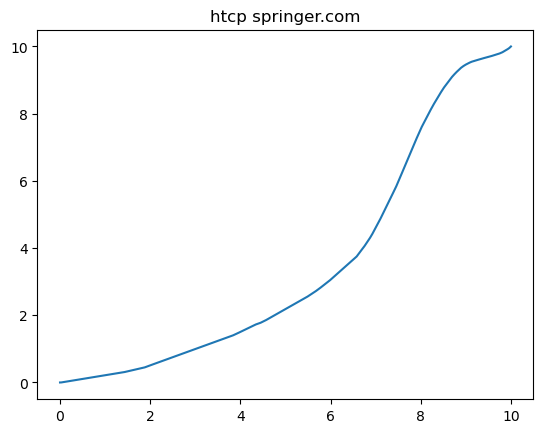

[11.750344577957911, 16.090215704241196, 13.624401462664505, 16.16528964306877]


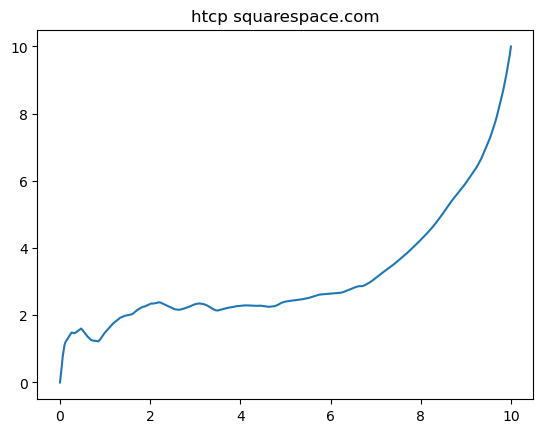

[12.4413538210149, 6.8437669507120376, 15.337458745759832, 7.163550775229586]


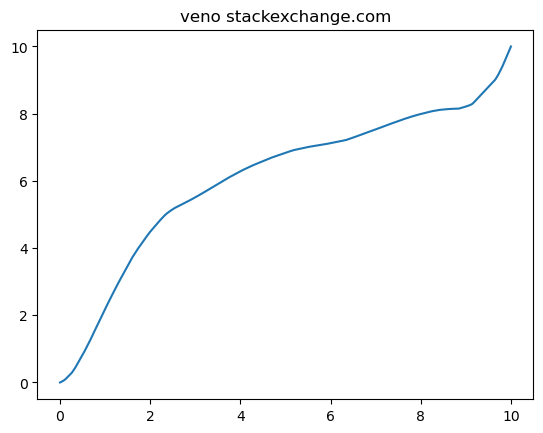

[14.275439293018861, 14.89834245212891, 15.561111383690672, 14.81967314647846]


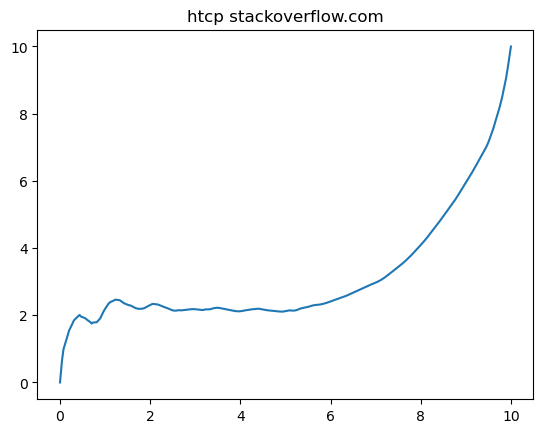

[43.41568473416835, 41.88136156456444, 46.589914003135334, 41.716207747585585]


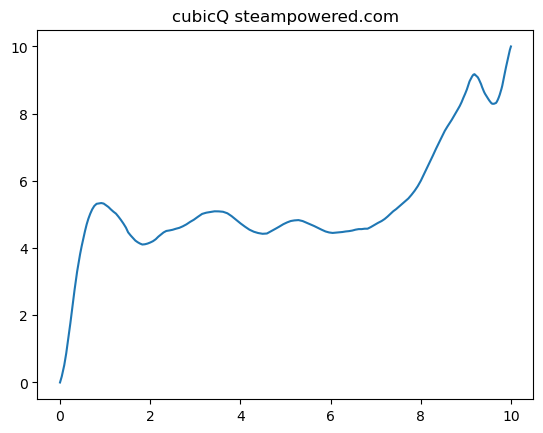

[10.00989665520547, 9.984670279240211, 8.504790979570203, 10.241711662651086]


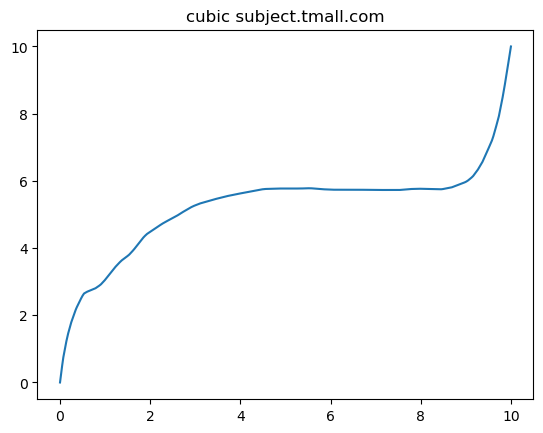

[19.10934282600553, 16.05676267983511, 23.0510608833539, 15.933828063640231]


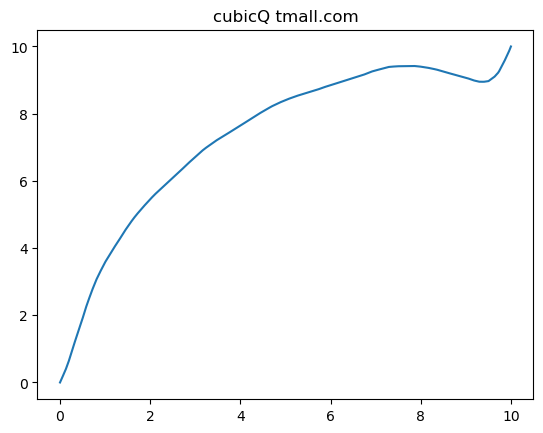

[16.292220538364823, 15.573605264851027, 19.22609754529978, 15.001660480941277]


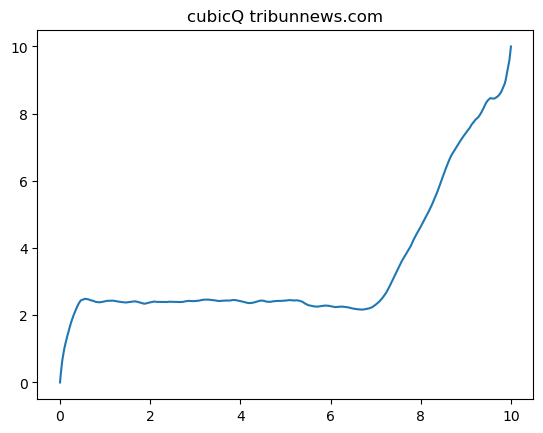

[6.399522342616634, 9.859876199520121, 14.525327421573929, 9.735793551770291]


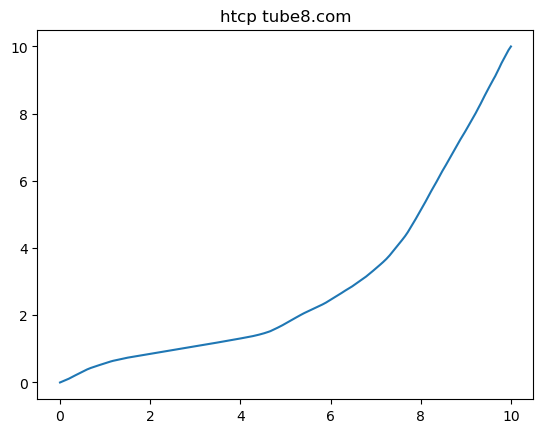

[11.431914908446327, 13.513926646765805, 26.944210121697232, 13.512866443826177]


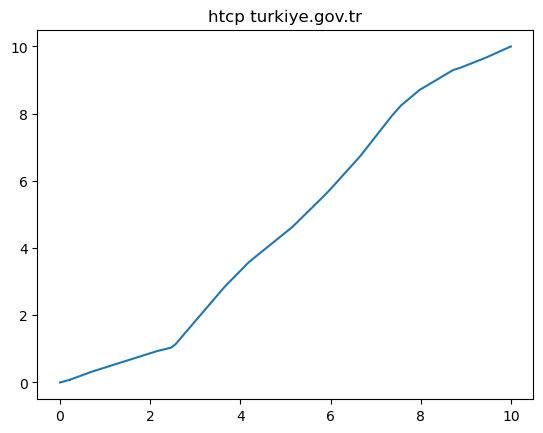

[19.395103302302886, 20.8755643452141, 21.038442396501175, 20.691107460788157]


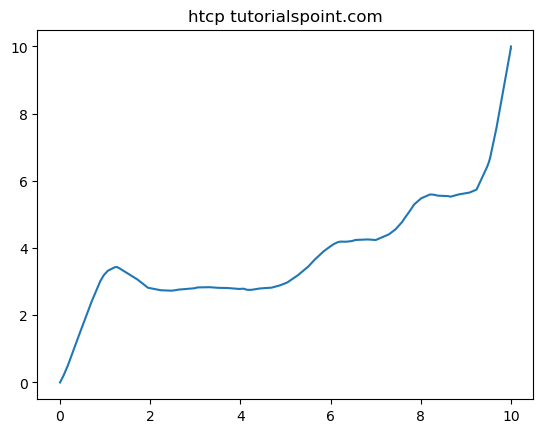

[13.365830685914133, 6.910576550247838, 12.876145934140736, 7.103412322928746]


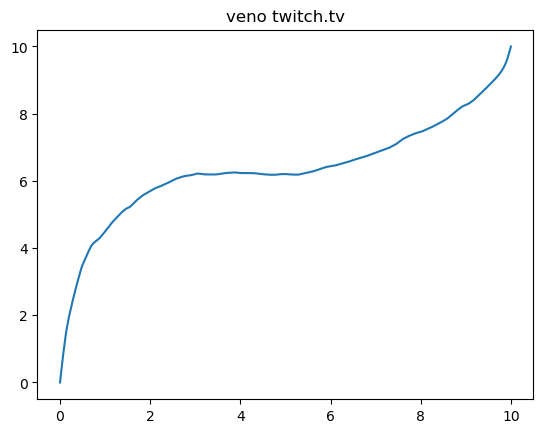

[30.842657796974507, 28.048351130341935, 48.92617048942513, 28.342773994857392]


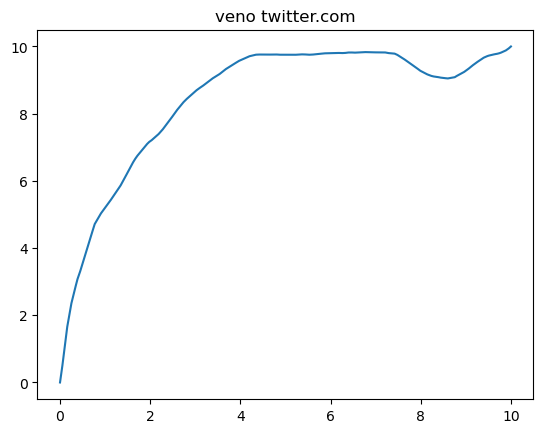

[7.12550234775296, 10.661364243323026, 9.913608042436238, 10.256924061386382]


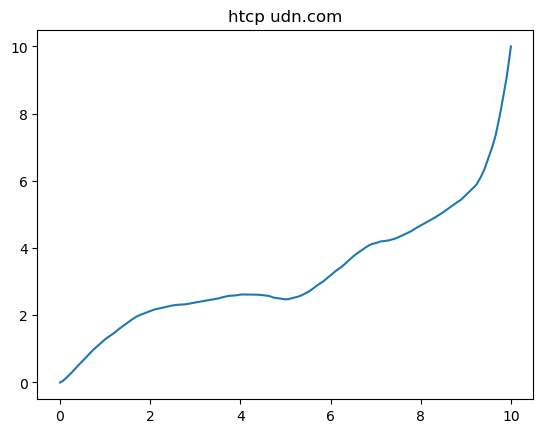

[8.267402566830818, 9.698077557955596, 9.57433477214189, 9.093433169352792]


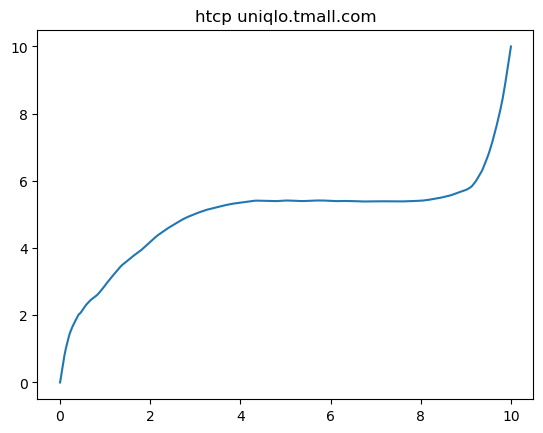

[10.38071602315732, 9.665466722043098, 12.850083982374755, 9.553719533343822]


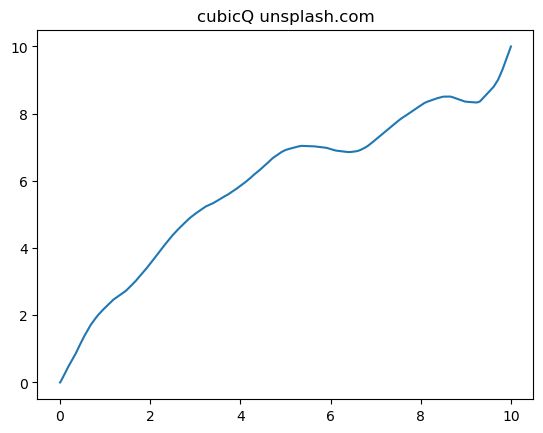

[18.01802311609297, 10.820272014490156, 16.215437290768225, 11.257485911145784]


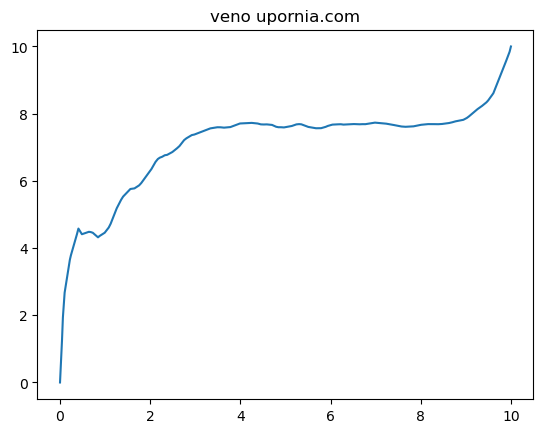

[8.514591946826268, 10.048083514073392, 17.159225012857263, 9.940100748228199]


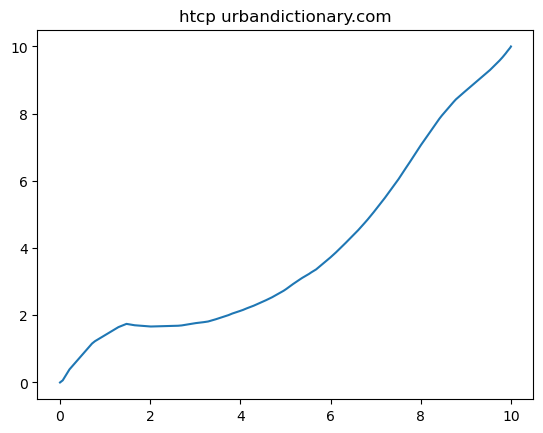

[13.750039231053341, 13.230345796287327, 15.495615841510748, 13.30354401828455]


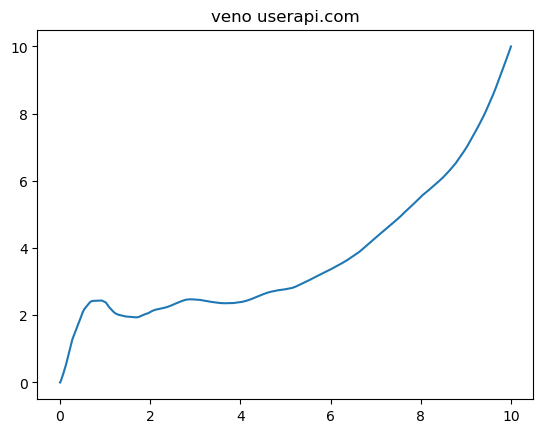

[18.372852438385856, 16.775327184150715, 21.653923372867848, 17.459418211353942]


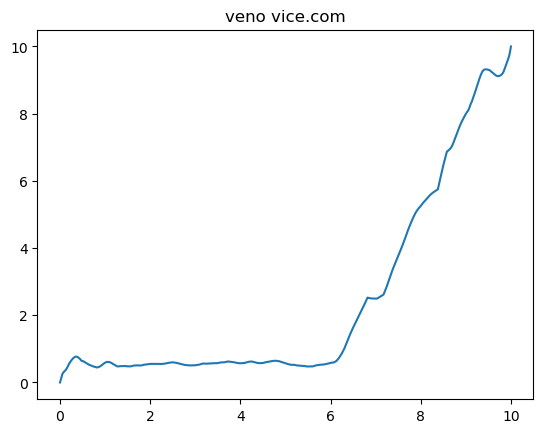

[31.806114831197178, 23.769474199585993, 36.39527159554729, 23.880497604213428]


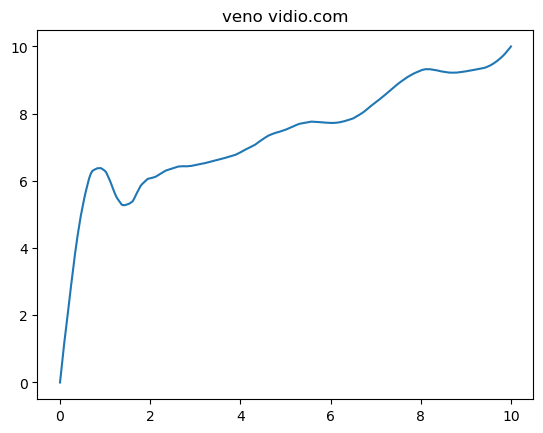

[20.963579373800105, 23.11714119785089, 25.021587884005285, 23.063305250751824]


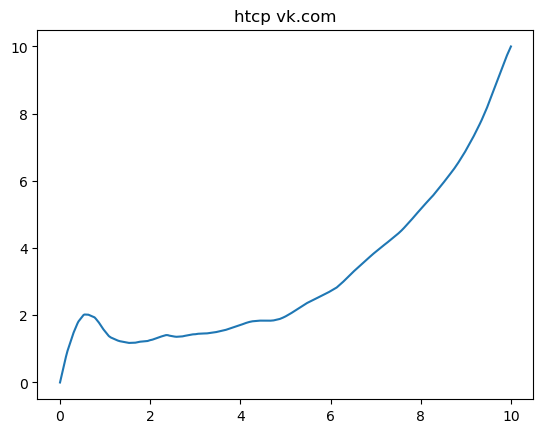

[12.414813216334121, 7.625562007444907, 13.506095881965464, 8.001762569081565]


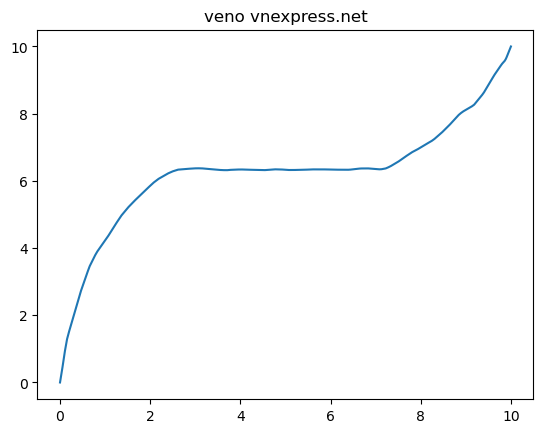

[16.8818519184822, 13.453020881405905, 14.538720772181238, 13.576033854721441]


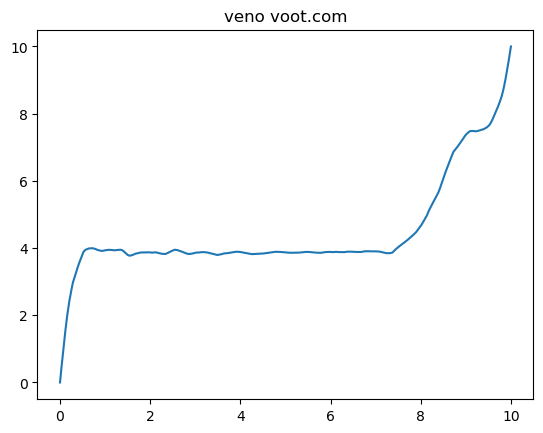

[6.133109668637403, 10.018728730527073, 11.359061981546196, 9.816275420782448]


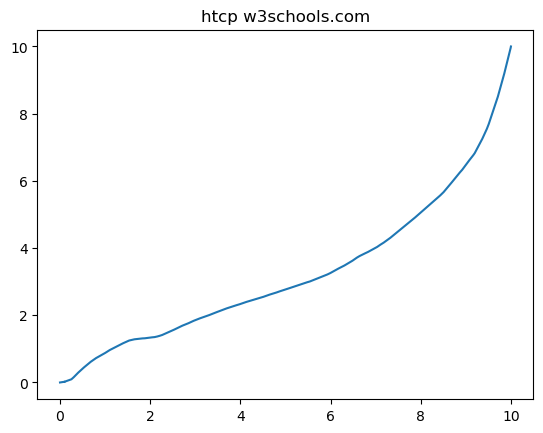

[23.93731330902523, 15.149242549093055, 23.77120318027816, 15.274887632969449]


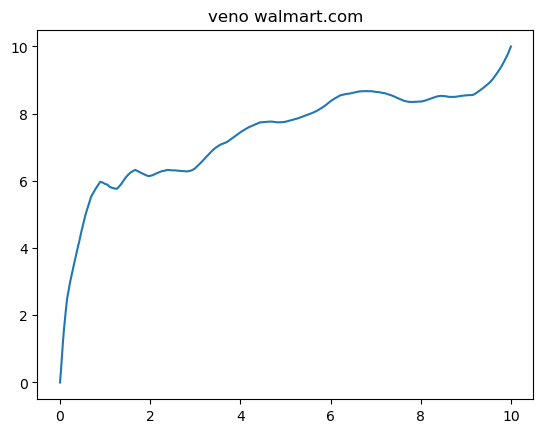

[24.595959366017624, 20.651607023262404, 23.46551025106083, 21.246735959474176]


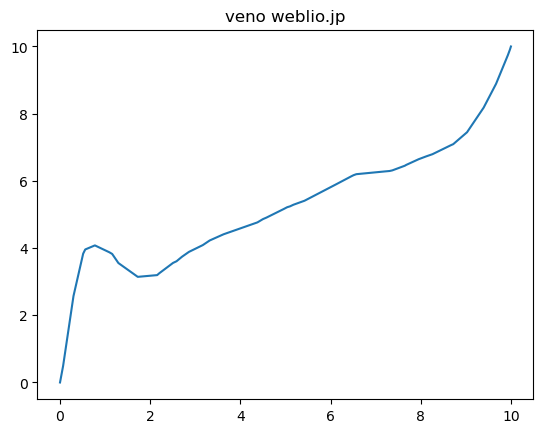

[9.440391398170044, 8.464159750783416, 8.297724037073209, 8.488824504148416]


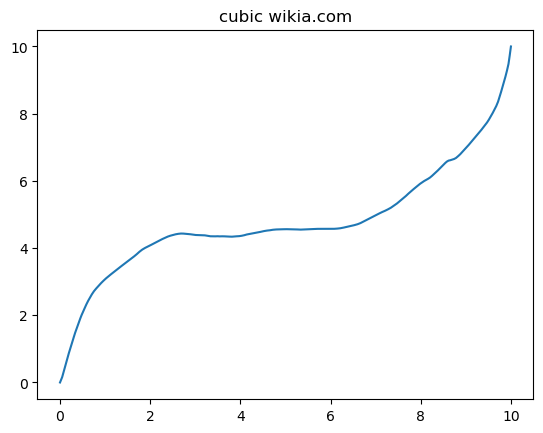

[10.554306516687083, 6.535204479483896, 10.117941473329706, 6.647602142391679]


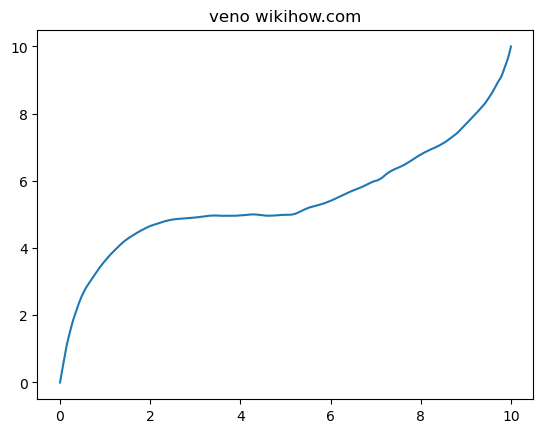

[11.04990756172886, 7.324842710802484, 9.986750690947295, 7.939423085464013]


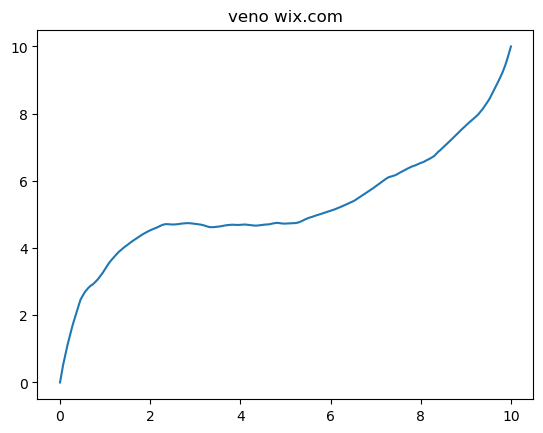

[9.635001200362915, 8.049804586085335, 10.08023508590804, 7.671416801638051]


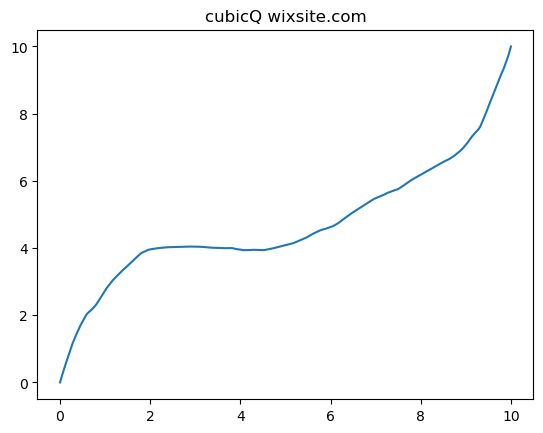

[12.709107044584815, 14.914525085033715, 14.052769576015267, 14.887913473106664]


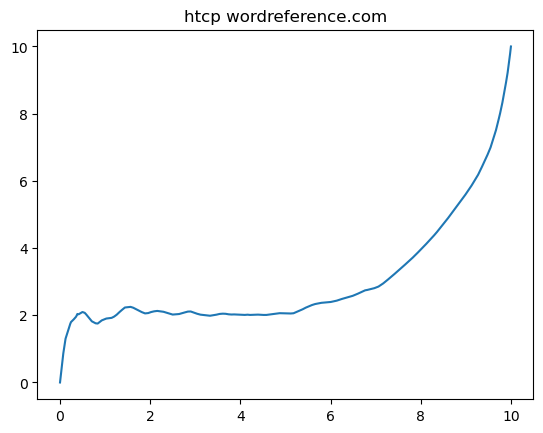

[14.129316828226312, 11.512097892928773, 19.432051067006515, 11.254568267241483]


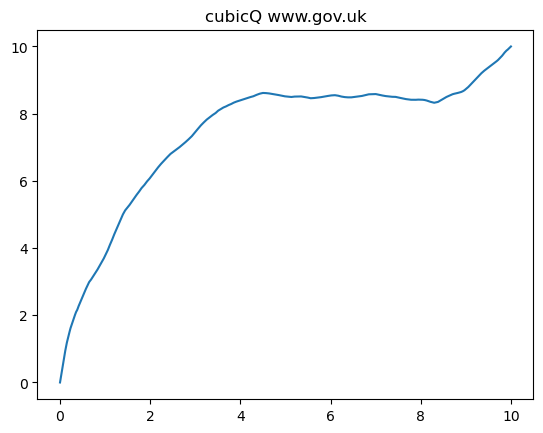

[16.724744841344478, 16.65479611368247, 15.491342962598534, 16.91077815062864]


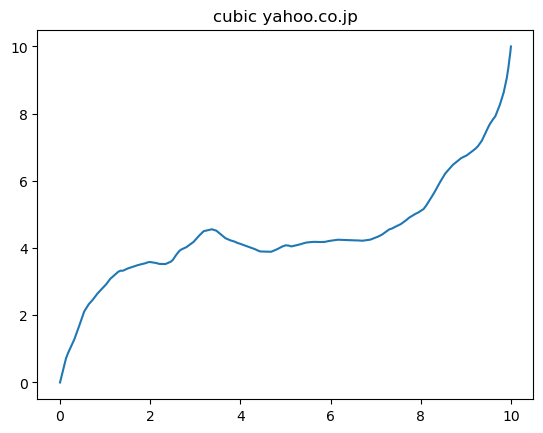

[14.839915815406057, 8.06593022239859, 16.662716969929207, 8.541095020061215]


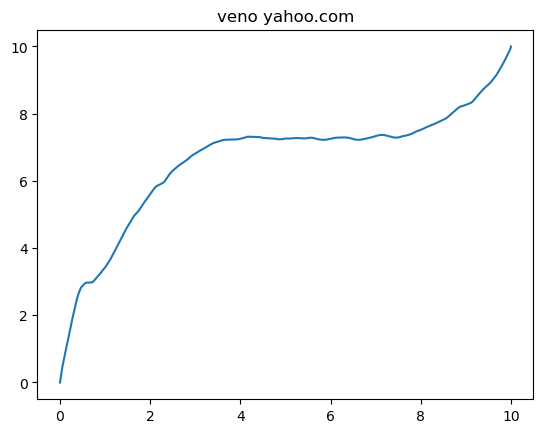

[14.457857232833362, 8.825175219289935, 21.37154821432954, 8.588006618523213]


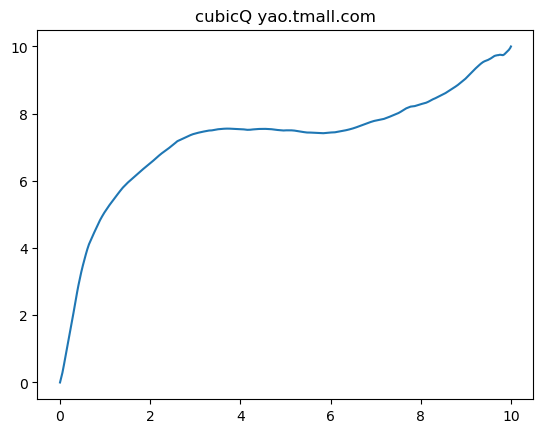

[10.833499722537224, 6.101926897307257, 12.648108094169746, 6.517769617986605]


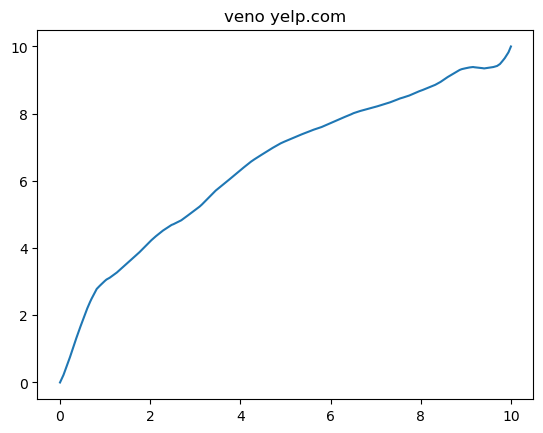

[15.443304304120185, 19.172731027512306, 19.660005363224357, 19.043355727464952]


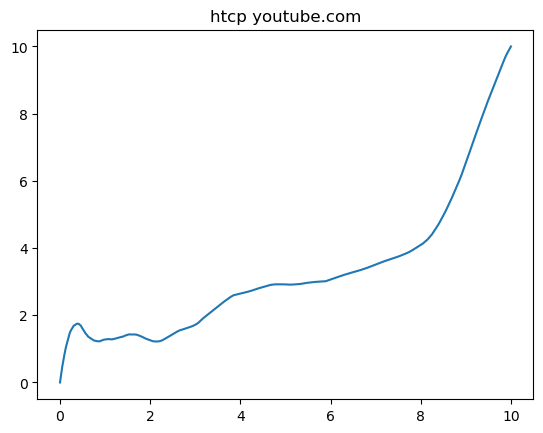

[21.49642860916739, 22.22654812575859, 22.092092127828415, 22.235735051347906]


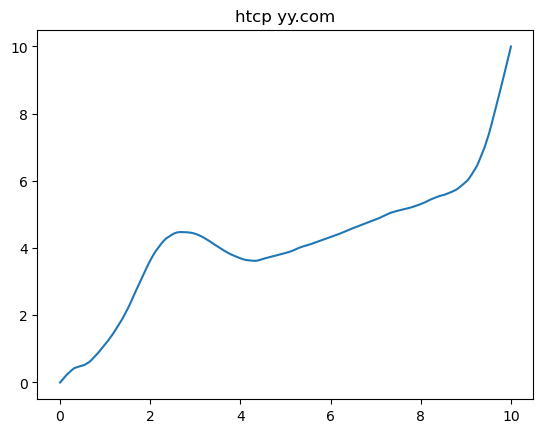

[23.077395202694692, 16.72382314209469, 22.427568290216, 17.0091398545224]


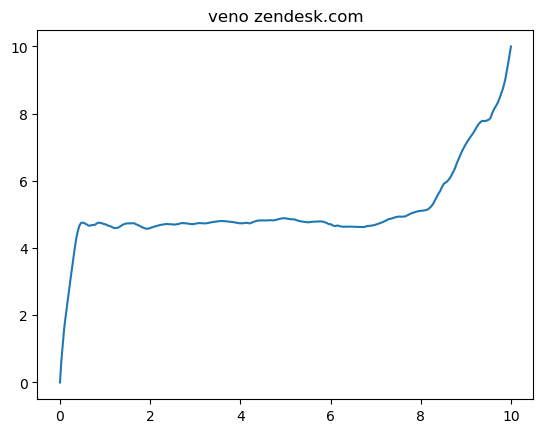

[974.4529142626276, 993.0747523022131, 941.4786719909054]


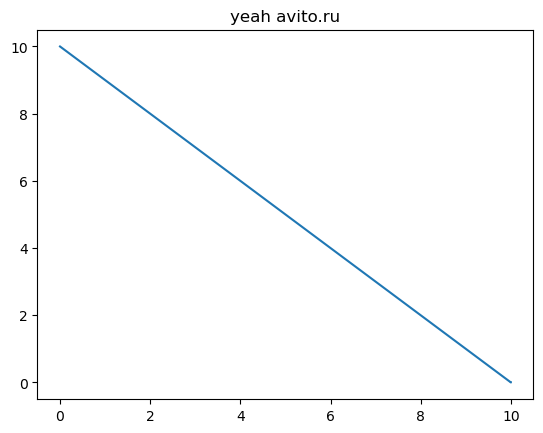

[15.916737868041542, 14.365377306996551, 19.73226176309052]


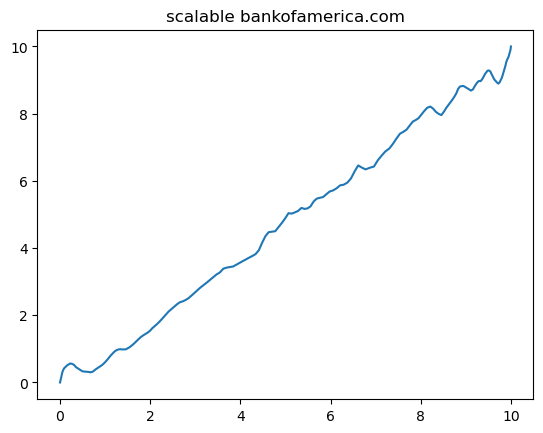

[14.981015614483836, 11.703001506664746, 23.38355096243223]


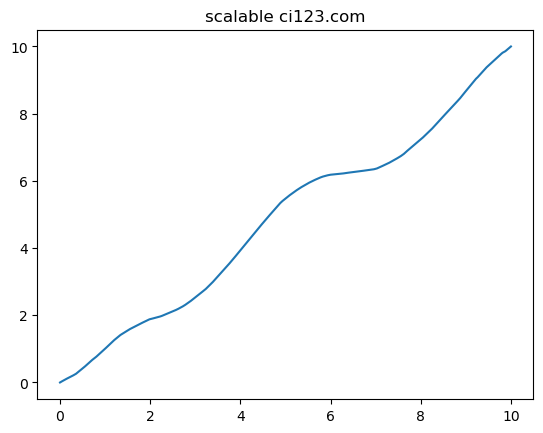

[964.4529142624625, 983.0747523020482, 931.4786719907403]


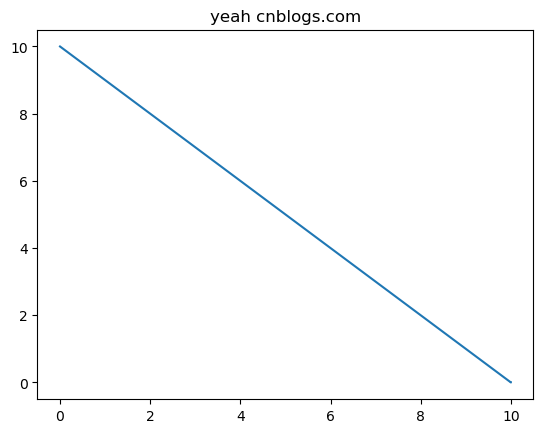

[36.84425878448842, 34.972121253490556, 46.67926637696266]


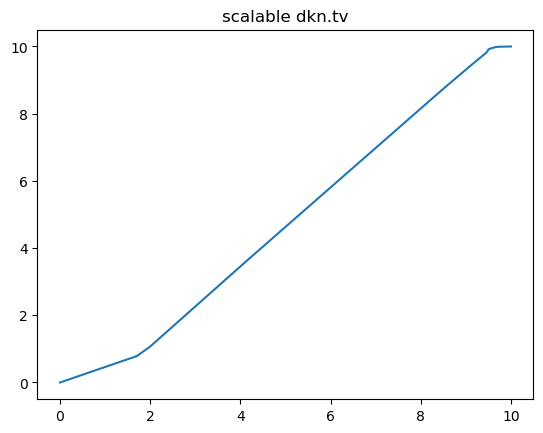

[944.4529142628121, 963.0747523023975, 911.4786719910898]


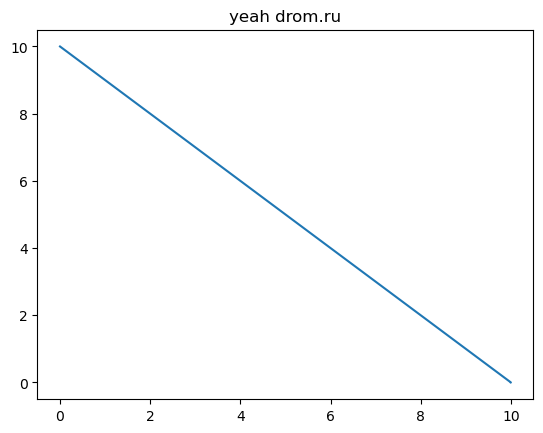

[18.791065174155893, 13.026191067501944, 31.466119415463602]


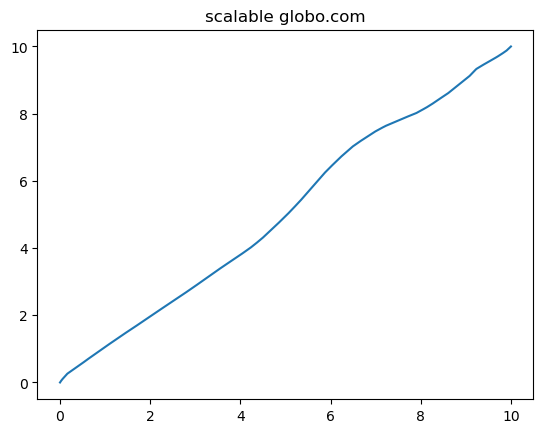

[959.452914262619, 978.0747523022046, 926.4786719908967]


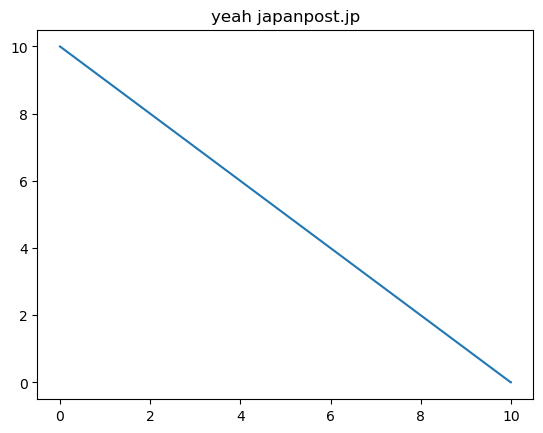

[949.4529142626326, 968.074752302218, 916.4786719909102]


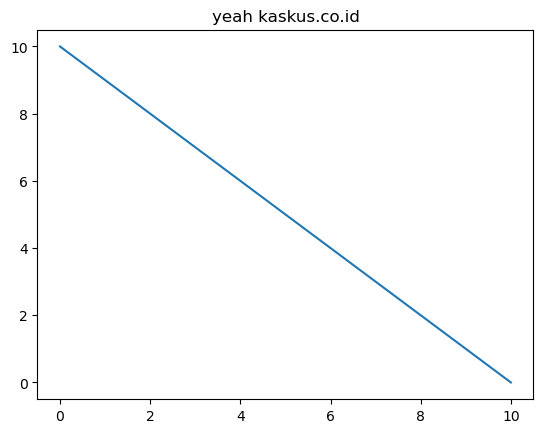

[954.452914262633, 973.0747523022186, 921.4786719909107]


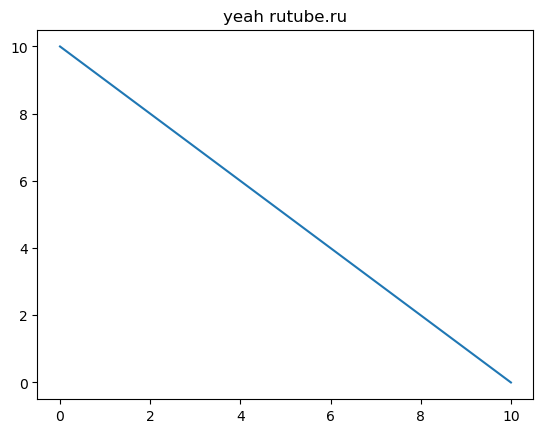

[964.4529142626325, 983.0747523022179, 931.4786719909102]


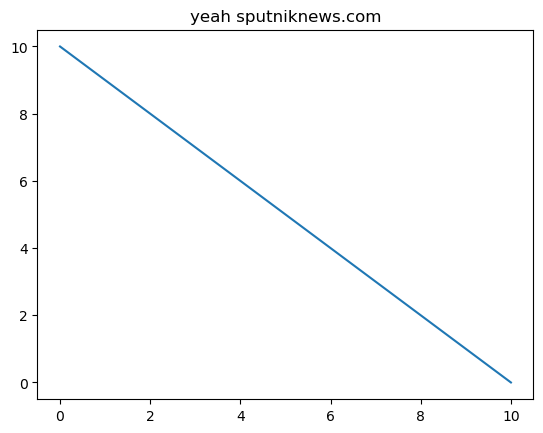

[38.84204406676447, 36.088743669437356, 45.29495400202311]


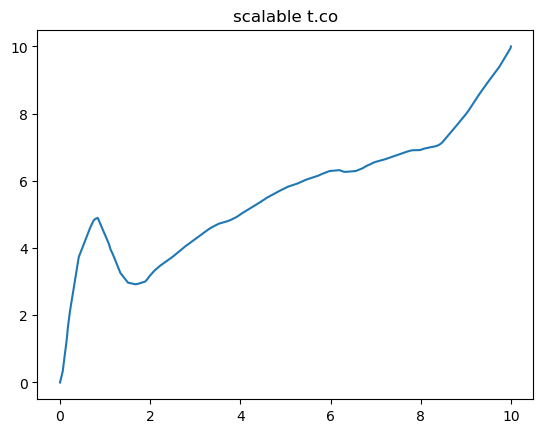

[7.732334451610149, 6.907391603140261, 10.474436238874171]


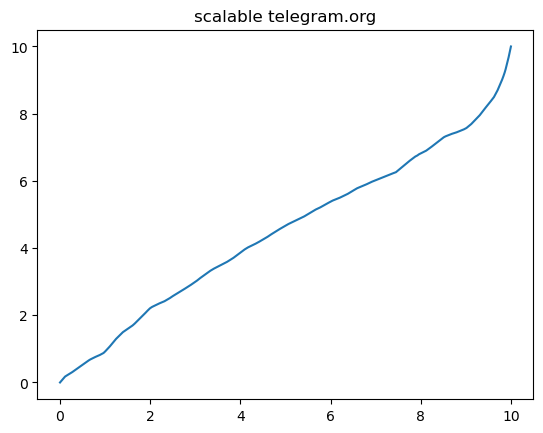

[15.113294157588898, 15.7301517376976, 13.7574000026168, 62.84864276232362, 14.21784094062588]


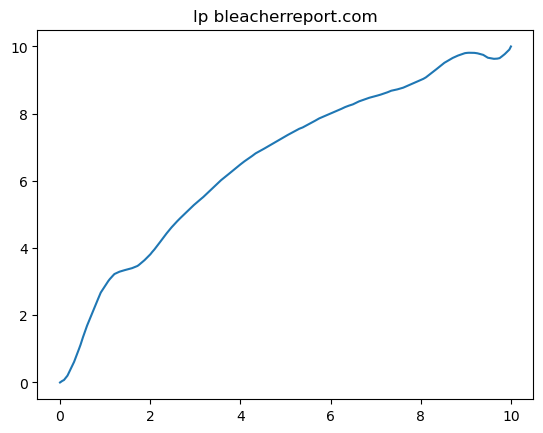

[10.662927430455417, 10.834699809250752, 10.249117725580387, 46.61023221025709, 10.603603453275449]


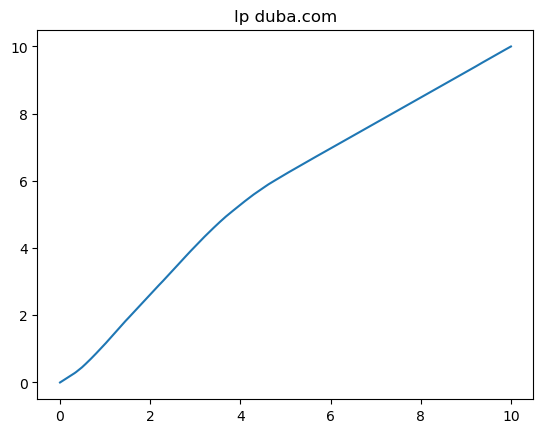

[38.829400317759294, 38.78923609454799, 38.58846197856951, 47.84341844313323, 38.564498321801516]


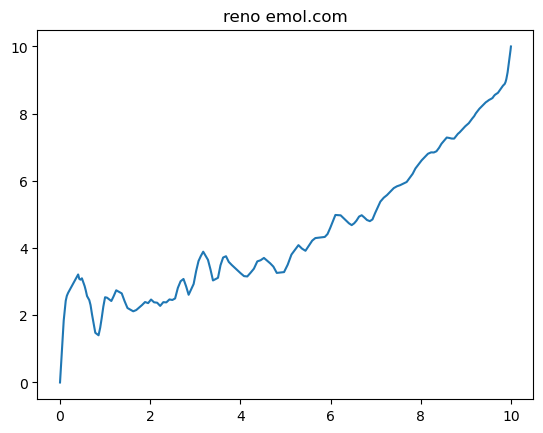

[11.879642054169011, 12.350013720618637, 11.270035310377551, 24.36726958979326, 11.455708534163865]


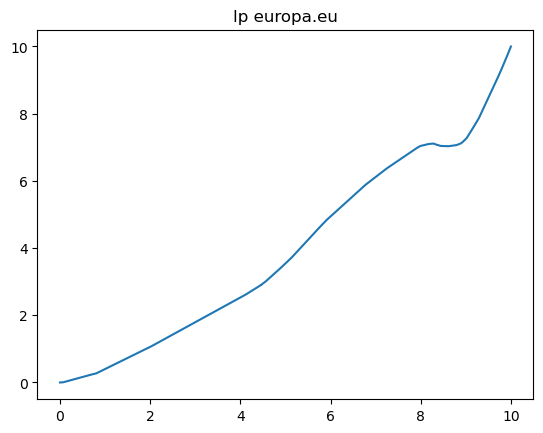

[11.516038433167209, 11.498603428093391, 11.000220154234386, 34.854766362704794, 11.259758425018925]


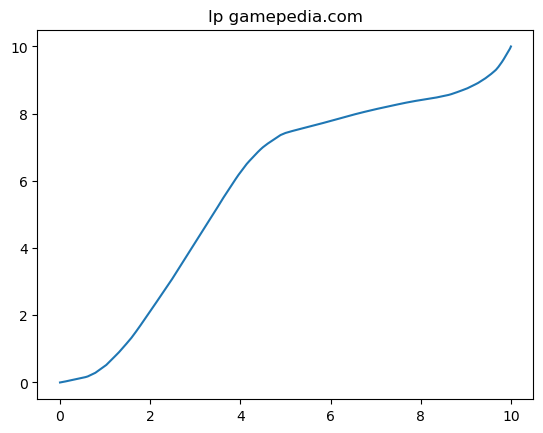

[79.80102533900839, 79.76191810998962, 79.49738604146641, 96.87040507496488, 79.68548242133373]


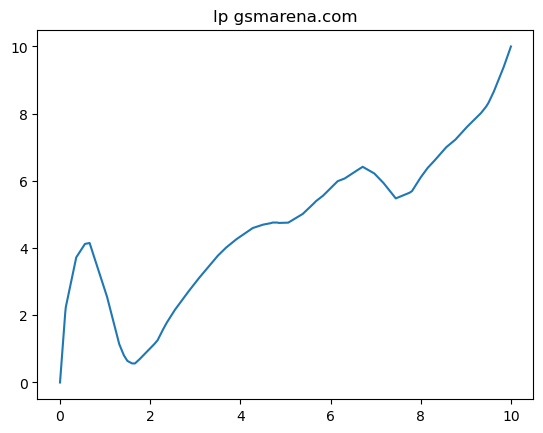

[13.612320068987625, 13.847524212619092, 13.431914623133027, 30.831253526424348, 13.397461974010698]


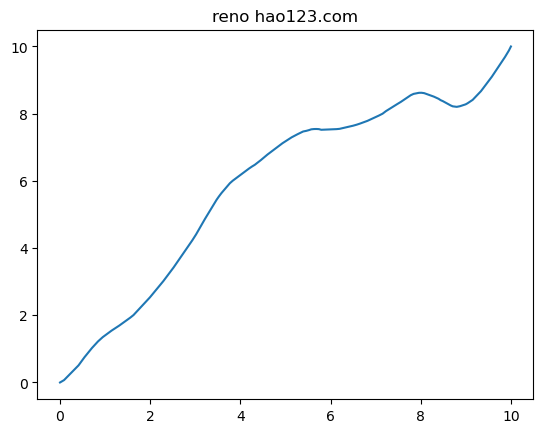

[13.460386871979981, 13.92251090614148, 12.708737494962627, 54.568419161095136, 13.228849336083757]


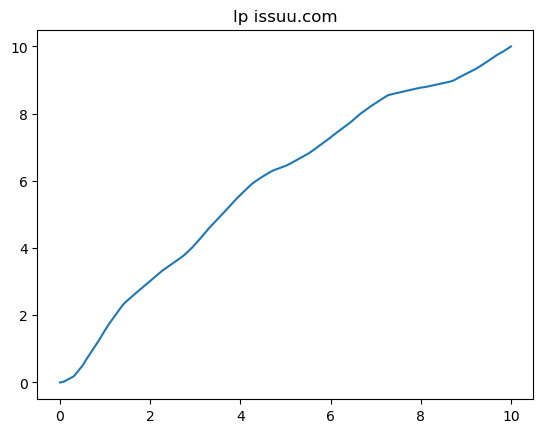

[10.186739749415747, 10.277826718819693, 9.815953148047246, 35.384841939741236, 9.833606351592094]


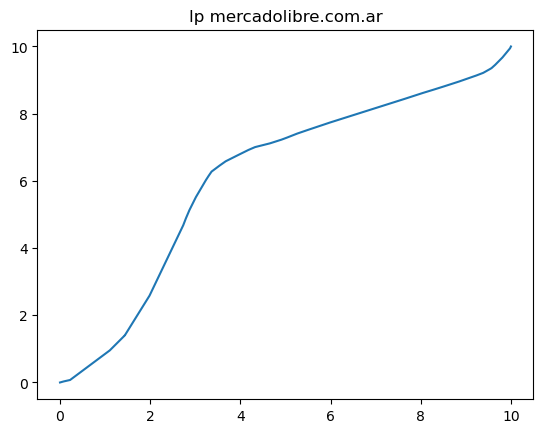

[14.545082928333581, 14.642410630540112, 13.869792338583254, 50.667519811254685, 13.974325425391998]


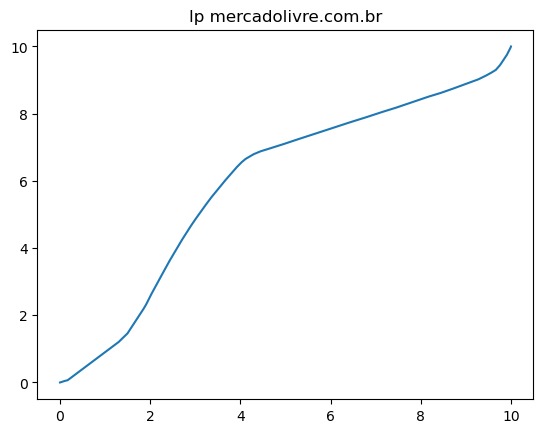

[19.488284974779738, 19.884405507237794, 18.187372966137193, 92.80464681212804, 18.704573492338184]


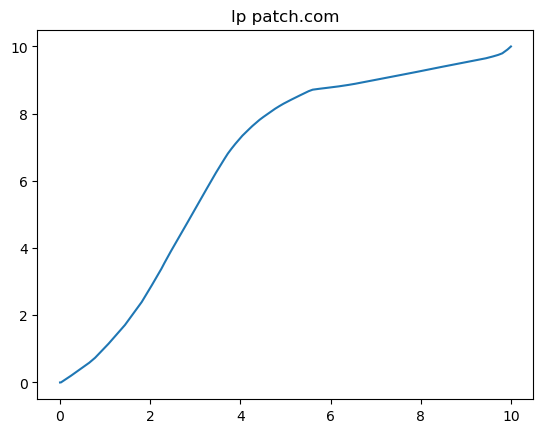

[26.118554577001603, 26.099930179347567, 25.732149301705473, 57.56352116981318, 25.93141501341018]


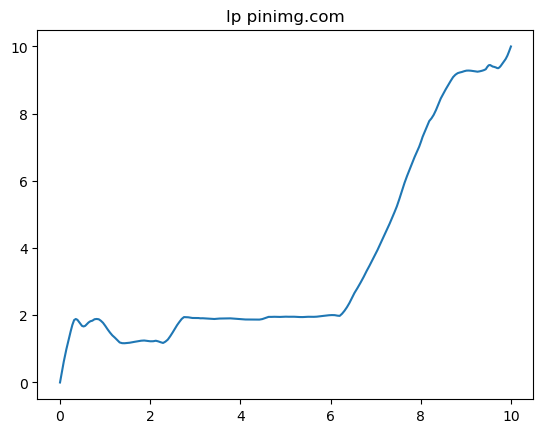

[7.390524412370394, 7.562749501509856, 7.254736423075115, 18.646168868692357, 7.433417620000714]


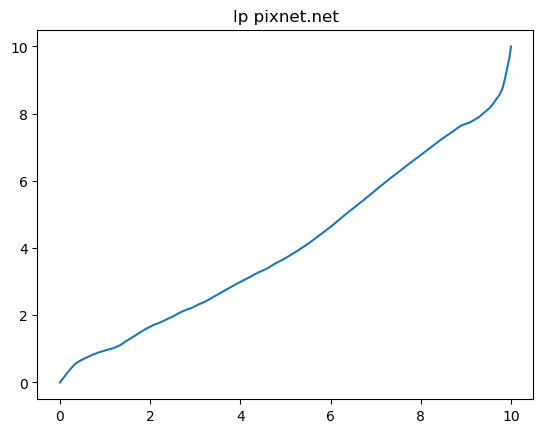

[25.674008805232994, 25.73848918403251, 24.52136229413455, 48.15942313758348, 24.92029454447404]


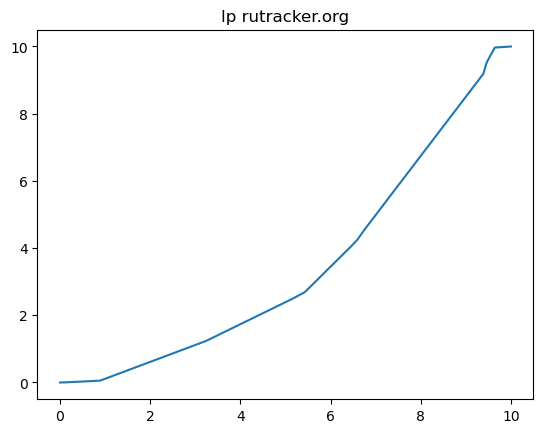

[30.9298393874165, 31.097075183782607, 30.612295163900438, 48.36656026609764, 30.751818824991993]


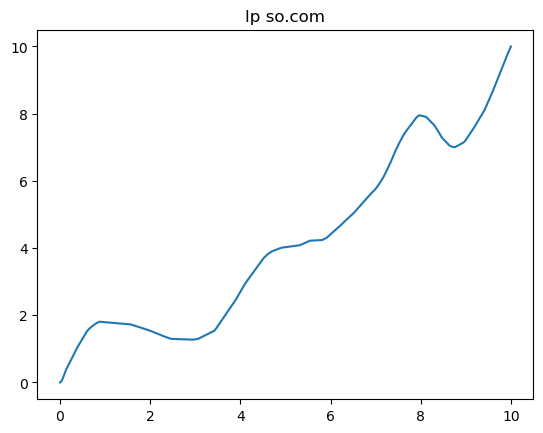

[14.941679913867985, 15.06827342764642, 14.198570812511383, 73.38310743370086, 14.607110940388734]


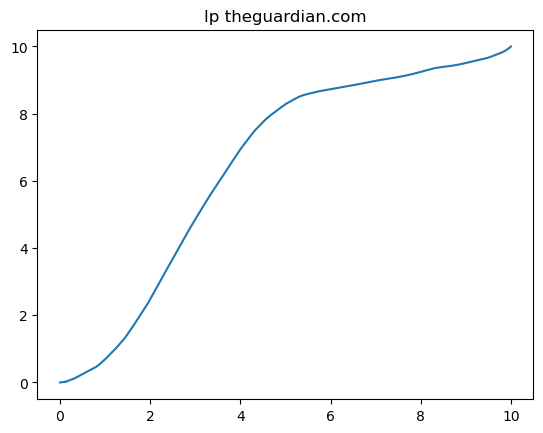

[28.15651437173466, 27.676875452134226, 27.668436108397326, 64.03760199918197, 28.163527226646906]


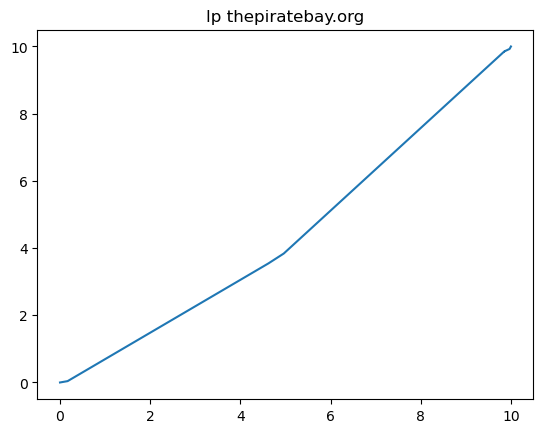

[8.888935240514018, 8.835787940220703, 8.284790729874985, 28.478865719454944, 8.543377346015816]


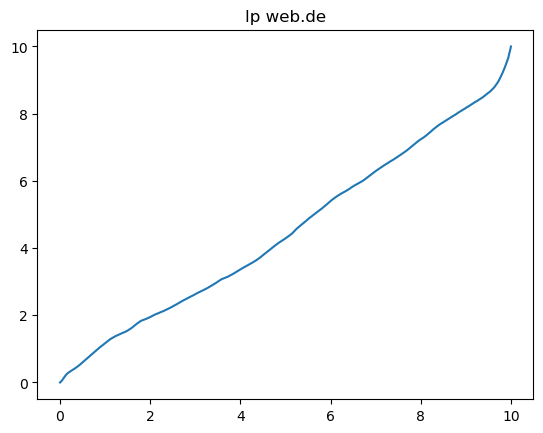

[11.317511741603186, 11.440988955269814, 11.075822010606313, 22.446920060505533, 11.207970421897027]


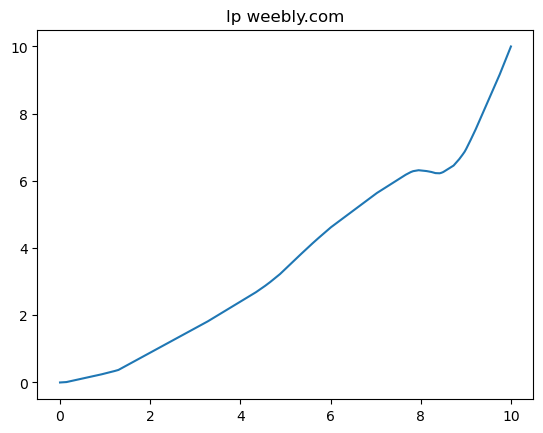

In [592]:
cc_count = {}
for deg in web_dtw:
    for web in web_dtw[deg]:
        min_ind = web_dtw[deg][web]['dist'].index(min(web_dtw[deg][web]['dist']))
        cc_ind =  web_dtw[deg][web]['cc'][min_ind]
        if cc_ind not in cc_count:
            cc_count[cc_ind]=0
        cc_count[cc_ind]+=1
        print(web_dtw[deg][web]['dist'])
        plt.plot(web_mp[web]['time'], web_mp[web]['data'])
        plt.title(cc_ind+" "+web)
        plt.show()

In [593]:
print(cc_count)

{'cubic': 15, 'veno': 45, 'htcp': 75, 'cubicQ': 27, 'yeah': 7, 'scalable': 6, 'lp': 17, 'reno': 2}


In [ ]:
for deg in web_dtw:
    for web in web_dtw[deg]:
        min_ind = web_dtw[deg][web]['dist'].index(min(web_dtw[deg][web]['dist']))
        cc_ind =  web_dtw[deg][web]['cc'][min_ind]
        print(web_dtw[deg][web]['dist'])
        plt.plot(web_mp[web]['time'], web_mp[web]['data'])
        plt.title(cc_ind+" "+web)
        plt.show()

In [140]:
# DEGREE 3
x_train = []
y_train = []
count = 0
count_cc_mp = {}
for cc in cc_degree:
    if cc == 'nv':
        continue
    if cc_degree[cc] == 3:
        length = len(vals_cubicQ[cc][1])
        count_cc_mp[count]=cc
        y_t = [count] * length
        x_t = [list(arr) for arr in vals_cubicQ[cc][1]]
        x_train += x_t
        y_train += y_t
        count+=1

print(x_train[0:5])
print(y_train[0:5])

[[0.0029994837561801943, -0.03486935527273569, 0.2868448582247575], [0.003754752816663653, -0.06264120999265722, 0.5329774569524828], [0.003583340738232931, -0.05897860005085778, 0.4852199249690121], [0.0037995474263115923, -0.06972899489911945, 0.6229774869880573], [0.0034329197484625758, -0.0548843660337162, 0.478761365788443]]
[0, 0, 0, 0, 0]


In [141]:
count_cc_mp

{0: 'htcp', 1: 'vegas', 2: 'veno', 3: 'cubic'}

In [190]:
params_grid = [{'kernel': ['rbf'], 'gamma': [1e-1, 10],
                     'C': [1, 10, 100, 500,1000,2000]},
                    ]

In [191]:
svm_model = GridSearchCV(SVC(), params_grid, cv=5)
svm_model.fit(x_train, y_train)

GridSearchCV(cv=5, estimator=SVC(),
             param_grid=[{'C': [1, 10, 100, 500, 1000, 2000],
                          'gamma': [0.1, 10], 'kernel': ['rbf']}])

In [192]:
print('Best score for training data:', svm_model.best_score_,"\n") 

# View the best parameters for the model found using grid search
print('Best C:',svm_model.best_estimator_.C,"\n") 
print('Best Kernel:',svm_model.best_estimator_.kernel,"\n")
print('Best Gamma:',svm_model.best_estimator_.gamma,"\n")

final_model = svm_model.best_estimator_
y_pred = final_model.predict(x_train)
for i in range(len(x_train)):
    print(count_cc_mp[y_train[i]], count_cc_mp[y_pred[i]])

Best score for training data: 1.0 

Best C: 10 

Best Kernel: rbf 

Best Gamma: 10 

htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp htcp
htcp 

In [193]:
web_train = []
website = []
for web in cc_mp:
    if cc_mp[web]['deg'] == 3:
        web_train.append(list(cc_mp[web]['coeff'][0:3]))
        website.append(web)
print(web_train[0:5])

[[0.0015451245713419368, 0.02527189942573313, 0.2339739888282832], [0.0003673466127831369, 0.024968431946767445, 0.546562602414463], [0.00023997829171094805, 0.015845592843642523, 0.3927753736994721], [0.0019910120771948576, 0.09414322117117364, 1.3341040839630454], [0.0003037496462480746, 0.021072332493012, 0.5055248414370324]]


In [194]:
pred_web = final_model.predict(web_train)
# pred_prob = final_model.predict_proba(web_train)
pred_cc = [count_cc_mp[i] for i in pred_web]

In [195]:
for i in range(0,4):
    print(count_cc_mp[i], list(pred_web).count(i))

htcp 16
vegas 10
veno 12
cubic 20


In [ ]:
# Create a 3D figure
fig = plt.figure(figsize=(15,8))

# Create a 3D axis
ax = fig.add_subplot(111, projection='3d')

count = 0 
for web in cc_mp:
    if cc_mp[web]['deg'] == 3:
        x_points = []
        y_points = []
        z_points = []
        points = cc_mp[web]['coeff']
        x_points.append(points[0])
        y_points.append(points[1])
        z_points.append(points[2])
        x_points = np.array(x_points)
        y_points = np.array(y_points)
        z_points = np.array(z_points)
        ax.scatter(x_points, y_points, z_points, label = ,color='k')

for cc in cc_degree:
    if cc == "nv" :
        continue
    if cc_degree[cc] == 3:
        x_points = []
        y_points = []
        z_points = []
        for points in vals_cubicQ[cc][1]:
            x_points.append(points[0])
            y_points.append(points[1])
            z_points.append(points[2])
        x_points = np.array(x_points)
        y_points = np.array(y_points)
        z_points = np.array(z_points)
        ax.scatter(x_points, y_points, z_points, label=cc)
    plt.legend()

        
#     plt.legend()
# Plot the 3D surface
# surf = ax.plot_surface(x, y, z, cmap='viridis')

# Add a color bar which maps values to colors
# fig.colorbar(surf)

# Set axis labels
ax.set_xlabel('X-axis')
ax.set_ylabel('Y-axis')
ax.set_zlabel('Z-axis')

# Set a title
plt.title('3D Surface Plot')


plt.show()

# Lets test for the Quadratic Case which will be visually discernable

In [273]:
# DEGREE 2
x_train = []
y_train = []
count_cc_mp = {}
for cc in cc_degree:
    if cc_degree[cc] == 2:
        if cc == "westwood":
            count=1 
        elif cc == "cubicQ":
            count=3
        else :
            count=2
        length = len(vals_cubicQ[cc][1])
        count_cc_mp[count]=cc
        y_t = [count] * length
        x_t = [list(arr) for arr in vals_cubicQ[cc][1]]
        x_train += x_t
        y_train += y_t
        count+=1

print(x_train[0:5])
print(y_train[0:5])

[[-0.0020906961247359563, 0.33606471950463973], [-0.0022390814997639633, 0.33615373520809055], [-0.0018978879224852585, 0.32500846969134745], [-0.002219984604855126, 0.33637065620802514], [-0.0018470186778700769, 0.32455646780078773]]
[2, 2, 2, 2, 2]


In [269]:
# params_grid = [{'kernel': ['rbf','poly'], 'gamma': [1e-1, 10],
#                      'C': [1, 10, 100, 500,1000,2000]},
#                     ]
# svm_model = GridSearchCV(SVC(), params_grid, cv=5)
svm_model = SVC(gamma=100,C=100)
fit_model = svm_model.fit(x_train, y_train)

In [270]:
# print('Best score for training data:', svm_model.best_score_,"\n") 

# # View the best parameters for the model found using grid search
# print('Best C:',svm_model.best_estimator_.C,"\n") 
# print('Best Kernel:',svm_model.best_estimator_.kernel,"\n")
# print('Best Gamma:',svm_model.best_estimator_.gamma,"\n")

# final_model = svm_model.best_estimator_
# y_pred = final_model.predict(x_train)
y_pred = fit_model.predict(x_train)
# for i in range(len(x_train)):
#     print(count_cc_mp[y_train[i]], count_cc_mp[y_pred[i]])

In [271]:
def make_meshgrid(x, y, h=.002):
    x_min, x_max = x.min() - 0.01, x.max() + 0.01
    y_min, y_max = y.min() -0.01, y.max() + 0.01
    xx, yy = np.meshgrid(np.arange(x_min, x_max, h), np.arange(y_min, y_max, h))
    return xx, yy

def plot_contours(ax, clf, xx, yy, **params):
    Z = clf.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)
    out = ax.contourf(xx, yy, Z, **params)
    return out

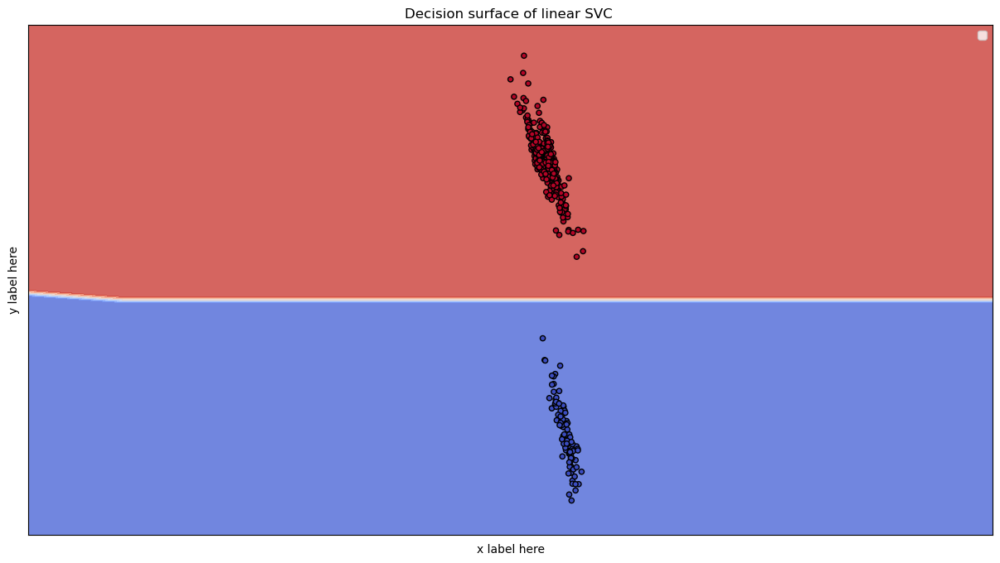

In [272]:
fig, ax = plt.subplots(figsize=(15,8))
# title for the plots
title = ('Decision surface of linear SVC ')
# Set-up grid for plotting.
X0 = np.array([x_i[0] for x_i in x_train])
X1 = np.array([x_i[1] for x_i in x_train])
xx, yy = make_meshgrid(X0, X1)

plot_contours(ax, fit_model, xx, yy, cmap=plt.cm.coolwarm, alpha=0.8)
ax.scatter(X0, X1, c=y_train, cmap=plt.cm.coolwarm, s=20, edgecolors='k')
ax.set_ylabel('y label here')
ax.set_xlabel('x label here')
ax.set_xticks(())
ax.set_yticks(())
ax.set_title(title)
ax.legend()
plt.show()

In [ ]:
web_train = []
website = []
for web in cc_mp:
    if cc_mp[web]['deg'] == 3:
        web_train.append(list(cc_mp[web]['coeff'][0:3]))
        website.append(web)
print(web_train[0:5])

In [274]:
names = [
    "Nearest Neighbors",
    "Linear SVM",
    "RBF SVM",
    "Gaussian Process",
    "Decision Tree",
    "Random Forest",
    "Neural Net",
    "AdaBoost",
    "Naive Bayes",
    "QDA",
]

In [293]:
import importlib

In [294]:
importlib.reload(sklearn)

<module 'sklearn' from '/home/lakshayr/anaconda3/lib/python3.9/site-packages/sklearn/__init__.py'>

In [295]:
sklearn.show_versions()


System:
    python: 3.9.13 (main, Aug 25 2022, 23:26:10)  [GCC 11.2.0]
executable: /home/lakshayr/anaconda3/bin/python
   machine: Linux-6.2.0-32-generic-x86_64-with-glibc2.35

Python dependencies:
          pip: 22.2.2
   setuptools: 63.4.1
      sklearn: 1.1.0
        numpy: 1.21.5
        scipy: 1.9.1
       Cython: 0.29.32
       pandas: 1.4.4
   matplotlib: 3.5.2
       joblib: 1.1.0
threadpoolctl: 2.2.0

Built with OpenMP: True


In [431]:
labels = []
data = []
for cc in cc_degree:
    if cc_degree[cc] == 2:
        for points in vals_cubicQ[cc][1]:
            data.append(list(points))
        labels.append([cc]*len(vals_cubicQ[cc][1]))
# print(data)
# print(labels)

In [324]:
from sklearn.preprocessing import StandardScaler

In [337]:
scaler = StandardScaler()

In [338]:
scaler.fit(data)
new_data = scaler.transform(data)

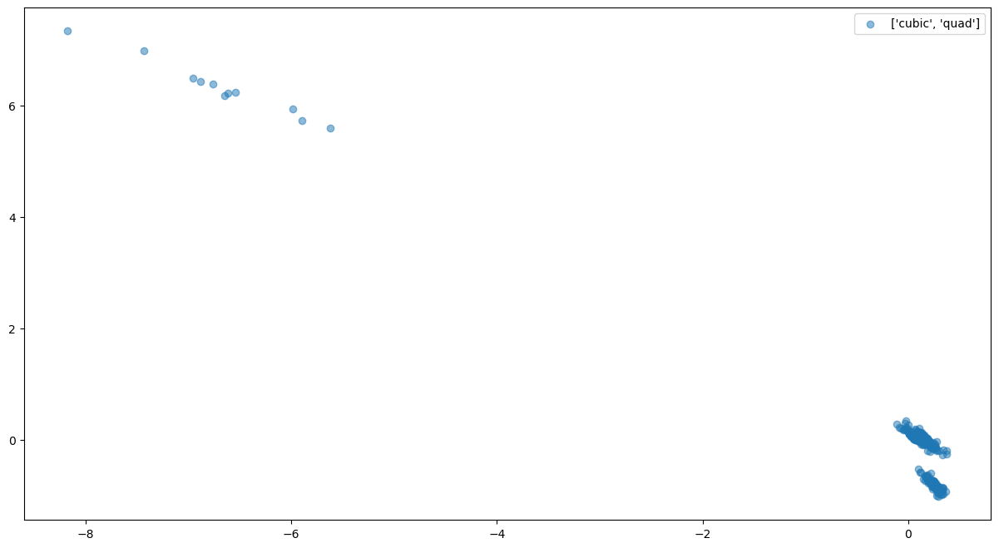

In [350]:
fig, ax = plt.subplots(1,1, figsize=(15,8))

ax.scatter([i[0] for i in new_data],[i[1] for i in new_data], label = ["cubic","quad"], alpha=0.5)
plt.legend()

#         else :
#             ax.scatter(x_points, y_points, label=cc,alpha=0.5)
#     plt.legend()
plt.show()

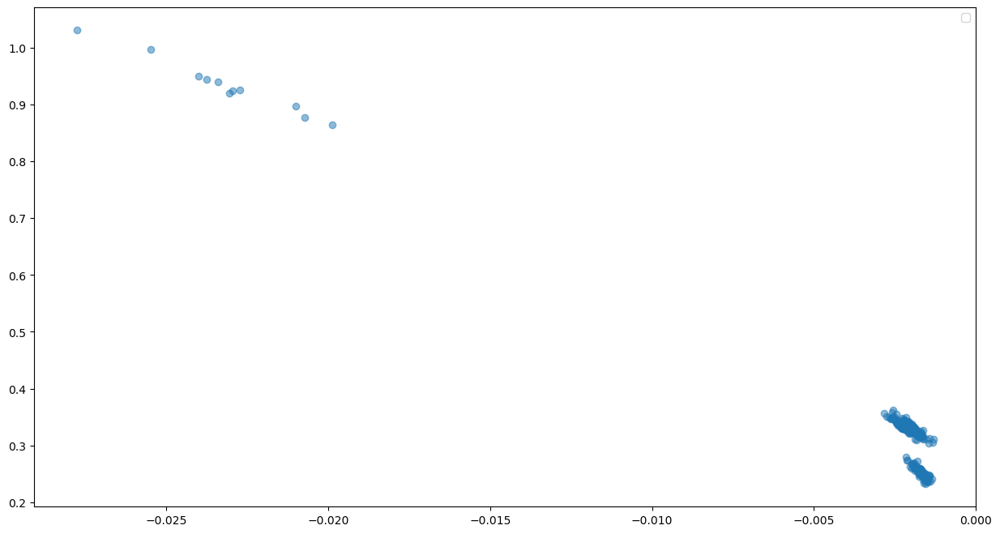

In [343]:
fig, ax = plt.subplots(1,1, figsize=(15,8))
ax.scatter([i[0] for i in data],[i[1] for i in data],alpha=0.5)
plt.legend()

#         else :
#             ax.scatter(x_points, y_points, label=cc,alpha=0.5)
#     plt.legend()
plt.show()

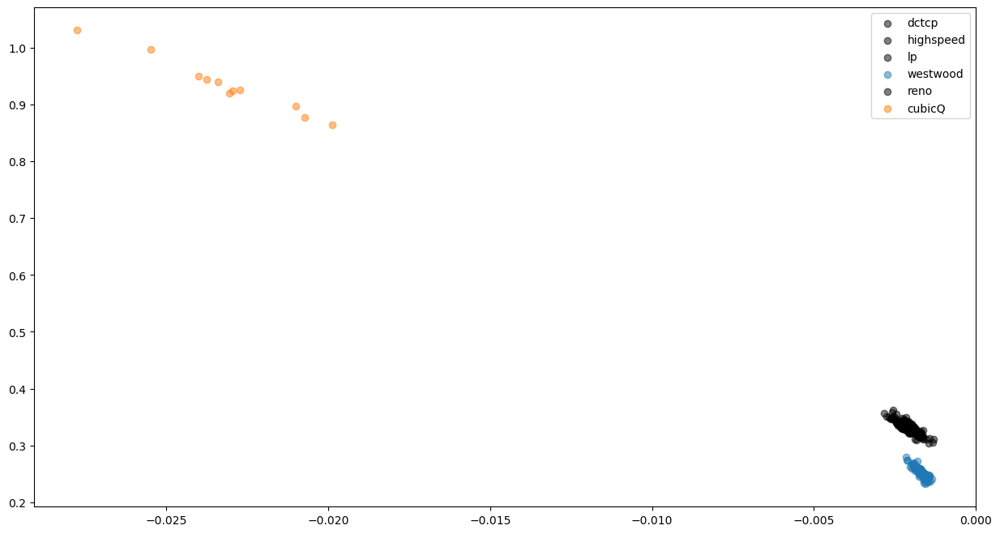

In [300]:
fig, ax = plt.subplots(1,1, figsize=(15,8))
for cc in cc_degree:
#     if cc == 'cubicQ':
#         continue
    if cc_degree[cc] == 2:
        x_points = []
        y_points = []
        for points in vals_cubicQ[cc][1]:
            x_points.append(points[0])
            y_points.append(points[1])
        if cc in ["dctcp", "lp", "reno","highspeed"]:
            color = "k"
            
            ax.scatter(x_points, y_points, label=cc,alpha=0.5, color=color)
        else :
            ax.scatter(x_points, y_points, label=cc,alpha=0.5)
    plt.legend()

#         else :
#             ax.scatter(x_points, y_points, label=cc,alpha=0.5)
#     plt.legend()
plt.show()

# Model Making Again

In [432]:
# Data 
ccs = []
labels = []
data = []
for cc in cc_degree:
    # choose the degree
    if cc_degree[cc] == 2:
        for points in vals_cubicQ[cc][1]:
            data.append(list(points))
        labels += [cc]*len(vals_cubicQ[cc][1])
        if cc not in ccs:
            ccs.append(cc)
print(len(data))
print(len(labels))

511
511


In [438]:
web_2 = []
for web in web_cc_mp:
    if web_cc_mp[web]['deg'] == 2:
        x_points = []
        y_points = []
        points = web_cc_mp[web]['coeff']
        web_2.append([points[0], points[1]])
web_2 = np.array(web_2)

In [69]:
labels_as_count = []
labels_to_count = {
    "dctcp" : 1,
    "reno" : 1,
    "lp" : 1,
    "highspeed" : 1,
    "westwood" : 2,
    "cubicQ" : 0 
}
count_to_labels = {}
for l in labels:
    labels_as_count.append(labels_to_count[l])
    if labels_to_count[l] not in count_to_labels.keys():
        count_to_labels[labels_to_count[l]] = l
        

In [314]:
coeff_to_web = {}
for w in web_cc_mp :
    co = web_cc_mp[w]['coeff']
    coeff_to_web[(co[0],co[1])] = w

In [70]:
len(labels_as_count)

511

In [372]:
#Scaling
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(data)
scaled_data = scaler.transform(data)
scaled_web_2 = scaler.transform(web_2)

In [373]:
scaled_data

array([[ 0.12737545,  0.06943279],
       [ 0.07939339,  0.07036438],
       [ 0.18972212, -0.04627532],
       ...,
       [-5.61962884,  5.59108319],
       [-6.88038392,  6.42682804],
       [-6.64964892,  6.17577189]])

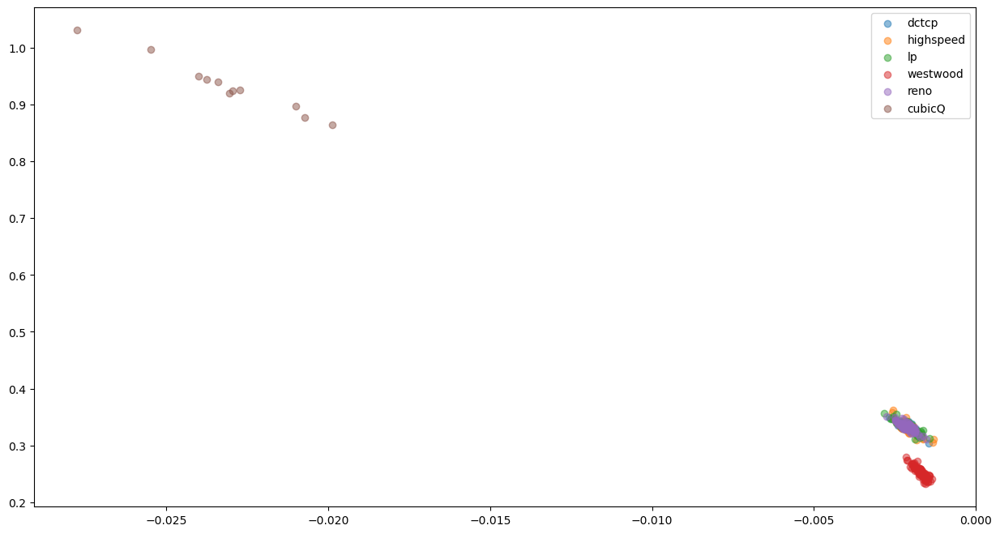

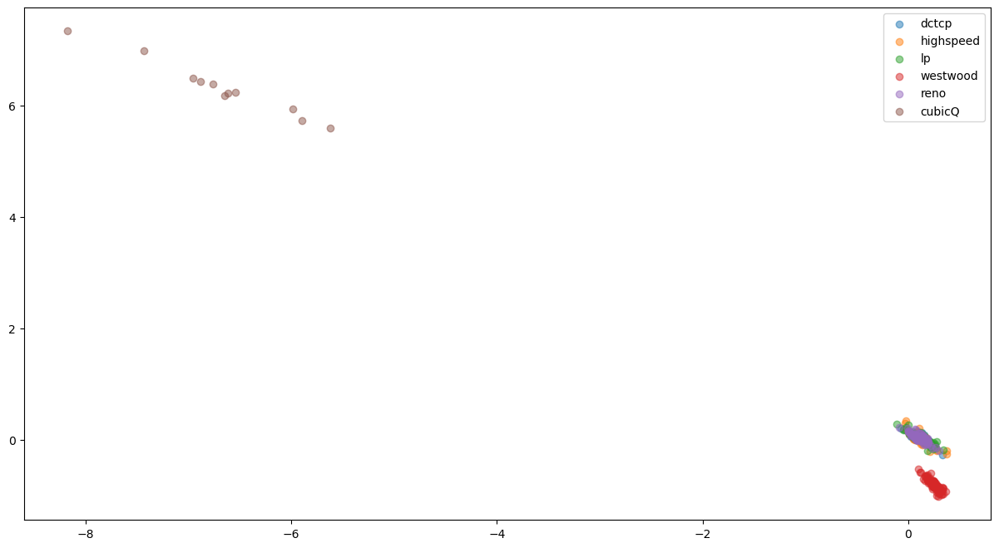

In [52]:
# Ploting Normal Vs Scaled
fig, ax = plt.subplots(1,1, figsize=(15,8))

for cc in ccs :
    x_ = []
    y_ = []
    for i in range(len(labels)):
        if labels[i] == cc:
            x_.append(data[i][0])
            y_.append(data[i][1])
    ax.scatter(x_,y_,label=cc, alpha=0.5)

plt.legend()
plt.show()

fig, ax = plt.subplots(1,1, figsize=(15,8))

for cc in ccs :
    x_ = []
    y_ = []
    for i in range(len(labels)):
        if labels[i] == cc:
            x_.append(scaled_data[i][0])
            y_.append(scaled_data[i][1])
    ax.scatter(x_,y_,label=cc, alpha=0.5)

plt.legend()
plt.show()

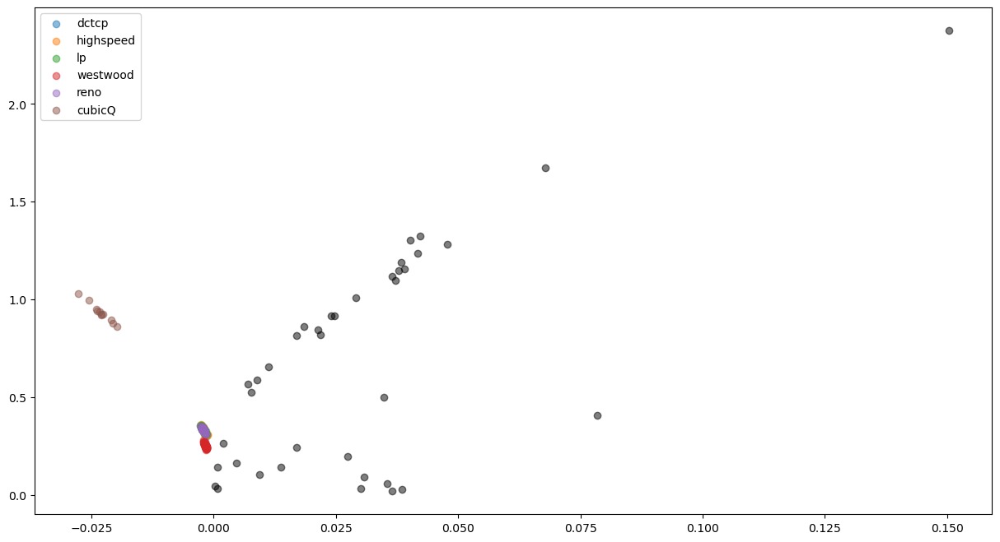

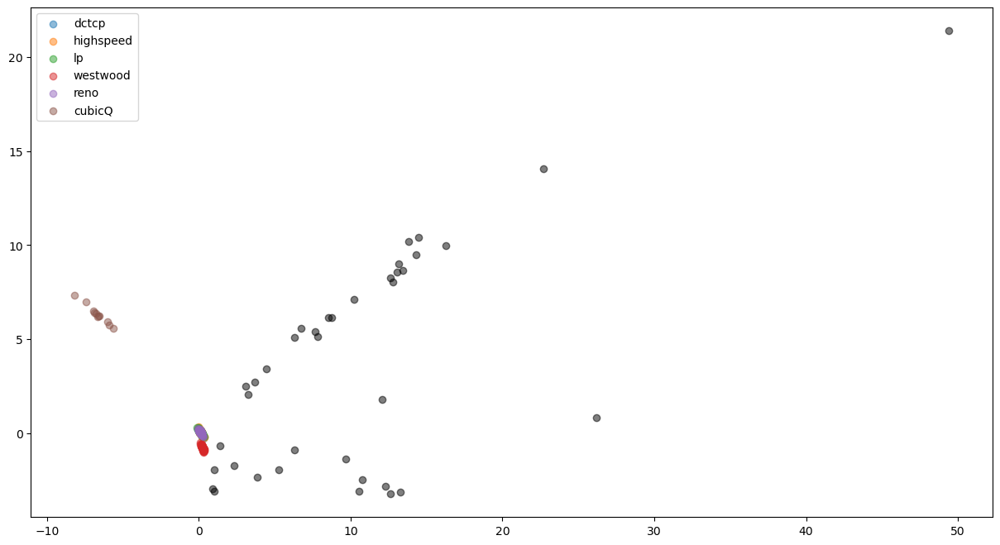

In [130]:
# Ploting Normal Vs Scaled
fig, ax = plt.subplots(1,1, figsize=(15,8))

for cc in ccs :
    x_ = []
    y_ = []
    for i in range(len(labels)):
        if labels[i] == cc:
            x_.append(data[i][0])
            y_.append(data[i][1])
    ax.scatter(x_,y_,label=cc, alpha=0.5)


ax.scatter(web_2[:,0],web_2[:,1],color='k', alpha=0.5)


plt.legend()
plt.show()

fig, ax = plt.subplots(1,1, figsize=(15,8))

for cc in ccs :
    x_ = []
    y_ = []
    for i in range(len(labels)):
        if labels[i] == cc:
            x_.append(scaled_data[i][0])
            y_.append(scaled_data[i][1])
    ax.scatter(x_,y_,label=cc, alpha=0.5)

ax.scatter(scaled_web_2[:,0],scaled_web_2[:,1],color='k', alpha=0.5)


plt.legend()
plt.show()

In [55]:
from scipy import stats

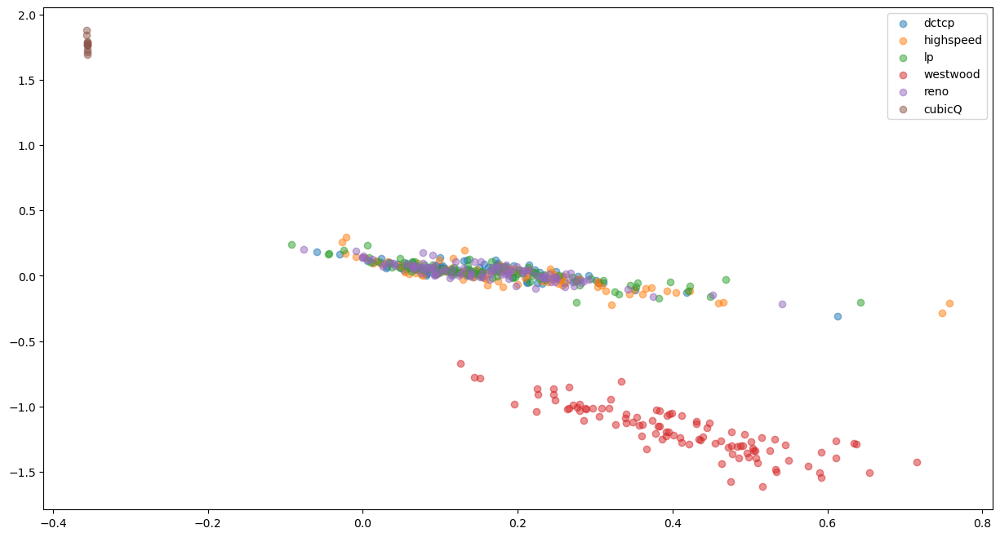

In [125]:
x_data = [p[0] for p in scaled_data]
y_data = [p[1] for p in scaled_data]
x_data, lt = stats.yeojohnson(x_data)
y_data, lt = stats.yeojohnson(y_data)
yj_data = []
for i in range(len(x_data)):
    yj_data.append([x_data[i],y_data[i]])
yj_data = np.array(yj_data)
fig, ax = plt.subplots(1,1, figsize=(15,8))

for cc in ccs :
    x_ = []
    y_ = []
    for i in range(len(labels)):
        if labels[i] == cc:
            x_.append(x_data[i])
            y_.append(y_data[i])
    ax.scatter(x_,y_,label=cc, alpha=0.5)

plt.legend()
plt.show()


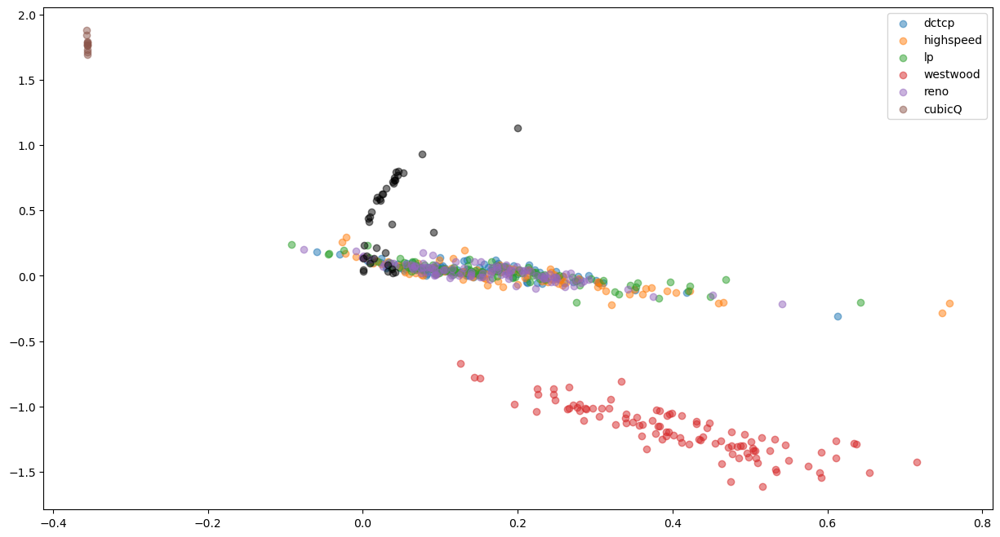

In [124]:
x_data = [p[0] for p in scaled_data]
y_data = [p[1] for p in scaled_data]
x_data, lt_x = stats.yeojohnson(x_data)
y_data, lt_y = stats.yeojohnson(y_data)
yj_data = []
for i in range(len(x_data)):
    yj_data.append([x_data[i],y_data[i]])
yj_data = np.array(yj_data)
fig, ax = plt.subplots(1,1, figsize=(15,8))

for cc in ccs :
    x_ = []
    y_ = []
    for i in range(len(labels)):
        if labels[i] == cc:
            x_.append(x_data[i])
            y_.append(y_data[i])
    ax.scatter(x_,y_,label=cc, alpha=0.5)

    
web_2_x = [p[0] for p in web_2]
web_2_y = [p[1] for p in web_2]

x_data = stats.yeojohnson(web_2_x, lmbda=lt_x)
y_data = stats.yeojohnson(web_2_y, lmbda=lt_y)
yj_web_2 = []
for i in range(len(x_data)):
    yj_web_2.append([x_data[i],y_data[i]])

yj_web_2 = np.array(yj_web_2)

ax.scatter(yj_web_2[:,0],yj_web_2[:,1],color='k', alpha=0.5)
plt.legend()
plt.show()


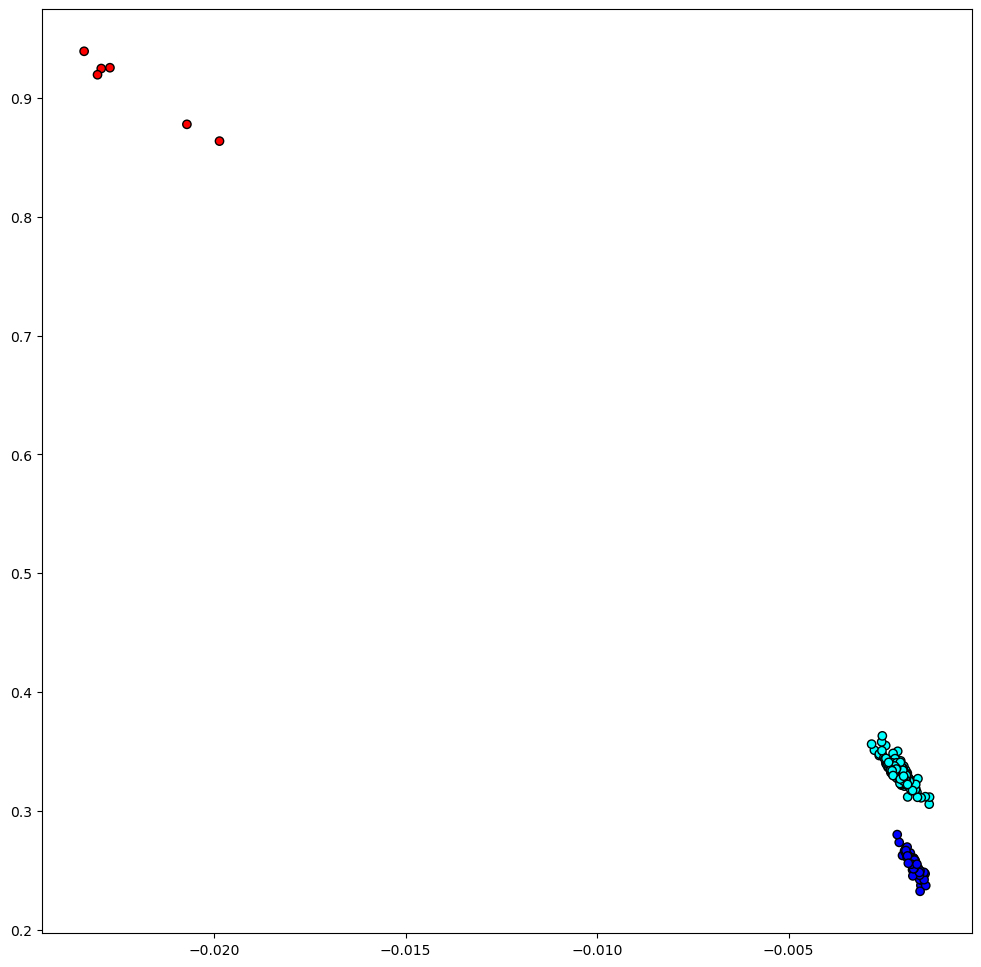

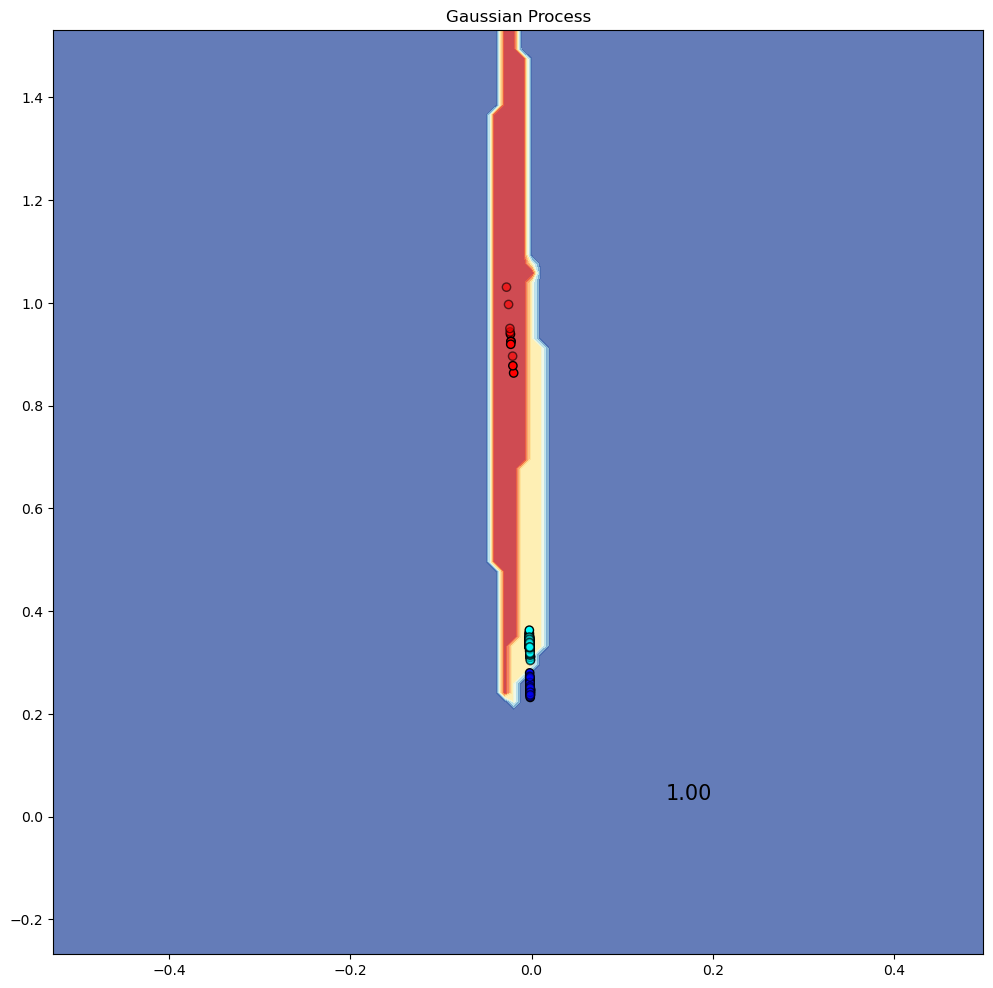

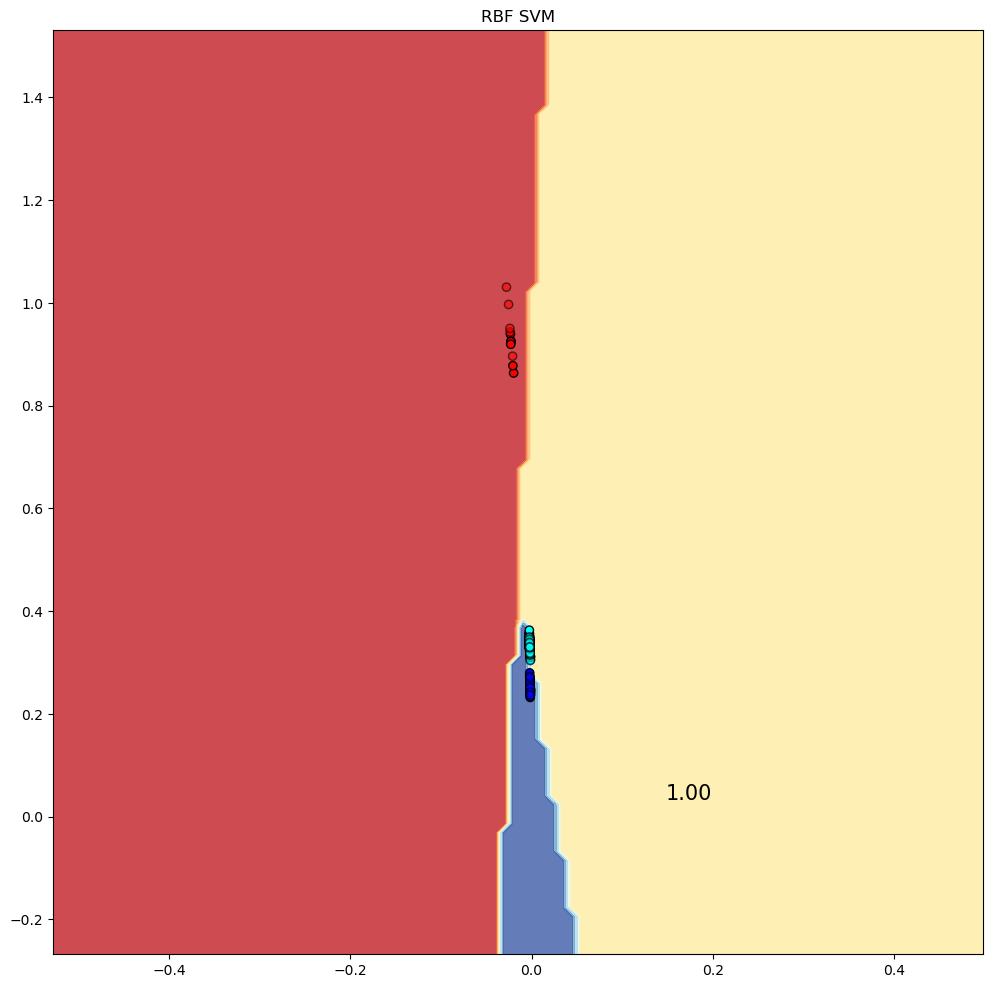

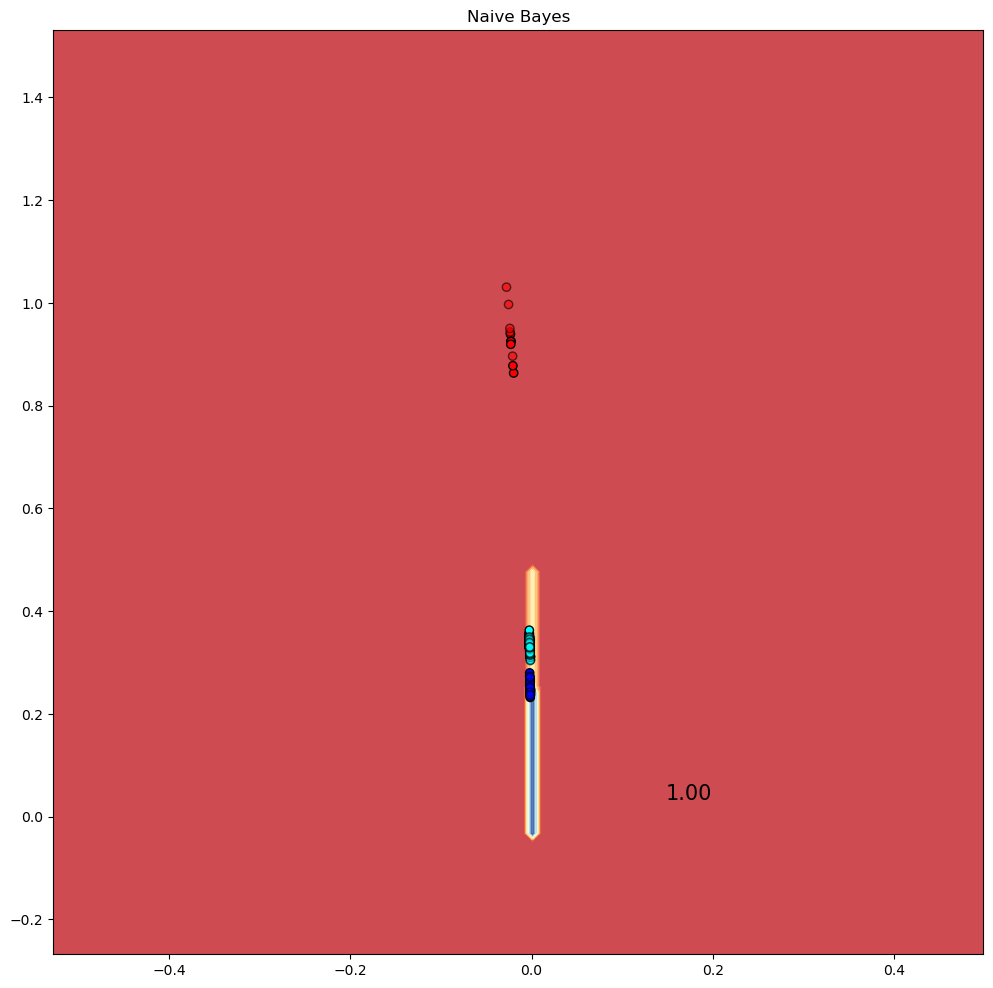

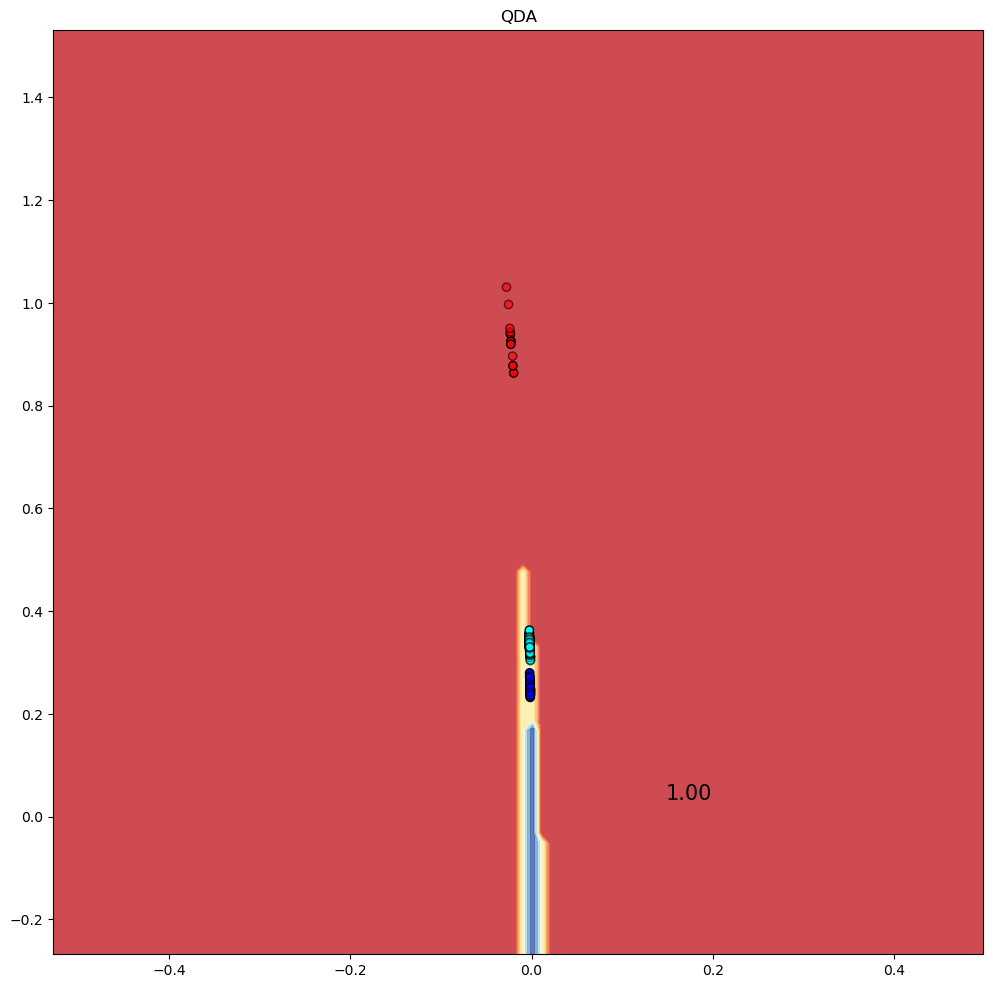

In [85]:
from sklearn.inspection import DecisionBoundaryDisplay
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline

names = [
    "Gaussian Process",
    "RBF SVM",
    "Naive Bayes",
    "QDA",
]
classifiers = [
    GaussianProcessClassifier(random_state=42),
    SVC(kernel="linear",random_state=42),
    GaussianNB(),
    QuadraticDiscriminantAnalysis()
]
X = np.array(data)
y = np.array(labels_as_count)



X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5

cm_bright = ListedColormap(["#FF0000", "#00FFFF", "#0000FF"])
cm = plt.cm.RdYlBu
i = 1

figure = plt.figure(figsize=(12, 12))
ax = plt.axes()

ax.scatter(
    X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright, edgecolors="k"
)

for name, clf in zip(names, classifiers):
    figure = plt.figure(figsize=(12, 12))
    ax = plt.axes()
#     ax = plt.subplot(1, len(classifiers) + 1,i)

    clf = make_pipeline(StandardScaler(), clf)
    clf.fit(X_train, y_train)
    score = clf.score(X_test, y_test)
    DecisionBoundaryDisplay.from_estimator(
        clf, X, cmap=cm, alpha=0.8, ax=ax, eps=0.5
    )

    # Plot the training points
    ax.scatter(
        X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright, edgecolors="k"
    )
    # Plot the testing points
    ax.scatter(
        X_test[:, 0],
        X_test[:, 1],
        c=y_test,
        cmap=cm_bright,
        edgecolors="k",
        alpha=0.6,
    )
#     ax.set_xlim(x_min, x_max)
#     ax.set_ylim(y_min, y_max)
#     ax.set_xticks(())
#     ax.set_yticks(())
#     if ds_cnt == 0:
    ax.set_title(name)
    ax.text(
        x_max - 0.3,
        y_min + 0.3,
        ("%.2f" % score).lstrip("0"),
        size=15,
        horizontalalignment="right",
    )
    i+=1
plt.show()


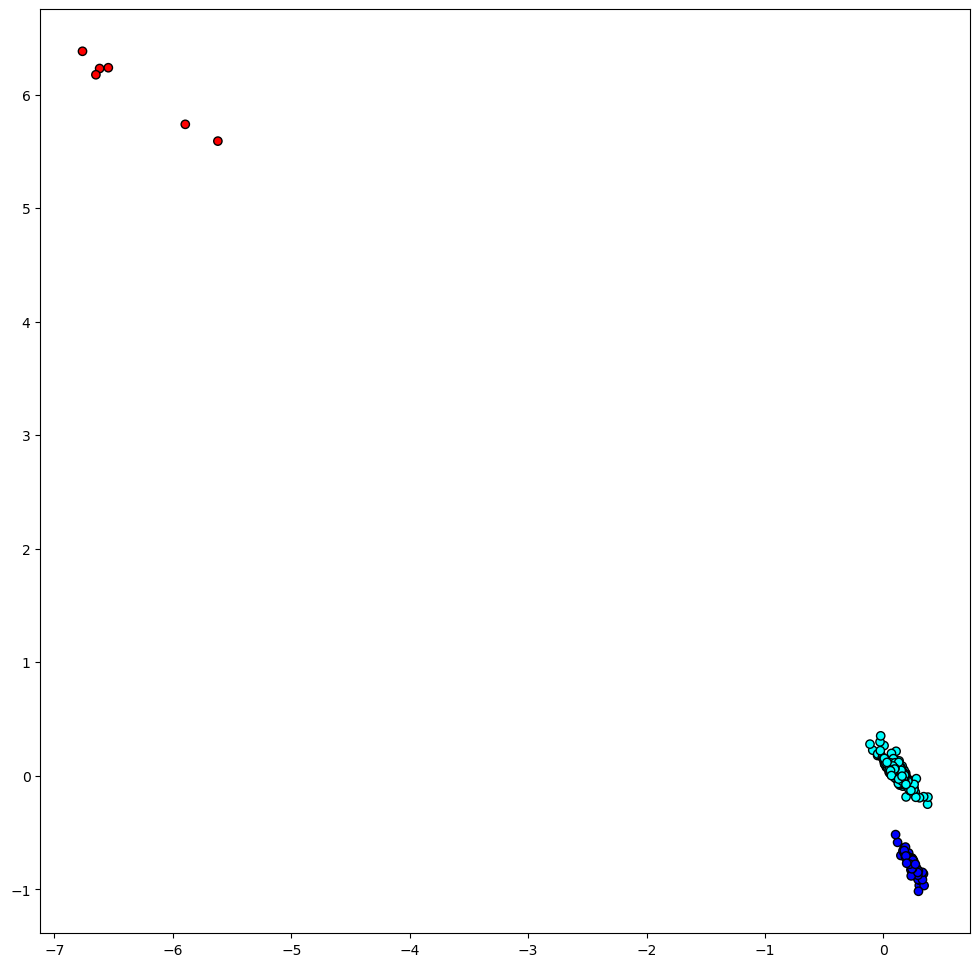

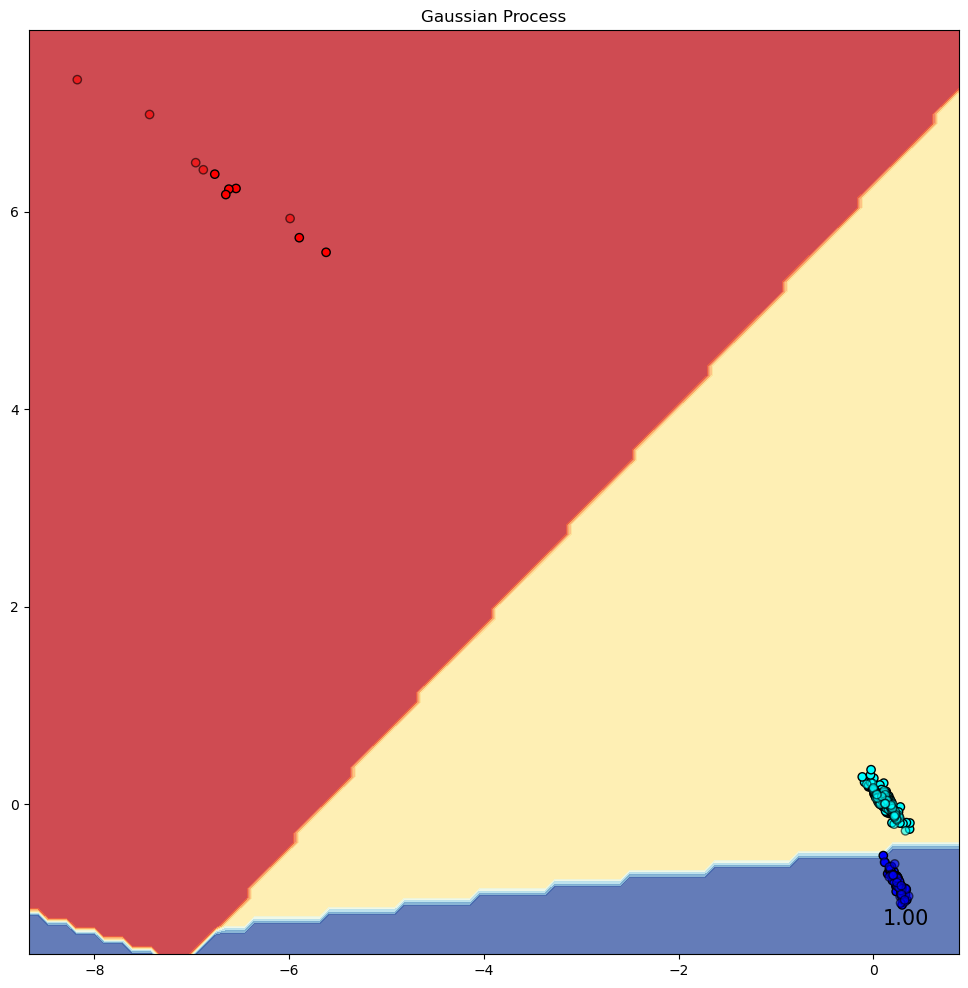

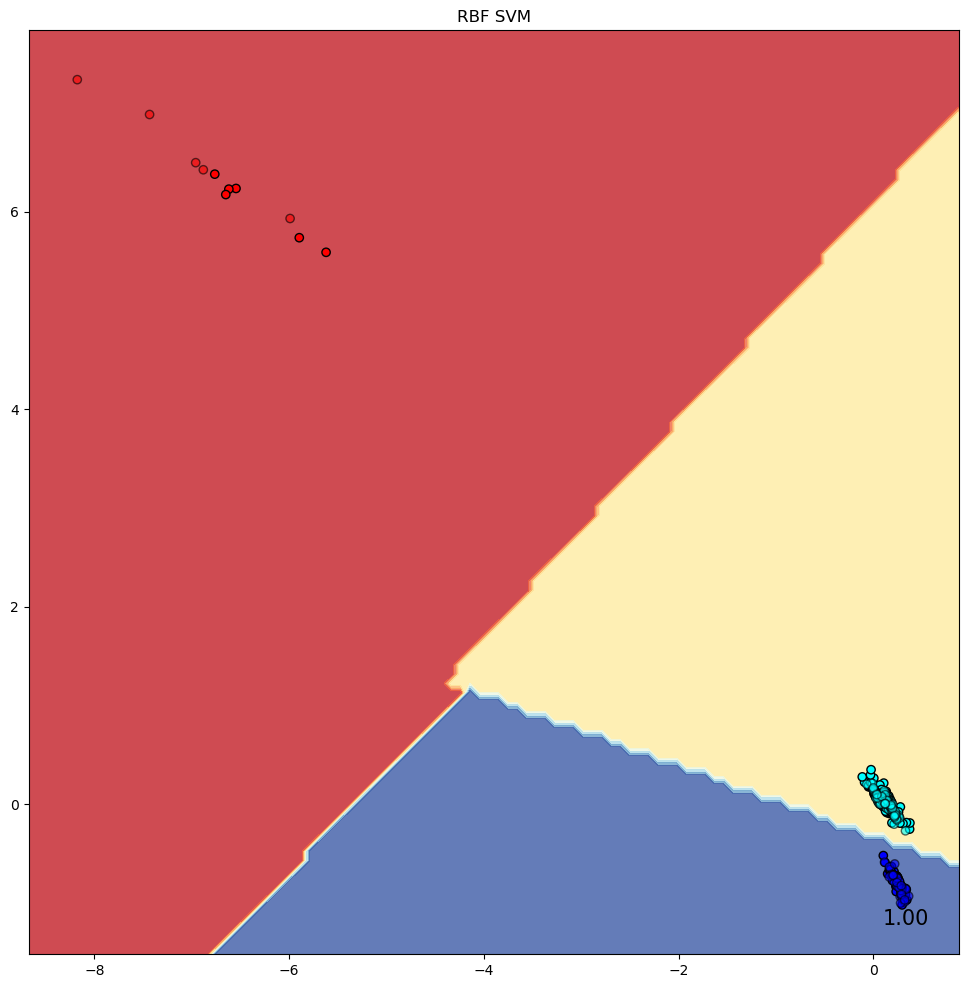

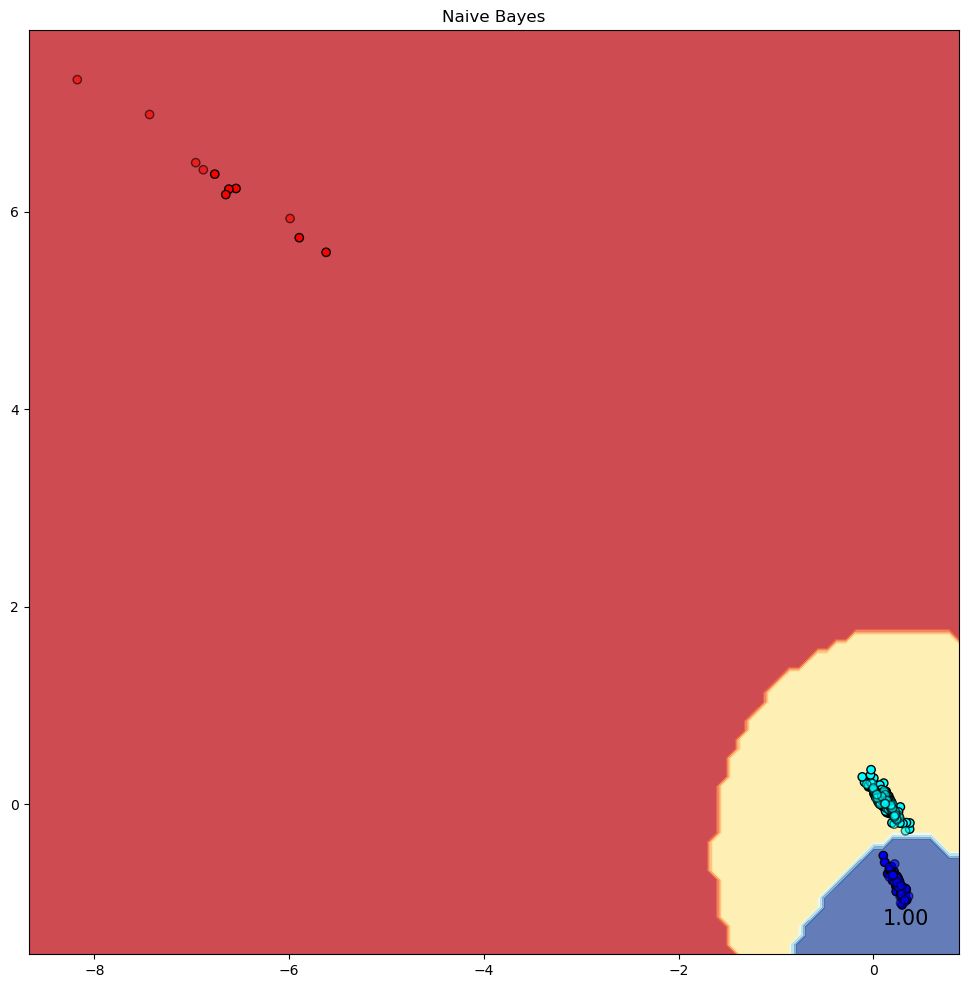

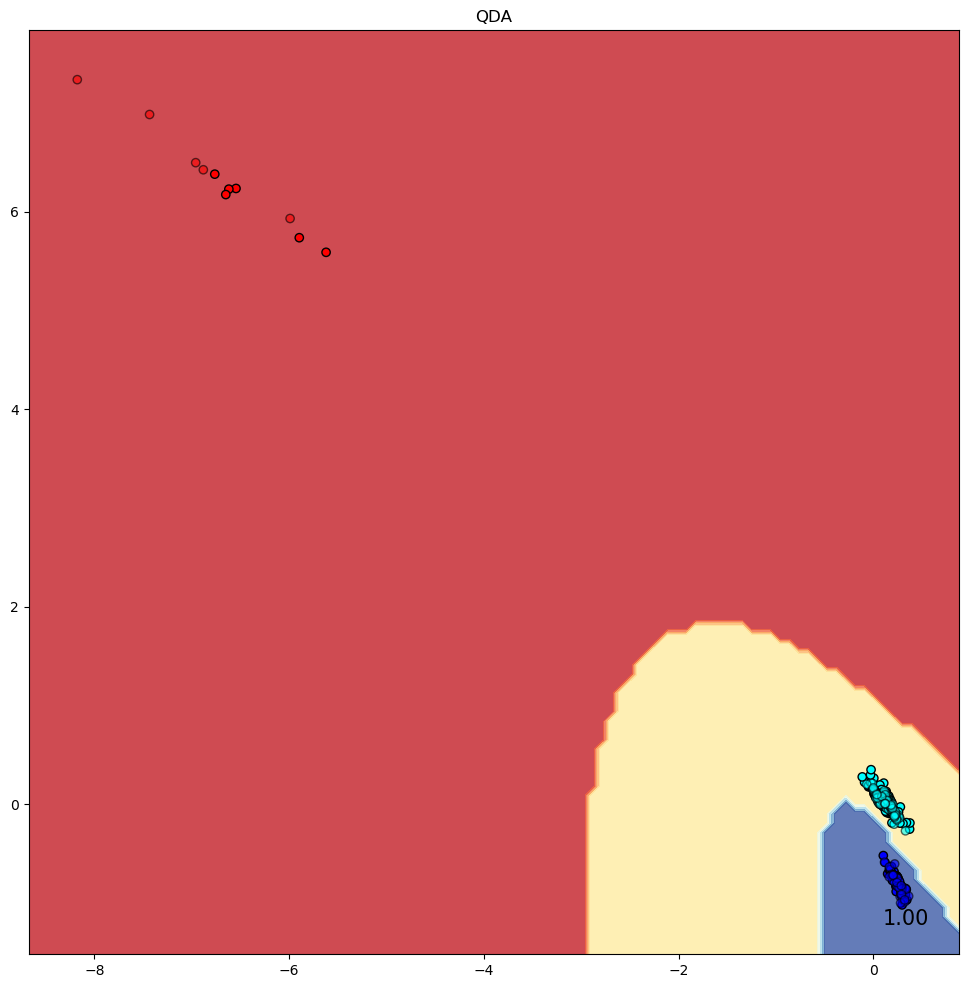

In [86]:
from sklearn.inspection import DecisionBoundaryDisplay
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline

names = [
    "Gaussian Process",
    "RBF SVM",
    "Naive Bayes",
    "QDA",
]
classifiers = [
    GaussianProcessClassifier(random_state=42),
    SVC(kernel="linear",random_state=42),
    GaussianNB(),
    QuadraticDiscriminantAnalysis()
]
X = np.array(scaled_data)
y = np.array(labels_as_count)



X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5

cm_bright = ListedColormap(["#FF0000", "#00FFFF", "#0000FF"])
cm = plt.cm.RdYlBu
i = 1

figure = plt.figure(figsize=(12, 12))
ax = plt.axes()

ax.scatter(
    X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright, edgecolors="k"
)

for name, clf in zip(names, classifiers):
    figure = plt.figure(figsize=(12, 12))
    ax = plt.axes()
#     ax = plt.subplot(1, len(classifiers) + 1,i)

    clf = make_pipeline(StandardScaler(), clf)
    clf.fit(X_train, y_train)
    score = clf.score(X_test, y_test)
    DecisionBoundaryDisplay.from_estimator(
        clf, X, cmap=cm, alpha=0.8, ax=ax, eps=0.5
    )

    # Plot the training points
    ax.scatter(
        X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright, edgecolors="k"
    )
    # Plot the testing points
    ax.scatter(
        X_test[:, 0],
        X_test[:, 1],
        c=y_test,
        cmap=cm_bright,
        edgecolors="k",
        alpha=0.6,
    )
#     ax.set_xlim(x_min, x_max)
#     ax.set_ylim(y_min, y_max)
#     ax.set_xticks(())
#     ax.set_yticks(())
#     if ds_cnt == 0:
    ax.set_title(name)
    ax.text(
        x_max - 0.3,
        y_min + 0.3,
        ("%.2f" % score).lstrip("0"),
        size=15,
        horizontalalignment="right",
    )
    i+=1
plt.show()


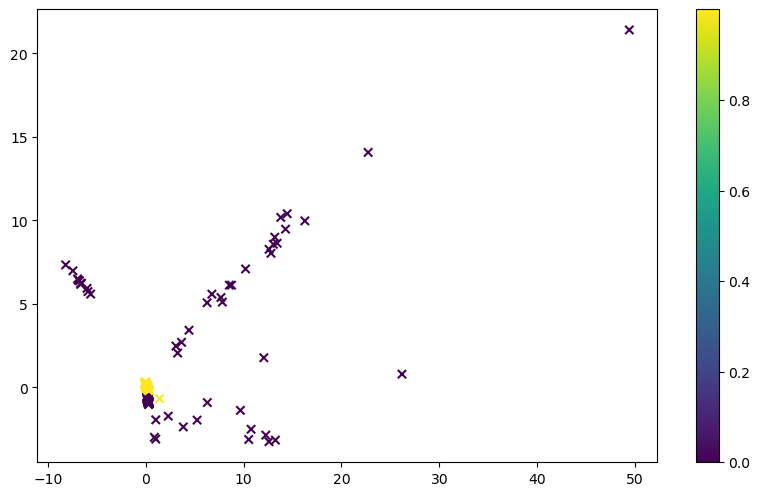

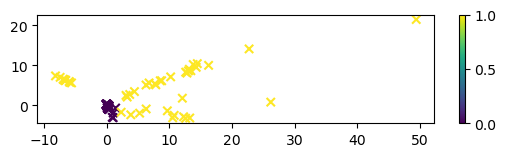

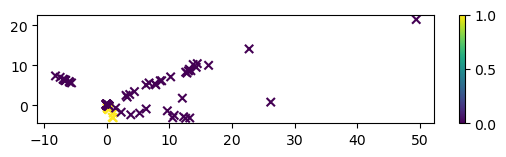

In [391]:
from sklearn.mixture import GaussianMixture

X = np.array(scaled_data)
y = np.array(labels_as_count)
web_data = scaled_web_2
gm = GaussianMixture(n_components = 3, covariance_type = 'full', random_state=0, )
gm.fit(X)

plt.figure(figsize=(10,20))
for i in range(3):
    plt.subplot(3,1,i+1)
    plt.scatter(X[:,0],X[:,1],c=gm.predict_proba(X)[:,i],cmap='viridis',marker='x')
    plt.scatter(web_data[:,0],web_data[:,1],c=gm.predict_proba(web_data)[:,i],cmap='viridis',marker='x')
    plt.colorbar()
#     plt.show()
prob = gm.predict_proba(web_data)
val = []
# for i in prob :
#     val.append(1-((1-i[0])*(1-i[1])*(1-i[2])))
# plt.plot(val)
# print(val)

In [ ]:
from sklearn.mixture import GaussianMixture

X = np.array(scaled_data)
y = np.array(labels_as_count)
web_data = scaled_web_2
gm = GaussianMixture(n_components = 3, covariance_type = 'full', random_state=0, )
gm.fit(X)

plt.figure(figsize=(10,20))
for i in range(3):
    plt.subplot(3,1,i+1)
    plt.scatter(X[:,0],X[:,1],c=gm.predict_proba(X)[:,i],cmap='viridis',marker='x')
    plt.scatter(web_data[:,0],web_data[:,1],c=gm.predict_proba(web_data)[:,i],cmap='viridis',marker='x')
    plt.colorbar()
#     plt.show()
prob = gm.predict_proba(web_data)
val = []
# for i in prob :
#     val.append(1-((1-i[0])*(1-i[1])*(1-i[2])))
# plt.plot(val)
# print(val)

In [ ]:
def make_ellipses(gmm, ax):
    for n, color in enumerate(colors):
        if gmm.covariance_type == "full":
            covariances = gmm.covariances_[n][:2, :2]
        elif gmm.covariance_type == "tied":
            covariances = gmm.covariances_[:2, :2]
        elif gmm.covariance_type == "diag":
            covariances = np.diag(gmm.covariances_[n][:2])
        elif gmm.covariance_type == "spherical":
            covariances = np.eye(gmm.means_.shape[1]) * gmm.covariances_[n]
        v, w = np.linalg.eigh(covariances)
        u = w[0] / np.linalg.norm(w[0])
        angle = np.arctan2(u[1], u[0])
        angle = 180 * angle / np.pi  # convert to degrees
        v = 2.0 * np.sqrt(2.0) * np.sqrt(v)
        ell = mpl.patches.Ellipse(
            gmm.means_[n, :2], v[0], v[1], angle=180 + angle, color=color
        )
        ell.set_clip_box(ax.bbox)
        ell.set_alpha(0.5)
        ax.add_artist(ell)
        ax.set_aspect("equal", "datalim")
        
from sklearn.mixture import GaussianMixture
X = np.array(scaled_data)
y = np.array(labels_as_count)

n_classes = 3

estimators = {
    cov_type: GaussianMixture(
        n_components=n_classes, covariance_type=cov_type, max_iter=100, random_state=0
    )
    for cov_type in ["spherical", "diag", "tied", "full"]
}

for index, (name, estimator) in enumerate(estimators.items()):
    # Since we have class labels for the training data, we can
    # initialize the GMM parameters in a supervised manner.
    estimator.means_init = np.array(
        [X_train[y_train == i].mean(axis=0) for i in range(n_classes)]
    )

    # Train the other parameters using the EM algorithm.
    estimator.fit(X_train)

    h = plt.subplot(2, n_estimators // 2, index + 1)
    make_ellipses(estimator, h)

    for n, color in enumerate(colors):
        data = iris.data[iris.target == n]
        plt.scatter(
            data[:, 0], data[:, 1], s=0.8, color=color, label=iris.target_names[n]
        )
    # Plot the test data with crosses
    for n, color in enumerate(colors):
        data = X_test[y_test == n]
        plt.scatter(data[:, 0], data[:, 1], marker="x", color=color)

    y_train_pred = estimator.predict(X_train)
    train_accuracy = np.mean(y_train_pred.ravel() == y_train.ravel()) * 100
    plt.text(0.05, 0.9, "Train accuracy: %.1f" % train_accuracy, transform=h.transAxes)

    y_test_pred = estimator.predict(X_test)
    test_accuracy = np.mean(y_test_pred.ravel() == y_test.ravel()) * 100
    plt.text(0.05, 0.8, "Test accuracy: %.1f" % test_accuracy, transform=h.transAxes)

    plt.xticks(())
    plt.yticks(())
    plt.title(name)

plt.legend(scatterpoints=1, loc="lower right", prop=dict(size=12))


plt.show()
gm = GaussianMixture(n_components = 3, covariance_type = 'full', random_state=0, )
gm.fit(X_train)

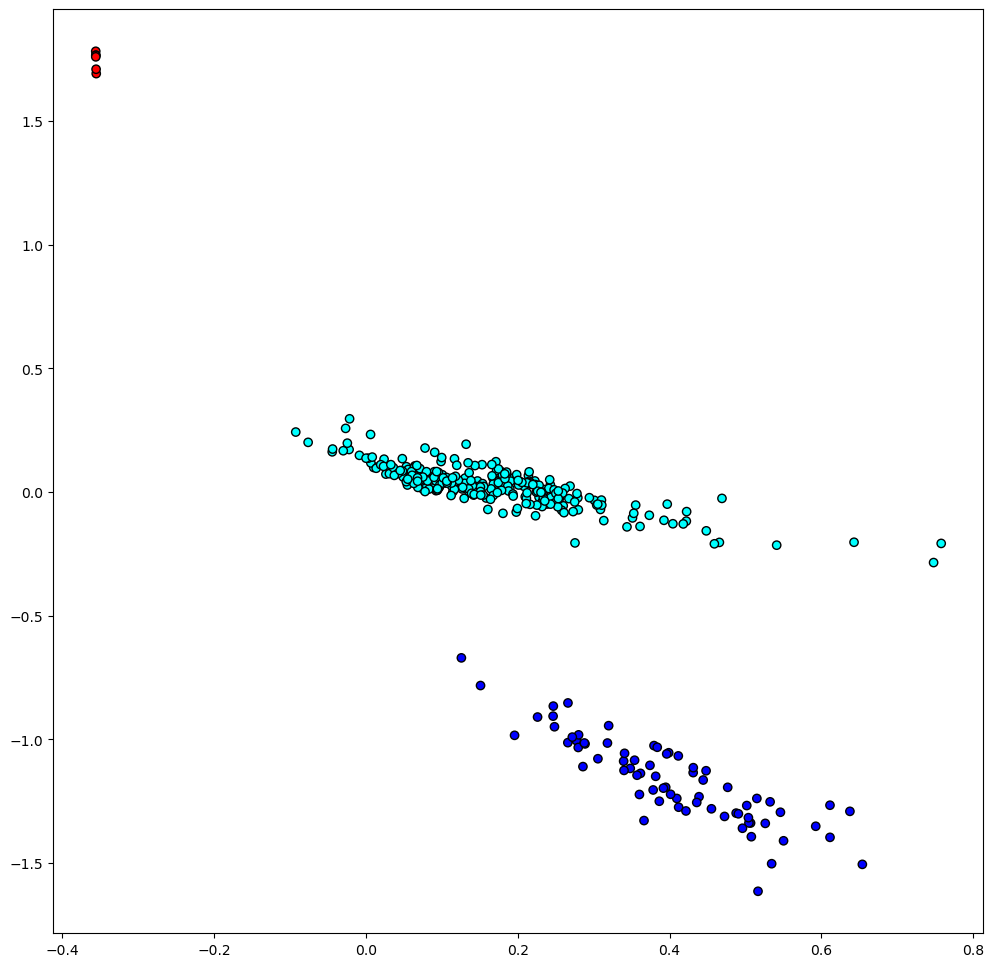

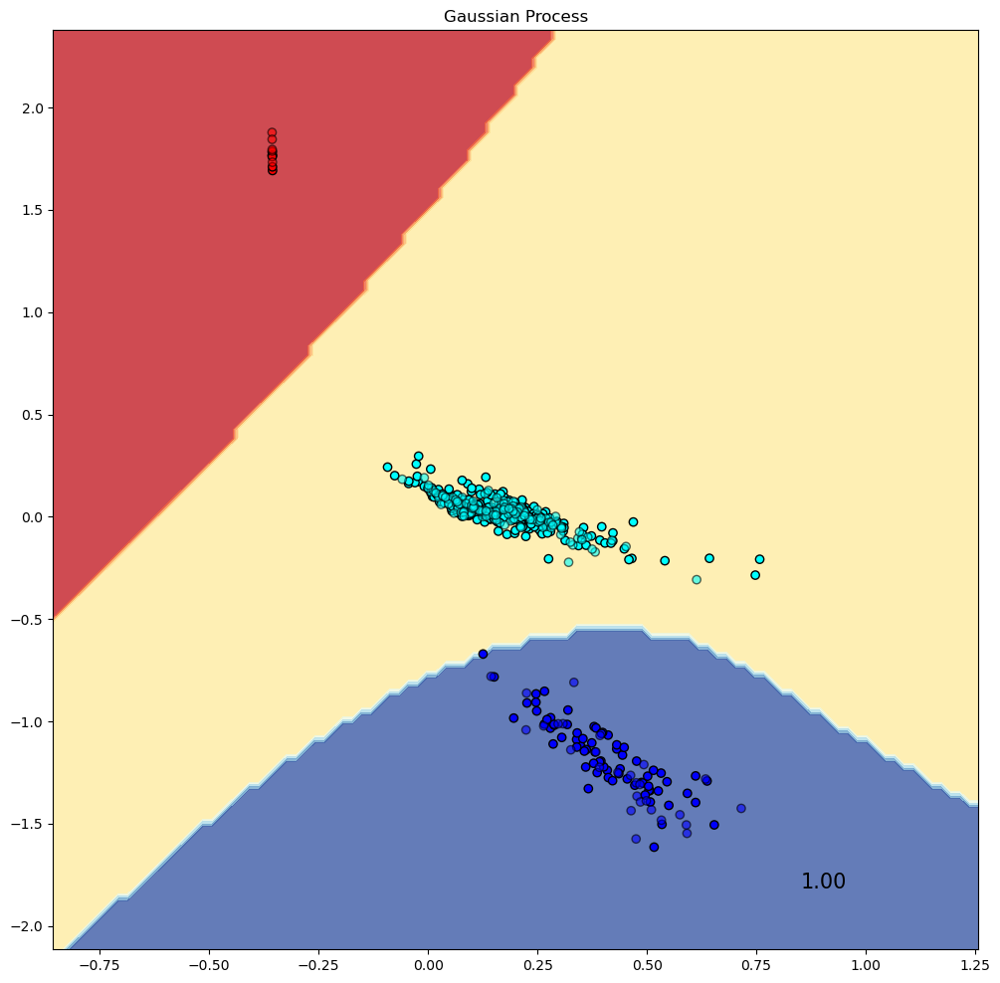

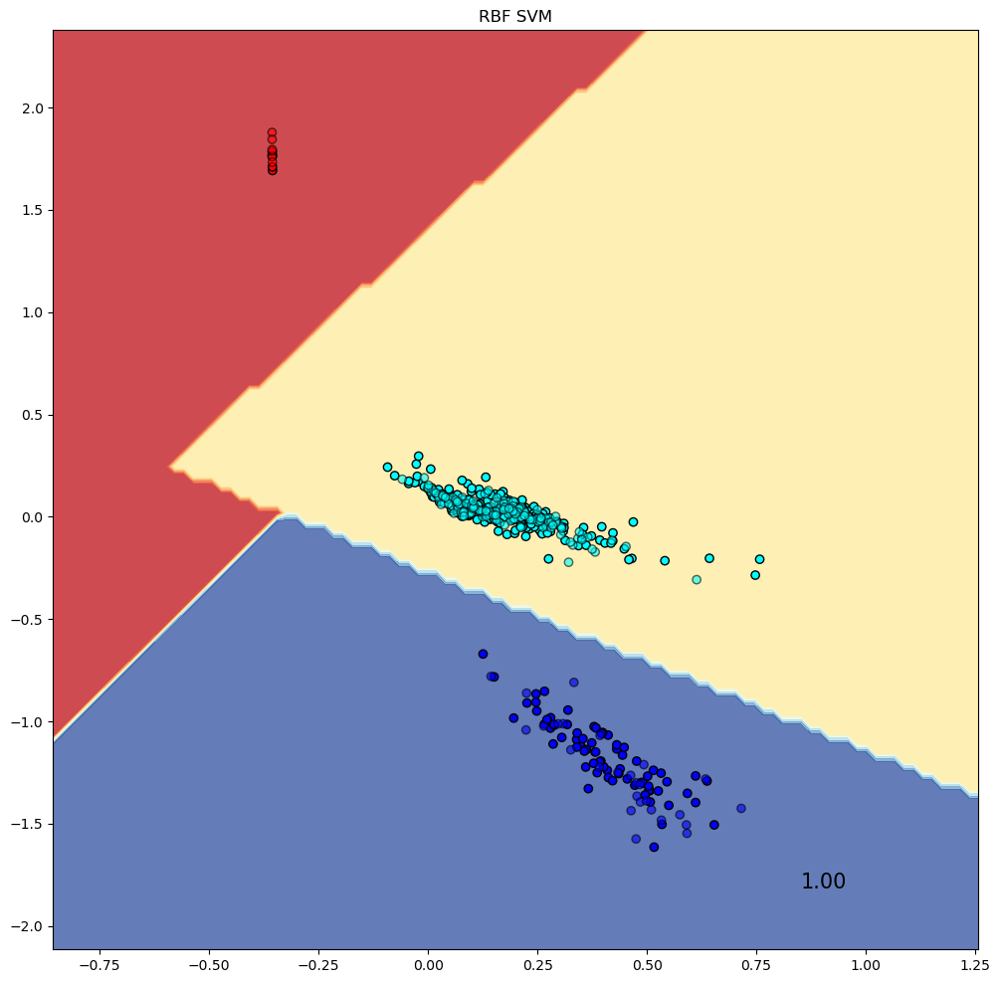

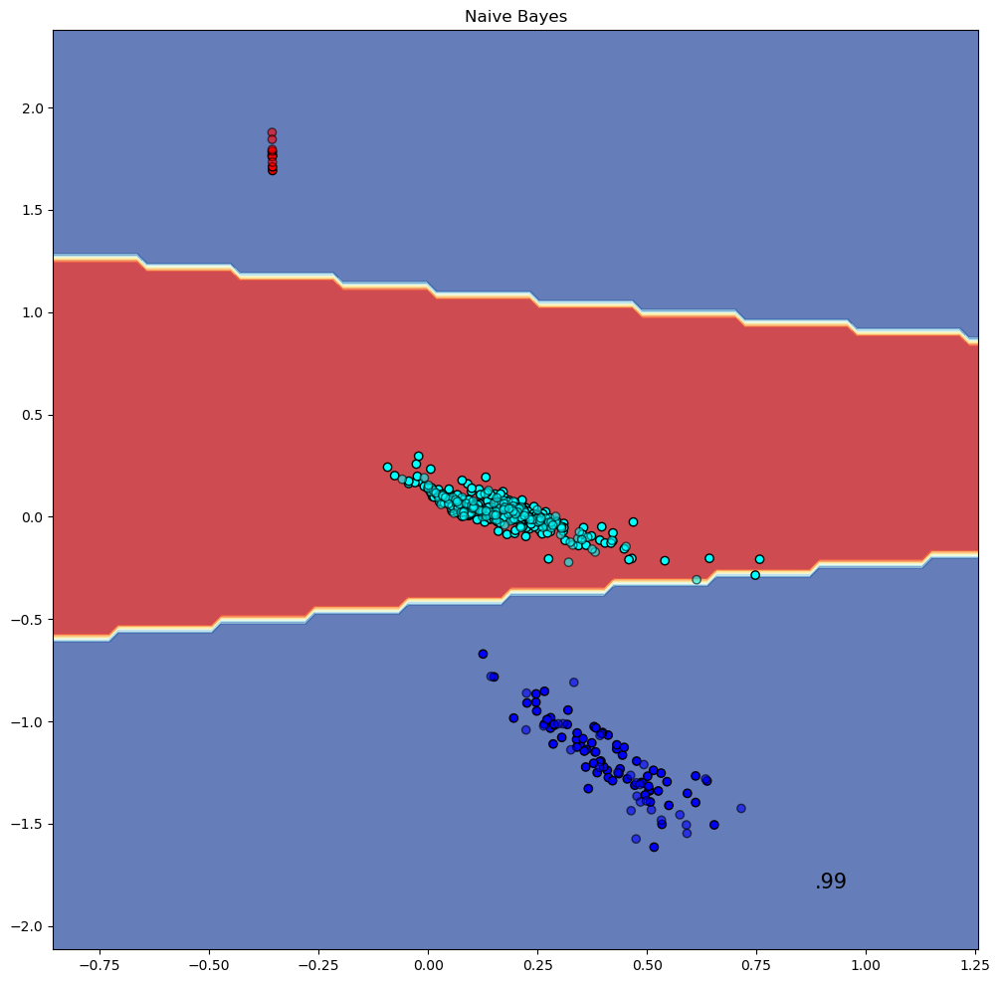

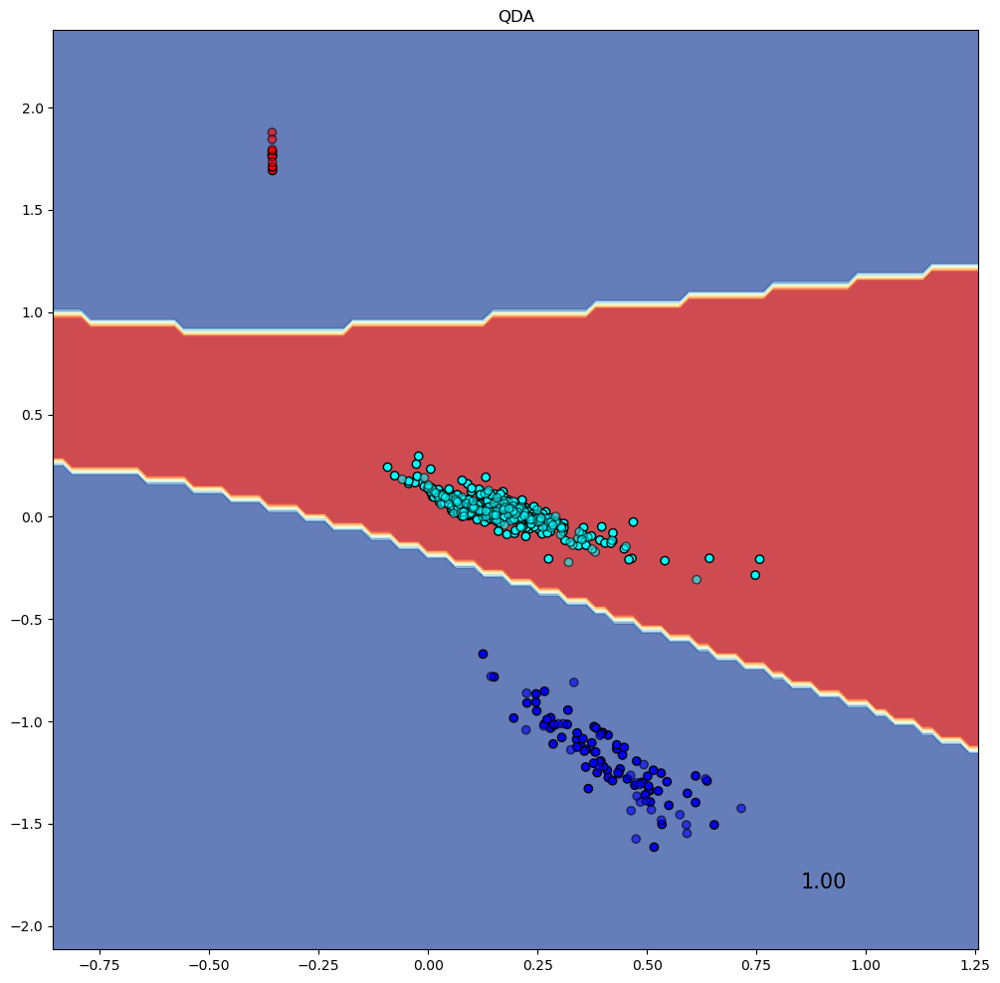

In [91]:
from sklearn.inspection import DecisionBoundaryDisplay
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline

names = [
    "Gaussian Process",
    "RBF SVM",
    "Naive Bayes",
    "QDA",
]
classifiers = [
    GaussianProcessClassifier(random_state=42),
    SVC(kernel="linear",random_state=42),
    GaussianNB(),
    QuadraticDiscriminantAnalysis()
]
X = np.array(yj_data)
y = np.array(labels_as_count)



X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5

cm_bright = ListedColormap(["#FF0000", "#00FFFF", "#0000FF"])
cm = plt.cm.RdYlBu
i = 1

figure = plt.figure(figsize=(12, 12))
ax = plt.axes()

ax.scatter(
    X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright, edgecolors="k"
)

for name, clf in zip(names, classifiers):
    figure = plt.figure(figsize=(12, 12))
    ax = plt.axes()
#     ax = plt.subplot(1, len(classifiers) + 1,i)

    clf = make_pipeline(StandardScaler(), clf)
    clf.fit(X_train, y_train)
    score = clf.score(X_test, y_test)
    DecisionBoundaryDisplay.from_estimator(
        clf, X, cmap=cm, alpha=0.8, ax=ax, eps=0.5
    )

    # Plot the training points
    ax.scatter(
        X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright, edgecolors="k"
    )
    # Plot the testing points
    ax.scatter(
        X_test[:, 0],
        X_test[:, 1],
        c=y_test,
        cmap=cm_bright,
        edgecolors="k",
        alpha=0.6,
    )
#     ax.set_xlim(x_min, x_max)
#     ax.set_ylim(y_min, y_max)
#     ax.set_xticks(())
#     ax.set_yticks(())
#     if ds_cnt == 0:
    ax.set_title(name)
    ax.text(
        x_max - 0.3,
        y_min + 0.3,
        ("%.2f" % score).lstrip("0"),
        size=15,
        horizontalalignment="right",
    )
    i+=1
plt.show()


In [434]:
web_2 = []
for web in web_cc_mp:
    if web_cc_mp[web]['deg'] == 2:
        x_points = []
        y_points = []
        points = web_cc_mp[web]['coeff']
        web_2.append([points[0], points[1]])
web_2 = np.array(web_2)

In [400]:
def is_pos_def(A):
    if np.allclose(A, A.T):
        try:
            np.linalg.cholesky(A)
            return True
        except np.linalg.LinAlgError:
            return False
    else:
        return False 

from scipy.stats import chi2

In [447]:
count_to_labels

{1: 'dctcp', 2: 'westwood', 0: 'cubicQ'}

0 cubicQ
0 12780.5831477714 False
1 14940.36548869047 False
2 12083.544506258551 False
3 48436.19681344233 False
4 54122.176713693654 False
5 1309.6643402593513 False
6 3198.511255157752 False
7 2085.505991484869 False
8 37330.88735485484 False
9 1139.6439568807746 False
10 15157.321461008216 False
11 508.1766043190969 True -----
12 56148.82437048198 False
13 20902.83589711135 False
14 179429.2481920384 False
15 56623.805634090415 False
16 4215.751961820814 False
17 4248.490457433107 False
18 3743.9007200771143 False
19 5043.556243204449 False
20 514.9440969763095 True -----
21 65616.20992262448 False
22 3021.470767663438 False
23 3366.466963237822 False
24 644.4704390062718 True -----
25 658125.2378996946 False
26 2452.1702907241506 False
27 267.0446992325981 True -----
28 785.7580155357814 True -----
29 2150.526170483283 False
30 41681.61820560285 False
31 15374.339936924733 False
32 62572.55751442116 False
33 34119.41881134509 False
34 2839.6133206211553 False
35 999.9569827366831 T

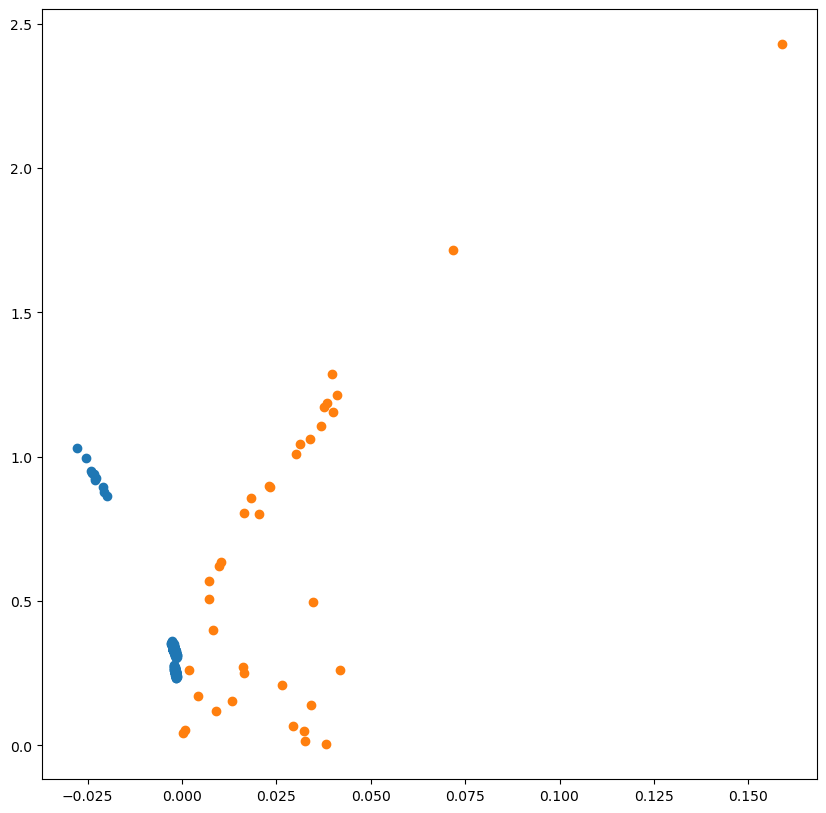

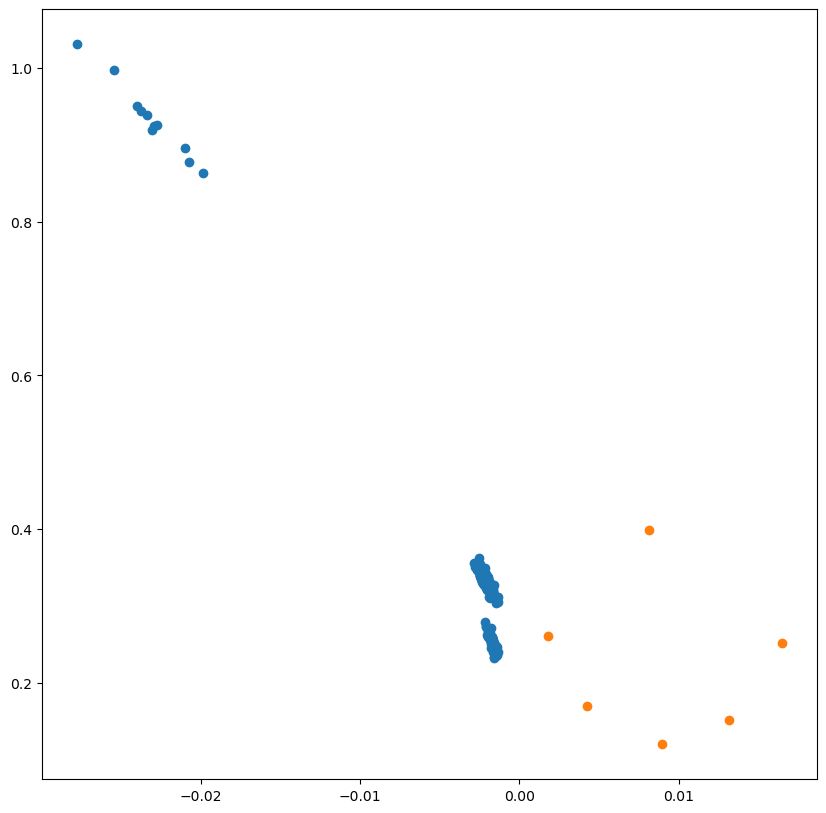

In [522]:
use_vals = []

for i in count_to_labels.keys(): 
    if i in [1,2]:
        continue
    print(i, count_to_labels[i])
    count = i
    X = []
    y = []
    for n in range(len(data)):
        if labels_as_count[n] == i:
            X.append(data[n])
            y.append(labels_as_count[n])
    x = np.array(X)
    y = np.array(y)
    web_data_use = np.array(web_2)
    x_mean = x.mean(axis=0)
    x_covar = np.cov(x, rowvar=False)
    x_covar_inv = np.linalg.inv(x_covar)
    x_diff = web_data_use - x_mean
    md = []
    for i in range(len(x_diff)):
        md.append(x_diff[i].dot(x_covar_inv).dot(x_diff[i]))
    
    p = 1 - chi2.cdf(md, 2)
    ind = []
    thresh = 1000
    
    for i in range(len(md)):
        if md[i] < thresh:
            ind.append(i)
#             print(black)
            print(i,md[i],md[i]<thresh,"-----")
            use_vals.append(i)
        else :
#             print(red)
            print(i,md[i],md[i]<thresh)

fig = plt.figure(figsize = (10,10))
plt.scatter(np.array(data)[:,0], np.array(data)[:,1])
new_data = np.array([web_2[i] for i in set(use_vals)])
plt.scatter(web_2[:,0], web_2[:,1])

            
fig = plt.figure(figsize = (10,10))
plt.scatter(np.array(data)[:,0], np.array(data)[:,1])
new_data = np.array([web_2[i] for i in set(use_vals)])
plt.scatter(new_data[:,0], new_data[:,1])
# for cc in count_to_labels.keys():   
#     temp_check = []
#     for i in range(1,151):
#         temp_check.append(cc+"-"+str(i)+"-0-50-200-2-aws-88-60")
#     cc_mp = get_feature_degree(temp_check, ss=225,p="n",ft_thresh=1,max_deg=cc_degree[cc])
#     x = []
#     for key in cc_mp.keys():
#         x.append(cc_mp[key][0]['coeff'])
#     x = np.array(x)
#     x_mean = x.mean(axis=0)
#     if cc_degree[cc] == 1:
#         x_covar = np.array([[np.cov(x, rowvar=False)]])
#     else :
#         x_covar = np.cov(x, rowvar=False)
#     x_covar_inv = np.linalg.inv(x_covar)
#     print(x_mean)
#     print(x_covar)
#     print(is_pos_def(x_covar))
#     print(is_pos_def(x_covar_inv))
#     x_diff = x - x_mean
#     md = []
#     for i in range(len(x_diff)):
#         md.append(x_diff[i].dot(x_covar_inv).dot(x_diff[i]))
#     p = 1 - chi2.cdf(md, 4)
#     ind = []
#     thresh = 0.05
#     for i in range(len(md)):
#         if p[i] < thresh:
#             print(red)
#             ind.append(i)
#         print(i,md[i],p[i],p[i]<thresh)
#         print(black)
#     dont_use_ind[cc] = ind


In [503]:
data

[[-0.0020906961247359563, 0.33606471950463973],
 [-0.0022390814997639633, 0.33615373520809055],
 [-0.0018978879224852585, 0.32500846969134745],
 [-0.002219984604855126, 0.33637065620802514],
 [-0.0018470186778700769, 0.32455646780078773],
 [-0.001851490482296858, 0.3262637128220775],
 [-0.0023942930700404734, 0.3368223894168322],
 [-0.002130737678063253, 0.33189422664056467],
 [-0.0020504470209052987, 0.3347193410139618],
 [-0.0021241290536721928, 0.33141235533689994],
 [-0.0022224013025903106, 0.3341145455656013],
 [-0.00201964530923039, 0.3307418209511948],
 [-0.0019627286622372975, 0.3239906320944019],
 [-0.0018873191909994265, 0.3288381391555676],
 [-0.0020728907980236133, 0.34198793551129986],
 [-0.001882028171457111, 0.32694934548308],
 [-0.002295314120555188, 0.3348439112437554],
 [-0.0022143541000951114, 0.3370540943906003],
 [-0.0019974588709849393, 0.3244876619436795],
 [-0.00210055870090452, 0.3387668432713539],
 [-0.002329872385598337, 0.3345428998728629],
 [-0.002206002226

0 0.9167010091843971 True -----
1 21.088459835795735 False
2 7.061374465629878 True -----
3 5.975525272144121 True -----
4 11.74229590534543 False
5 12.883585490580028 False
6 2.9653998492483526 True -----
7 7.665370061476729 True -----
8 2.9948419510031563 True -----
9 9.307079922147004 True -----
10 6.472130454373228 True -----
11 0.9540485469311177 True -----
12 11.964487430704148 False
13 7.858889876356837 True -----
14 20.21541121078175 False
15 11.426445836362376 False
16 10.652378179118273 False
17 4.194352770217744 True -----
18 3.4482829332603515 True -----
19 3.0582394661222447 True -----
20 13.263054786015248 False
21 1.4760610628887976 True -----
22 1.3710274783286693 True -----
23 41.98048963618336 False
24 9.839043914474814 True -----
25 14.445167466727101 False
26 8.457274653026953 True -----
27 4.117830805844572 True -----
28 1.7531271564769544 True -----
29 8.603956645274335 True -----
30 11.346753004618593 False
31 12.73719626125474 False
32 9.721307194116081 True ---

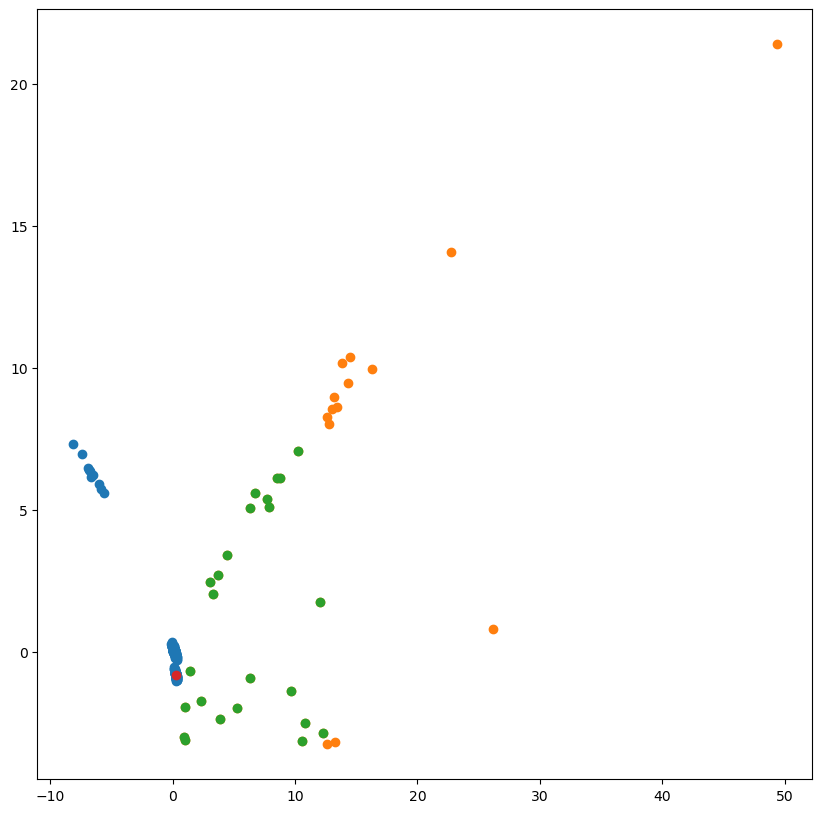

In [525]:
use_vals = []
means = []

for i in count_to_labels.keys(): 
    if i in [0,1]:
        continue
#     print(i, count_to_labels[i])
    count = i
    X = []
    y = []
    for n in range(len(scaled_data)):
        if labels_as_count[n] == i:
            X.append(scaled_data[n])
    x = np.array(X)
    web_data_use = np.array(scaled_web_2)
    x_mean = x.mean(axis=0)
    means.append(x_mean)
#     x_covar = np.cov(x, rowvar=False)
#     x_covar_inv = np.linalg.inv(x_covar)
    x_diff = (web_data_use - x_mean)**2
    md = []
    for row in x_diff:
        md.append(np.sqrt(np.sum(np.dot(np.array([0.66,0.34]),row))))
    thresh = 10
    
    for i in range(len(md)):
        if md[i] < thresh:
#             print(black)
            print(i,md[i],md[i]<thresh,"-----")
            use_vals.append(i)
        else :
#             print(red)
            print(i,md[i],md[i]<thresh)

new_data = np.array([scaled_web_2[i] for i in set(use_vals)])

fig = plt.figure(figsize = (10,10))
plt.scatter(scaled_data[:,0], scaled_data[:,1])
plt.scatter(scaled_web_2[:,0], scaled_web_2[:,1])
plt.scatter(new_data[:,0], new_data[:,1])
plt.scatter(np.array(means)[:,0], np.array(means)[:,1])

# for cc in count_to_labels.keys():   
#     temp_check = []
#     for i in range(1,151):
#         temp_check.append(cc+"-"+str(i)+"-0-50-200-2-aws-88-60")
#     cc_mp = get_feature_degree(temp_check, ss=225,p="n",ft_thresh=1,max_deg=cc_degree[cc])
#     x = []
#     for key in cc_mp.keys():
#         x.append(cc_mp[key][0]['coeff'])
#     x = np.array(x)
#     x_mean = x.mean(axis=0)
#     if cc_degree[cc] == 1:
#         x_covar = np.array([[np.cov(x, rowvar=False)]])
#     else :
#         x_covar = np.cov(x, rowvar=False)
#     x_covar_inv = np.linalg.inv(x_covar)
#     print(x_mean)
#     print(x_covar)
#     print(is_pos_def(x_covar))
#     print(is_pos_def(x_covar_inv))
#     x_diff = x - x_mean
#     md = []
#     for i in range(len(x_diff)):
#         md.append(x_diff[i].dot(x_covar_inv).dot(x_diff[i]))
#     p = 1 - chi2.cdf(md, 4)
#     ind = []
#     thresh = 0.05
#     for i in range(len(md)):
#         if p[i] < thresh:
#             print(red)
#             ind.append(i)
#         print(i,md[i],p[i],p[i]<thresh)
#         print(black)
#     dont_use_ind[cc] = ind


In [ ]:
from sklearn.svm import OneClassSVM
from sklearn.model_selection import train_test_split
curr_data = np.array(data)
curr_labels = np.array(labels_as_count)
web_2_data = web_2
not_outliers = {}
for i in count_to_labels.keys():    
    print(i, count_to_labels[i])
    count = i
    X = []
    y = []
    for n in range(len(curr_data)):
        if labels_as_count[n] ==  i:
            X.append(curr_data[n])
            y.append(labels_as_count[n])
    X = np.array(X)
    y = np.array(y)
    web_data_use = web_2_data
    ss = StandardScaler()
    X = ss.fit_transform(X)
    web_2_data_use = ss.transform(web_2_data)
    one_class_svm = OneClassSVM(nu=0.001, kernel = 'sigmoid', gamma = 1).fit(X)
    prediction = one_class_svm.predict(web_2_data_use)
    prediction = [1 if i==-1 else 0 for i in prediction]
    temp = []
    for i in range(len(web_2_data)):
        if prediction[i] == 0:
            temp.append(web_2_data[i])
    not_outliers[count] = temp

figure = plt.figure(figsize=(10, 10))
ax = plt.axes()

cm_bright = ListedColormap(["#FF0000","#FFFF00","#0000FF"])
cm = plt.cm.RdYlBu

ax.scatter(
    curr_data[:, 0], curr_data[:, 1], c=curr_labels, cmap=cm_bright, edgecolors="k"
)

ax.scatter(
    web_2_data[:, 0], web_2_data[:, 1], color="k", edgecolors="k"
)

for i in not_outliers:
    if len(not_outliers[i])>0:
        new_data = np.array(not_outliers[i])
        ax.scatter(
            new_data[:, 0], new_data[:, 1], cmap=cm
        )

1 dctcp
2 westwood
0 cubicQ


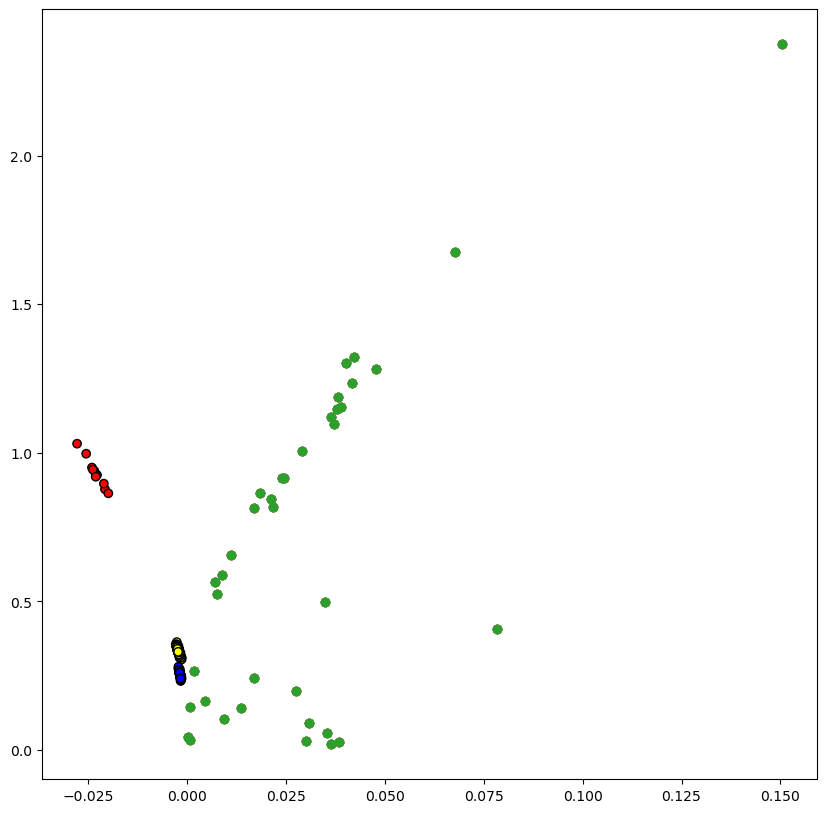

In [365]:
from sklearn.svm import OneClassSVM
from sklearn.model_selection import train_test_split
curr_data = np.array(data)
curr_labels = np.array(labels_as_count)
web_2_data = web_2
not_outliers = {}
for i in count_to_labels.keys():    
    print(i, count_to_labels[i])
    count = i
    X = []
    y = []
    for n in range(len(curr_data)):
        if labels_as_count[n] ==  i:
            X.append(curr_data[n])
            y.append(labels_as_count[n])
    X = np.array(X)
    y = np.array(y)
    web_data_use = web_2_data
    ss = StandardScaler()
    X = ss.fit_transform(X)
    web_2_data_use = ss.transform(web_2_data)
    one_class_svm = OneClassSVM(nu=0.001, kernel = 'sigmoid', gamma = 1).fit(X)
    prediction = one_class_svm.predict(web_2_data_use)
    prediction = [1 if i==-1 else 0 for i in prediction]
    temp = []
    for i in range(len(web_2_data)):
        if prediction[i] == 0:
            temp.append(web_2_data[i])
    not_outliers[count] = temp

figure = plt.figure(figsize=(10, 10))
ax = plt.axes()

cm_bright = ListedColormap(["#FF0000","#FFFF00","#0000FF"])
cm = plt.cm.RdYlBu

ax.scatter(
    curr_data[:, 0], curr_data[:, 1], c=curr_labels, cmap=cm_bright, edgecolors="k"
)

ax.scatter(
    web_2_data[:, 0], web_2_data[:, 1], color="k", edgecolors="k"
)

for i in not_outliers:
    if len(not_outliers[i])>0:
        new_data = np.array(not_outliers[i])
        ax.scatter(
            new_data[:, 0], new_data[:, 1], cmap=cm
        )

1 dctcp
2 westwood
0 cubicQ


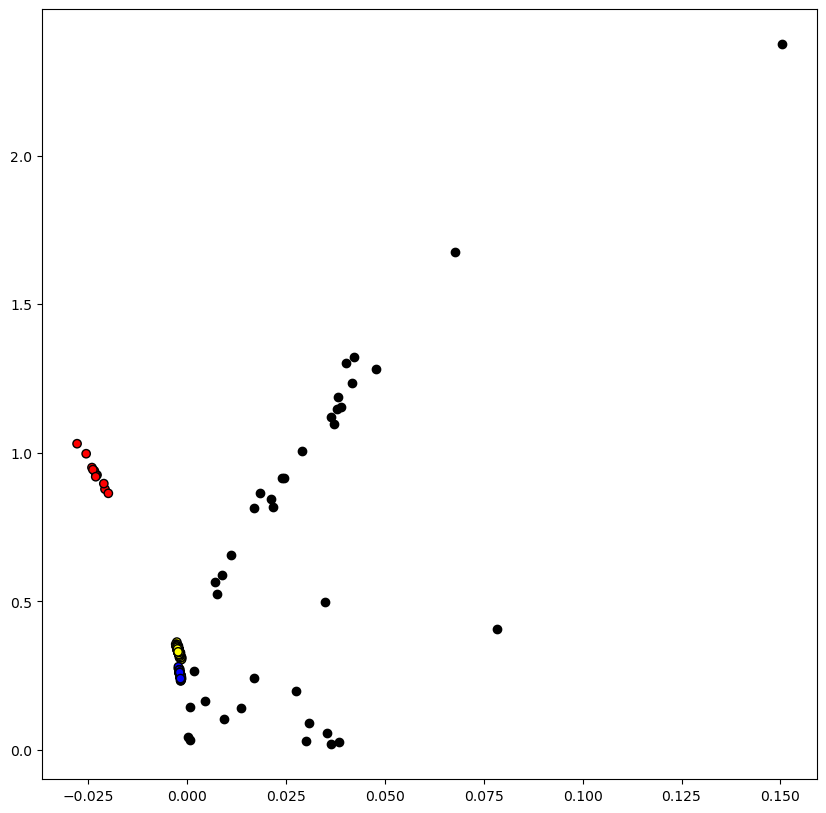

In [337]:
from sklearn.covariance import EllipticEnvelope
from sklearn.model_selection import train_test_split
curr_data = np.array(data)
curr_labels = np.array(labels_as_count)
web_2_data = web_2
not_outliers = {}
for i in count_to_labels.keys():    
    print(i, count_to_labels[i])
    count = i
    X = []
    y = []
    for n in range(len(curr_data)):
        if labels_as_count[n] ==  i:
            X.append(curr_data[n])
            y.append(labels_as_count[n])
    X = np.array(X)
    y = np.array(y)
    ss = StandardScaler()
    X = ss.fit_transform(X)
    web_2_data_use = ss.transform(web_2_data)
    model = EllipticEnvelope(contamination=0.001,random_state=42).fit(X)
    prediction = model.predict(web_2_data_use)
    prediction = [1 if i==-1 else 0 for i in prediction]
    temp = []
    for i in range(len(web_2_data_use)):
        if prediction[i] == 0:
            temp.append(web_2_data_use[i])
    not_outliers[count] = temp

figure = plt.figure(figsize=(10, 10))
ax = plt.axes()

cm_bright = ListedColormap(["#FF0000","#FFFF00","#0000FF"])
cm = plt.cm.RdYlBu

ax.scatter(
    curr_data[:, 0], curr_data[:, 1], c=curr_labels, cmap=cm_bright, edgecolors="k"
)

ax.scatter(
    web_2_data[:, 0], web_2_data[:, 1], color="k", edgecolors="k"
)

for i in not_outliers:
    if len(not_outliers[i])>0:
        print(i)
        new_data = np.array(not_outliers[i])
        color = 'r'
        if i == 1:
            color = 'y'
        elif i == 2:
            color = 'b'
        ax.scatter(
            new_data[:, 0], new_data[:, 1], c=color
        )

1 dctcp
2 westwood
0 cubicQ


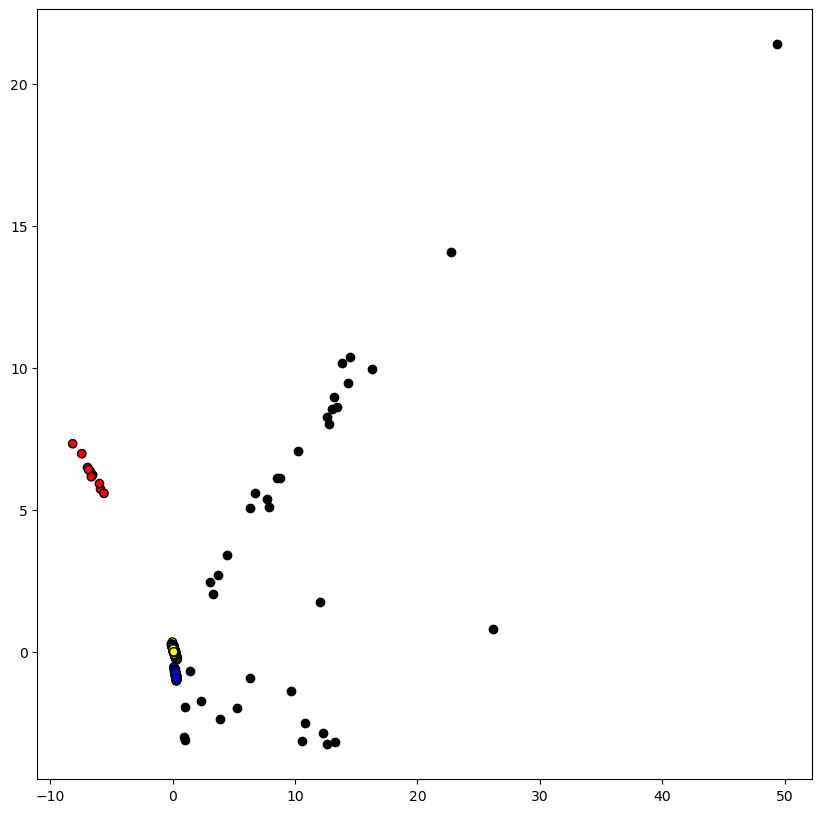

In [230]:
from sklearn.svm import OneClassSVM
from sklearn.model_selection import train_test_split
curr_data = np.array(scaled_data)
curr_labels = np.array(labels_as_count)
web_2_data = scaled_web_2
not_outliers = {}
for i in count_to_labels.keys():    
    print(i, count_to_labels[i])
    count = i
    X = []
    y = []
    for n in range(len(curr_data)):
        if labels_as_count[n] ==  i:
            X.append(curr_data[n])
            y.append(labels_as_count[n])
    X = np.array(X)
    y = np.array(y)
    one_class_svm = OneClassSVM(nu=0.001, kernel = 'rbf', gamma = 100).fit(X)
    prediction = one_class_svm.predict(web_2_data)
    prediction = [1 if i==-1 else 0 for i in prediction]
    temp = []
    for i in range(len(web_2_data)):
        if prediction[i] == 0:
            temp.append(web_2_data[i])
    not_outliers[count] = temp

figure = plt.figure(figsize=(10, 10))
ax = plt.axes()

cm_bright = ListedColormap(["#FF0000","#FFFF00","#0000FF"])
cm = plt.cm.RdYlBu

ax.scatter(
    curr_data[:, 0], curr_data[:, 1], c=curr_labels, cmap=cm_bright, edgecolors="k"
)

ax.scatter(
    web_2_data[:, 0], web_2_data[:, 1], color="k", edgecolors="k"
)
i_to_c = {
    0 : 'r',
    1 : 'y',
    2 : 'b'
}
for i in not_outliers:
    if len(not_outliers[i])>0:
        print(i)
        new_data = np.array(not_outliers[i])
        ax.scatter(
            new_data[:, 0], new_data[:, 1], c=i_to_c[i]
        )

1 dctcp
2 westwood
0 cubicQ
dctcp
5


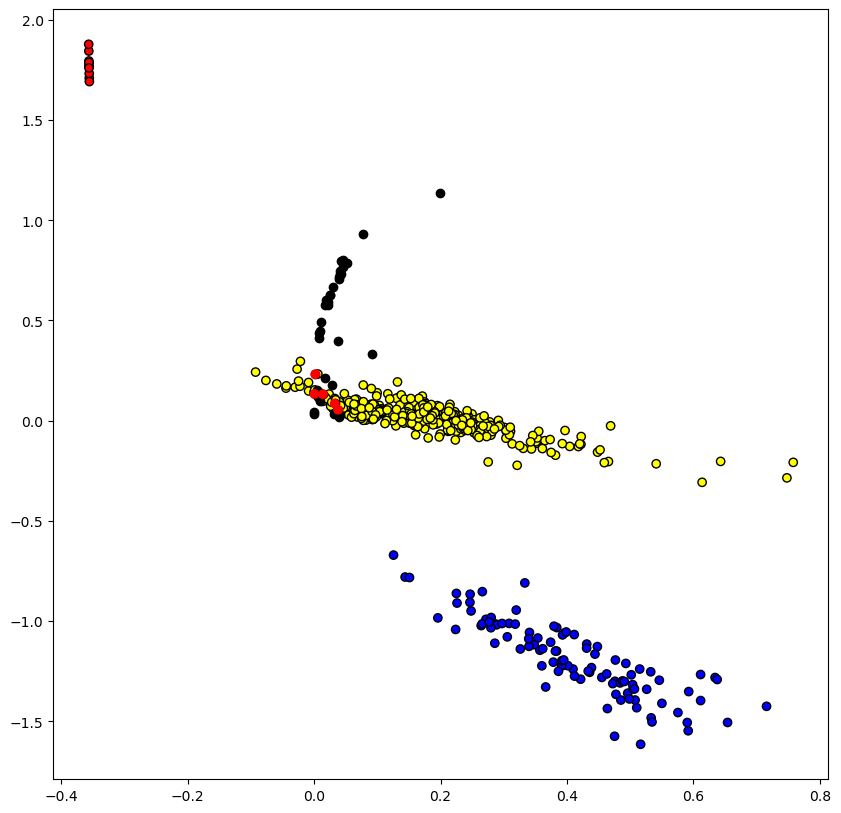

In [218]:
from sklearn.svm import OneClassSVM
from sklearn.model_selection import train_test_split
curr_data = np.array(yj_data)
curr_labels = np.array(labels_as_count)
web_2_data = yj_web_2
not_outliers = {}
for i in count_to_labels.keys():    
    print(i, count_to_labels[i])
    count = i
    X = []
    y = []
    for n in range(len(curr_data)):
        if labels_as_count[n] ==  i:
            X.append(curr_data[n])
            y.append(labels_as_count[n])
    X = np.array(X)
    y = np.array(y)
    one_class_svm = OneClassSVM(nu=0.001, kernel = 'rbf', gamma = 1000).fit(X)
    prediction = one_class_svm.predict(web_2_data)
    prediction = [1 if i==-1 else 0 for i in prediction]
    temp = []
    for i in range(len(web_2_data)):
        if prediction[i] == 0:
            temp.append(web_2_data[i])
    not_outliers[count] = temp

figure = plt.figure(figsize=(10, 10))
ax = plt.axes()

cm_bright = ListedColormap(["#FF0000","#FFFF00","#0000FF"])
cm = plt.cm.RdYlBu

ax.scatter(
    curr_data[:, 0], curr_data[:, 1], c=curr_labels, cmap=cm_bright, edgecolors="k"
)

ax.scatter(
    web_2_data[:, 0], web_2_data[:, 1], color="k", edgecolors="k"
)

for i in not_outliers:
    if len(not_outliers[i])>0:
        print(count_to_labels[i])
        new_data = np.array(not_outliers[i])
        print(len(new_data))
        ax.scatter(
            new_data[:, 0], new_data[:, 1], c=[i]*len(new_data), cmap=cm_bright
        )

## Instead of this lets use a probability threshold

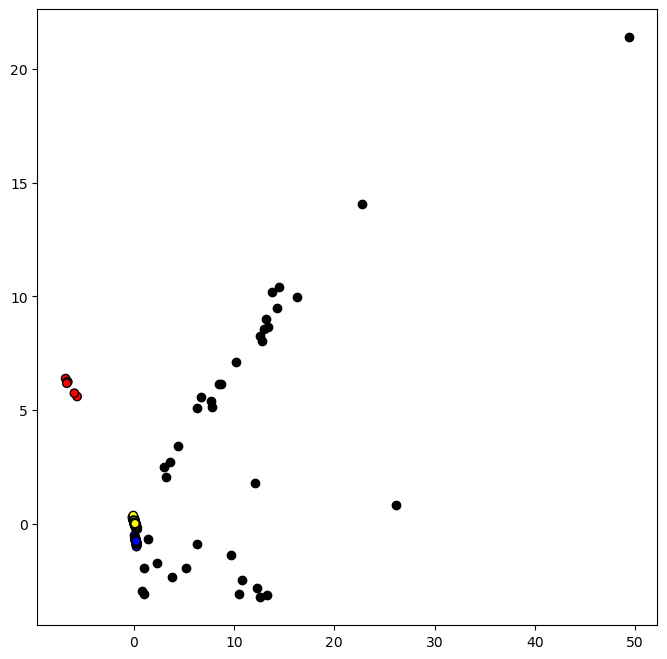

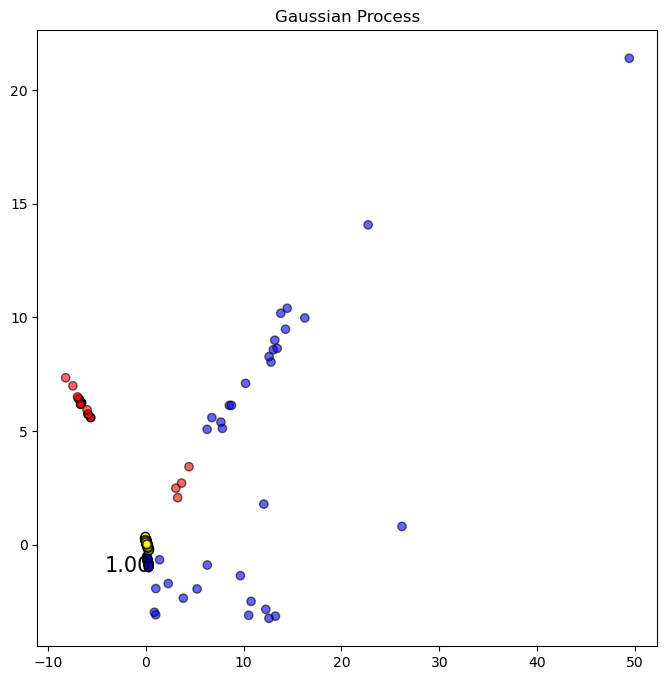

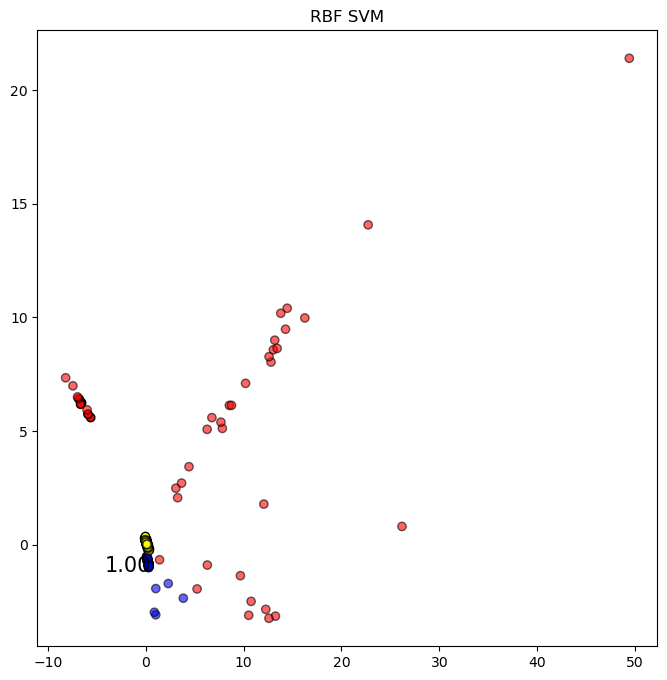

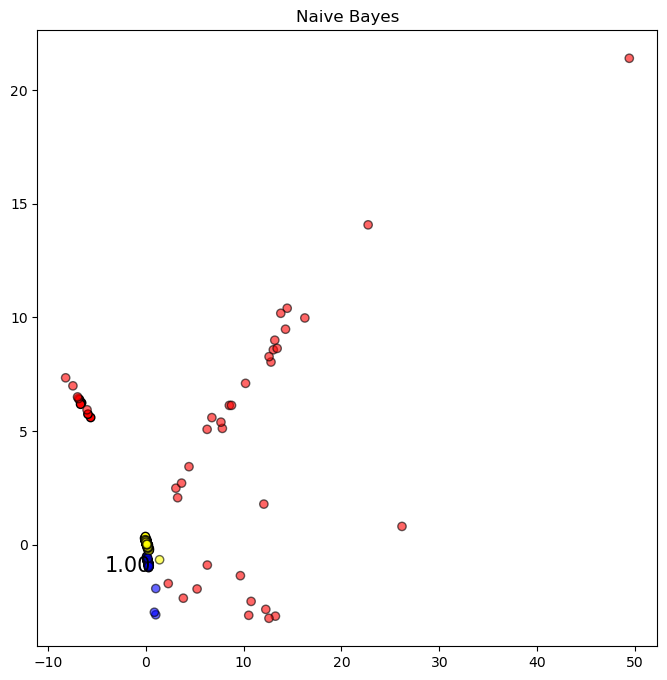

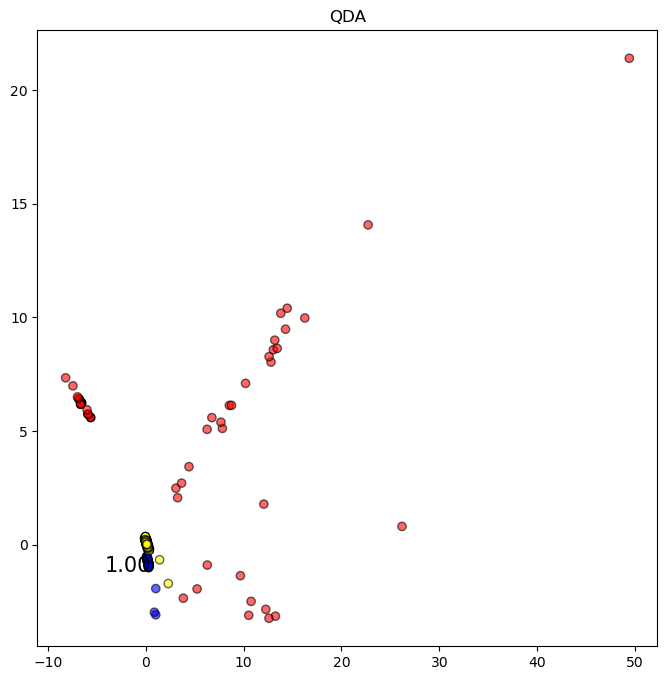

In [290]:
from sklearn.inspection import DecisionBoundaryDisplay
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline

names = [
    "Gaussian Process",
    "RBF SVM",
    "Naive Bayes",
    "QDA",
]
classifiers = [
    GaussianProcessClassifier(random_state=42),
    SVC(kernel="linear",random_state=42,probability=1),
    GaussianNB(),
    QuadraticDiscriminantAnalysis()
]
X = np.array(scaled_data)
y = np.array(labels_as_count)
data_web_2 = np.array(scaled_web_2)

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5

cm_bright = ListedColormap(["#FF0000", "#FFFF00", "#0000FF"])
cm = plt.cm.RdYlBu
i = 1

figure = plt.figure(figsize=(8, 8))
ax = plt.axes()

ax.scatter(
    X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright, edgecolors="k"
)
ax.scatter(
    data_web_2[:,0], data_web_2[:,1], color='k'
)

for name, clf in zip(names, classifiers):
    figure = plt.figure(figsize=(8, 8))
    ax = plt.axes()
#     ax = plt.subplot(1, len(classifiers) + 1,i)

    clf = make_pipeline(StandardScaler(), clf)
    clf.fit(X_train, y_train)
    score = clf.score(X_test, y_test)
#     DecisionBoundaryDisplay.from_estimator(
#         clf, X, cmap=cm, alpha=0.8, ax=ax, eps=0.5
#     )
#     DecisionBoundaryDisplay.from_estimator(
#         clf, scaled_web_2, cmap=cm, alpha=0.8, ax=ax, eps=0.5
#     )
    
    results = clf.predict(data_web_2)
    results_proba = clf.predict_proba(data_web_2)
    # Plot the training points
    ax.scatter(
        X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright, edgecolors="k"
    )
    # Plot the testing points
    ax.scatter(
        X_test[:, 0],
        X_test[:, 1],
        c=y_test,
        cmap=cm_bright,
        edgecolors="k",
        alpha=0.6,
    )
#     ax.set_xlim(x_min, x_max)
    ax.scatter(
        data_web_2[:, 0],
        data_web_2[:, 1],
        c=results,
        cmap=cm_bright,
        edgecolors="k",
        alpha=0.6,
    )
#     ax.set_ylim(y_min, y_max)
#     ax.set_xticks(())
#     ax.set_yticks(())
#     if ds_cnt == 0:
    ax.set_title(name)
    ax.text(
        x_max - 0.3,
        y_min + 0.3,
        ("%.2f" % score).lstrip("0"),
        size=15,
        horizontalalignment="right",
    )
    i+=1
plt.show()


/home/lakshayr/anaconda3/lib/python3.9/site-packages/sklearn/discriminant_analysis.py:887: UserWarning: Variables are collinear
  warnings.warn("Variables are collinear")


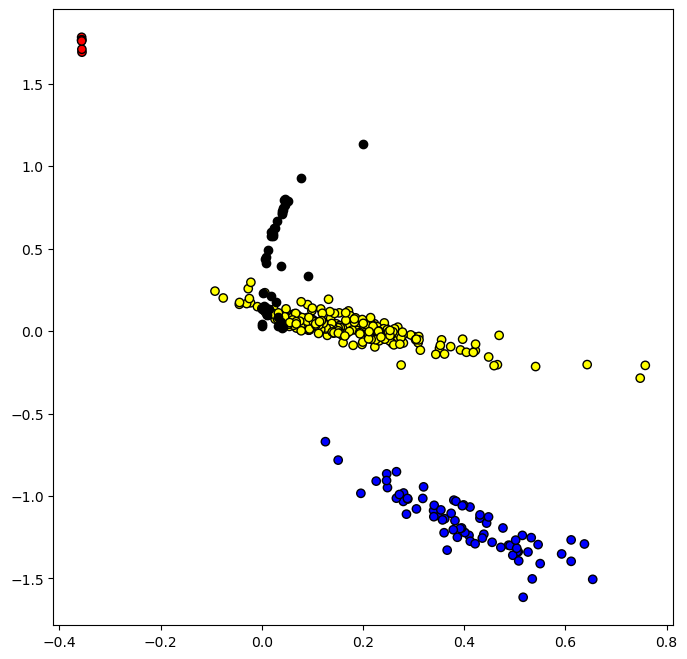

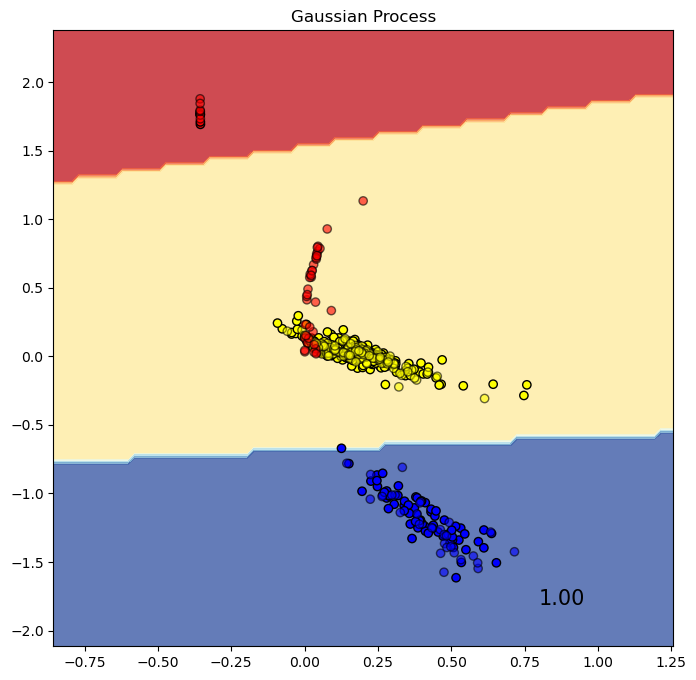

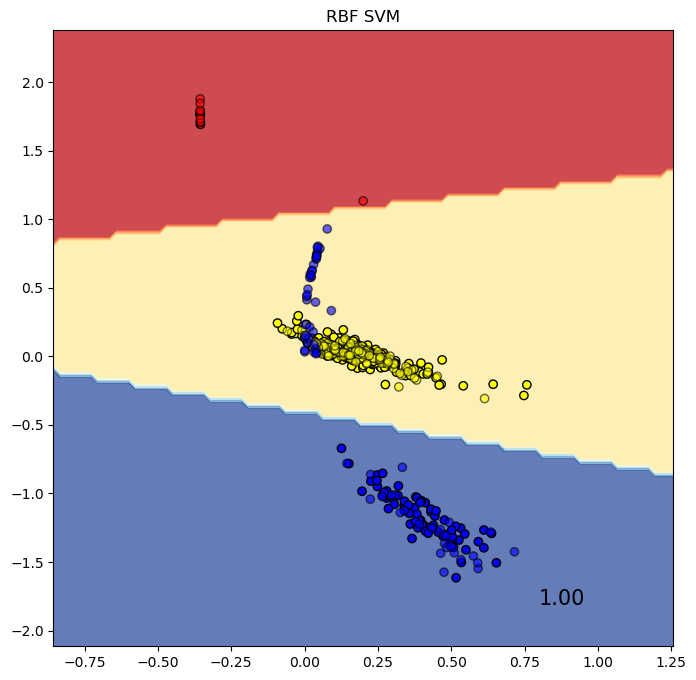

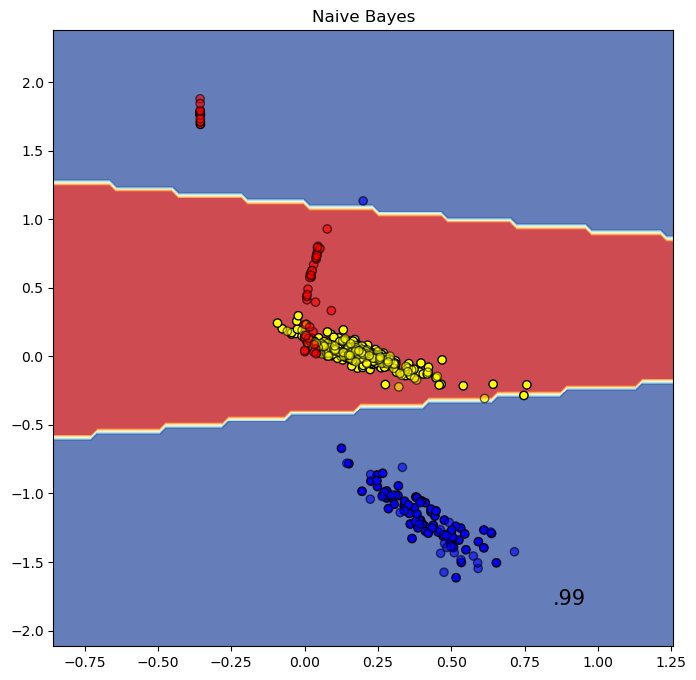

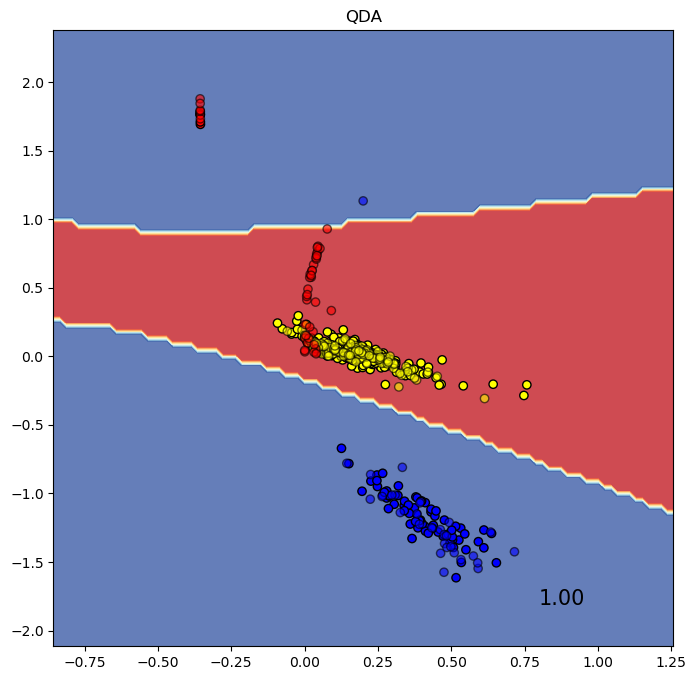

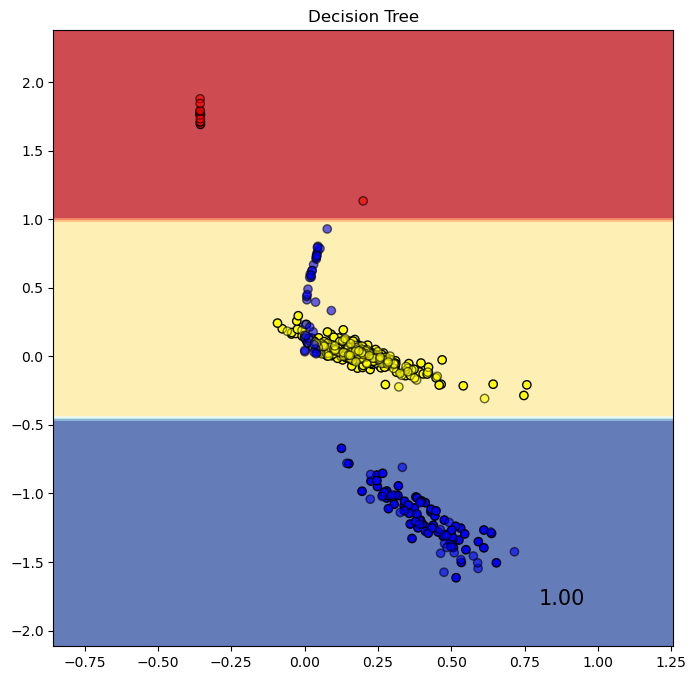

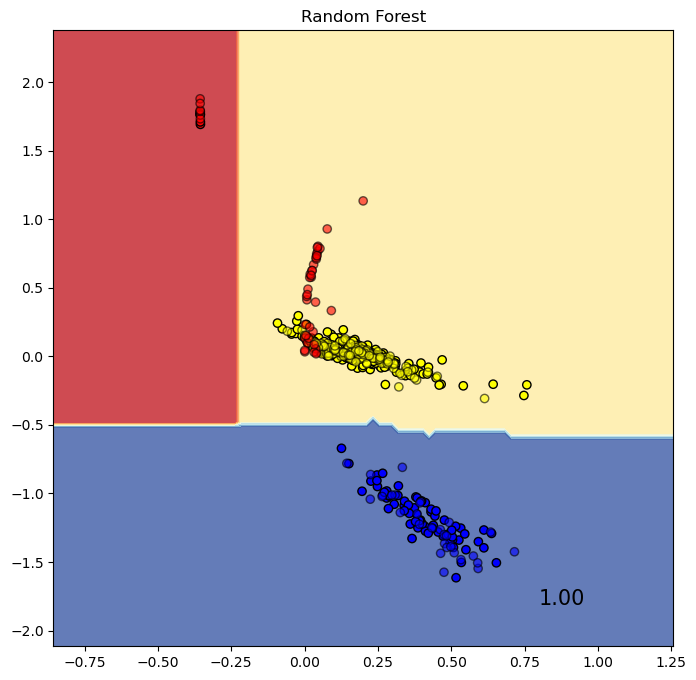

In [329]:
from sklearn.inspection import DecisionBoundaryDisplay
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier
    
names = [
    "Gaussian Process",
    "RBF SVM",
    "Naive Bayes",
    "QDA",
    "Decision Tree",
    "Random Forest",
]
classifiers = [
    GaussianProcessClassifier(random_state=42),
    SVC(kernel="linear",random_state=42,probability=1),
    GaussianNB(),
    QuadraticDiscriminantAnalysis(),
    DecisionTreeClassifier(max_depth=5, random_state=42),
    RandomForestClassifier(
        max_depth=5, n_estimators=10, max_features=1, random_state=42
    ),
]
X = np.array(yj_data)
y = np.array(labels_as_count)
data_web_2 = np.array(yj_web_2)

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5

cm_bright = ListedColormap(["#FF0000", "#FFFF00", "#0000FF"])
cm = plt.cm.RdYlBu
i = 1

figure = plt.figure(figsize=(8, 8))
ax = plt.axes()

ax.scatter(
    X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright, edgecolors="k"
)
ax.scatter(
    data_web_2[:,0], data_web_2[:,1], color='k'
)

for name, clf in zip(names, classifiers):
    figure = plt.figure(figsize=(8, 8))
    ax = plt.axes()
#     ax = plt.subplot(1, len(classifiers) + 1,i)

#     clf = make_pipeline(StandardScaler(), clf)
    clf.fit(X_train, y_train)
    score = clf.score(X_test, y_test)
    DecisionBoundaryDisplay.from_estimator(
        clf, X, cmap=cm, alpha=0.8, ax=ax, eps=0.5
    )
#     DecisionBoundaryDisplay.from_estimator(
#         clf, data_web_2, cmap=cm, alpha=0.8, ax=ax, eps=0.5
#     )
    
    results = clf.predict(data_web_2)
    results_proba = clf.predict_proba(data_web_2)
    # Plot the training points
    ax.scatter(
        X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm_bright, edgecolors="k"
    )
    # Plot the testing points
    ax.scatter(
        X_test[:, 0],
        X_test[:, 1],
        c=y_test,
        cmap=cm_bright,
        edgecolors="k",
        alpha=0.6,
    )
#     ax.set_xlim(x_min, x_max)
    ax.scatter(
        data_web_2[:, 0],
        data_web_2[:, 1],
        c=results,
        cmap=cm_bright,
        edgecolors="k",
        alpha=0.6,
    )
#     ax.set_ylim(y_min, y_max)
#     ax.set_xticks(())
#     ax.set_yticks(())
#     if ds_cnt == 0:
    ax.set_title(name)
    ax.text(
        x_max - 0.3,
        y_min + 0.3,
        ("%.2f" % score).lstrip("0"),
        size=15,
        horizontalalignment="right",
    )
    i+=1
plt.show()


[2 1 0 0 0 0 1 2 1 0 0 2 0 0 0 0 2 0 1 2 0 2 2 0 2 0 2 2 2 2 0 0 1 0 0 2 2
 0]


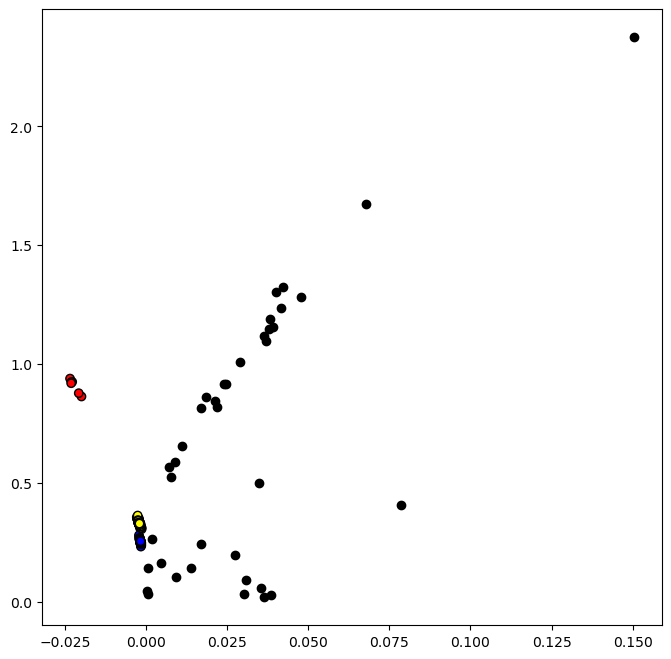

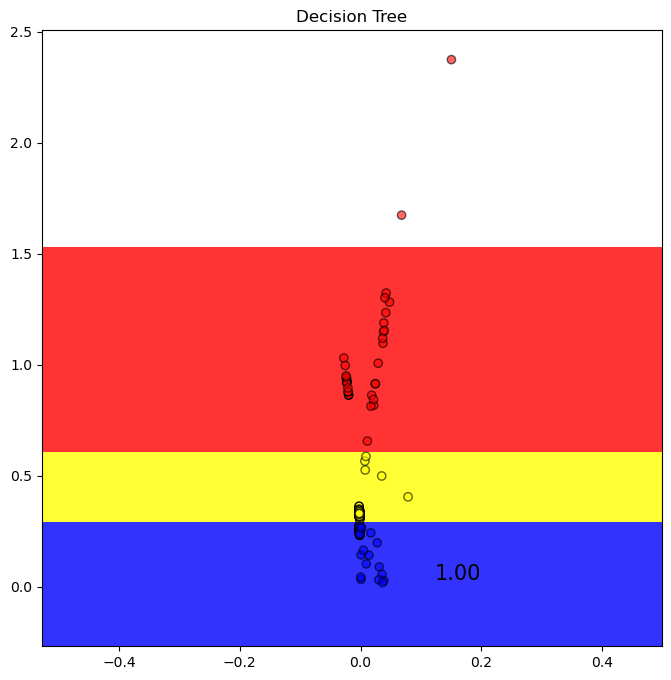

Printing for  cubicQ


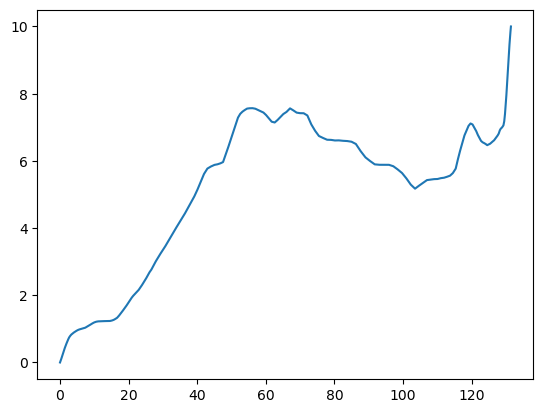

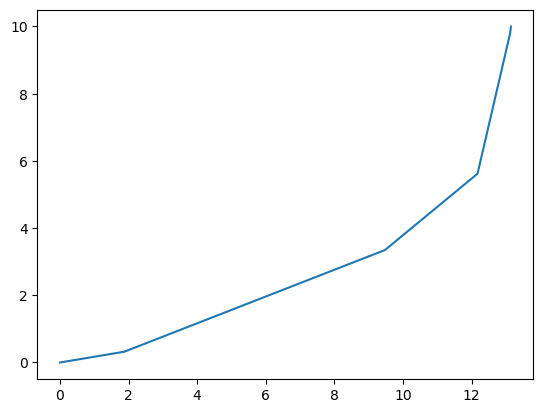

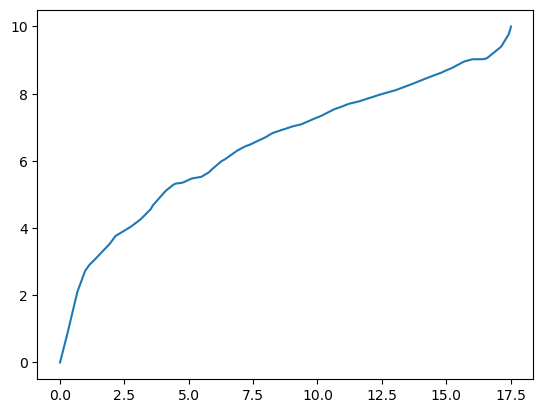

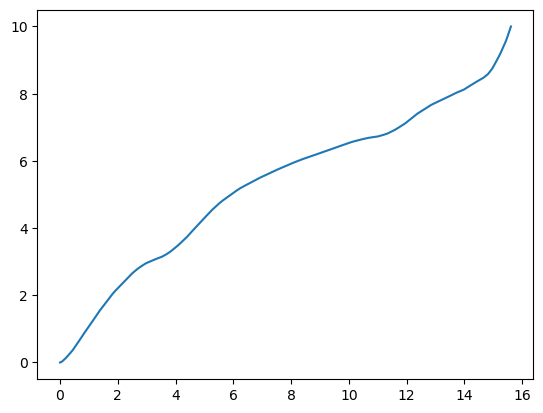

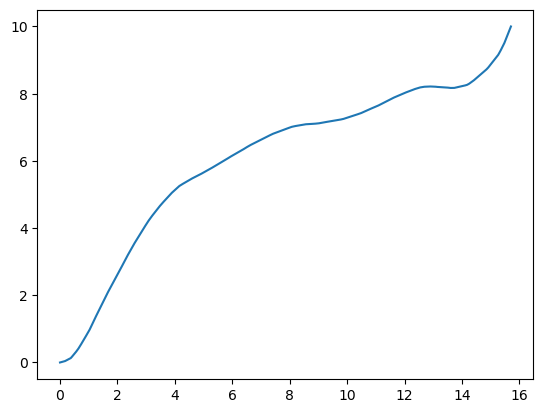

...

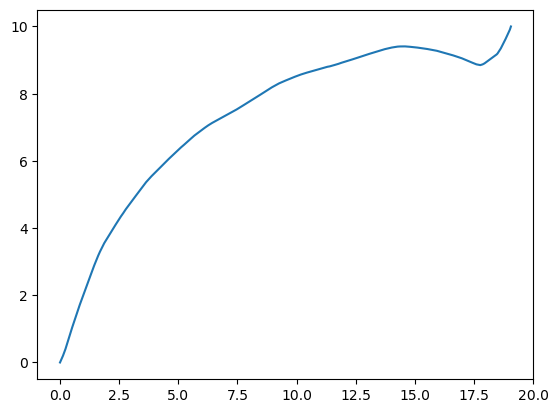

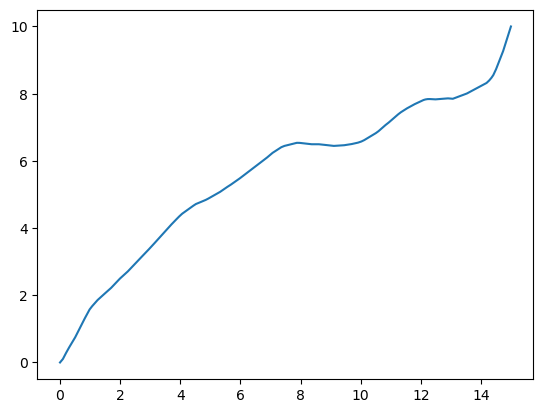

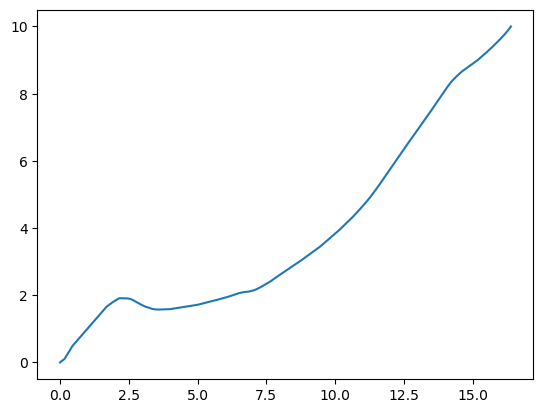

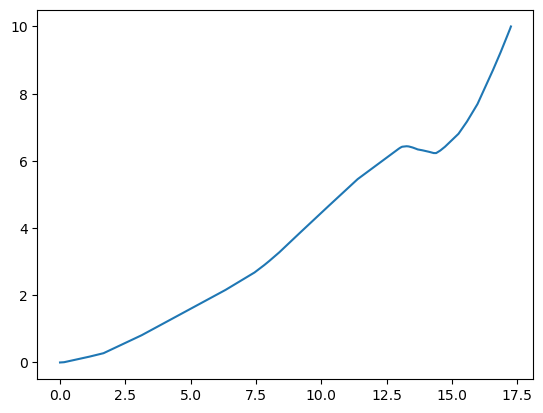

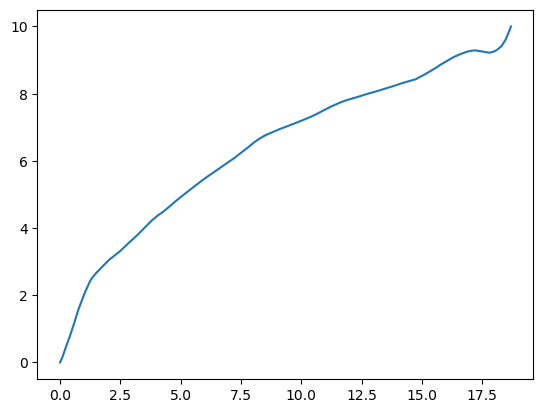

Printing for  dctcp


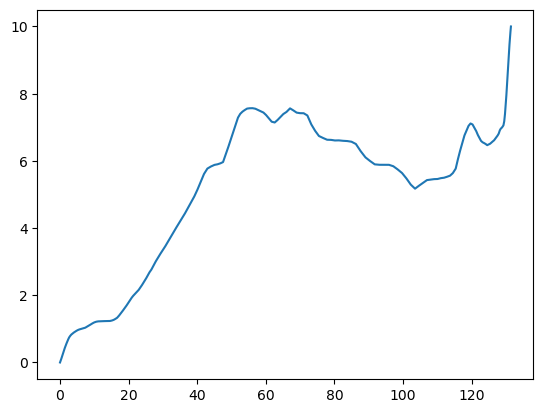

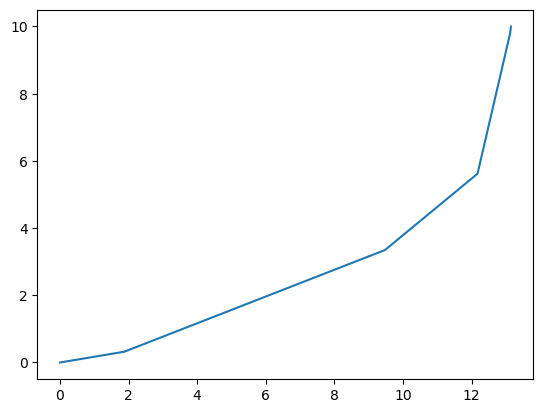

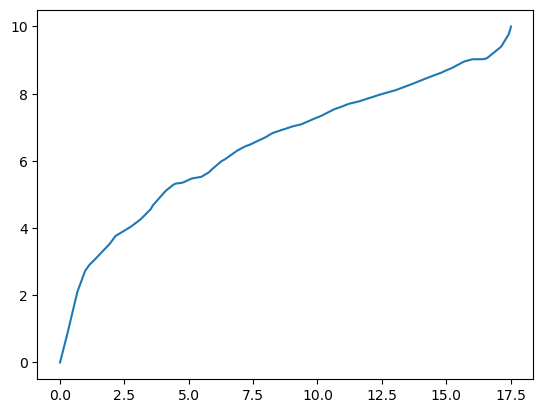

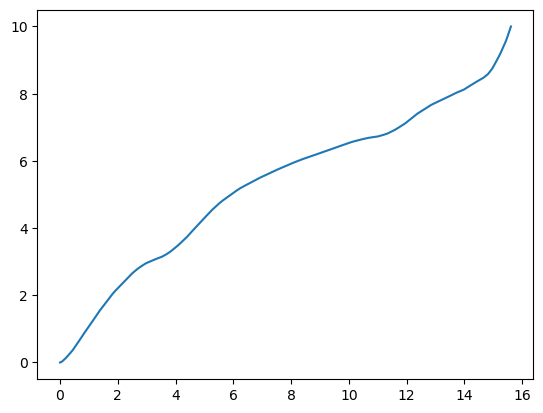

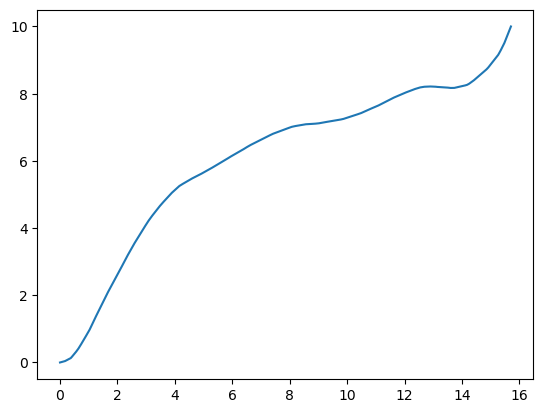

...

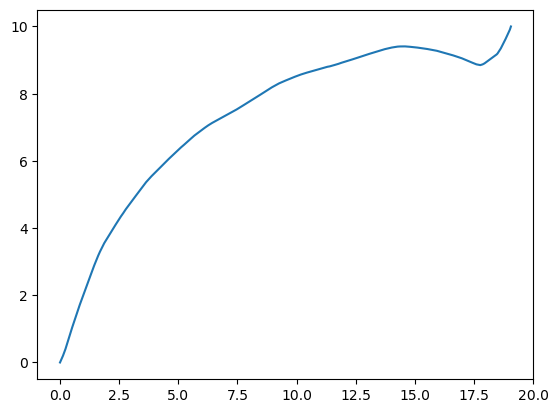

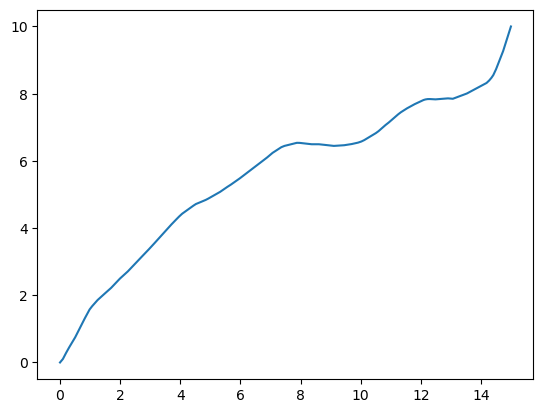

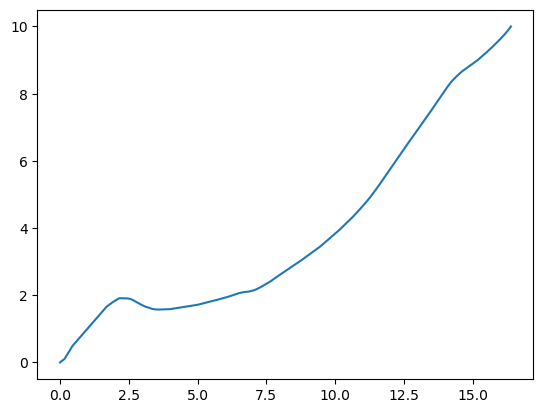

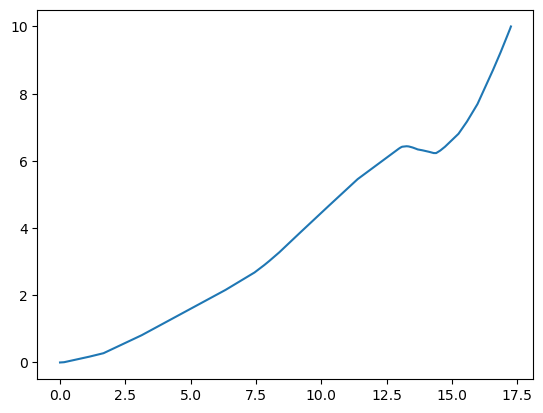

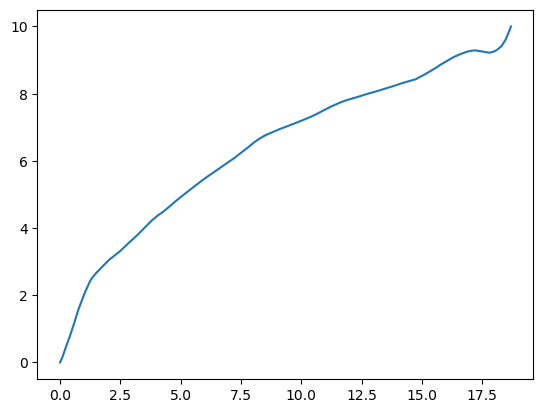

Printing for  westwood


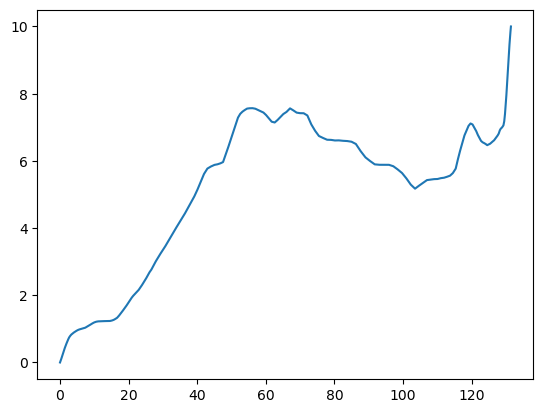

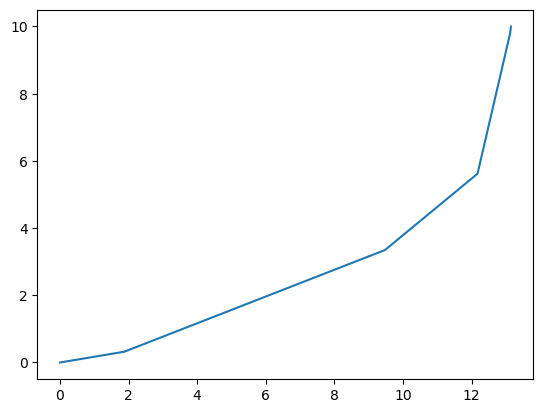

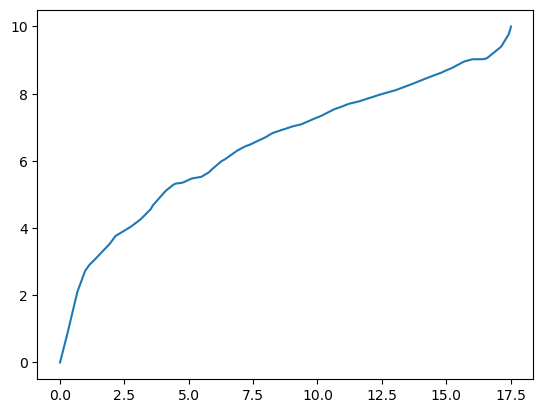

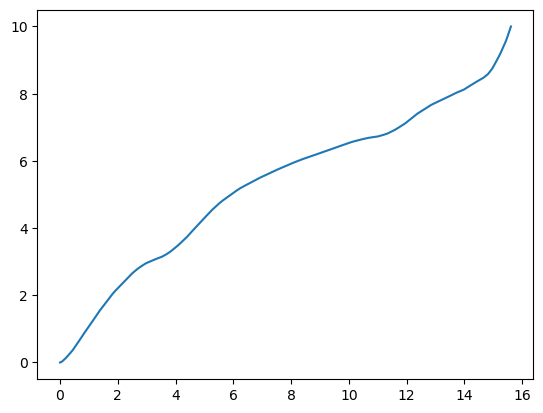

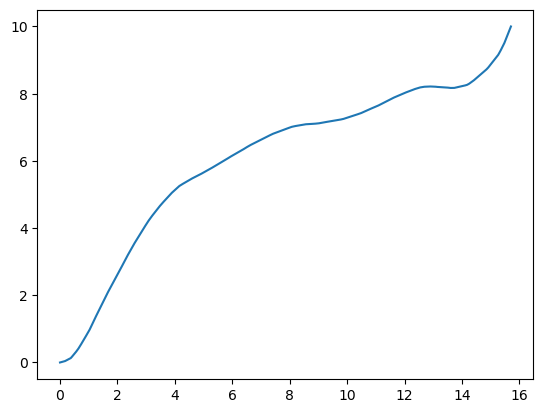

...

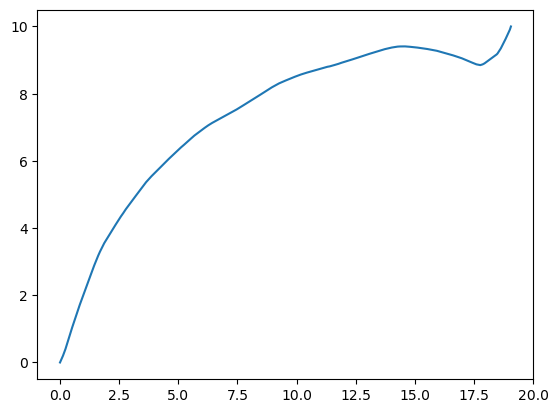

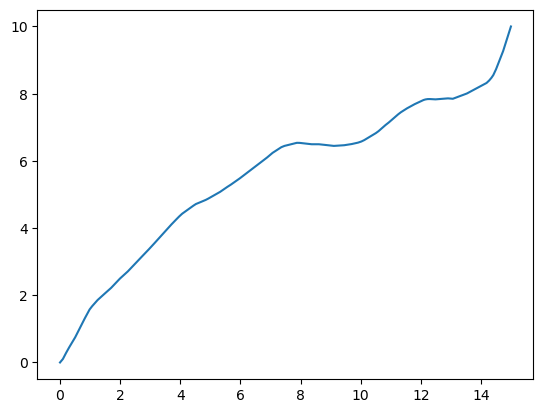

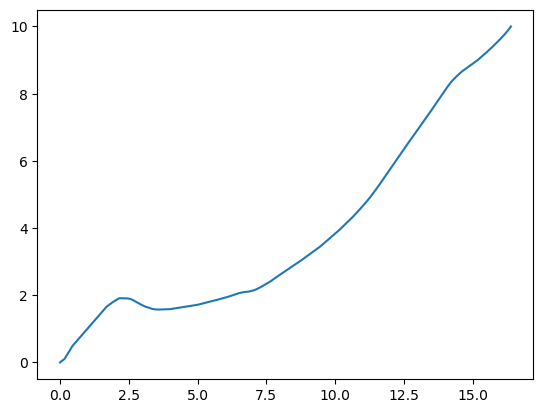

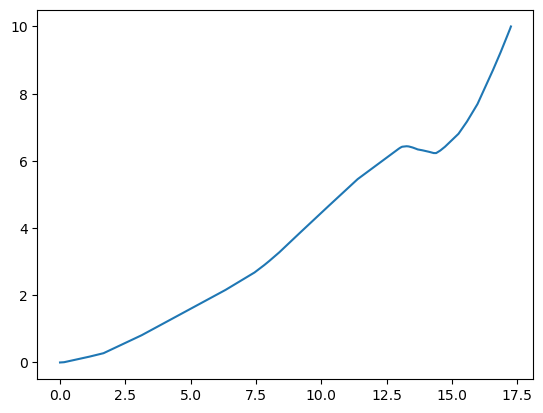

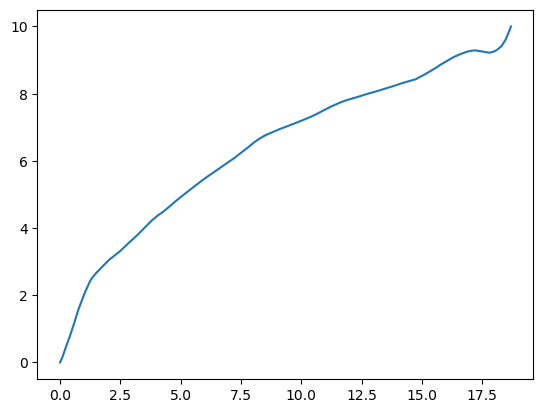

In [324]:
from sklearn.inspection import DecisionBoundaryDisplay
from sklearn.gaussian_process import GaussianProcessClassifier
from sklearn.gaussian_process.kernels import RBF
from sklearn.naive_bayes import GaussianNB
from sklearn.preprocessing import StandardScaler
from sklearn.svm import SVC
from sklearn.discriminant_analysis import QuadraticDiscriminantAnalysis
from matplotlib.colors import ListedColormap
from sklearn.model_selection import train_test_split
from sklearn.pipeline import make_pipeline
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import AdaBoostClassifier, RandomForestClassifier
    
names = [
    "Decision Tree",
#     "Random Forest",
]
classifiers = [
#     GaussianProcessClassifier(random_state=42),
#     SVC(kernel="linear",random_state=42,probability=1),
#     GaussianNB(),
#     QuadraticDiscriminantAnalysis(),
    DecisionTreeClassifier(max_depth=10, random_state=42)
#     RandomForestClassifier(
#         max_depth=10, n_estimators=100, random_state=42
#     ),
]
X = np.array(data)
y = np.array(labels_as_count)
data_web_2 = np.array(web_2)

X_train, X_test, y_train, y_test = train_test_split(
    X, y, test_size=0.3, random_state=42
)

x_min, x_max = X[:, 0].min() - 0.5, X[:, 0].max() + 0.5
y_min, y_max = X[:, 1].min() - 0.5, X[:, 1].max() + 0.5

l_to_c = {
    'cubicQ' : 'red',
    'dctcp' : 'yellow',
    'westwood' : 'blue',
}
cm = ListedColormap(['red','yellow','blue'])
cm_bright = ListedColormap(["#FF0000", "#FFFF00", "#0000FF"])
i = 1

figure = plt.figure(figsize=(8, 8))
ax = plt.axes()

ax.scatter(
    X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm, edgecolors="k"
)
ax.scatter(
    data_web_2[:,0], data_web_2[:,1], color='k'
)

for name, clf in zip(names, classifiers):
    figure = plt.figure(figsize=(8, 8))
    ax = plt.axes()
#     ax = plt.subplot(1, len(classifiers) + 1,i)

#     clf = make_pipeline(StandardScaler(), clf)
    clf.fit(X_train, y_train)
    score = clf.score(X_test, y_test)
    DecisionBoundaryDisplay.from_estimator(
        clf, X, cmap=cm_bright, alpha=0.8, ax=ax, eps=0.5
    )
#     DecisionBoundaryDisplay.from_estimator(
#         clf, data_web_2, cmap=cm_bright, alpha=0.8, ax=ax, eps=0.5
#     )
    
    results = clf.predict(data_web_2)
    print(results)
    results_proba = clf.predict_proba(data_web_2)
    # Plot the training points
    ax.scatter(
        X_train[:, 0], X_train[:, 1], c=y_train, cmap=cm, edgecolors="k"
    )
    # Plot the testing points
    ax.scatter(
        X_test[:, 0],
        X_test[:, 1],
        c=y_test,
        cmap=cm,
        edgecolors="k",
        alpha=0.6,
    )
#     ax.set_xlim(x_min, x_max)
    new_c = []
    if len(set(results)) == 2 :
        new_c = ['yellow', 'blue']
        cm = ListedColormap(new_c)
    ax.scatter(
        data_web_2[:, 0],
        data_web_2[:, 1],
        c=results,
        cmap=cm,
        edgecolors="k",
        alpha=0.6,
    )
#     ax.set_ylim(y_min, y_max)
#     ax.set_xticks(())
#     ax.set_yticks(())
#     if ds_cnt == 0:
    ax.set_title(name)
    ax.text(
        x_max - 0.3,
        y_min + 0.3,
        ("%.2f" % score).lstrip("0"),
        size=15,
        horizontalalignment="right",
    )
    i+=1
plt.show()

for i in set(results):
    print("Printing for ", count_to_labels[i])
    for i in range(len(data_web_2)):
        tcoeff = (data_web_2[i][0],data_web_2[i][1])
        web = coeff_to_web[tcoeff]
        tdata = web_mp[web]['data']
        ttime = web_mp[web]['time']
        plt.plot(ttime,tdata)
        plt.show()

/home/lakshayr/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:237: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be accepted. Set `keepdims` to True or False to avoid this warning.
  mode, _ = stats.mode(_y[neigh_ind, k], axis=1)
/home/lakshayr/anaconda3/lib/python3.9/site-packages/sklearn/neighbors/_classification.py:237: FutureWarning: Unlike other reduction functions (e.g. `skew`, `kurtosis`), the default behavior of `mode` typically preserves the axis it acts along. In SciPy 1.11.0, this behavior will change: the default value of `keepdims` will become False, the `axis` over which the statistic is taken will be eliminated, and the value None will no longer be ac

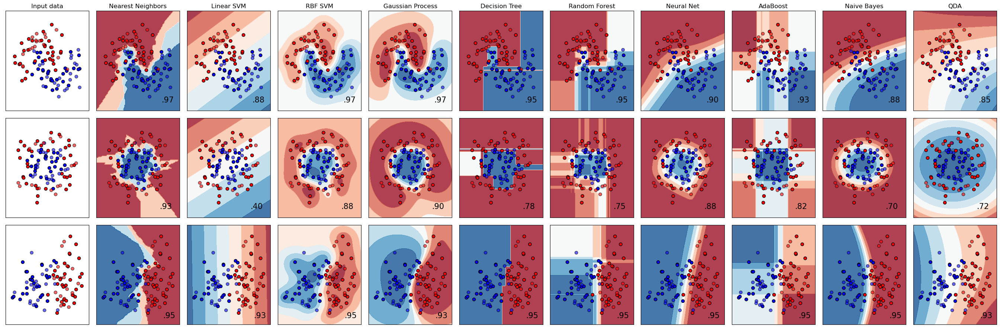

In [325]:
from sklearn.covariance import EllipticEnvelope

model = EllipticEnvelope(contamination=0.01, )

# Clustering using DBSCAN

Estimated number of clusters: 3
Estimated number of noise points: 5


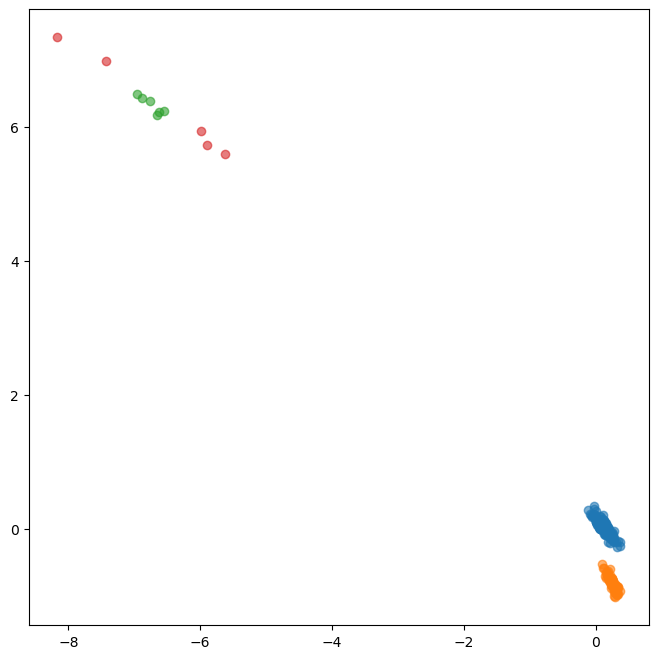

In [246]:
X = scaled_data

import numpy as np

from sklearn import metrics
from sklearn.cluster import DBSCAN

db = DBSCAN(eps=0.3, min_samples=5).fit(X)
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)

unique_labels = set(labels)
figure = plt.figure(figsize=(8, 8))
ax = plt.axes()
for u in unique_labels:
    x = []
    for i in range(len(X)):
        if labels[i] == u:
            x.append(X[i])
    x = np.array(x)
    ax.scatter(
        x[:, 0],
        x[:, 1],
        alpha=0.6,
    )

Estimated number of clusters: 3
Estimated number of noise points: 22


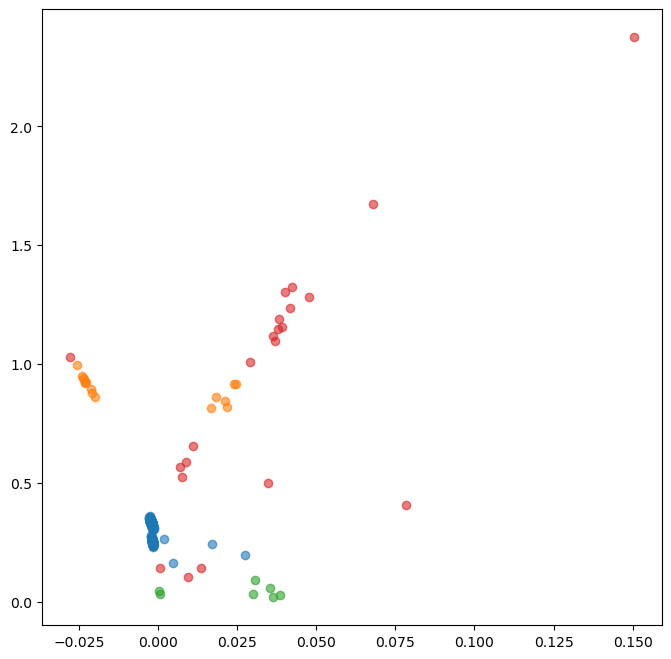

In [288]:
X = np.concatenate((data, web_2),axis=0)

import numpy as np

from sklearn import metrics
from sklearn.cluster import DBSCAN

db = DBSCAN(eps=0.05, min_samples=5).fit(X)
labels = db.labels_

# Number of clusters in labels, ignoring noise if present.
n_clusters_ = len(set(labels)) - (1 if -1 in labels else 0)
n_noise_ = list(labels).count(-1)

print("Estimated number of clusters: %d" % n_clusters_)
print("Estimated number of noise points: %d" % n_noise_)

unique_labels = set(labels)
figure = plt.figure(figsize=(8, 8))
ax = plt.axes()
for u in unique_labels:
    x = []
    for i in range(len(X)):
        if labels[i] == u:
            x.append(X[i])
    x = np.array(x)
    ax.scatter(
        x[:, 0],
        x[:, 1],
        alpha=0.6,
    )

In [272]:
web_mp

{'1688.com': {'data': array([ 0.        ,  0.03059844,  0.06572918,  0.10959178,  0.15343288,
          0.19727398,  0.24894623,  0.30384867,  0.36771387,  0.4333133 ,
          0.49891274,  0.56211993,  0.62532711,  0.68691901,  0.74431061,
          0.79136516,  0.83031705,  0.86192314,  0.89098101,  0.91826701,
          0.94312146,  0.96665453,  0.98325641,  0.99570159,  1.00739206,
          1.02159027,  1.03521926,  1.06460948,  1.09683132,  1.12905316,
          1.16307553,  1.19201477,  1.21354963,  1.22340275,  1.22668085,
          1.22820038,  1.23093179,  1.23208201,  1.23285112,  1.23516451,
          1.2477854 ,  1.26729284,  1.29663033,  1.33087495,  1.39654617,
          1.46902376,  1.54282272,  1.6188181 ,  1.69691655,  1.77607051,
          1.85475309,  1.93067427,  1.98630192,  2.03036608,  2.07443025,
          2.11773554,  2.16004424,  2.20623422,  2.25266338,  2.30393331,
          2.35545193,  2.40584518,  2.45781962,  2.51070992,  2.594228  ,
          2.685004

In [282]:
web_cc_mp

{'1688.com': {'deg': 2,
  'coeff': [0.0007077002419587795, 0.14411233270819337, 0.02302513605413893],
  'error': 1.0881360272784206},
 '3c.tmall.com': {'deg': 3,
  'coeff': [0.00045099425195516753,
   0.030524925979604985,
   0.6546803919490347,
   0.49670515675063],
  'error': 0.5130219544163394},
 '3dmgame.com': {'deg': 3,
  'coeff': [0.006344289156394364,
   0.161779350223504,
   1.30501773192395,
   0.6574988840051395],
  'error': 0.7006558318946162},
 'activetect.net': {'deg': 3,
  'coeff': [1.1244599018031717e-05,
   0.0019956729689326056,
   0.10980537463364538,
   3.1915965310271734],
  'error': 1.1513113371328847},
 'aimer.tmall.com': {'deg': 3,
  'coeff': [0.0005327162589478987,
   0.036613982391202685,
   0.8014881890079663,
   1.467905473972611],
  'error': 0.7345207991085596},
 'aliyun.com': {'deg': 2,
  'coeff': [0.07848671837760686, 0.40552325616278917, 0.8147755105364183],
  'error': 0.4249819789252797},
 'amazon.in': {'deg': 3,
  'coeff': [0.0005203120304028123,
   0.0